In [1]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import math
from datetime import datetime
from datetime import timedelta
from prophet import Prophet
from sklearn.metrics import mean_absolute_error, mean_squared_error


In [2]:
# Load datasets
train = pd.read_csv('train.csv')
features = pd.read_csv('features.csv')
stores = pd.read_csv('stores.csv')

In [3]:
# Merge train with features
df = pd.merge(train, features, on=['Store', 'Date', 'IsHoliday'], how='left')

# Merge the result with stores
df = pd.merge(df, stores, on='Store', how='left')


In [4]:
# Convert 'Date' to datetime
df['Date'] = pd.to_datetime(df['Date'])

# Select data for a specific store and department for simplicity
store_id = 1
dept_id = 1
df_subset = df[(df['Store'] == store_id) & (df['Dept'] == dept_id)]

# Sort by date
df_subset = df_subset.sort_values('Date')

# Prepare the dataframe for Prophet
df_prophet = df_subset[['Date', 'Weekly_Sales']].rename(columns={'Date': 'ds', 'Weekly_Sales': 'y'})


In [5]:
# Initialize the model
model = Prophet()

# Fit the model
model.fit(df_prophet)


12:11:03 - cmdstanpy - INFO - Chain [1] start processing
12:11:03 - cmdstanpy - INFO - Chain [1] done processing


In [6]:
# Create future dates dataframe
future = model.make_future_dataframe(periods=52, freq='W')  # Forecasting 52 weeks ahead

# Predict future sales
forecast = model.predict(future)


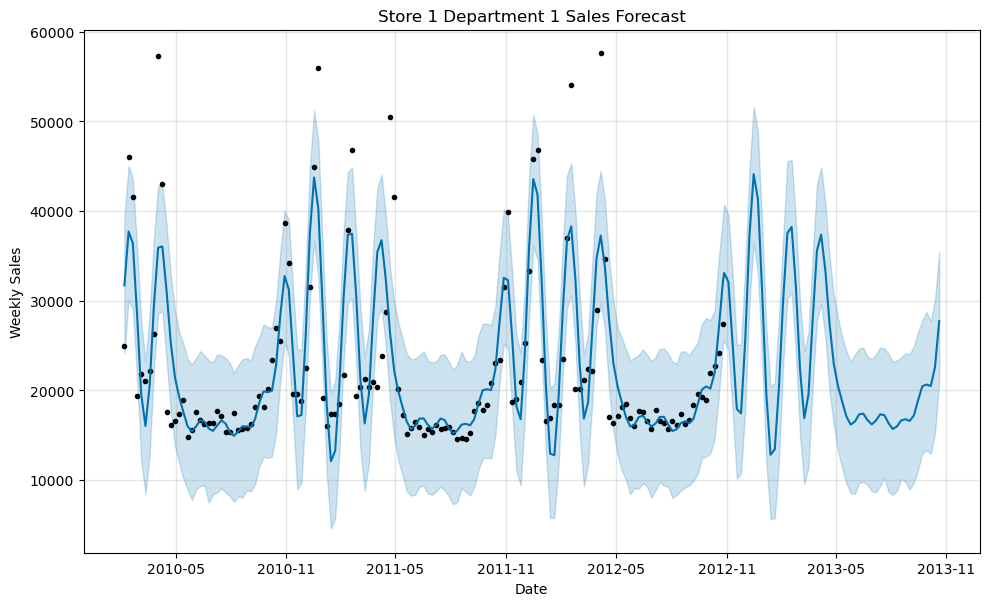

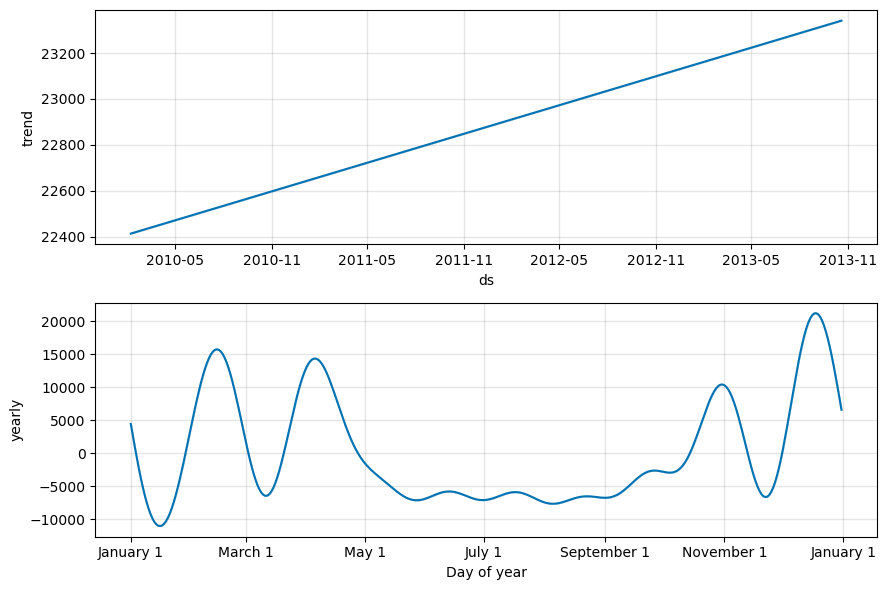

In [7]:
# Plot the forecast
fig1 = model.plot(forecast)
plt.title(f'Store {store_id} Department {dept_id} Sales Forecast')
plt.xlabel('Date')
plt.ylabel('Weekly Sales')
plt.show()

# Plot forecast components
fig2 = model.plot_components(forecast)
plt.show()


In [8]:
def detect_outliers_iqr(series):
    """
    Detect outliers using the IQR method.
    Returns a boolean series where True indicates an outlier.
    """
    Q1 = series.quantile(0.25)
    Q3 = series.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return (series < lower_bound) | (series > upper_bound)


In [9]:
def forecast_store_dept(df, store_id, dept_id, periods=52):
    """
    Forecast sales for a given store and department using Prophet.
    Detects outliers, fits model, evaluates accuracy, and plots results.
    
    Args:
        df (DataFrame): The merged dataset containing sales and features.
        store_id (int): Store number.
        dept_id (int): Department number.
        periods (int): Number of weeks to forecast into the future.
        
    Returns:
        forecast (DataFrame): DataFrame containing forecast results.
        metrics (dict): Dictionary with MAE and RMSE values.
    """
    # Filter data for specific store and department
    df_subset = df[(df['Store'] == store_id) & (df['Dept'] == dept_id)].copy()
    df_subset = df_subset.sort_values('Date')
    
    # Detect outliers in Weekly_Sales
    df_subset['Outlier'] = detect_outliers_iqr(df_subset['Weekly_Sales'])
    
    # Visualize sales and outliers
    plt.figure(figsize=(12, 4))
    plt.plot(df_subset['Date'], df_subset['Weekly_Sales'], label='Weekly Sales')
    plt.scatter(df_subset.loc[df_subset['Outlier'], 'Date'], 
                df_subset.loc[df_subset['Outlier'], 'Weekly_Sales'], 
                color='red', label='Outliers')
    plt.title(f'Store {store_id} Dept {dept_id} - Weekly Sales with Outliers')
    plt.xlabel('Date')
    plt.ylabel('Weekly Sales')
    plt.legend()
    plt.show()
    
    # Prepare data for Prophet model
    df_prophet = df_subset[['Date', 'Weekly_Sales']].rename(columns={'Date': 'ds', 'Weekly_Sales': 'y'})
    
    # Fit Prophet model
    model = Prophet(yearly_seasonality=True, weekly_seasonality=False, daily_seasonality=False)
    model.fit(df_prophet)
    
    # Create dataframe to hold future dates
    future = model.make_future_dataframe(periods=periods, freq='W')
    
    # Predict future sales
    forecast = model.predict(future)
    
    # Evaluate model accuracy on known data (only where forecast and actual overlap)
    forecast_known = forecast[forecast['ds'] <= df_prophet['ds'].max()]
    merged = pd.merge(df_prophet, forecast_known[['ds', 'yhat']], on='ds')
    
    mae = mean_absolute_error(merged['y'], merged['yhat'])
    rmse = mean_squared_error(merged['y'], merged['yhat'], squared=False)
    metrics = {'MAE': mae, 'RMSE': rmse}
    
    print(f"Store {store_id} Dept {dept_id} - MAE: {mae:.2f}, RMSE: {rmse:.2f}")
    
    # Plot forecast vs actual
    plt.figure(figsize=(12, 5))
    plt.plot(df_prophet['ds'], df_prophet['y'], label='Actual')
    plt.plot(forecast['ds'], forecast['yhat'], label='Forecast')
    plt.fill_between(forecast['ds'], forecast['yhat_lower'], forecast['yhat_upper'], color='gray', alpha=0.3)
    plt.title(f'Store {store_id} Dept {dept_id} - Sales Forecast')
    plt.xlabel('Date')
    plt.ylabel('Weekly Sales')
    plt.legend()
    plt.show()

    model.plot_components(forecast)
    plt.show()
    
    return forecast, metrics





Forecasting for Store 1, Department 1


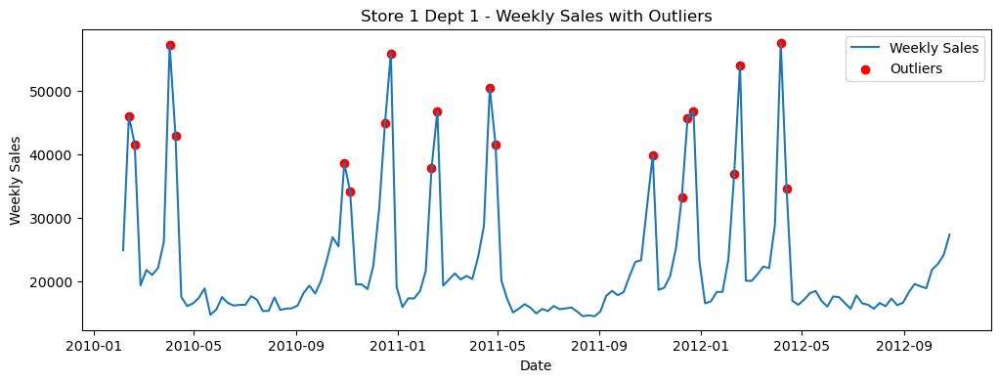

12:11:06 - cmdstanpy - INFO - Chain [1] start processing
12:11:06 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 1 - MAE: 3602.54, RMSE: 5845.91


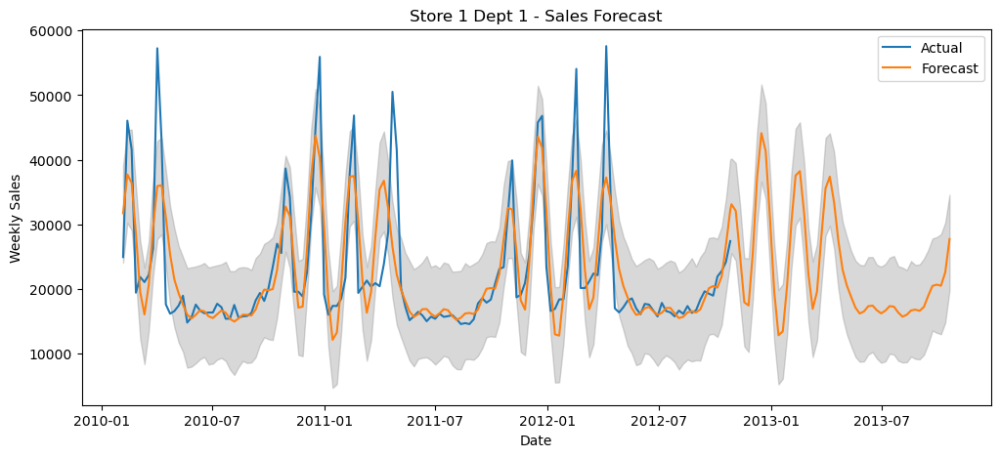

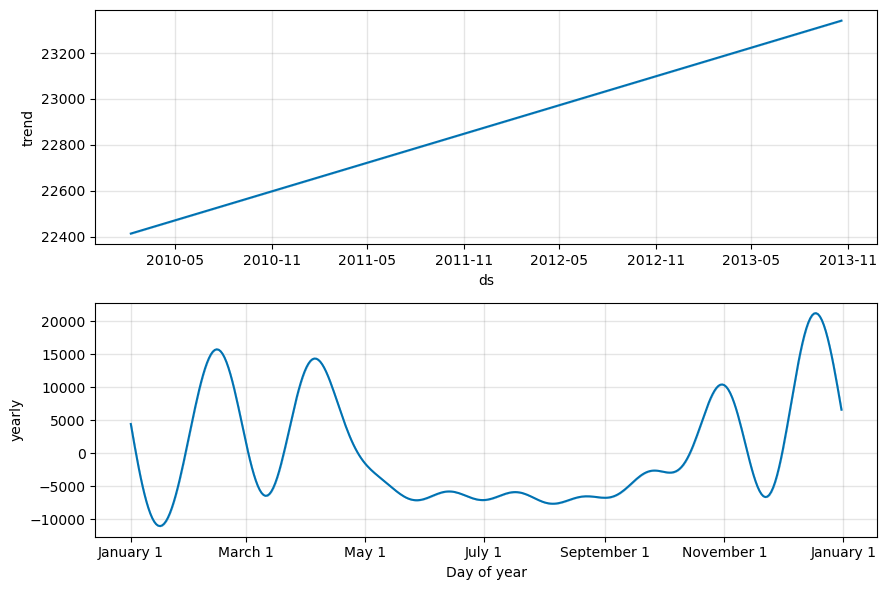


Forecasting for Store 1, Department 2


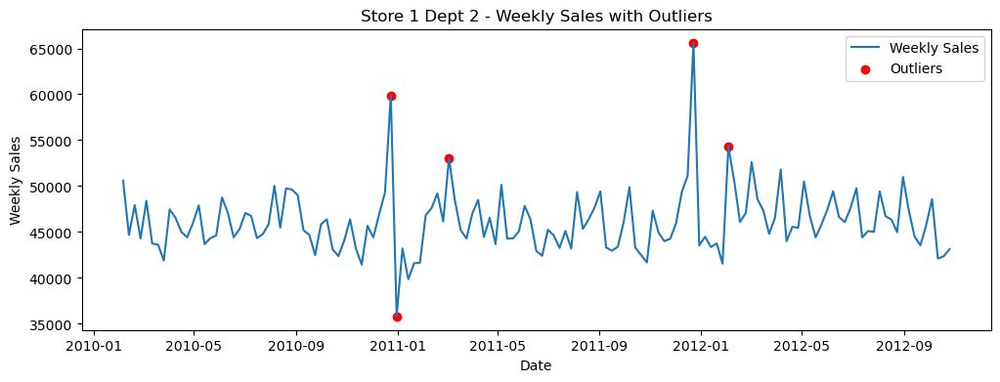

12:11:08 - cmdstanpy - INFO - Chain [1] start processing
12:11:08 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 2 - MAE: 1942.62, RMSE: 2623.69


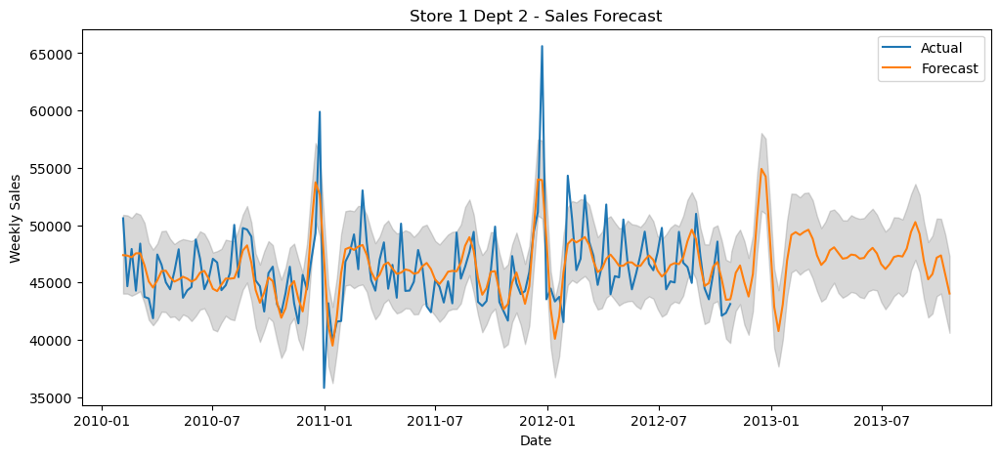

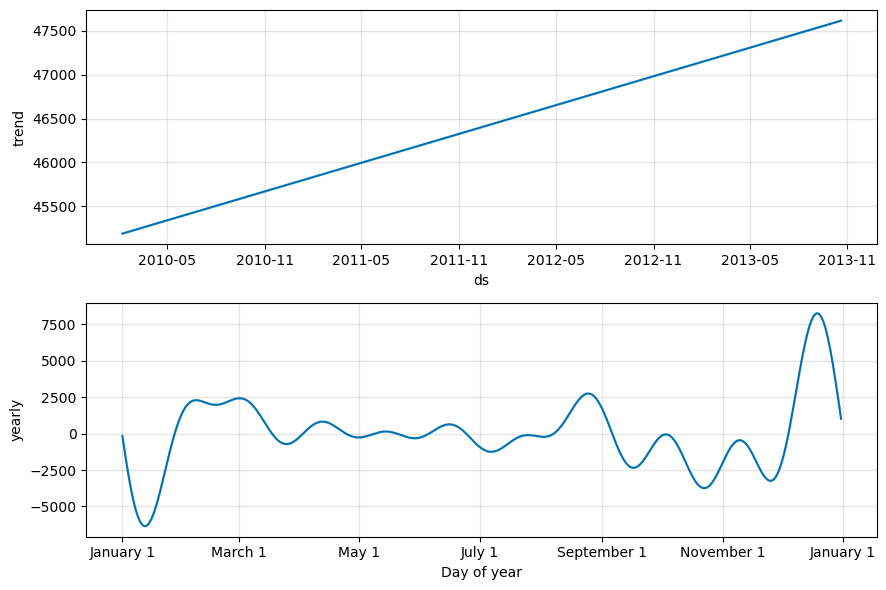


Forecasting for Store 1, Department 3


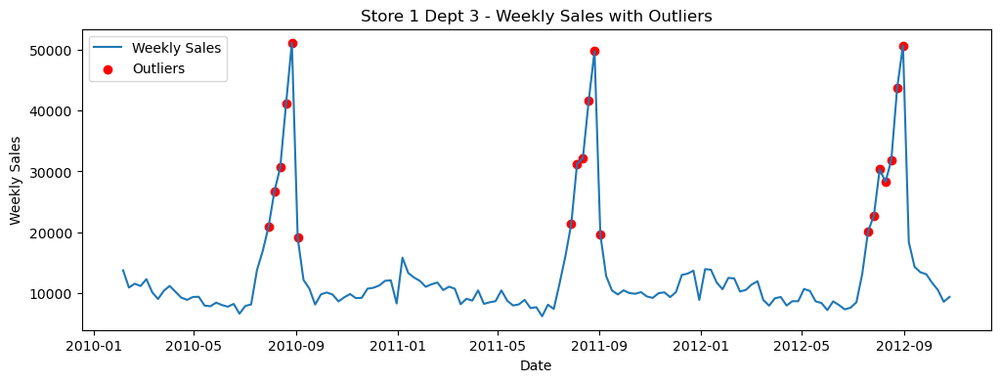

12:11:10 - cmdstanpy - INFO - Chain [1] start processing
12:11:10 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 3 - MAE: 1641.58, RMSE: 2908.11


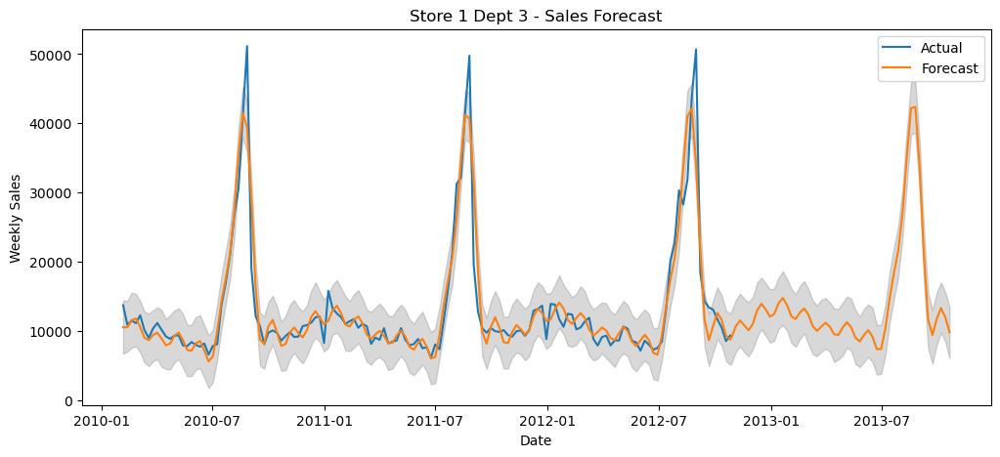

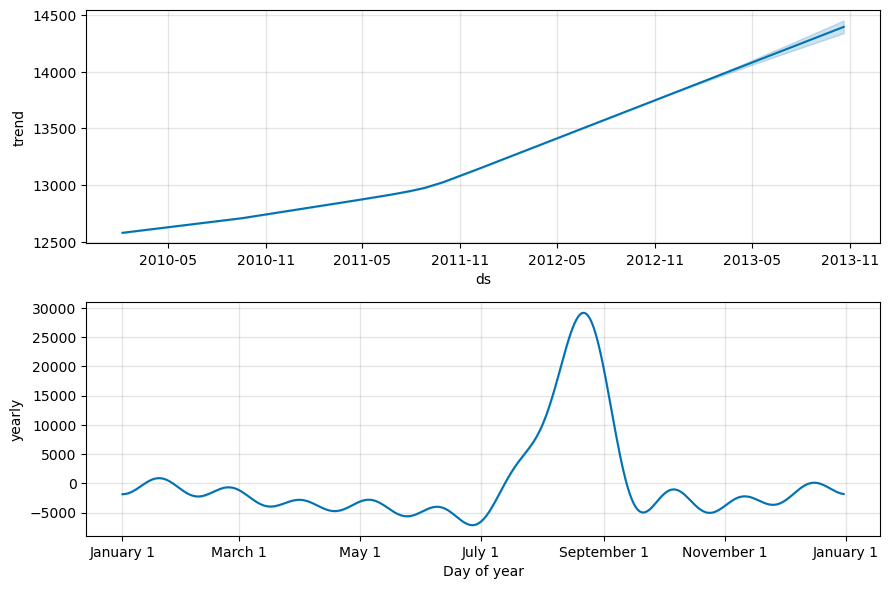


Forecasting for Store 1, Department 4


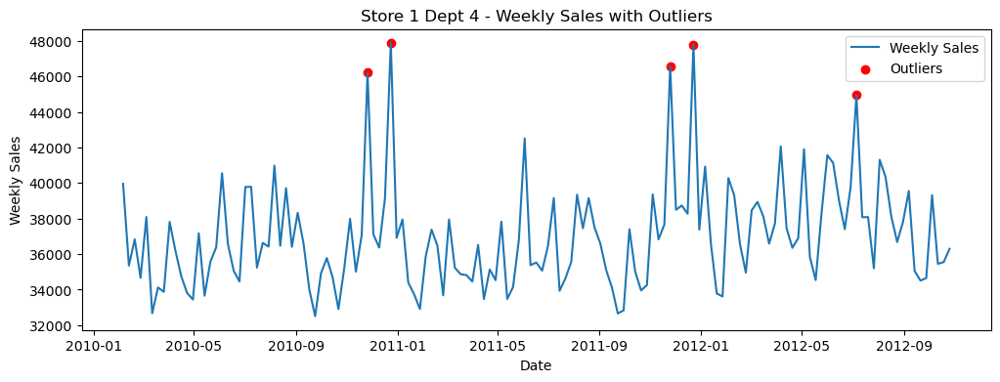

12:11:12 - cmdstanpy - INFO - Chain [1] start processing
12:11:12 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 4 - MAE: 1720.71, RMSE: 2179.63


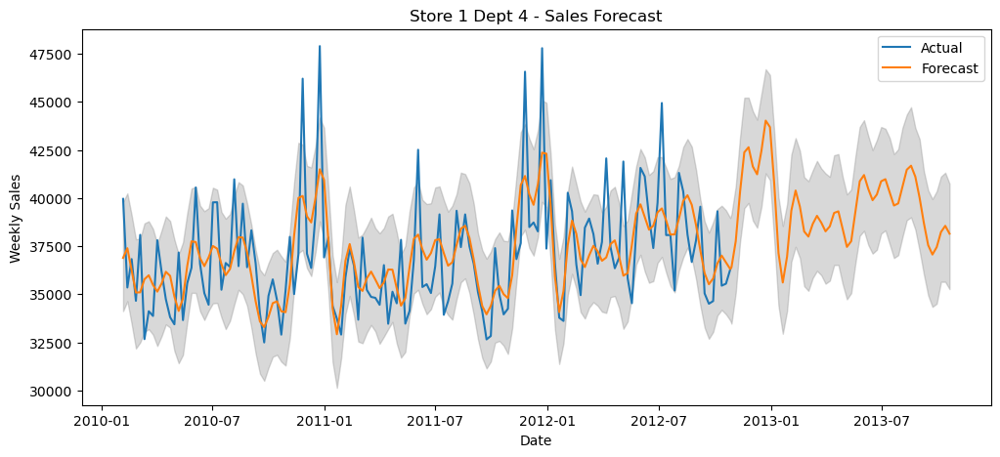

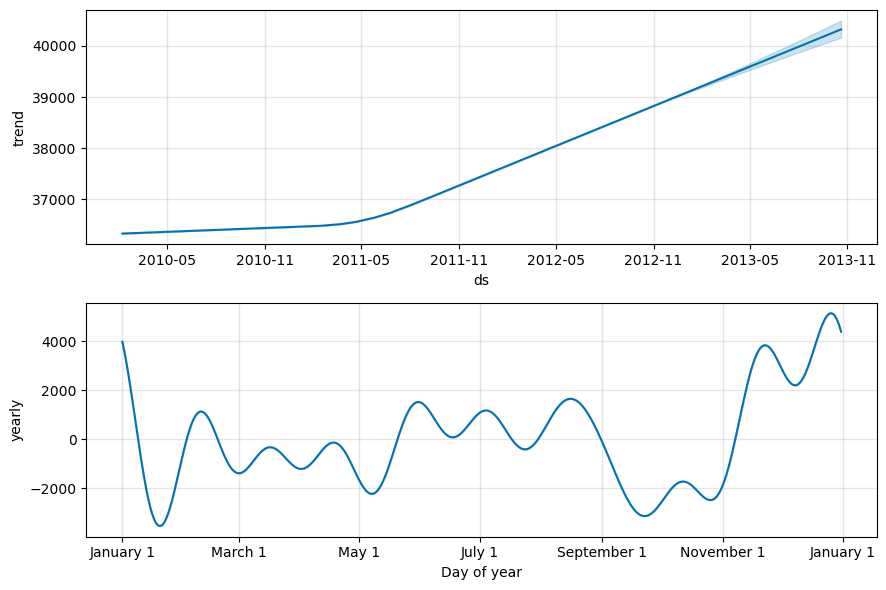


Forecasting for Store 1, Department 5


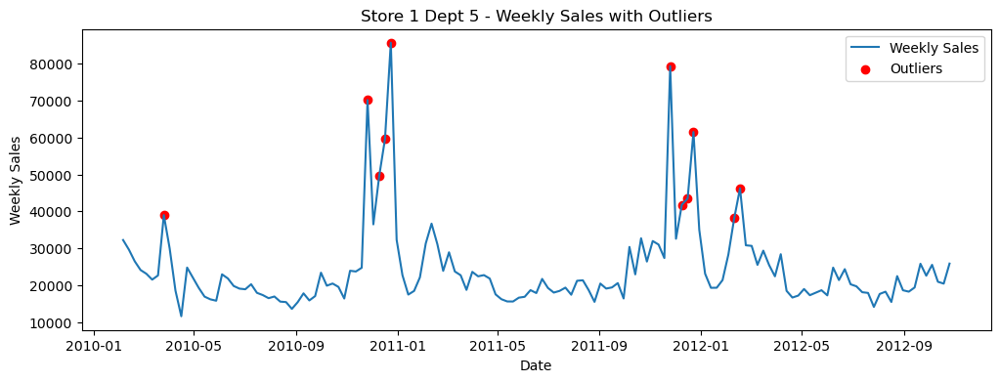

12:11:14 - cmdstanpy - INFO - Chain [1] start processing
12:11:14 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 5 - MAE: 3748.05, RMSE: 6386.96


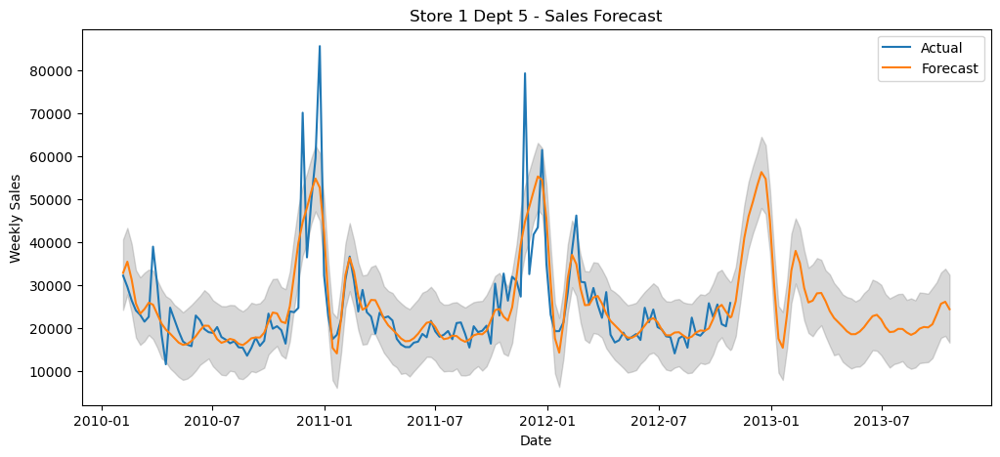

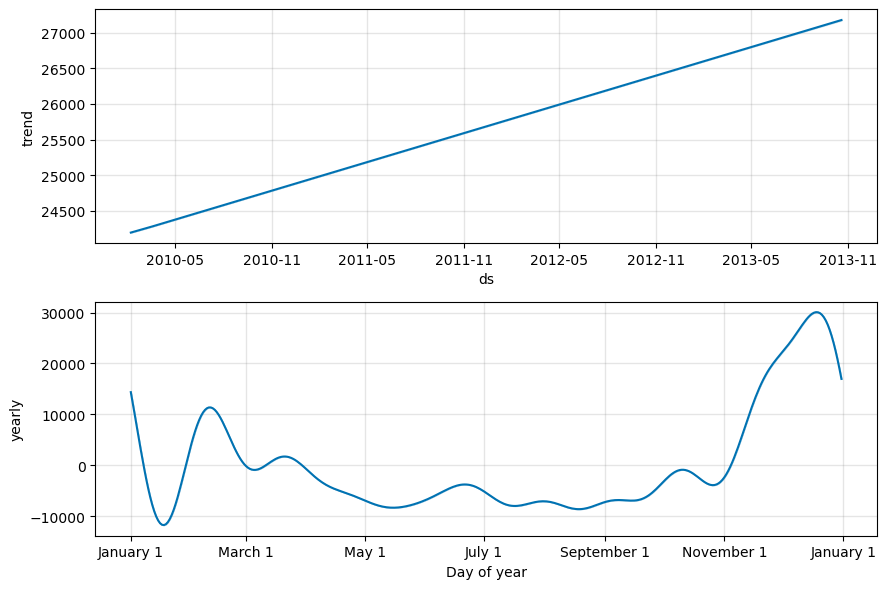


Forecasting for Store 1, Department 6


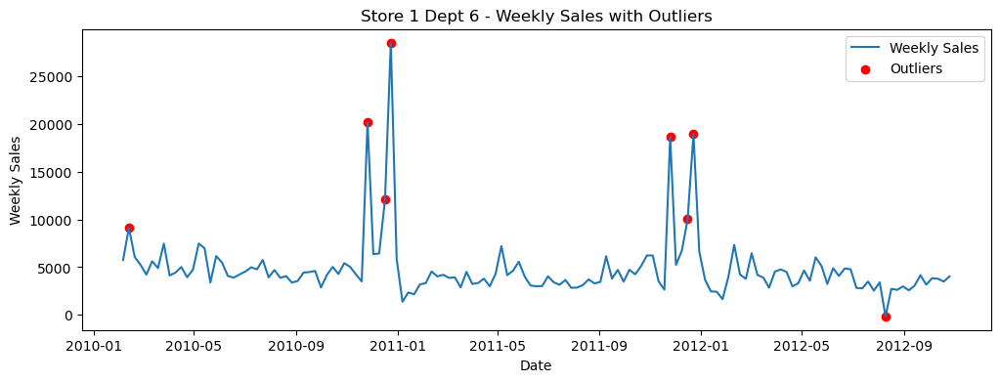

12:11:16 - cmdstanpy - INFO - Chain [1] start processing
12:11:16 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 6 - MAE: 1364.82, RMSE: 2388.77


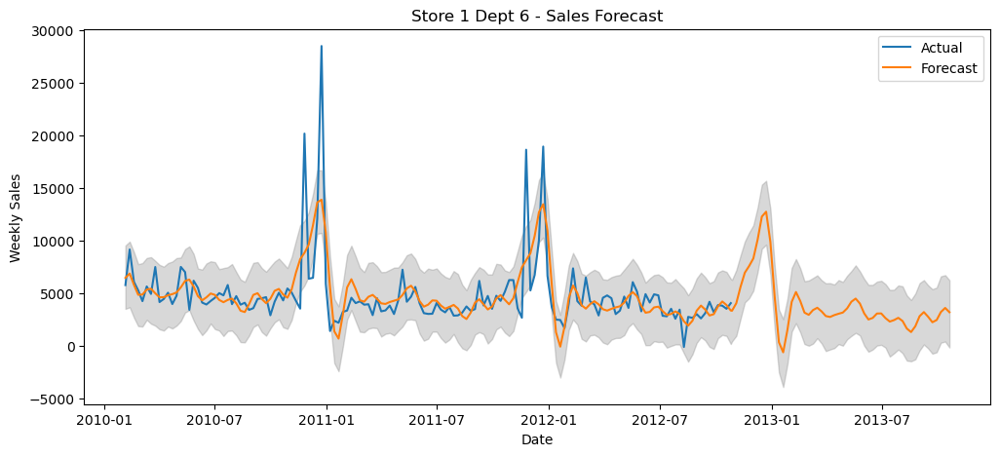

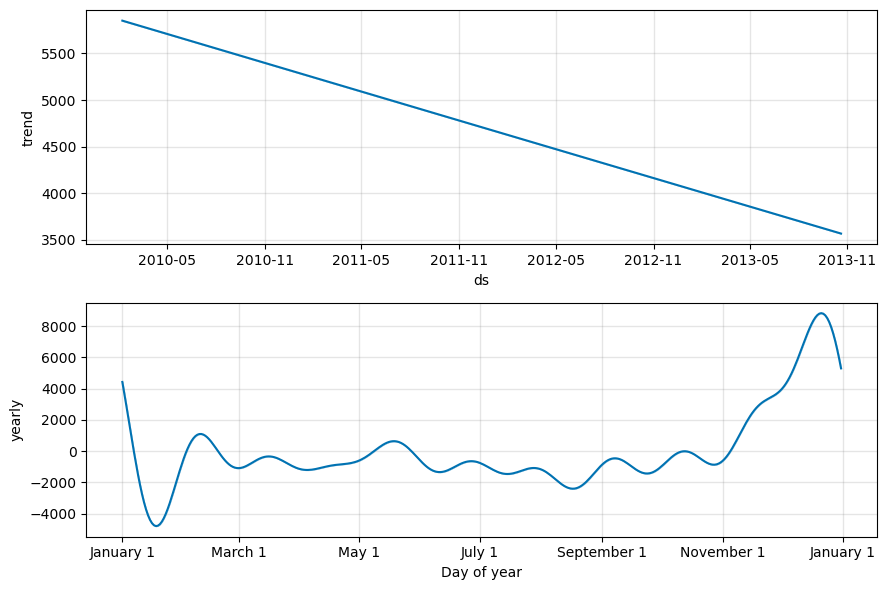


Forecasting for Store 1, Department 7


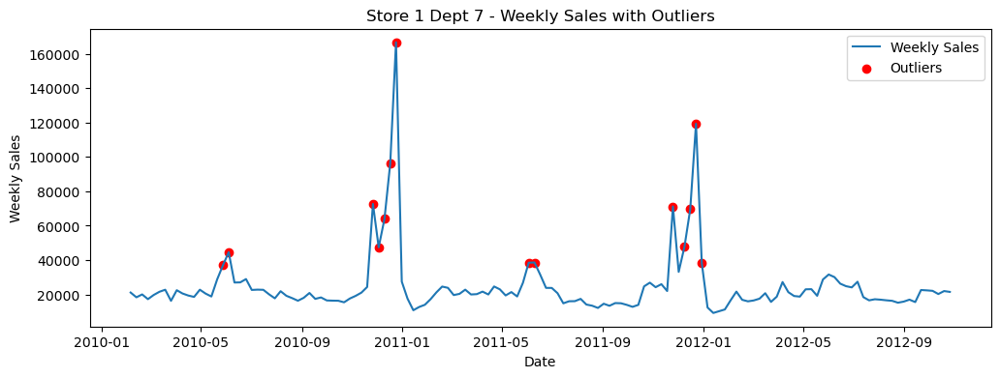

12:11:18 - cmdstanpy - INFO - Chain [1] start processing
12:11:18 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 7 - MAE: 5322.62, RMSE: 10319.14


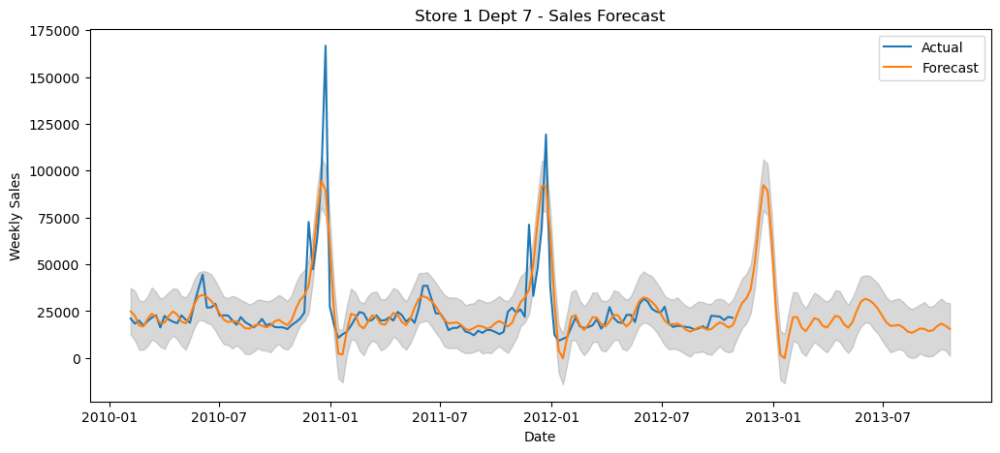

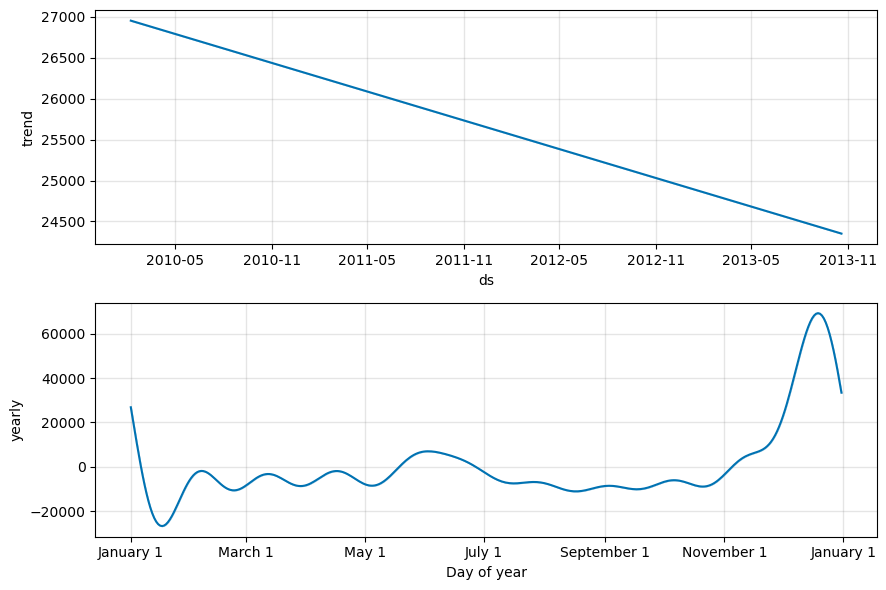


Forecasting for Store 1, Department 8


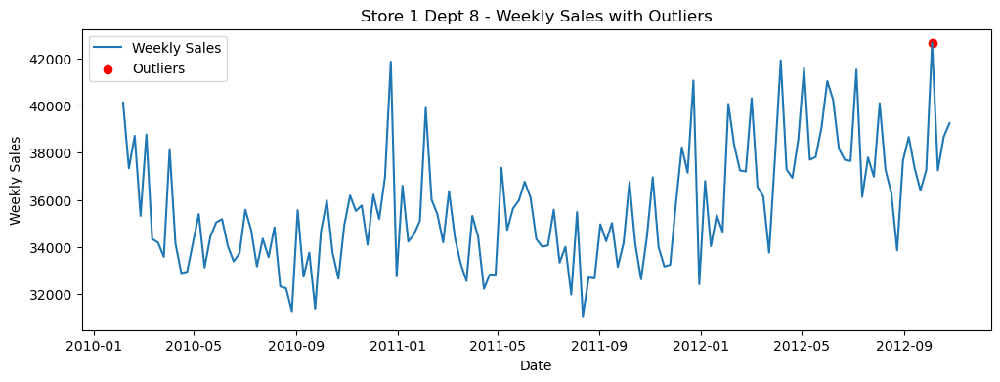

12:11:20 - cmdstanpy - INFO - Chain [1] start processing
12:11:20 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 8 - MAE: 1282.14, RMSE: 1640.24


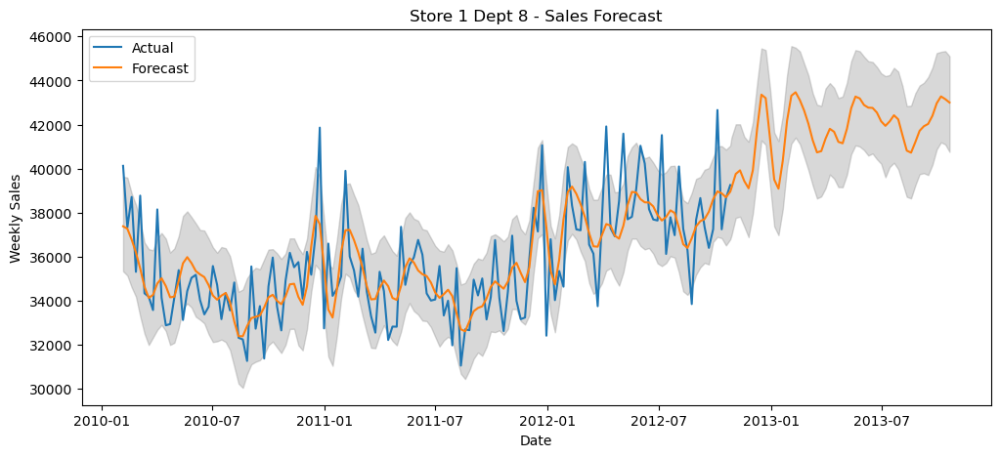

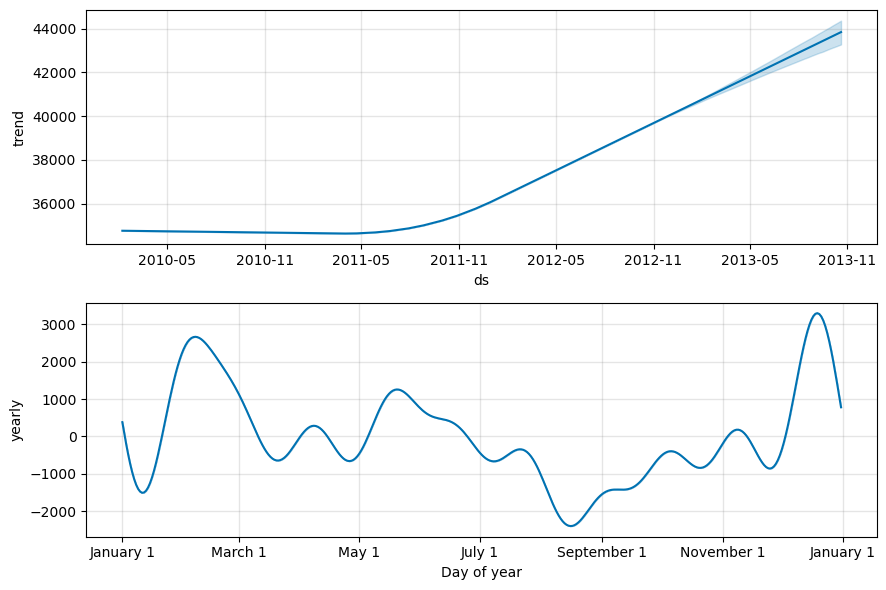


Forecasting for Store 1, Department 9


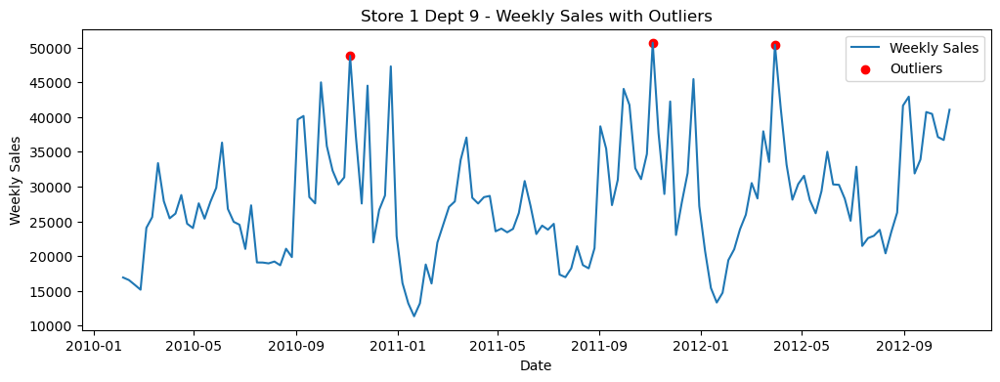

12:11:22 - cmdstanpy - INFO - Chain [1] start processing
12:11:22 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 9 - MAE: 3380.07, RMSE: 4476.24


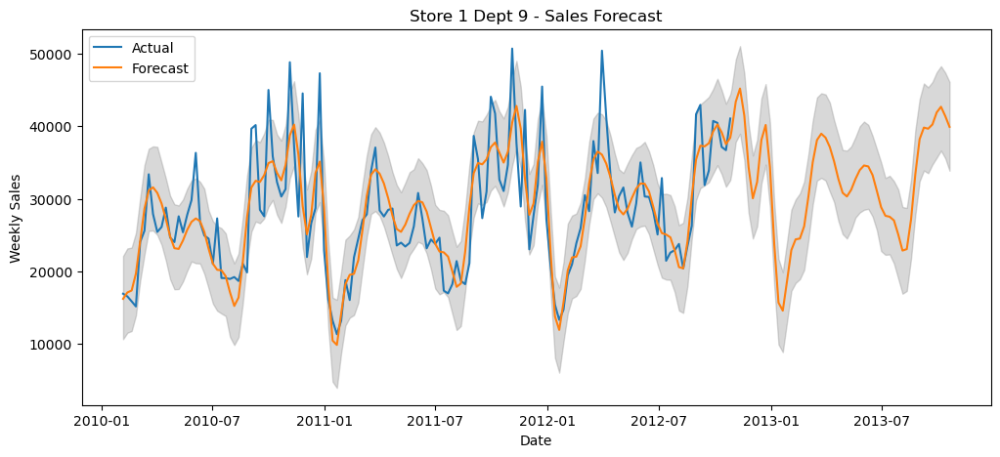

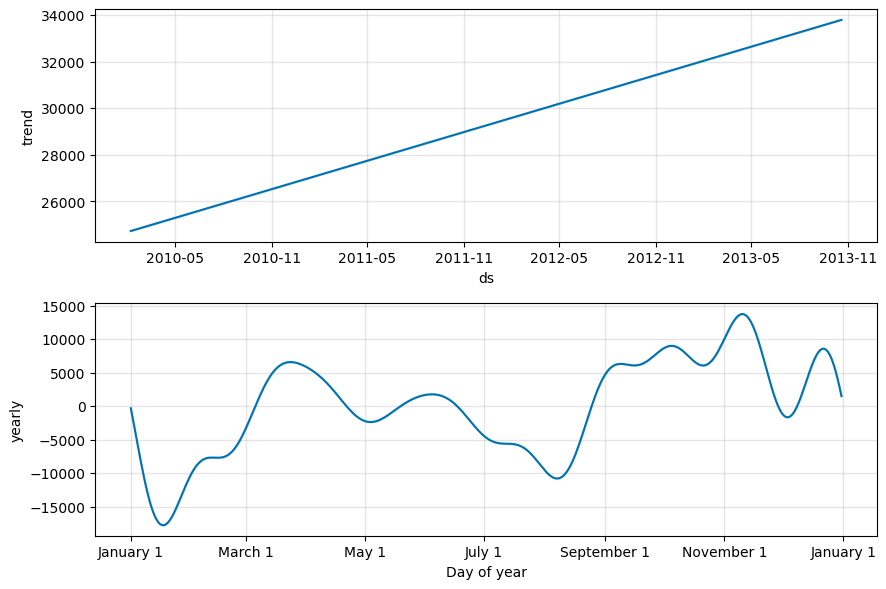


Forecasting for Store 1, Department 10


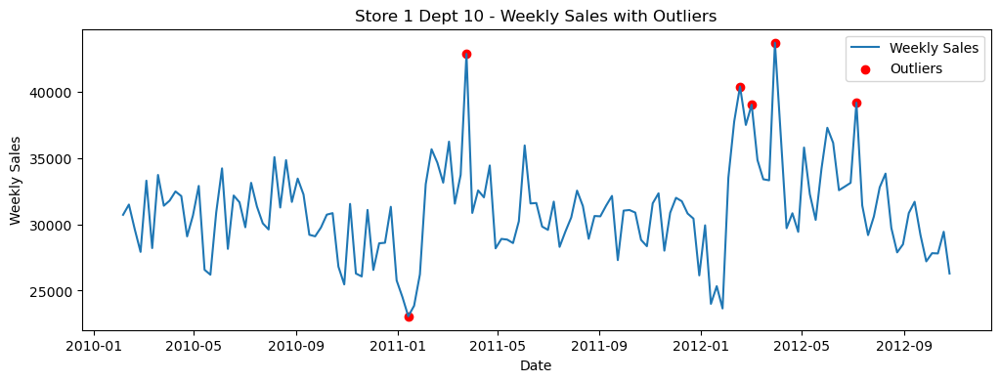

12:11:24 - cmdstanpy - INFO - Chain [1] start processing
12:11:24 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 10 - MAE: 1924.10, RMSE: 2404.27


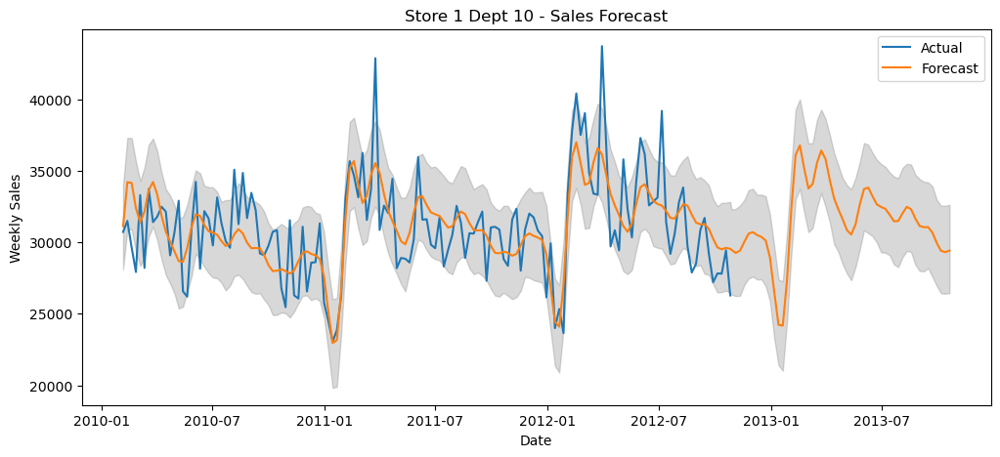

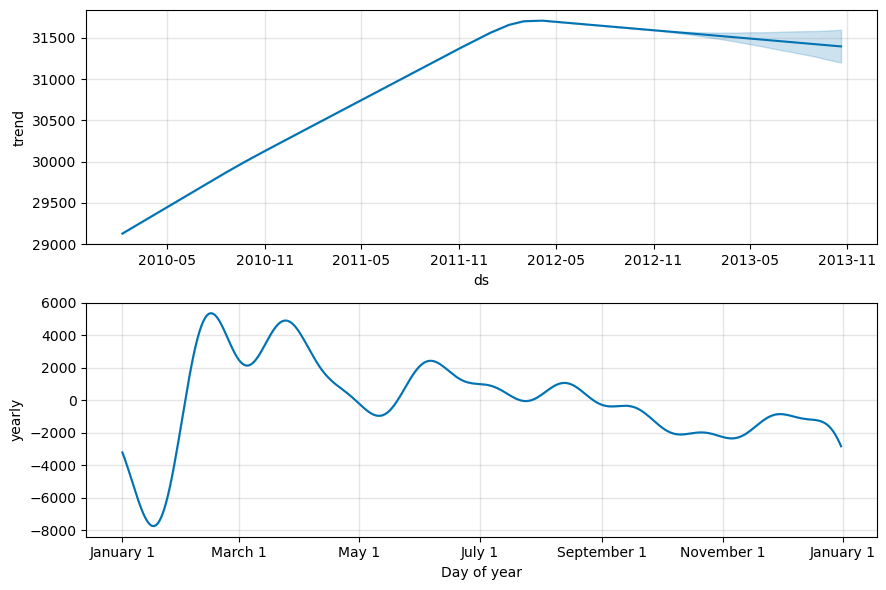


Forecasting for Store 1, Department 11


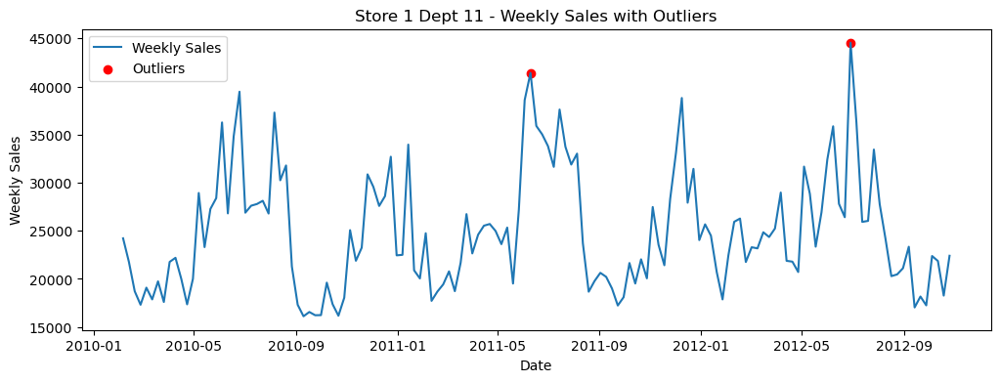

12:11:26 - cmdstanpy - INFO - Chain [1] start processing
12:11:26 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 11 - MAE: 2723.11, RMSE: 3541.52


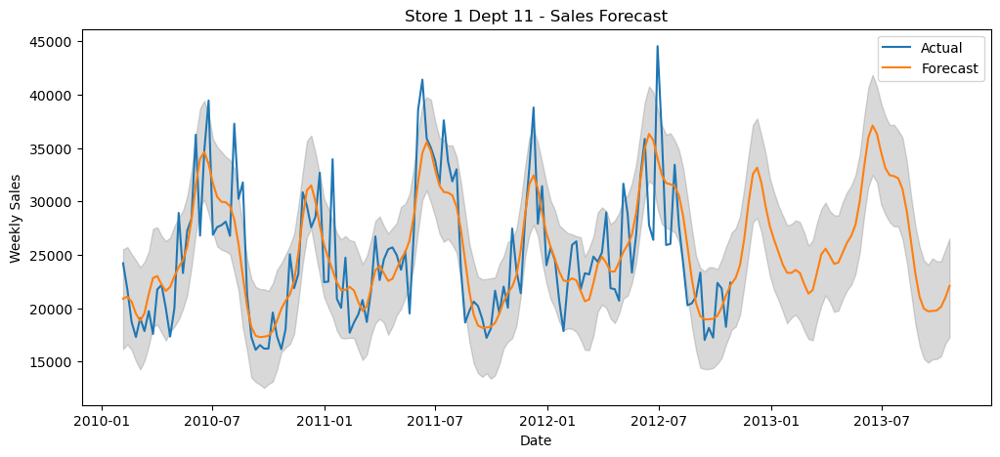

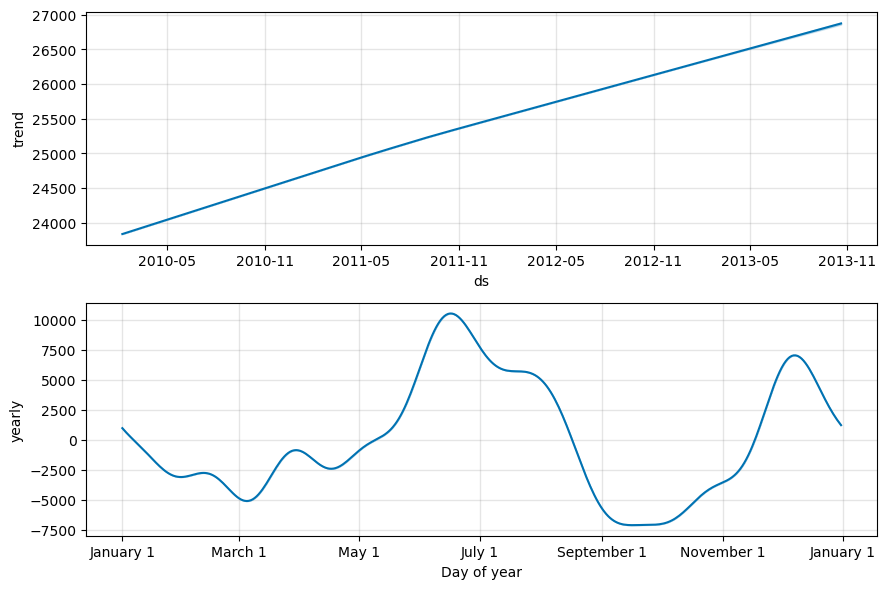


Forecasting for Store 1, Department 12


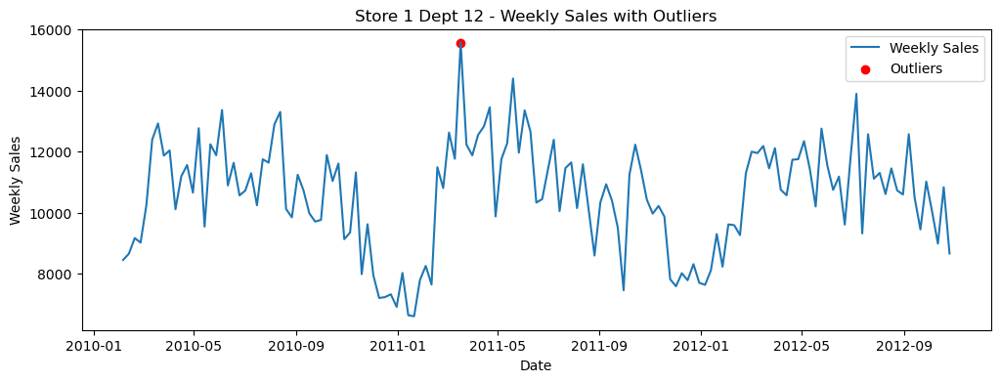

12:11:28 - cmdstanpy - INFO - Chain [1] start processing
12:11:28 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 12 - MAE: 754.46, RMSE: 978.11


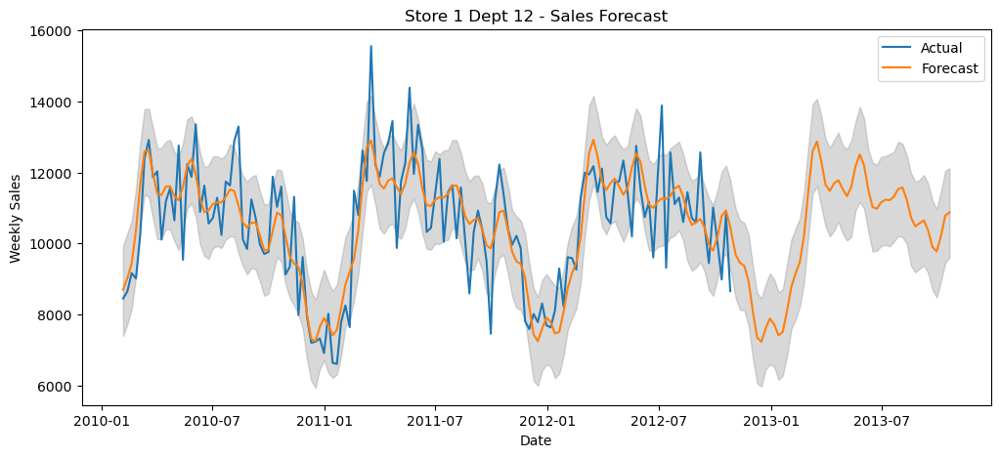

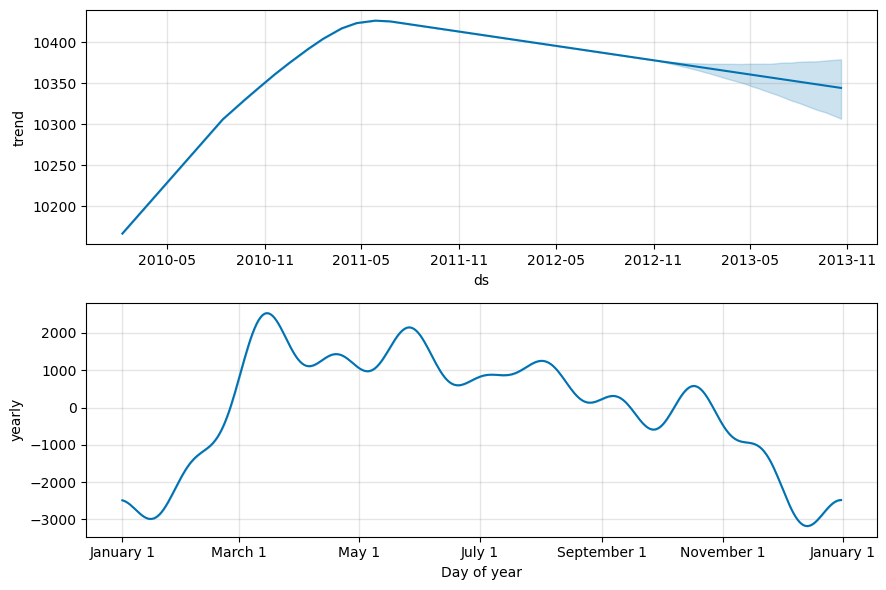


Forecasting for Store 1, Department 13


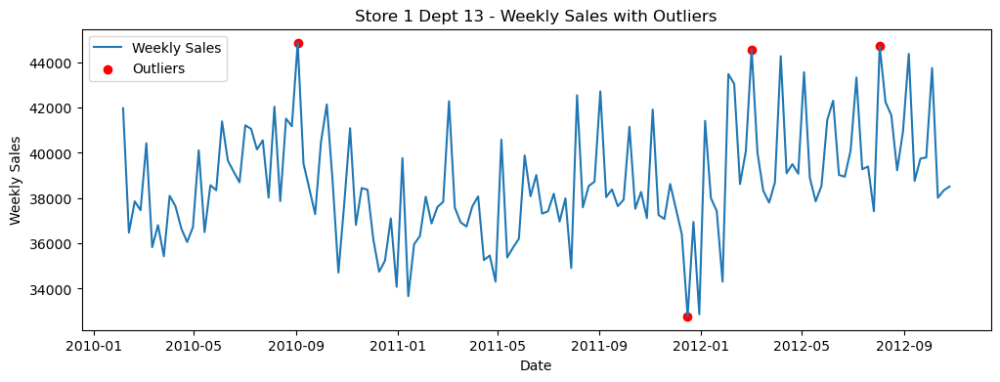

12:11:30 - cmdstanpy - INFO - Chain [1] start processing
12:11:30 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 13 - MAE: 1608.96, RMSE: 2024.77


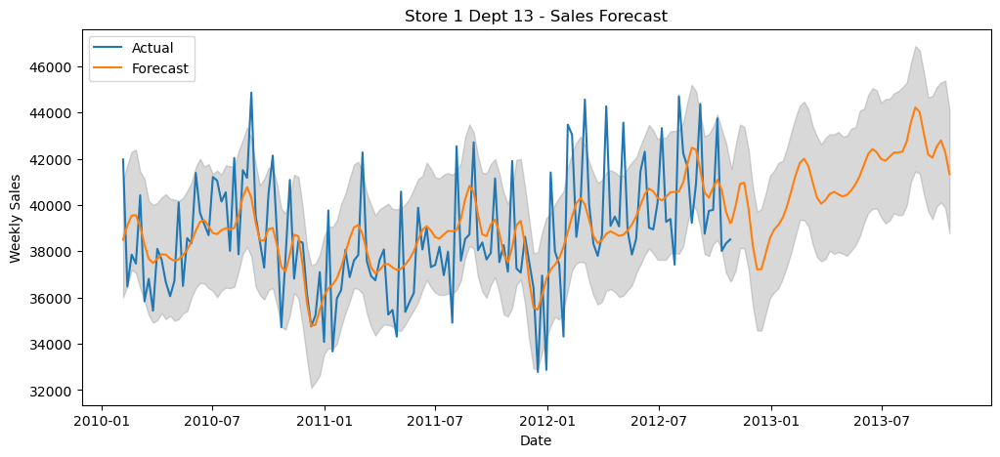

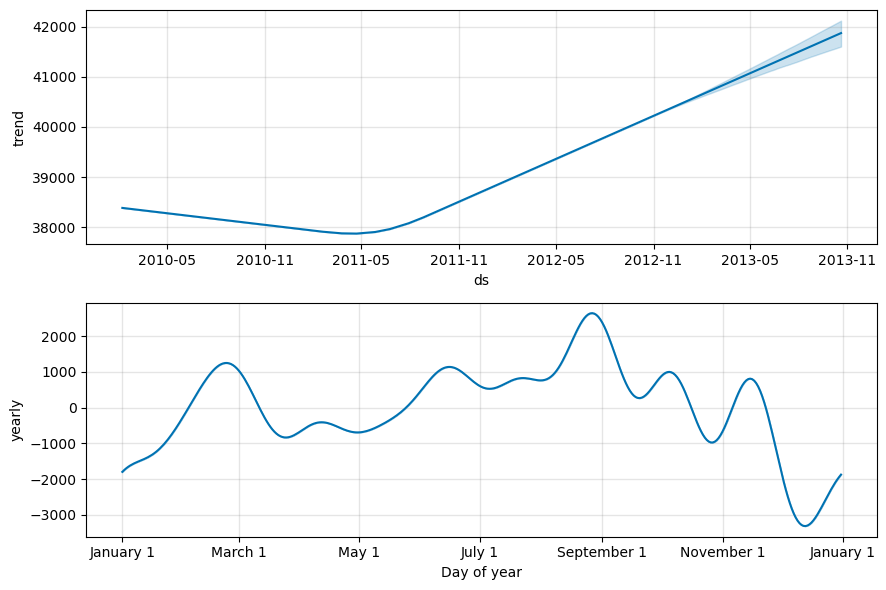


Forecasting for Store 1, Department 14


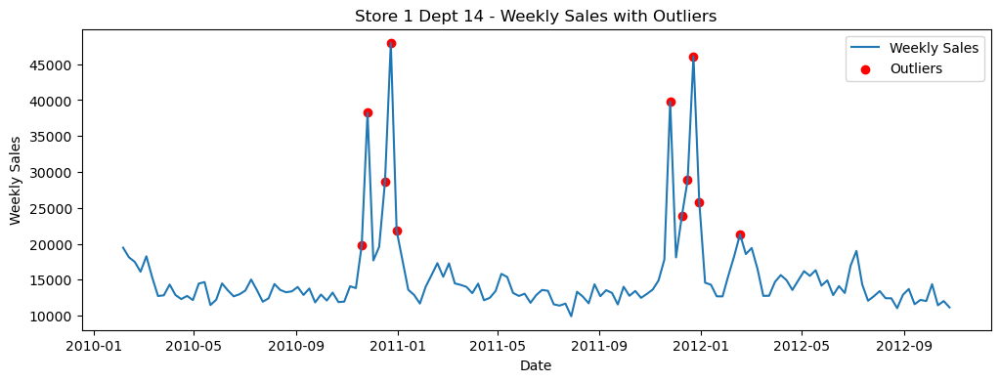

12:11:32 - cmdstanpy - INFO - Chain [1] start processing
12:11:32 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 14 - MAE: 1866.18, RMSE: 3181.73


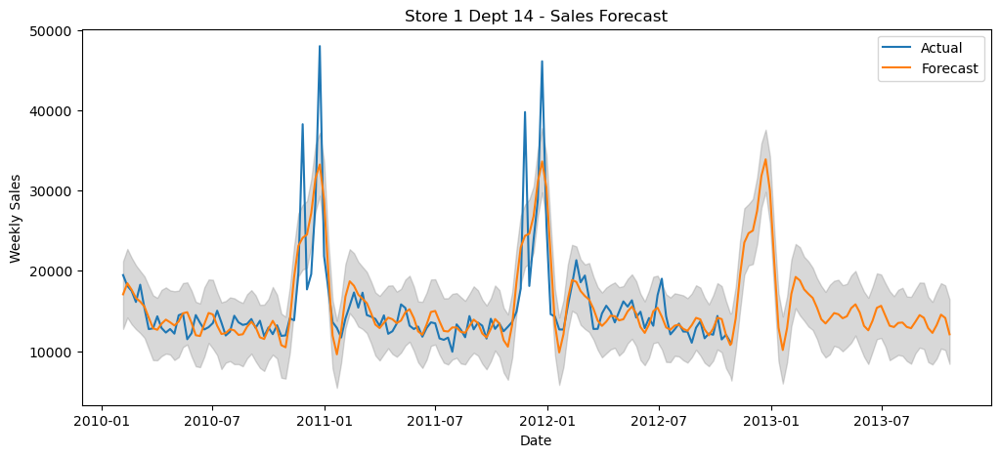

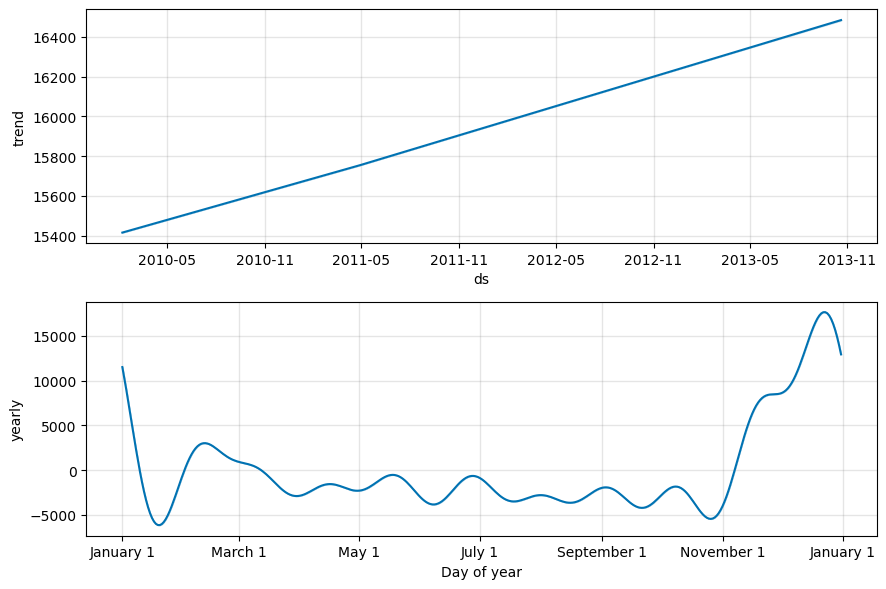


Forecasting for Store 1, Department 16


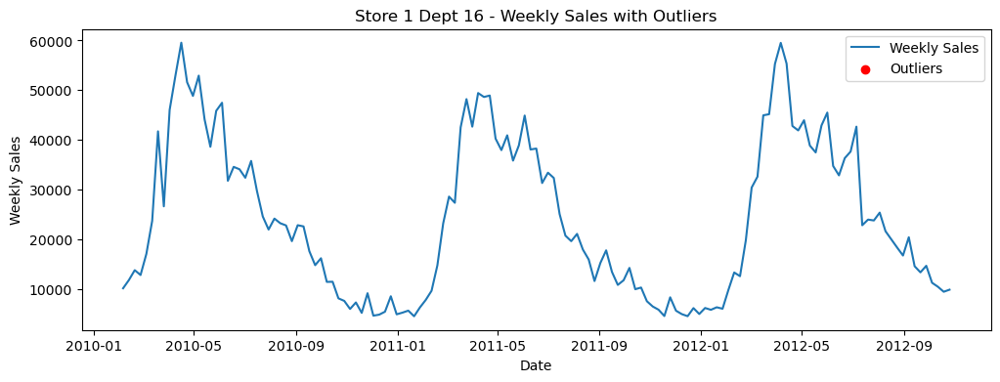

12:11:34 - cmdstanpy - INFO - Chain [1] start processing
12:11:34 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 16 - MAE: 2708.91, RMSE: 3777.47


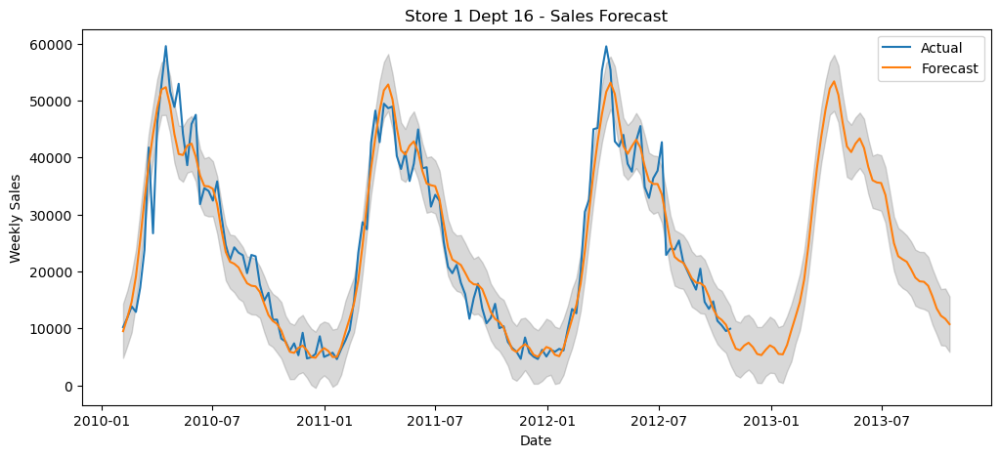

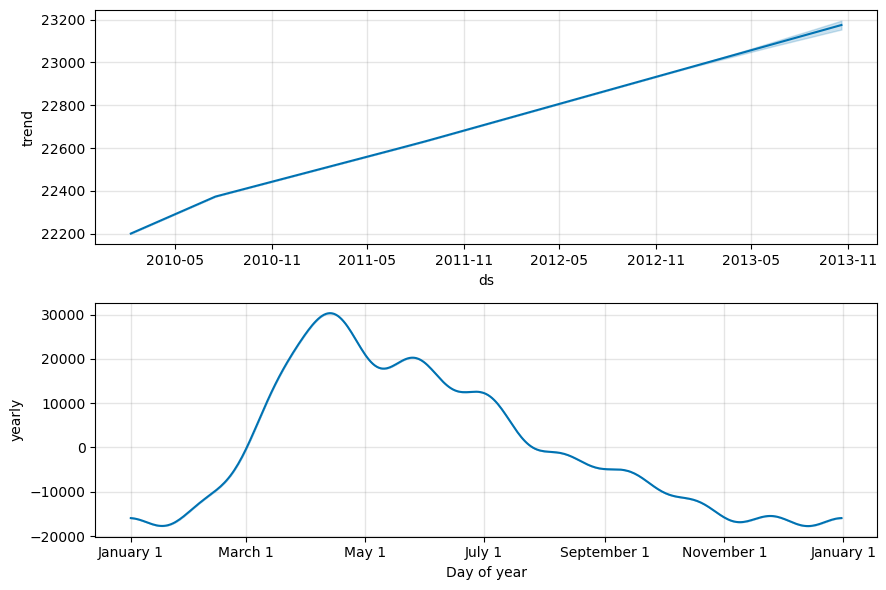


Forecasting for Store 1, Department 17


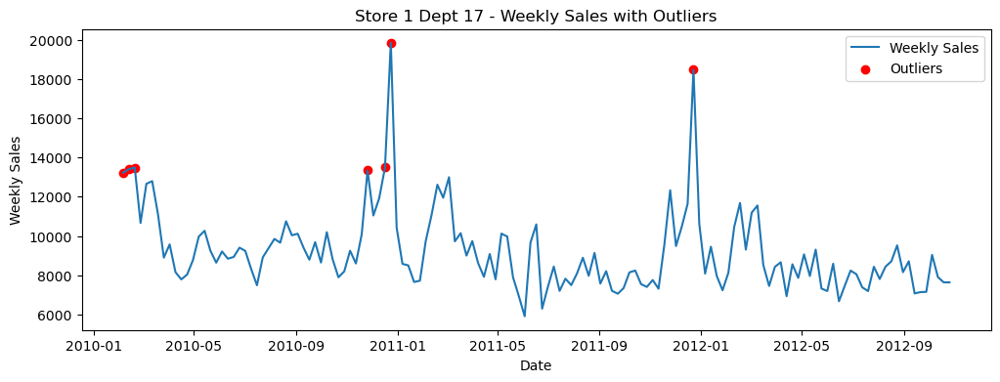

12:11:36 - cmdstanpy - INFO - Chain [1] start processing
12:11:36 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 17 - MAE: 793.18, RMSE: 1090.00


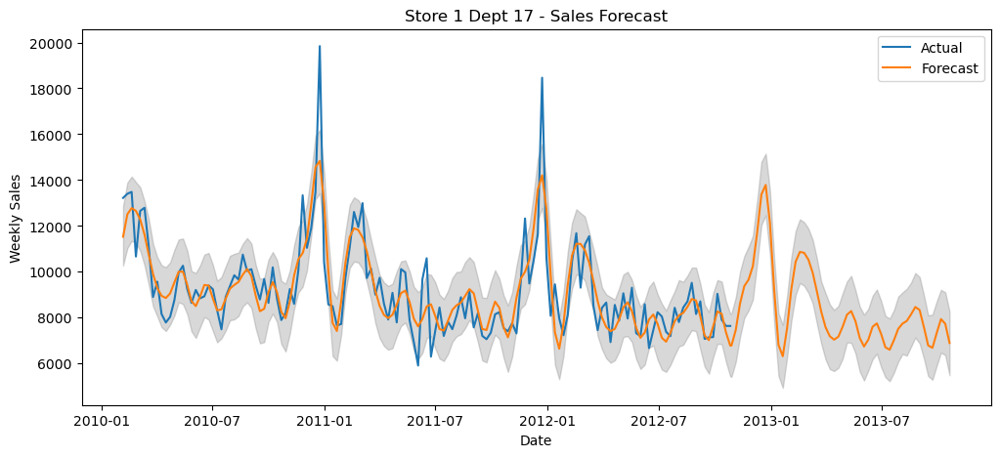

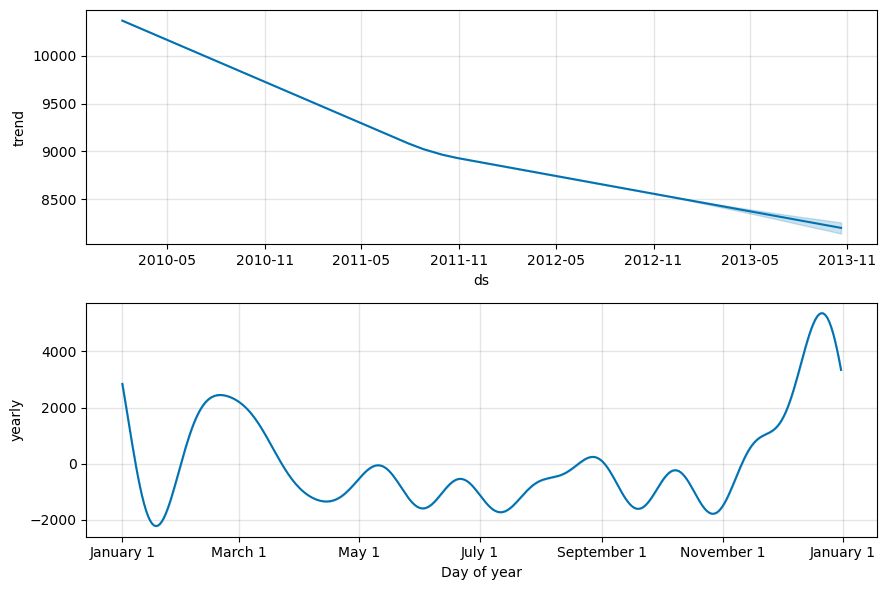


Forecasting for Store 1, Department 18


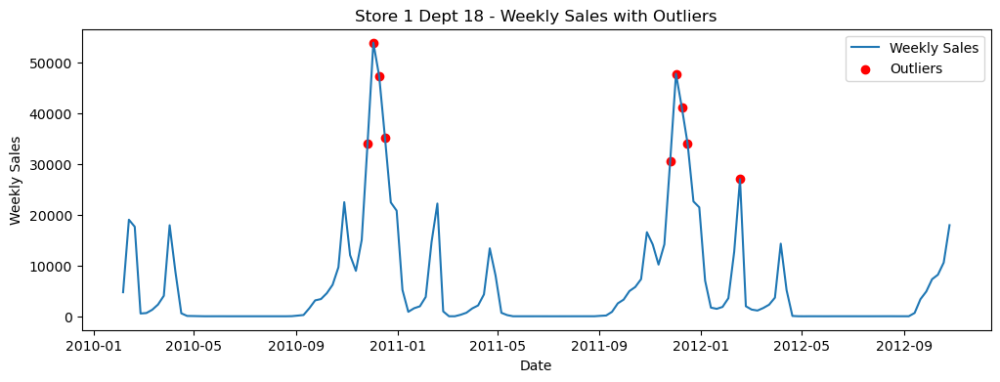

12:11:37 - cmdstanpy - INFO - Chain [1] start processing
12:11:37 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 18 - MAE: 2579.34, RMSE: 3520.30


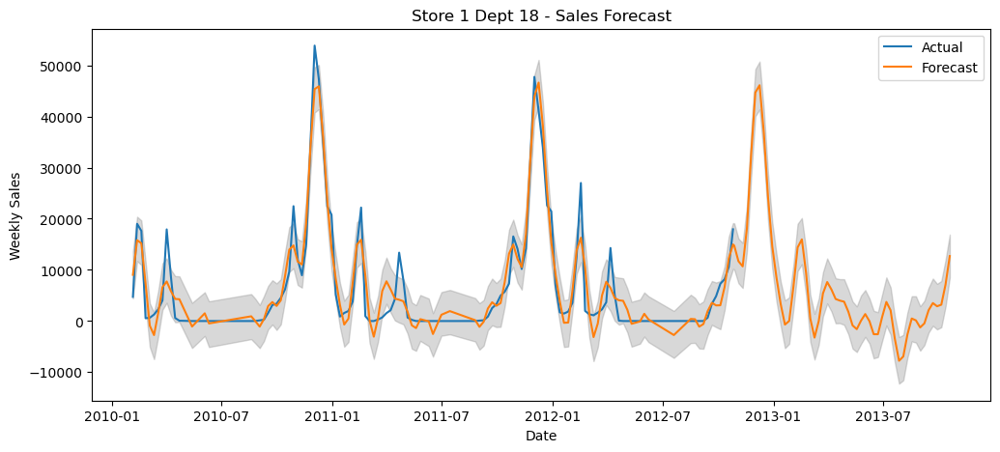

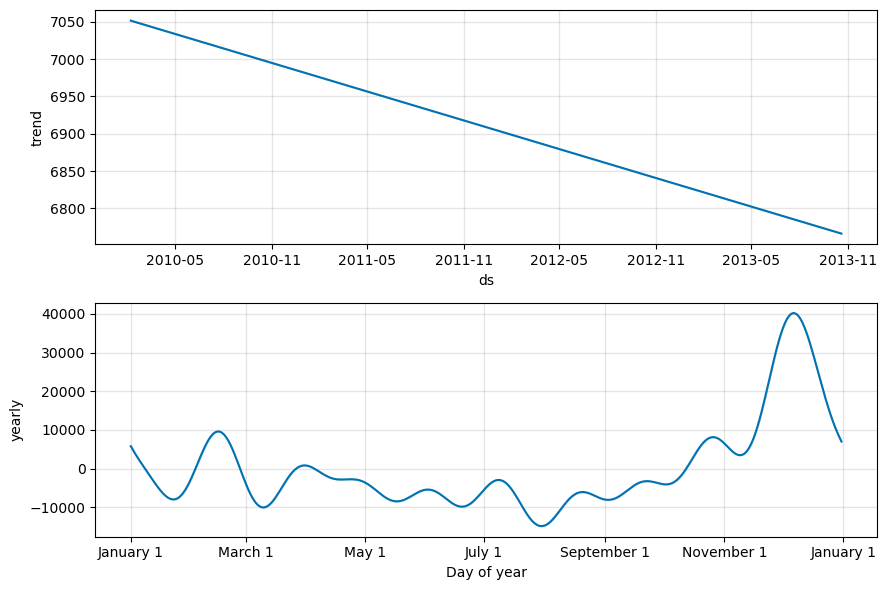


Forecasting for Store 1, Department 19


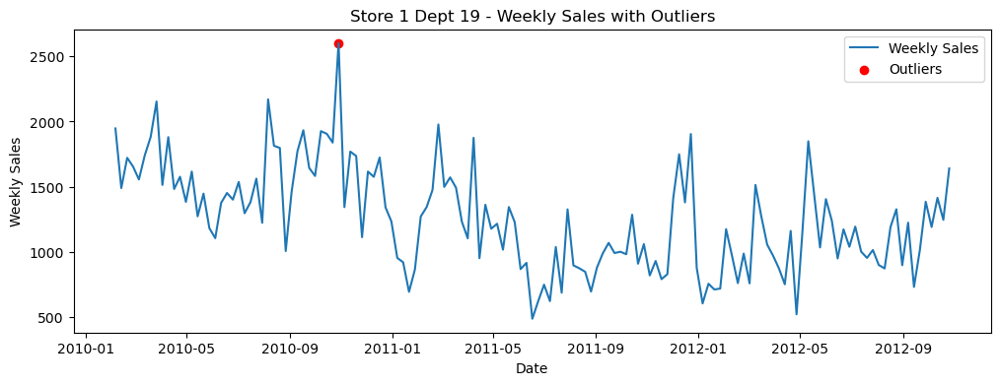

12:11:39 - cmdstanpy - INFO - Chain [1] start processing
12:11:39 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 19 - MAE: 208.32, RMSE: 259.78


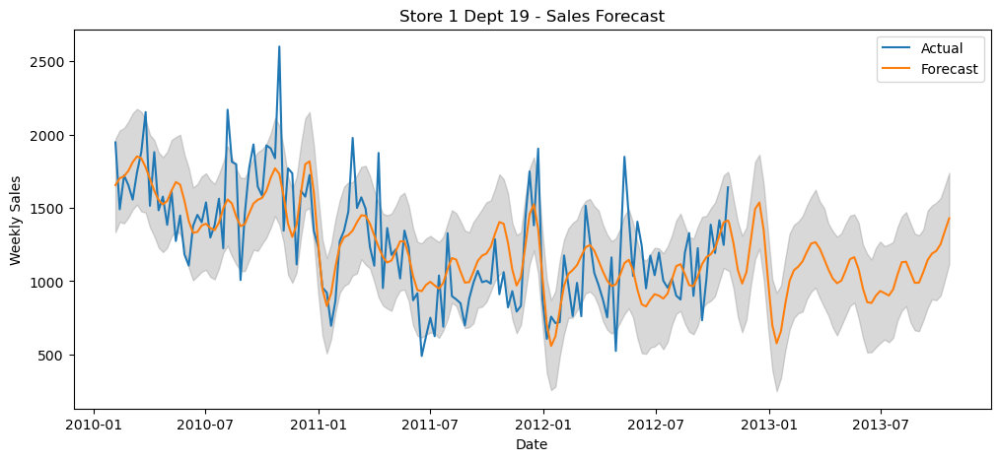

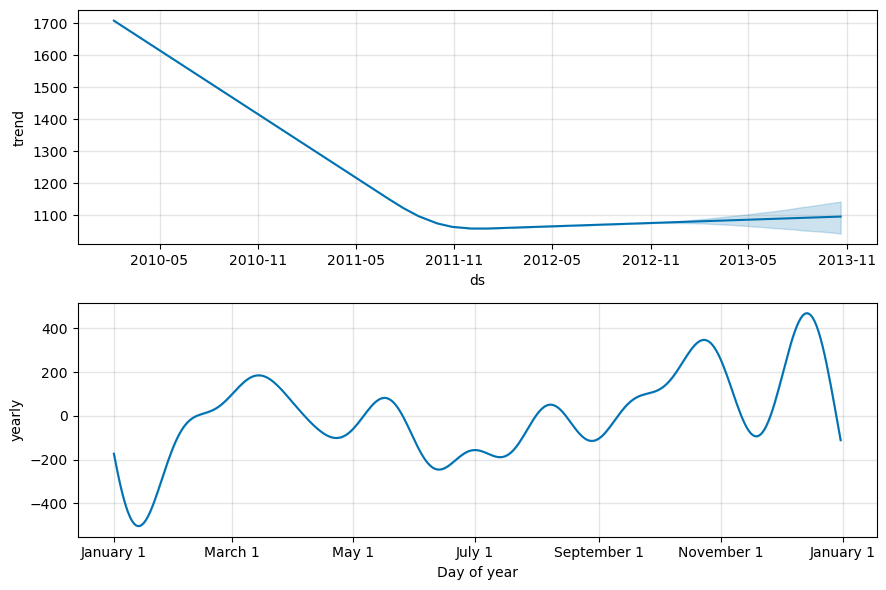


Forecasting for Store 1, Department 20


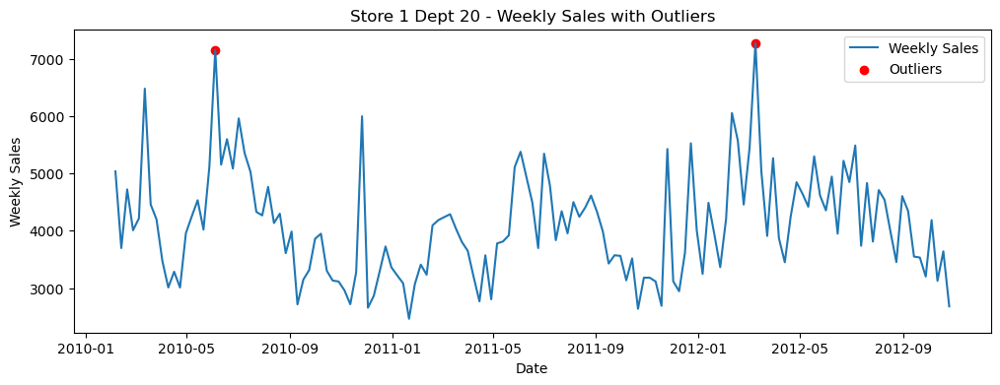

12:11:41 - cmdstanpy - INFO - Chain [1] start processing
12:11:41 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 20 - MAE: 478.44, RMSE: 635.65


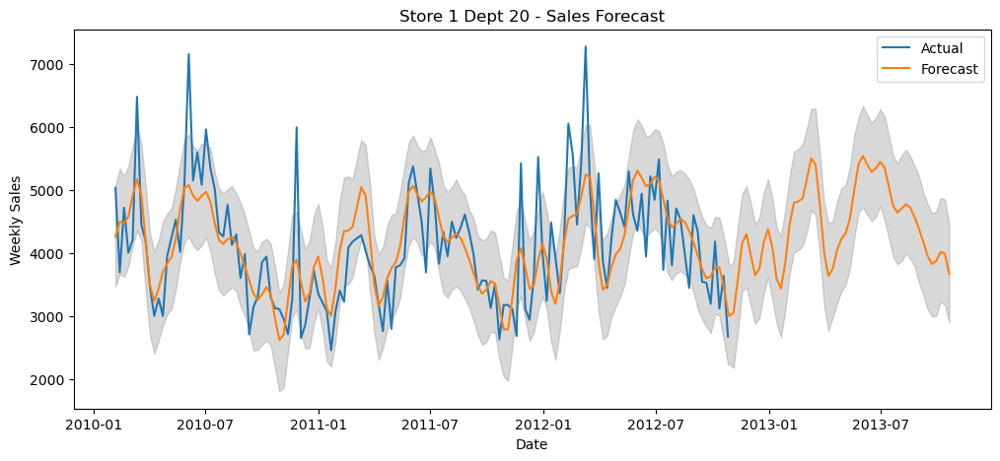

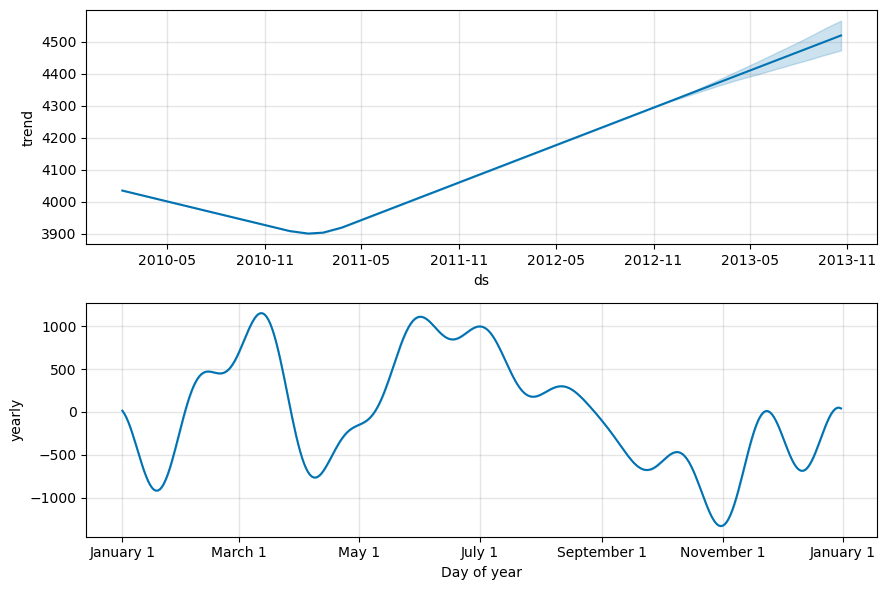


Forecasting for Store 1, Department 21


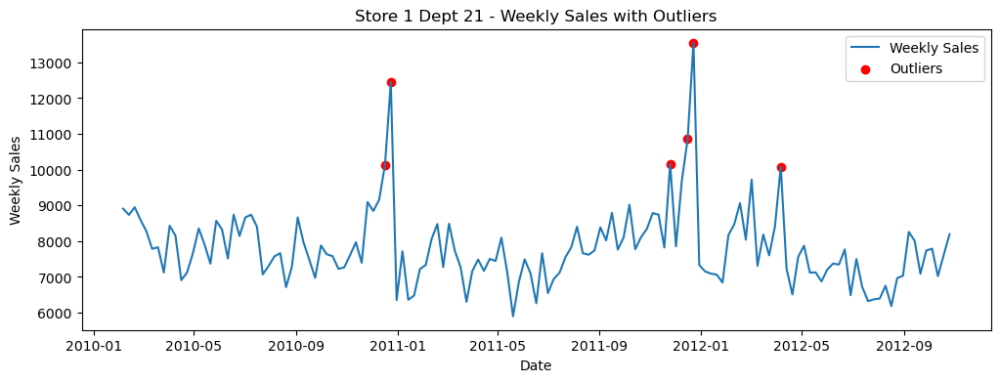

12:11:43 - cmdstanpy - INFO - Chain [1] start processing
12:11:43 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 21 - MAE: 555.82, RMSE: 752.95


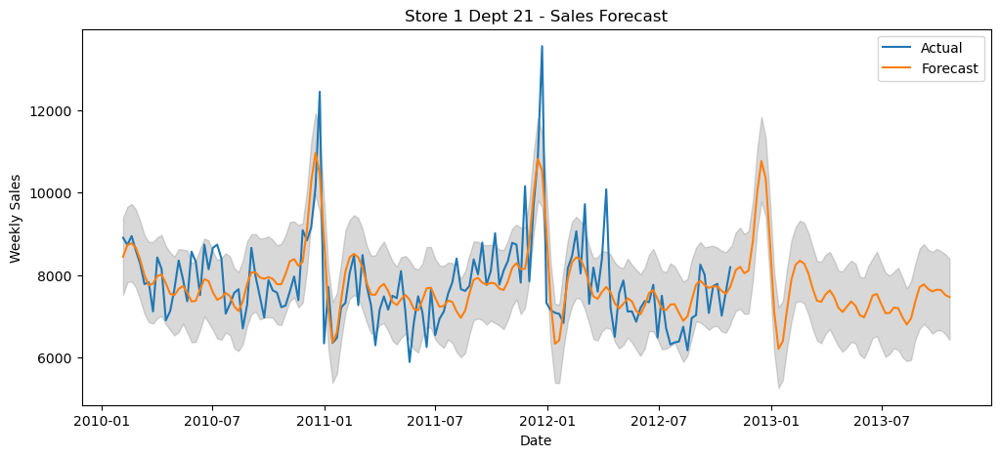

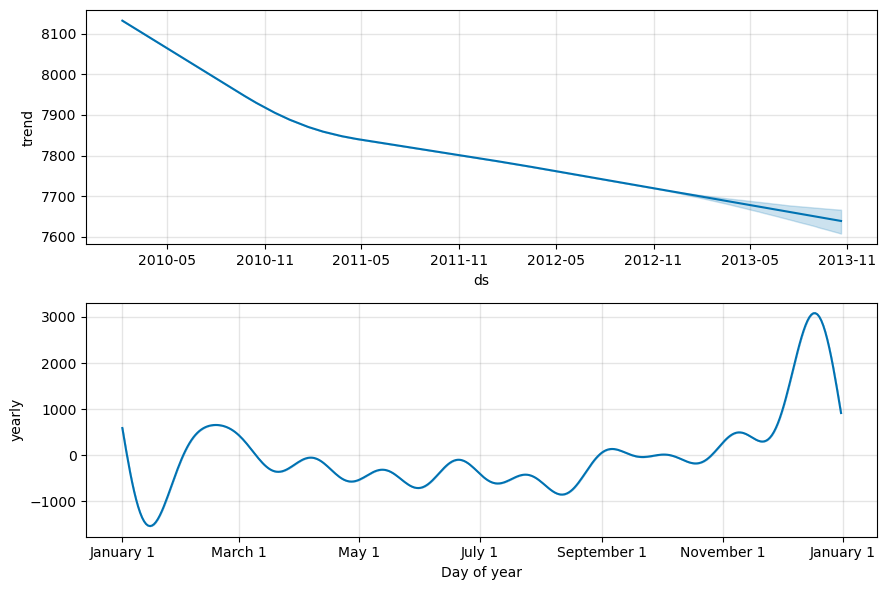


Forecasting for Store 1, Department 22


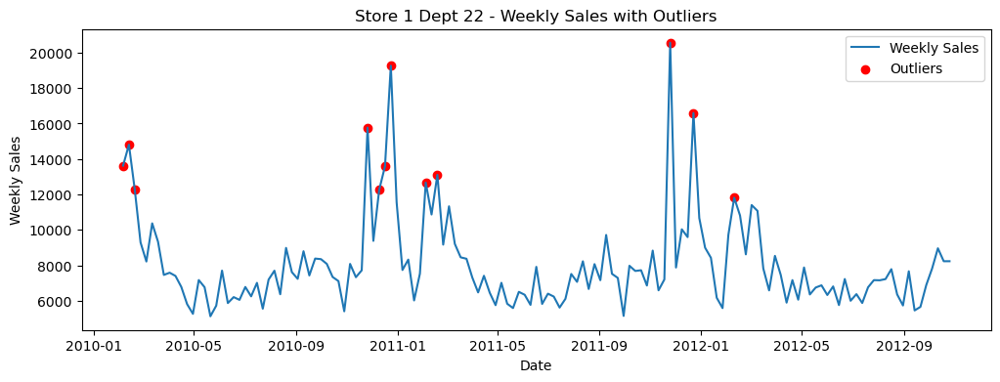

12:11:44 - cmdstanpy - INFO - Chain [1] start processing
12:11:44 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 22 - MAE: 1030.95, RMSE: 1499.91


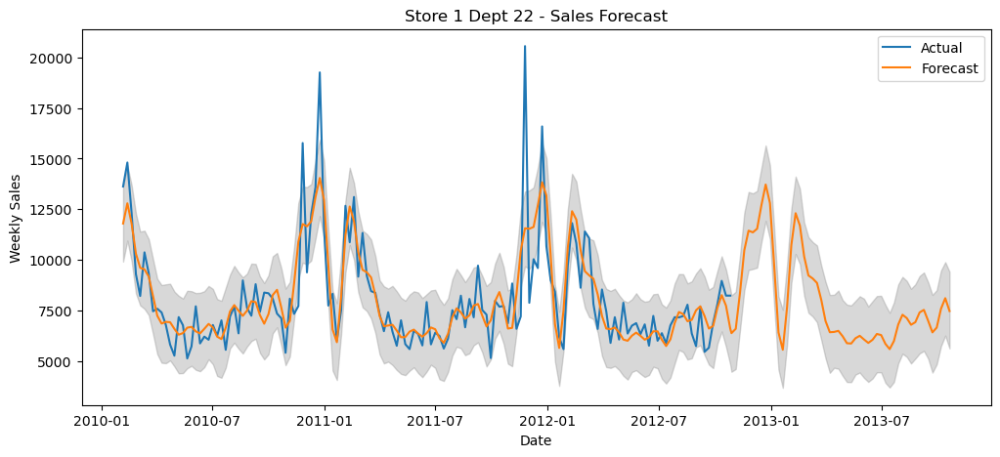

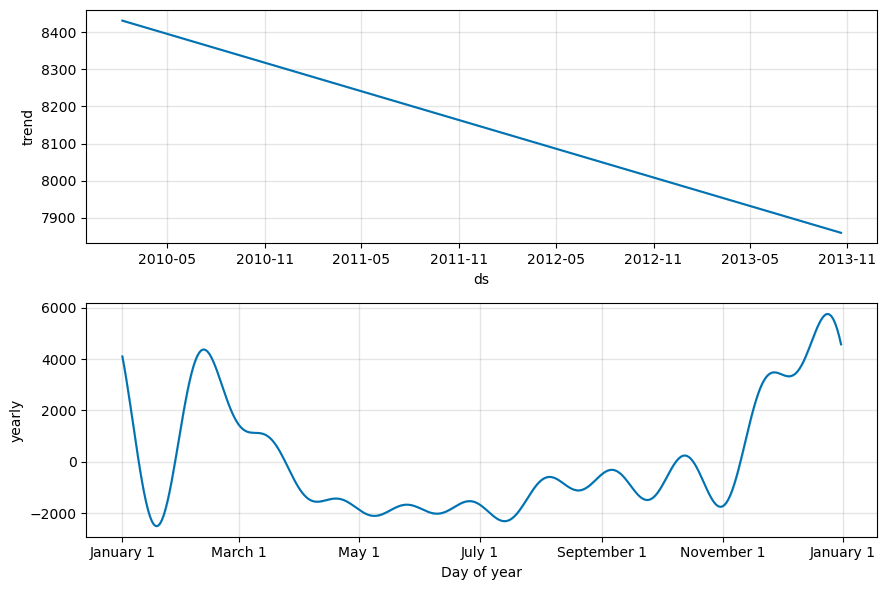


Forecasting for Store 1, Department 23


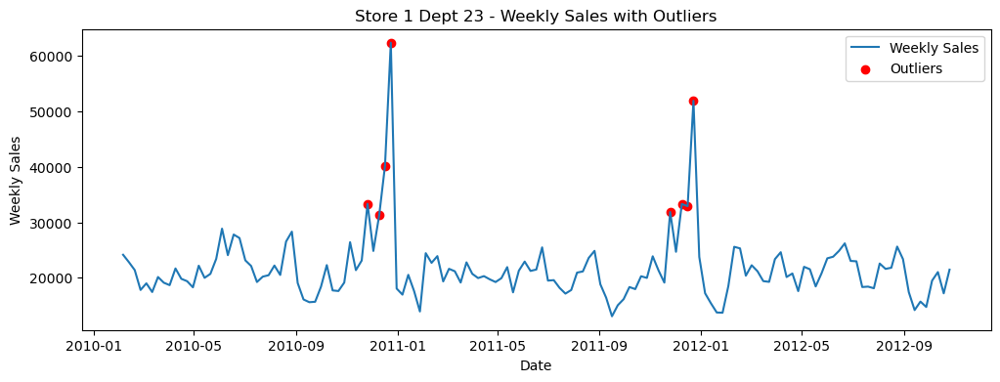

12:11:47 - cmdstanpy - INFO - Chain [1] start processing
12:11:47 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 23 - MAE: 2100.12, RMSE: 3392.35


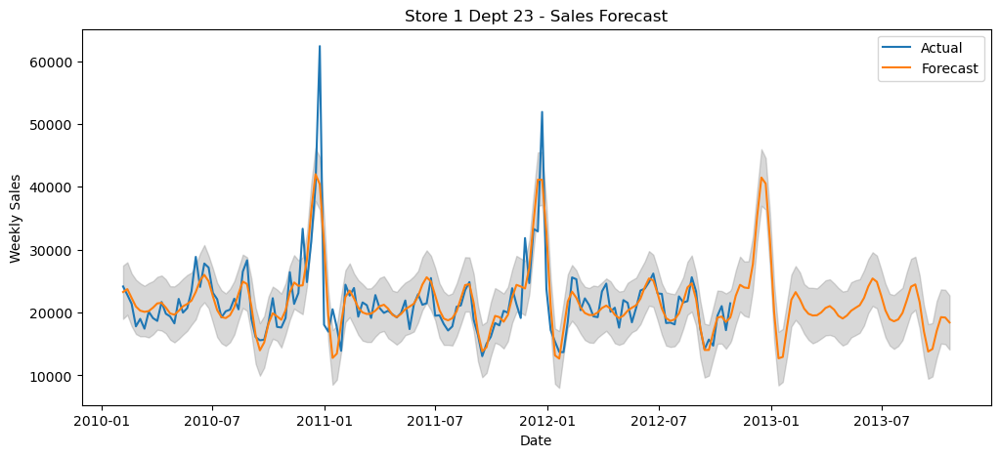

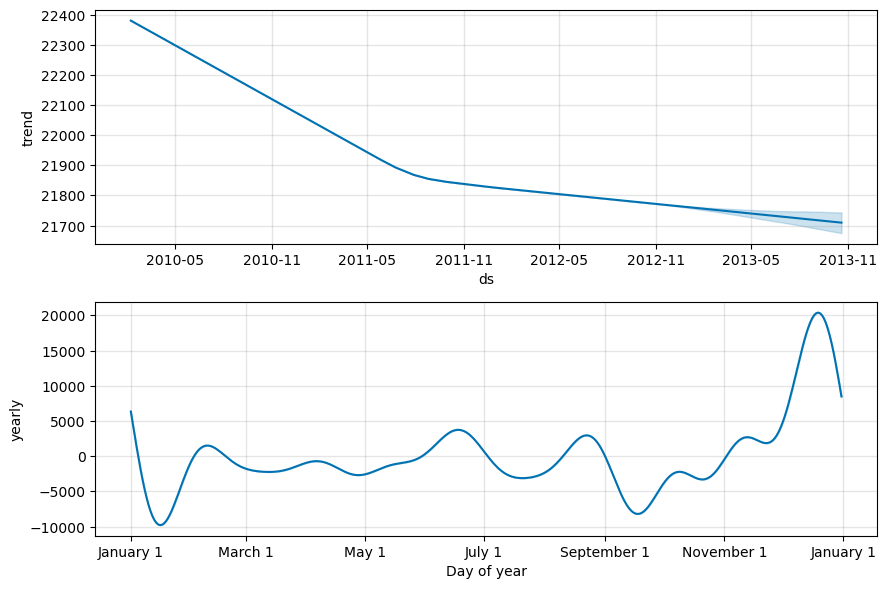


Forecasting for Store 1, Department 24


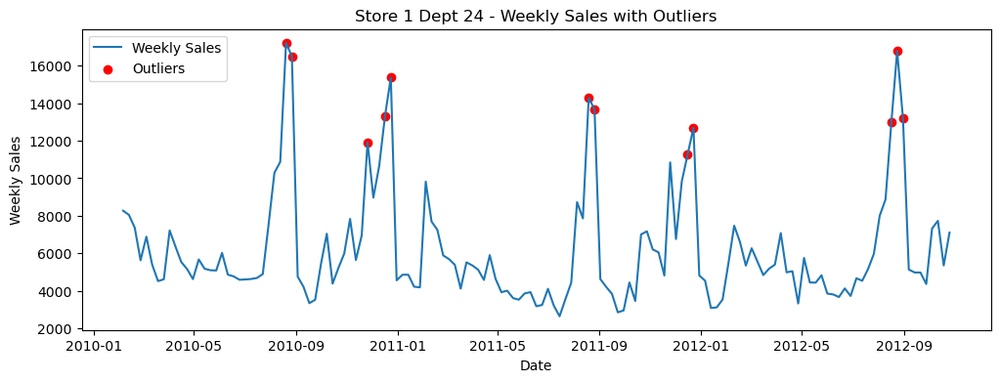

12:11:48 - cmdstanpy - INFO - Chain [1] start processing
12:11:49 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 24 - MAE: 955.86, RMSE: 1356.07


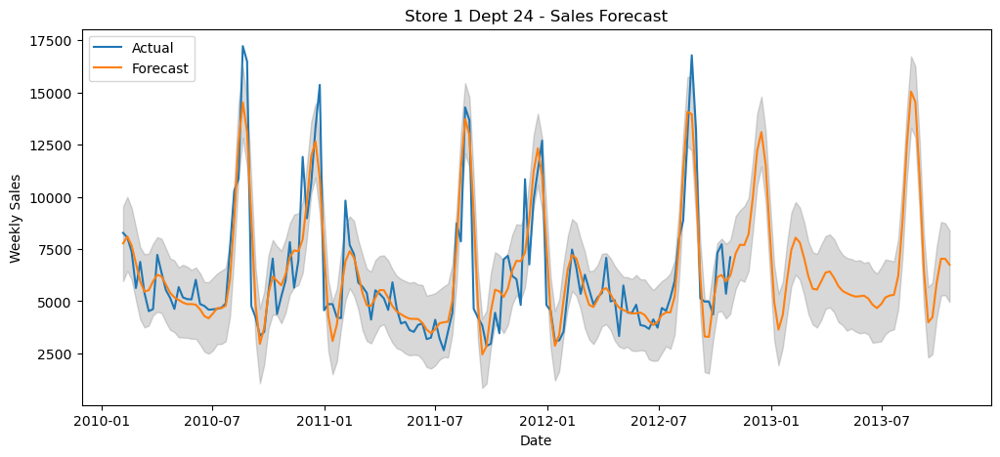

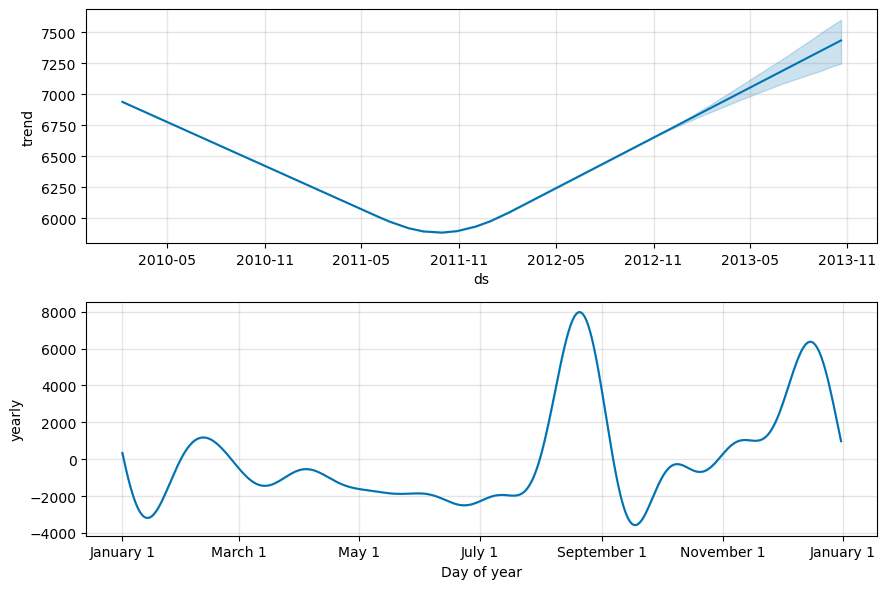


Forecasting for Store 1, Department 25


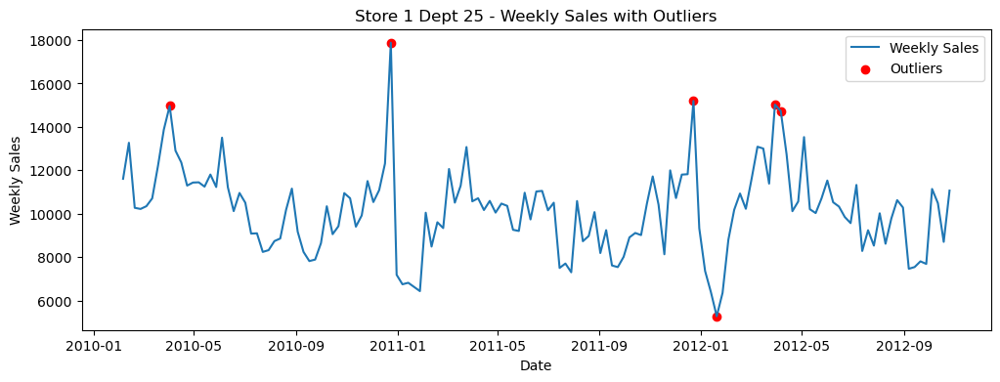

12:11:50 - cmdstanpy - INFO - Chain [1] start processing
12:11:50 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 25 - MAE: 821.35, RMSE: 1094.37


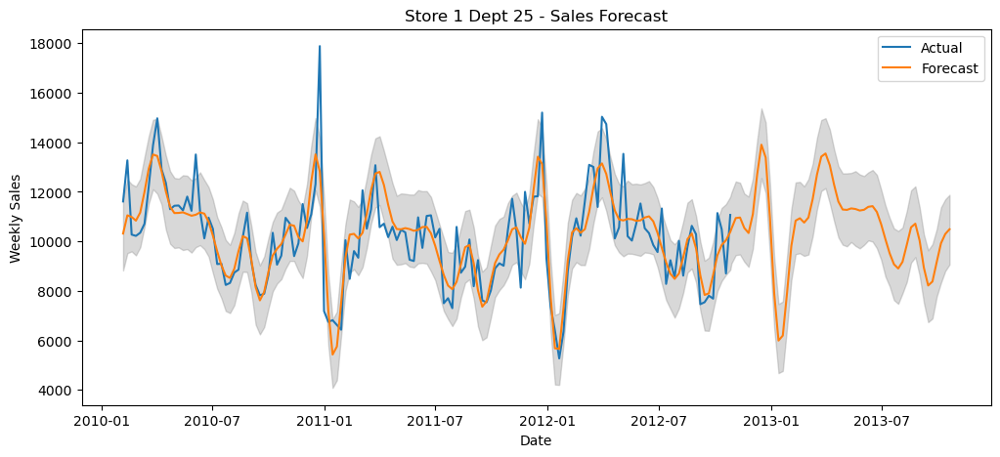

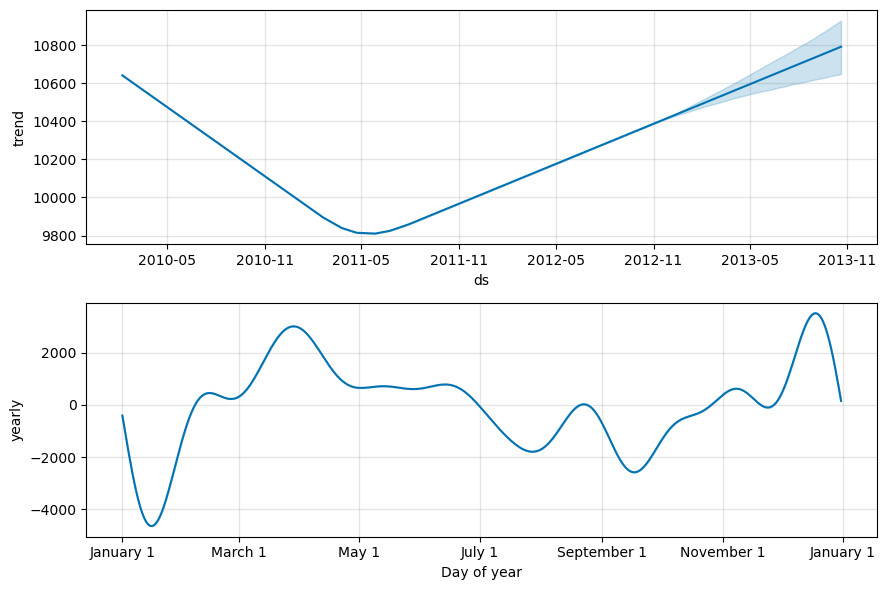


Forecasting for Store 1, Department 26


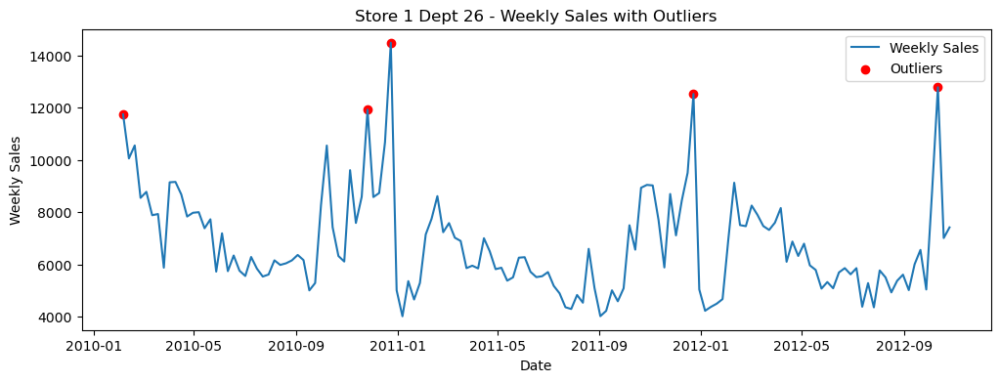

12:11:52 - cmdstanpy - INFO - Chain [1] start processing
12:11:52 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 26 - MAE: 779.27, RMSE: 1079.36


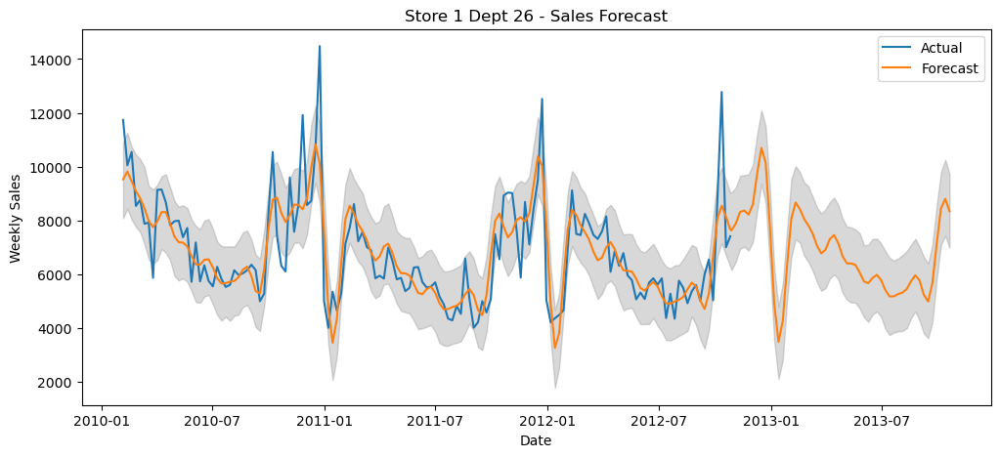

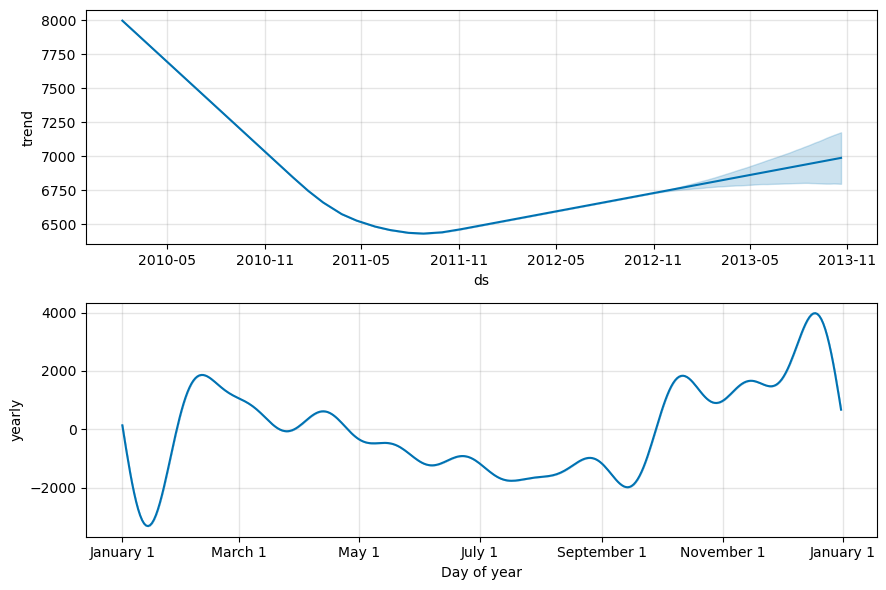


Forecasting for Store 1, Department 27


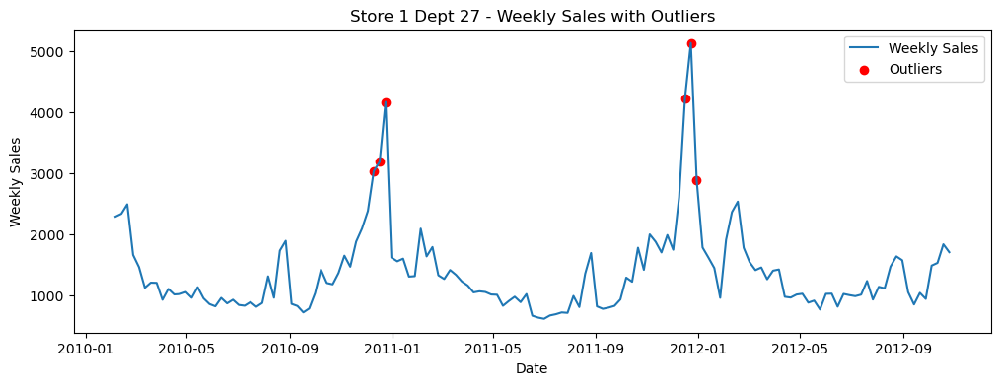

12:11:54 - cmdstanpy - INFO - Chain [1] start processing
12:11:54 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 27 - MAE: 168.90, RMSE: 249.23


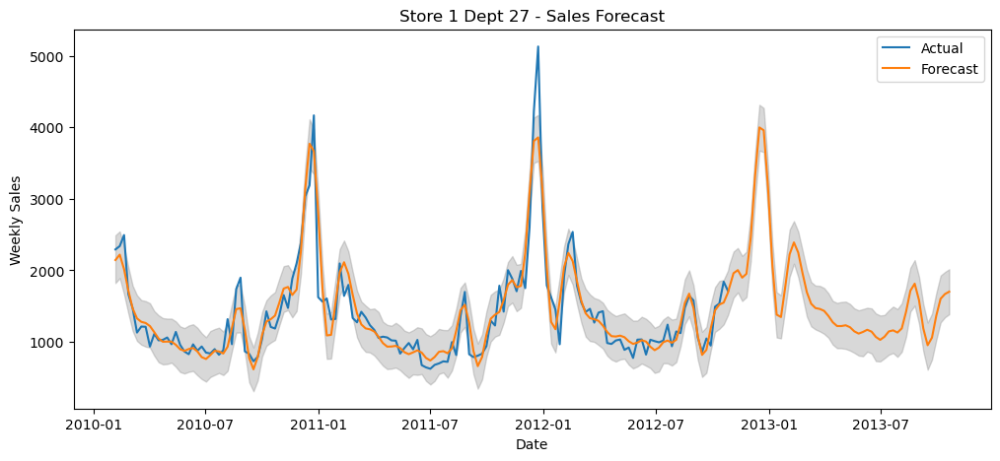

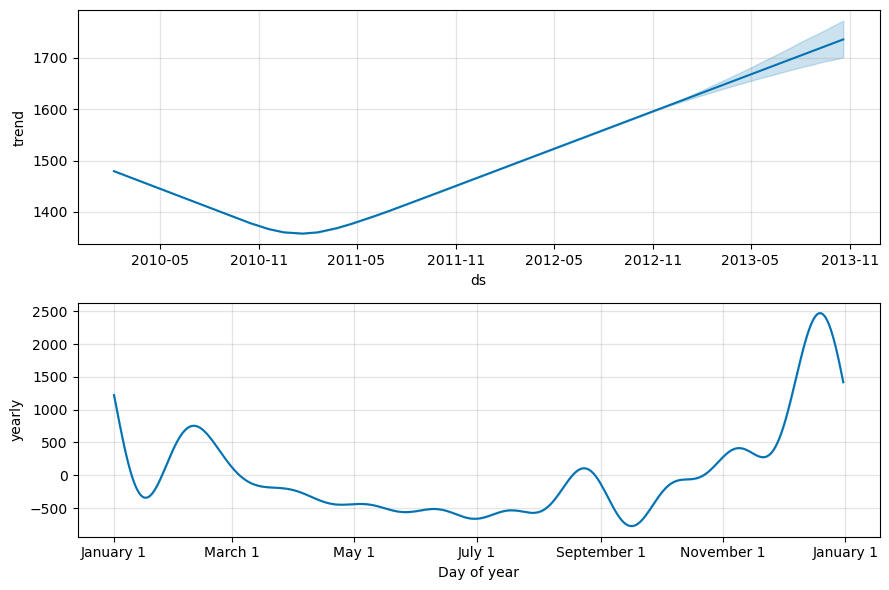


Forecasting for Store 1, Department 28


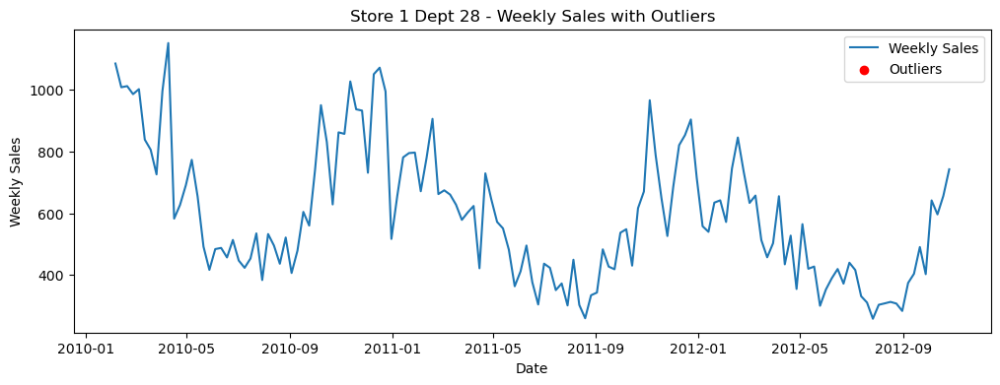

12:11:56 - cmdstanpy - INFO - Chain [1] start processing
12:11:56 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 28 - MAE: 68.00, RMSE: 86.29


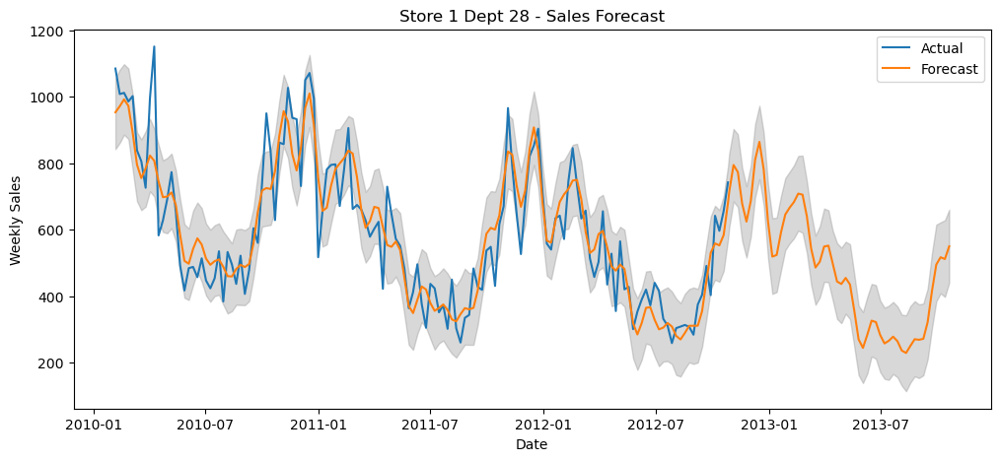

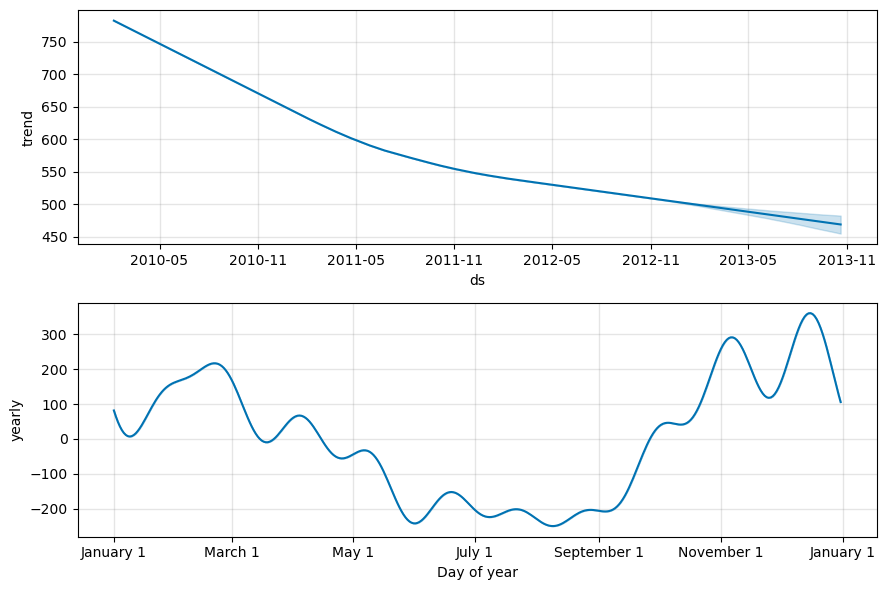


Forecasting for Store 1, Department 29


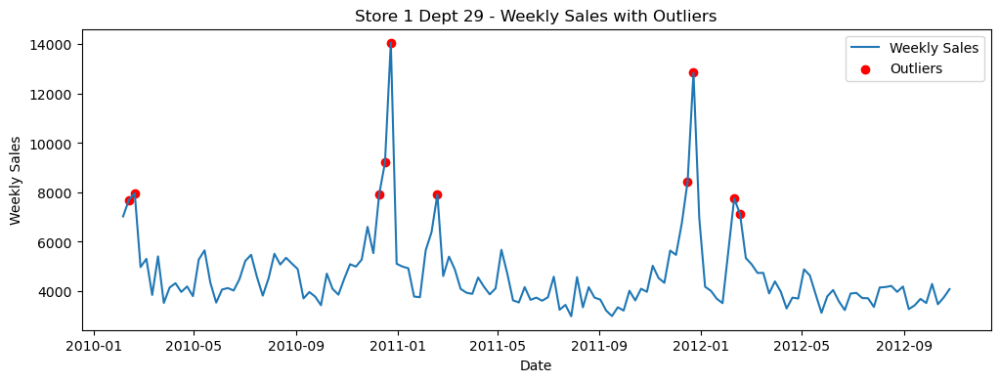

12:11:58 - cmdstanpy - INFO - Chain [1] start processing
12:11:58 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 29 - MAE: 511.28, RMSE: 739.27


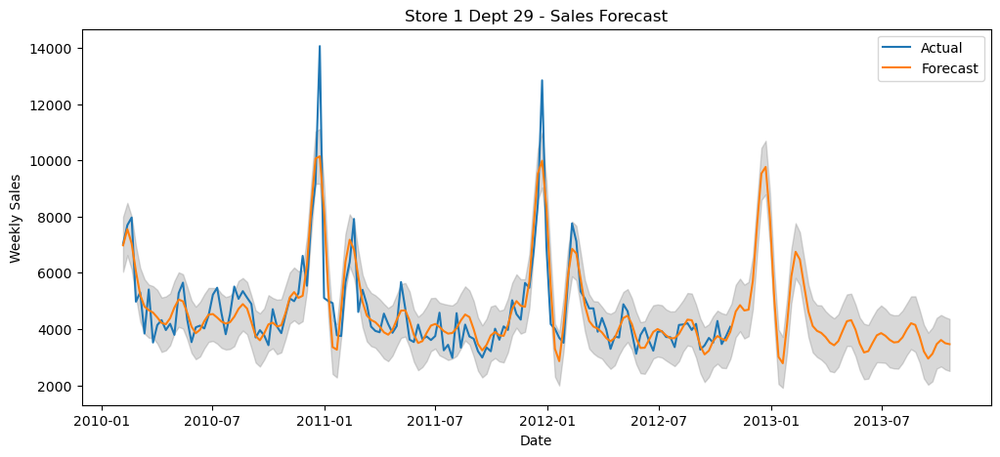

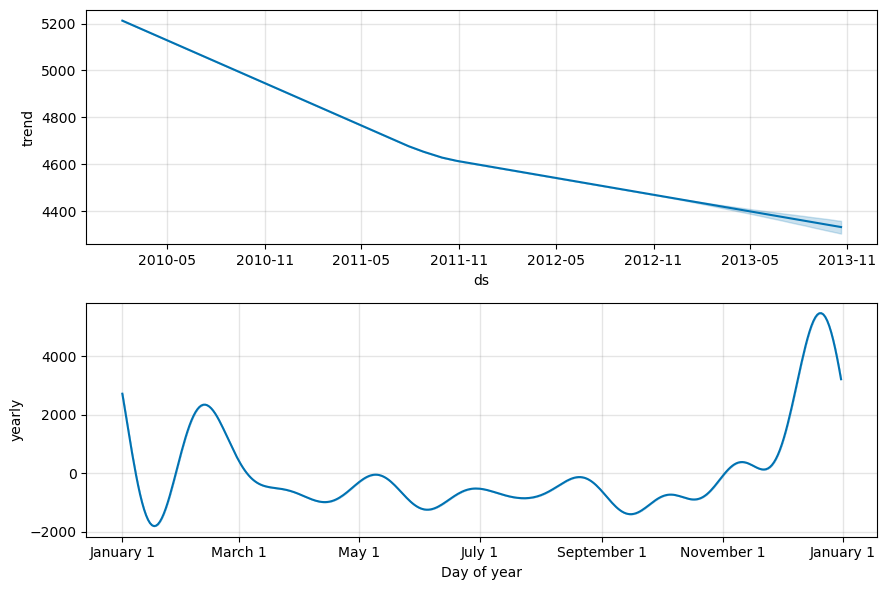


Forecasting for Store 1, Department 30


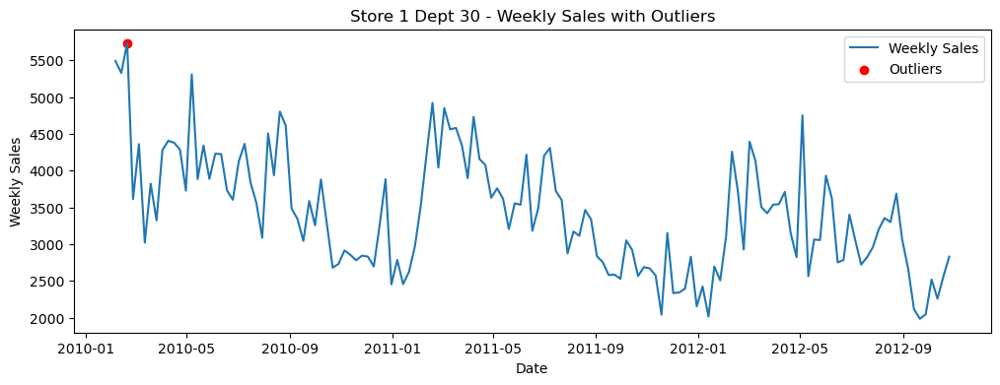

12:11:59 - cmdstanpy - INFO - Chain [1] start processing
12:12:00 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 30 - MAE: 315.95, RMSE: 423.58


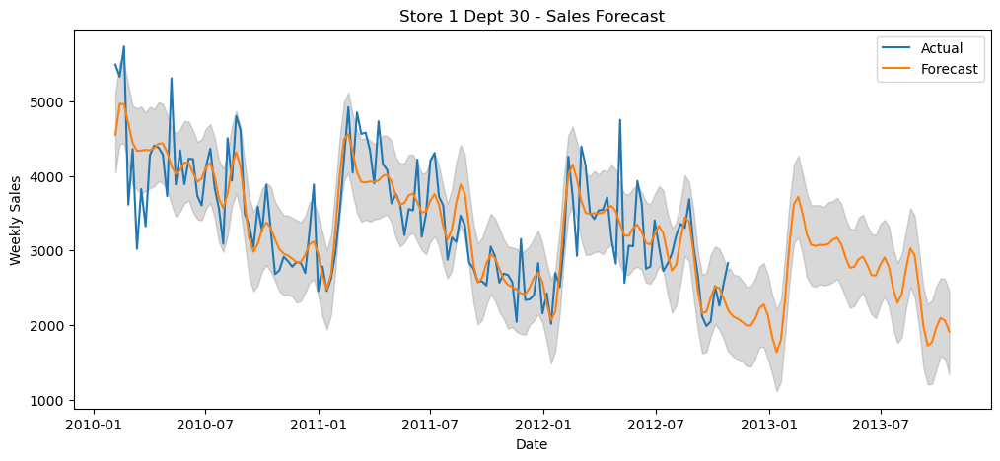

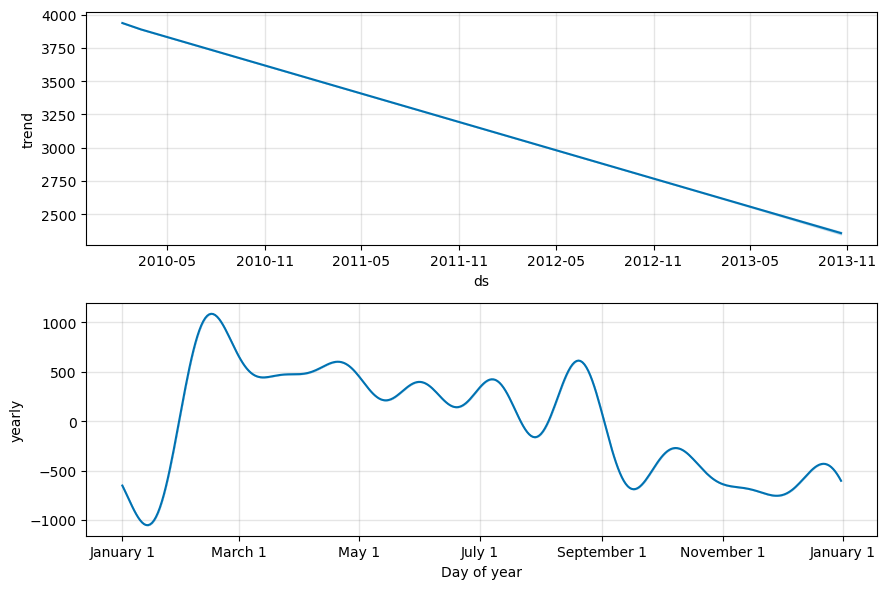


Forecasting for Store 1, Department 31


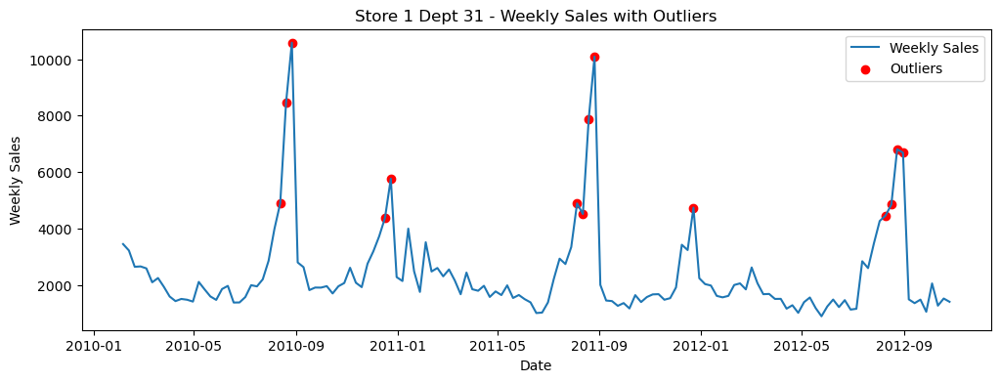

12:12:02 - cmdstanpy - INFO - Chain [1] start processing
12:12:02 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 31 - MAE: 453.55, RMSE: 720.91


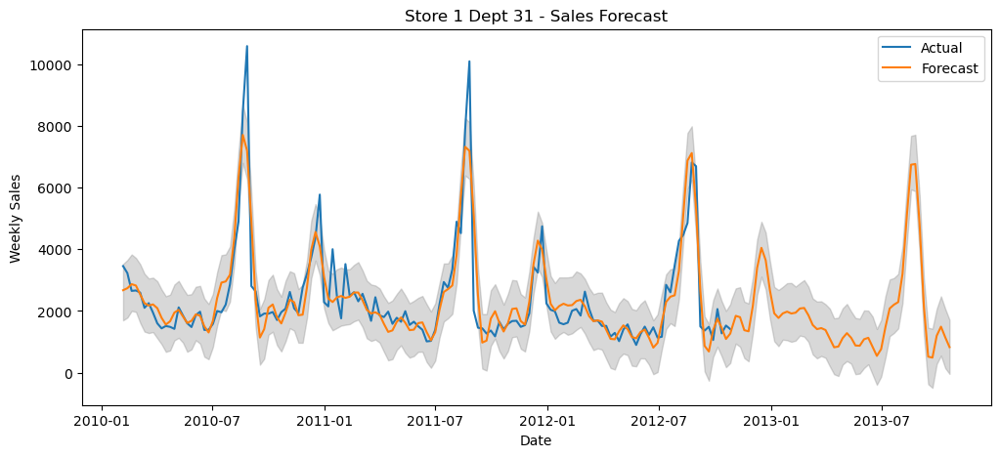

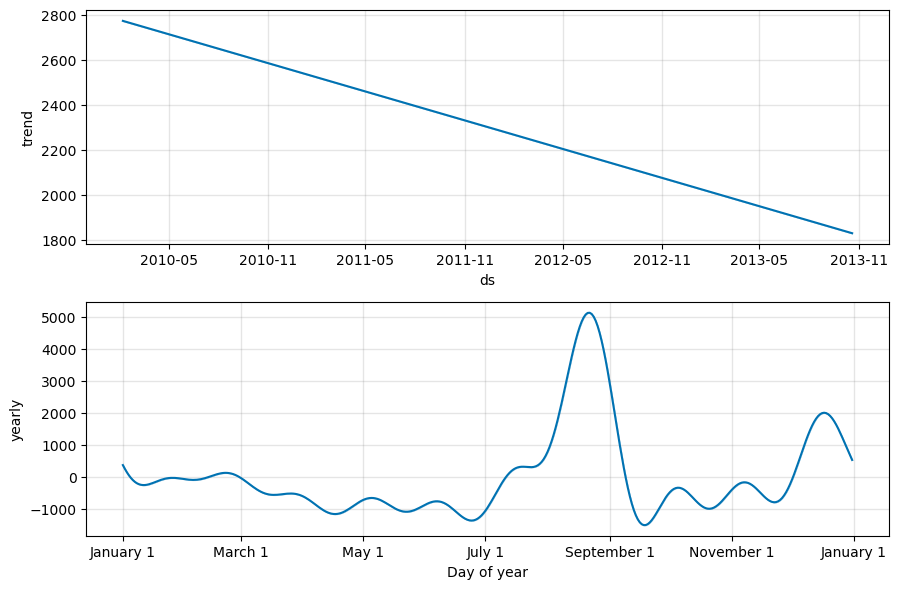


Forecasting for Store 1, Department 32


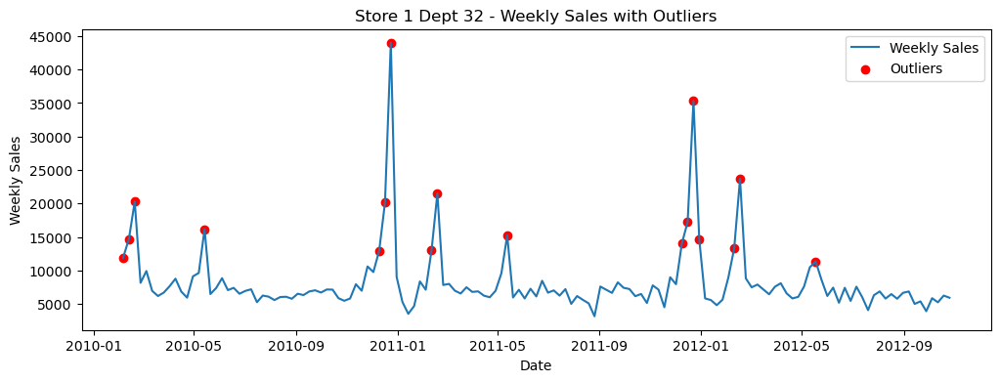

12:12:04 - cmdstanpy - INFO - Chain [1] start processing
12:12:04 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 32 - MAE: 1647.64, RMSE: 2846.02


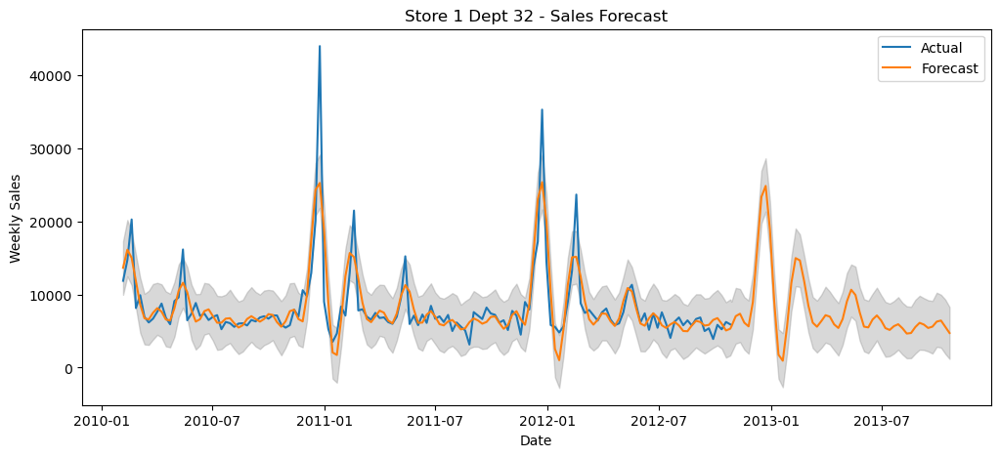

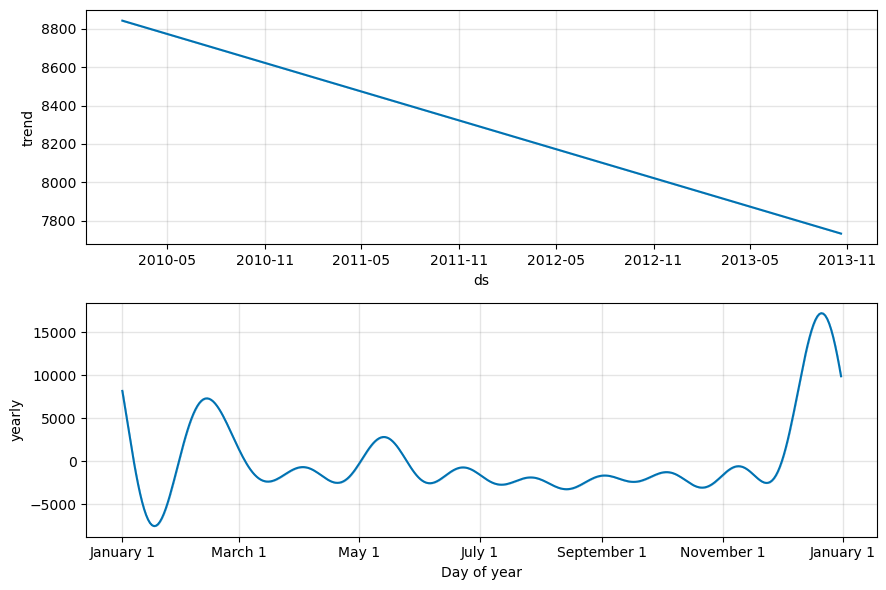


Forecasting for Store 1, Department 33


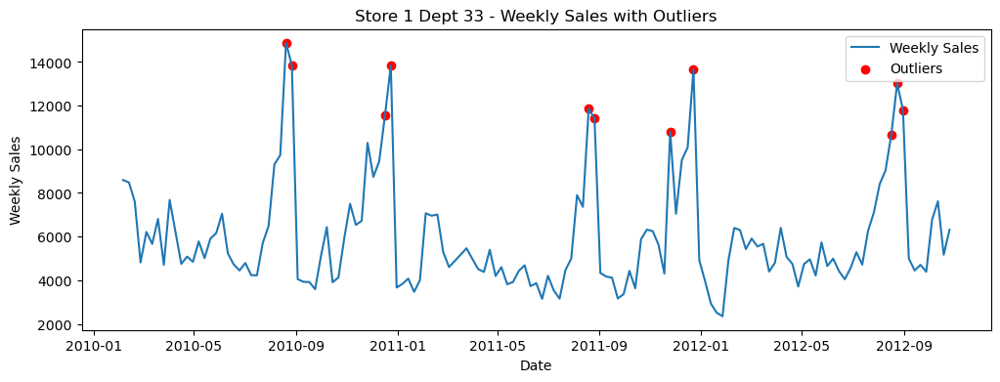

12:12:05 - cmdstanpy - INFO - Chain [1] start processing
12:12:05 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 33 - MAE: 845.31, RMSE: 1181.64


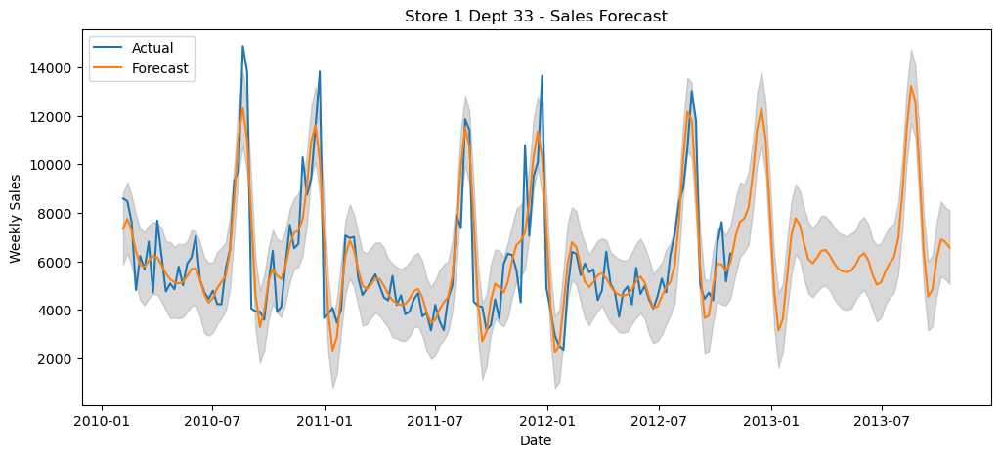

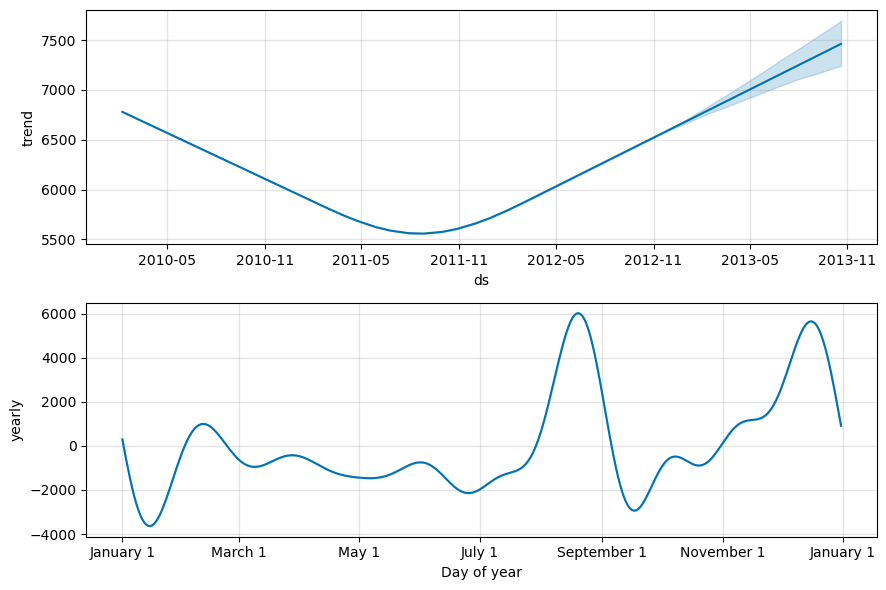


Forecasting for Store 1, Department 34


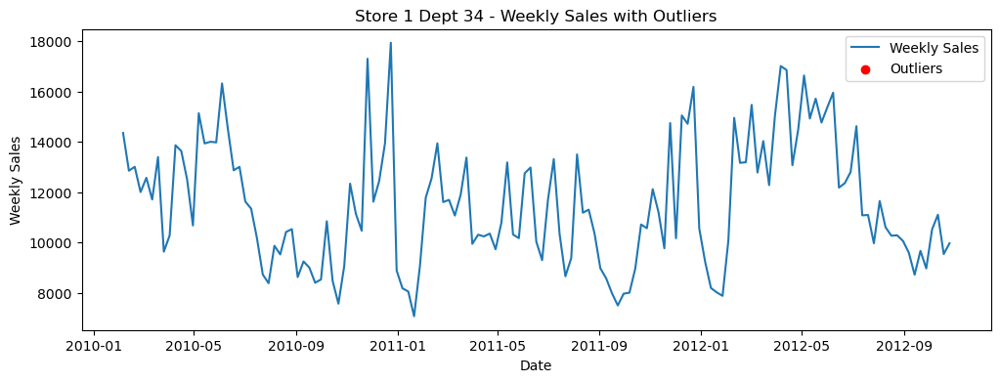

12:12:07 - cmdstanpy - INFO - Chain [1] start processing
12:12:07 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 34 - MAE: 1114.92, RMSE: 1484.68


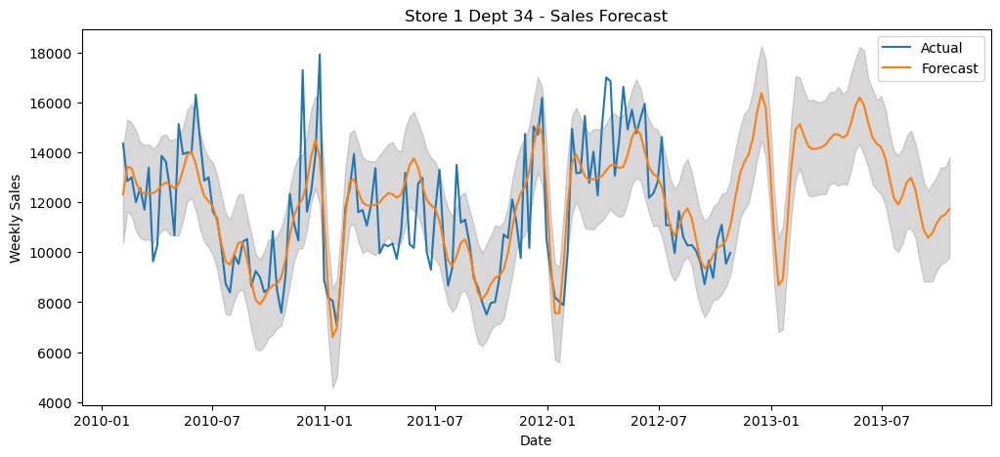

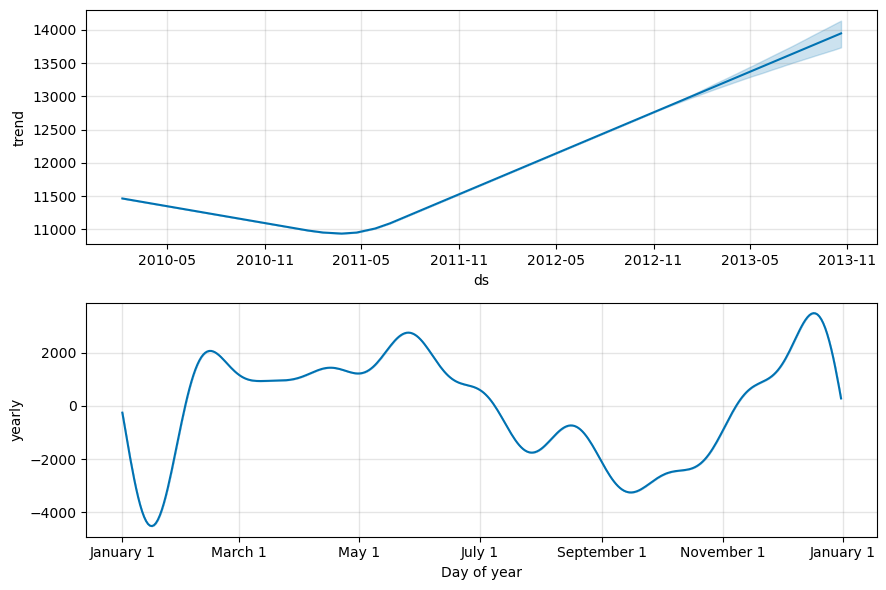


Forecasting for Store 1, Department 35


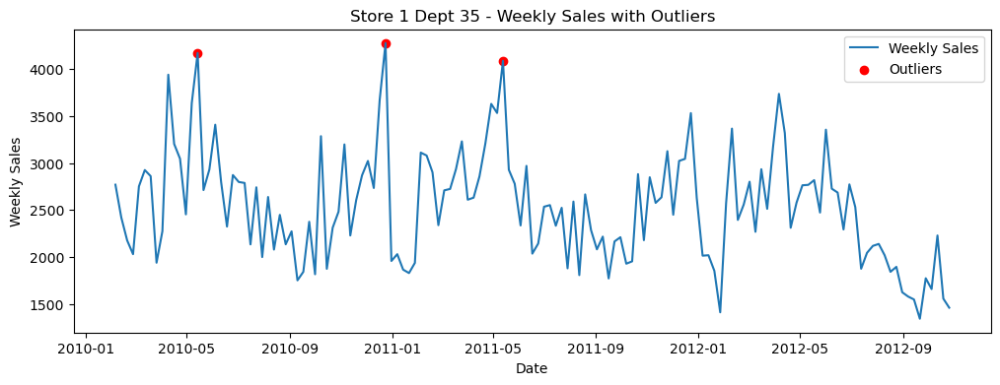

12:12:09 - cmdstanpy - INFO - Chain [1] start processing
12:12:09 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 35 - MAE: 310.03, RMSE: 384.41


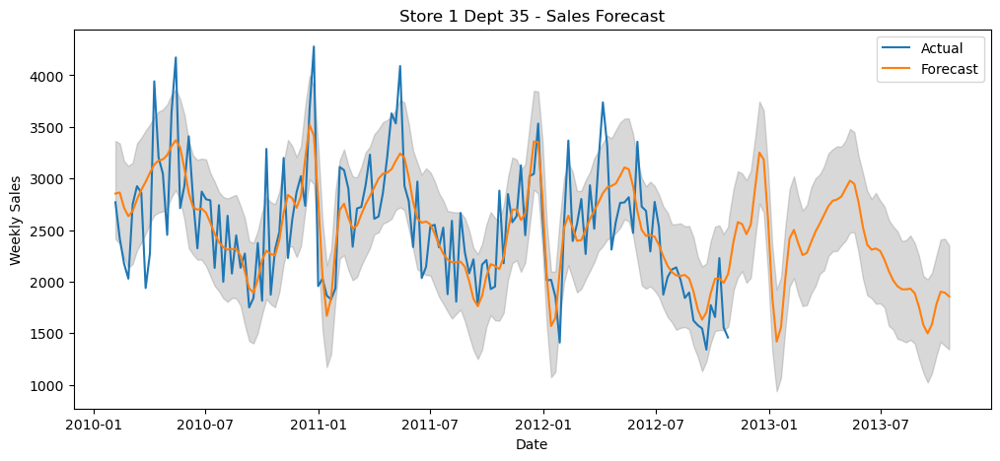

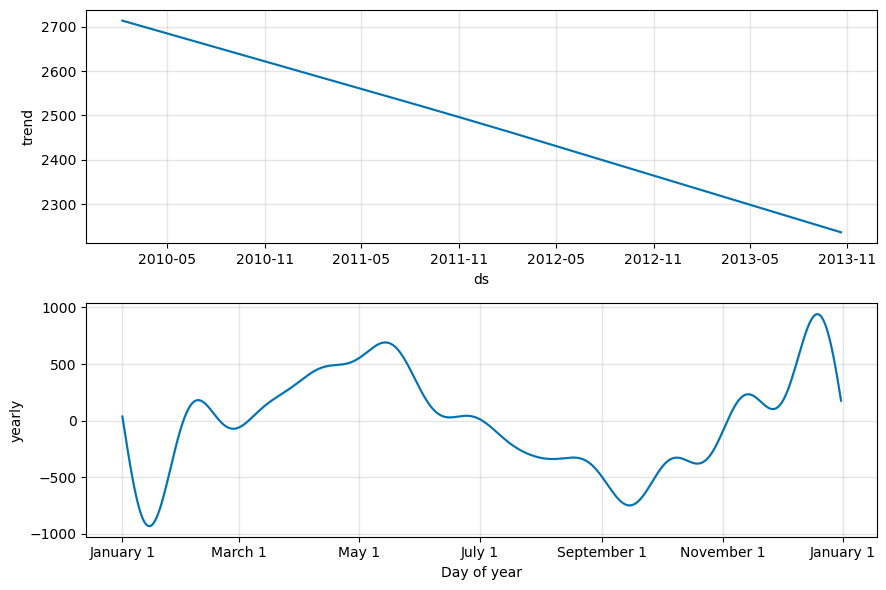


Forecasting for Store 1, Department 36


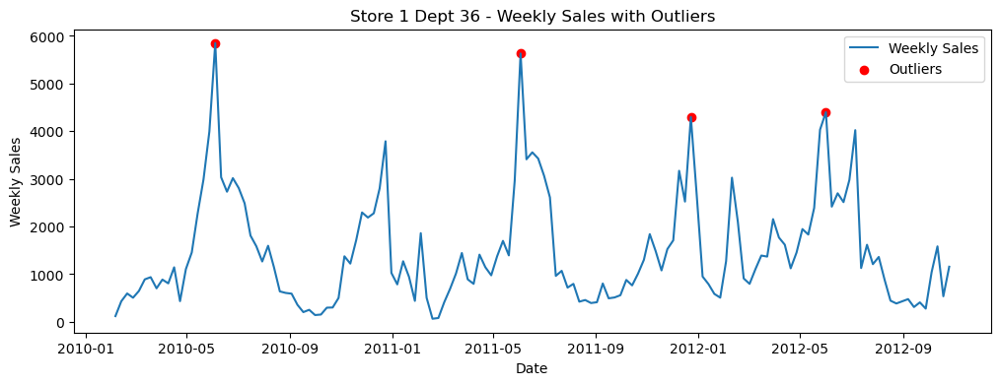

12:12:11 - cmdstanpy - INFO - Chain [1] start processing
12:12:11 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 36 - MAE: 380.83, RMSE: 527.65


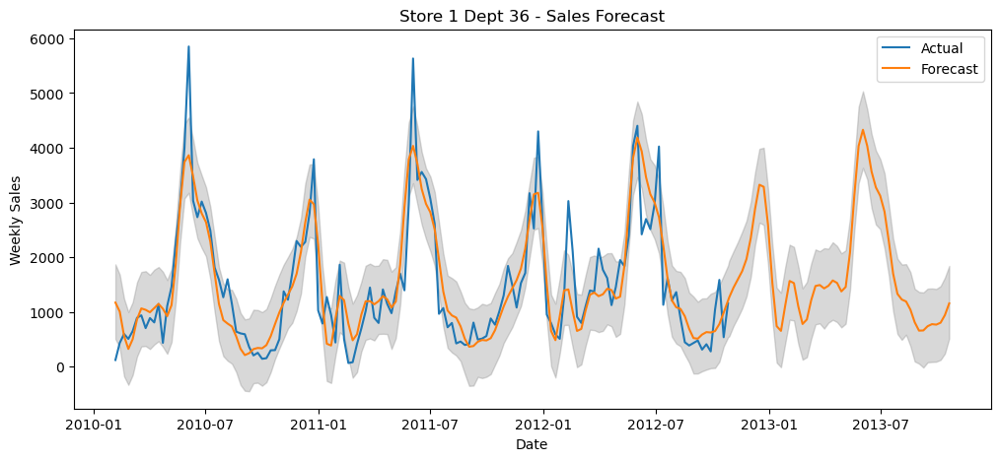

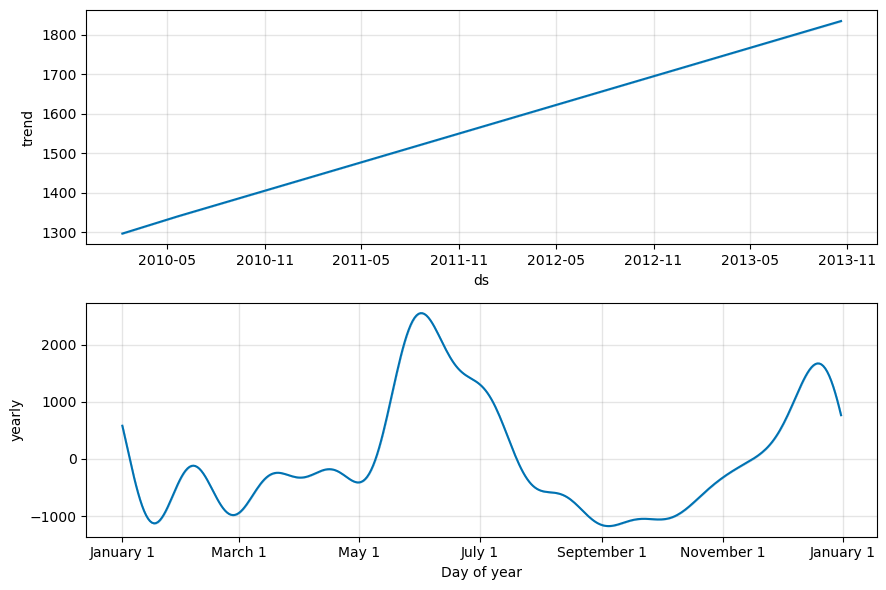


Forecasting for Store 1, Department 37


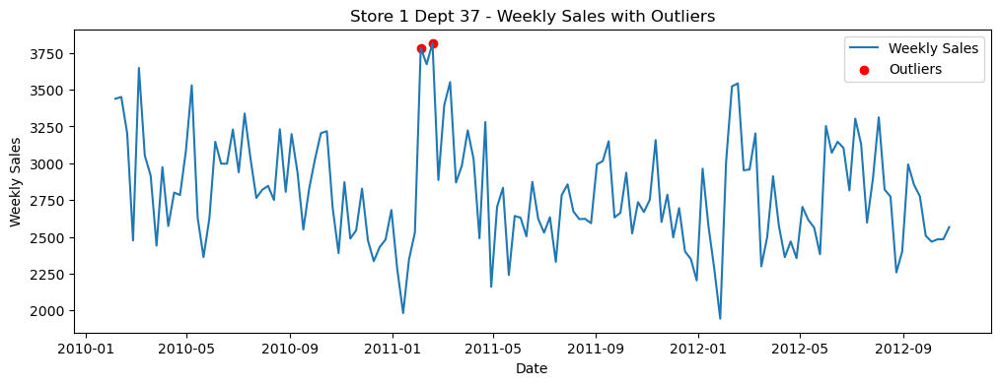

12:12:13 - cmdstanpy - INFO - Chain [1] start processing
12:12:13 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 37 - MAE: 217.74, RMSE: 278.42


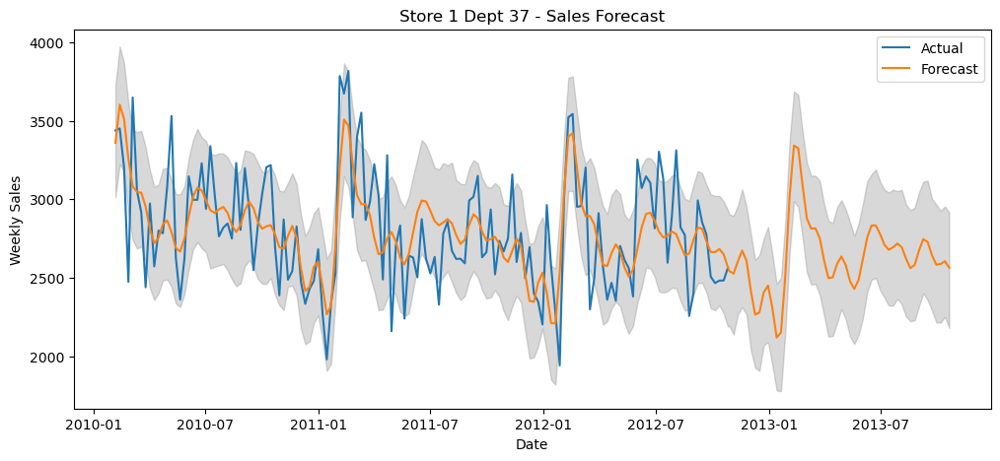

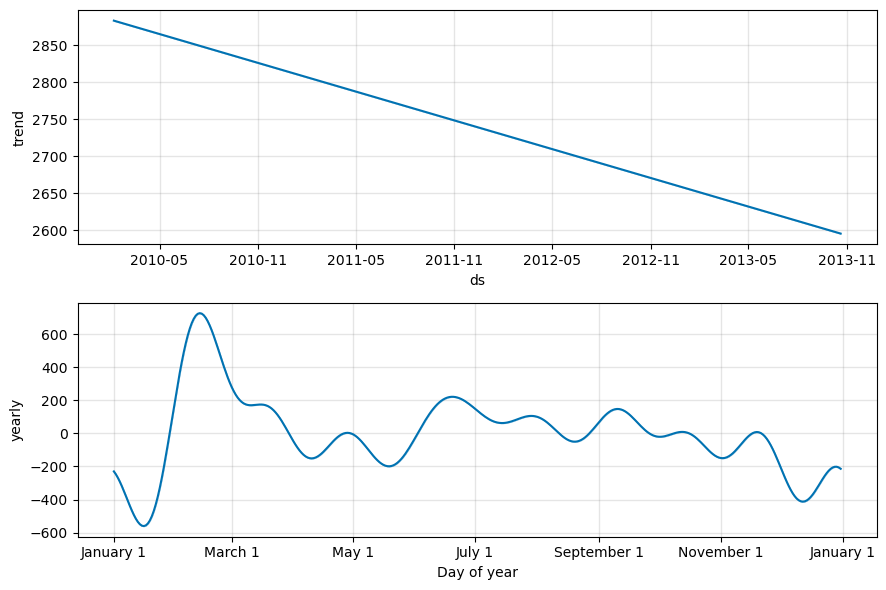


Forecasting for Store 1, Department 38


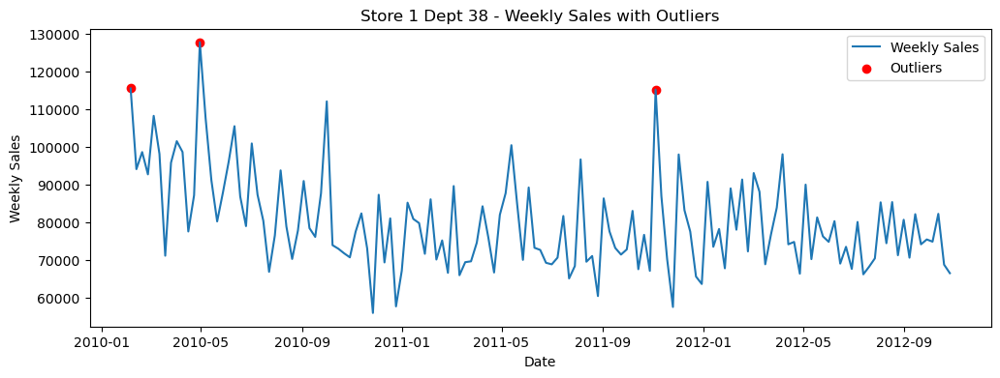

12:12:15 - cmdstanpy - INFO - Chain [1] start processing
12:12:15 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 38 - MAE: 7931.25, RMSE: 10084.34


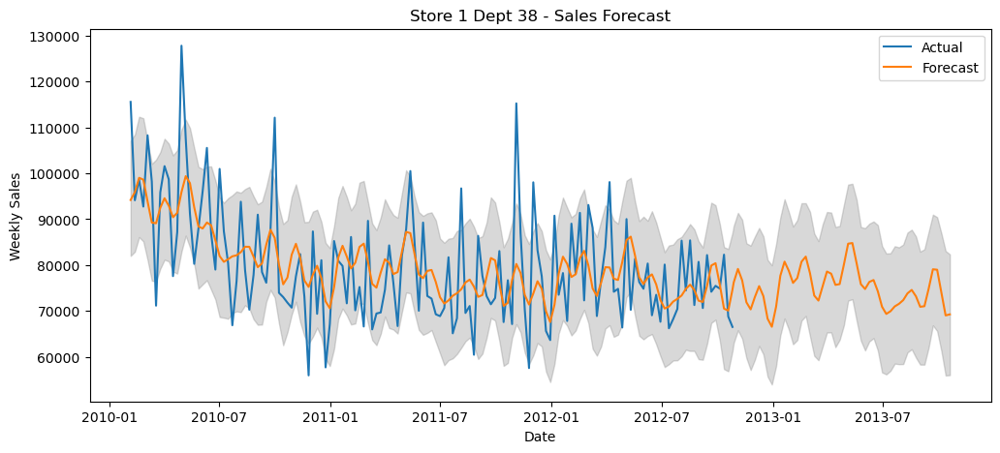

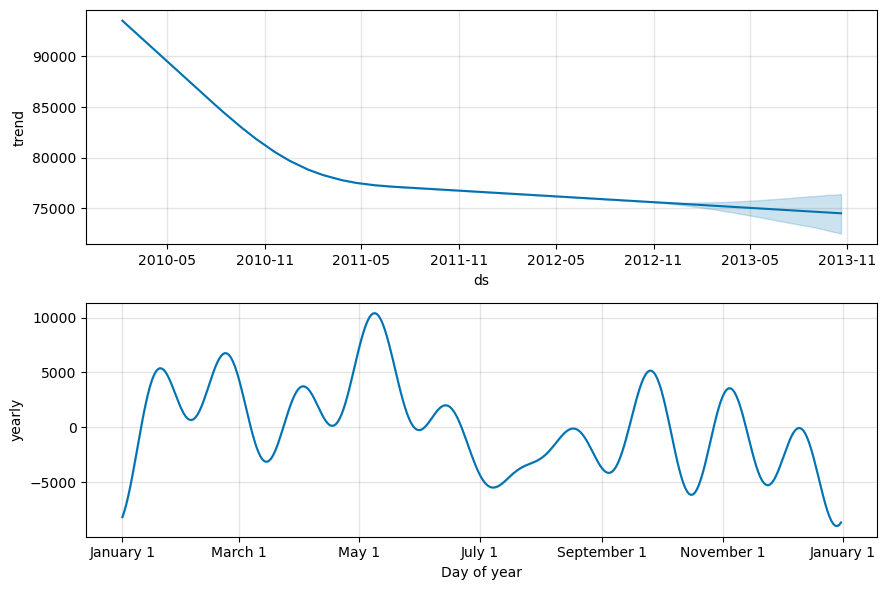


Forecasting for Store 1, Department 40


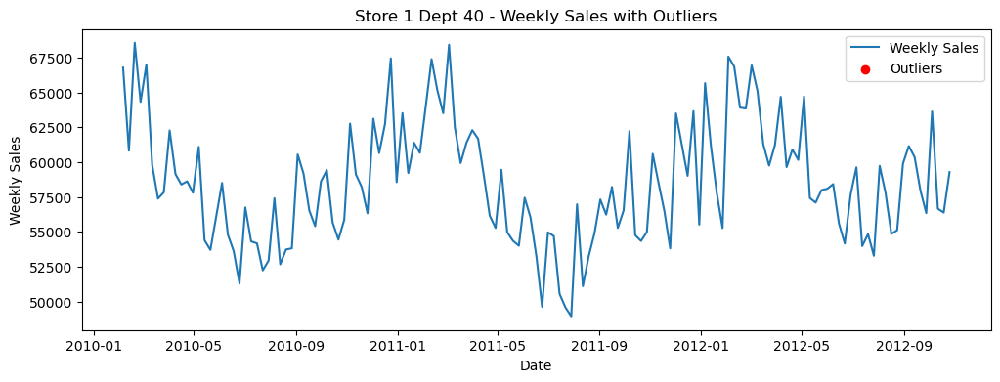

12:12:17 - cmdstanpy - INFO - Chain [1] start processing
12:12:17 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 40 - MAE: 2028.78, RMSE: 2483.59


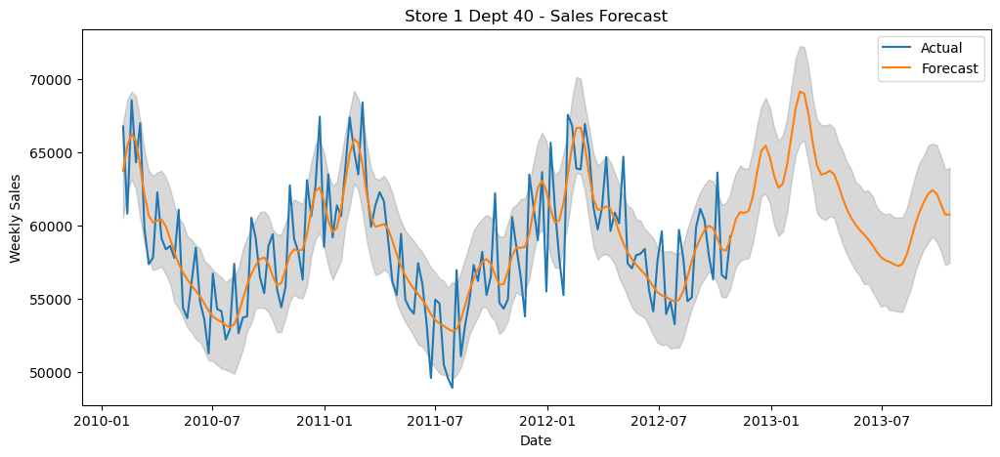

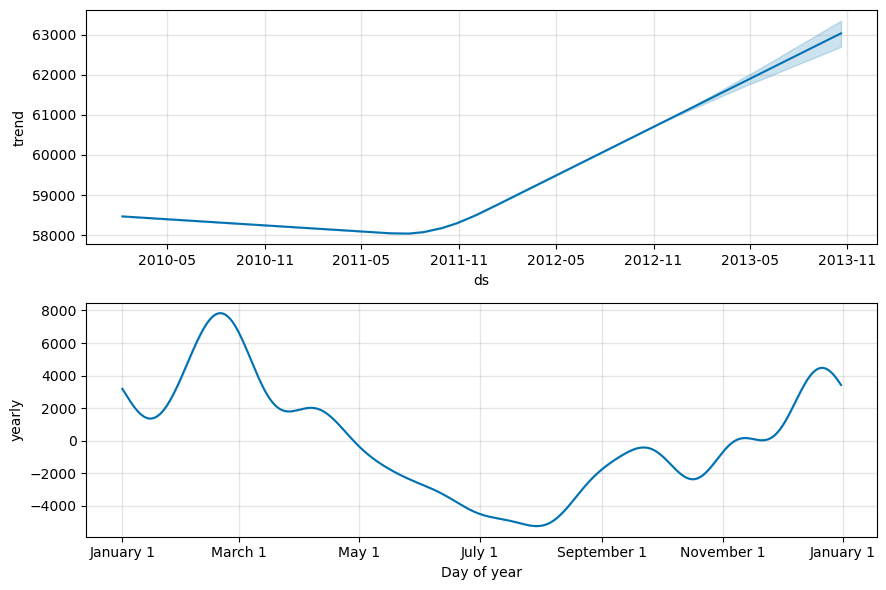


Forecasting for Store 1, Department 41


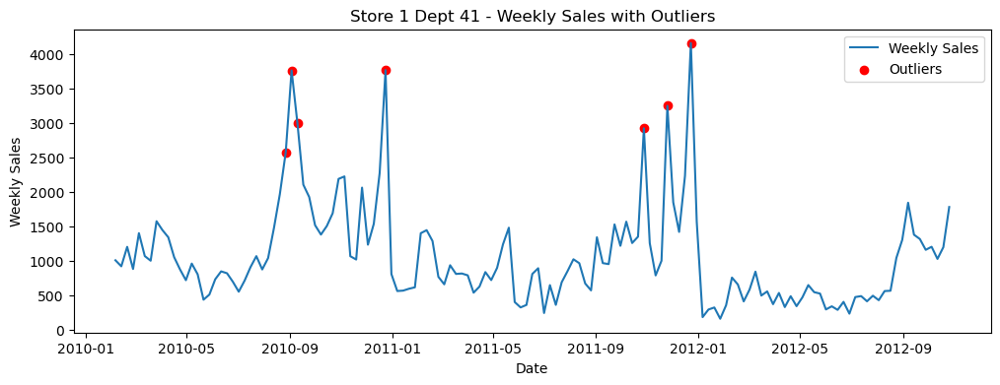

12:12:19 - cmdstanpy - INFO - Chain [1] start processing
12:12:19 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 41 - MAE: 292.72, RMSE: 436.29


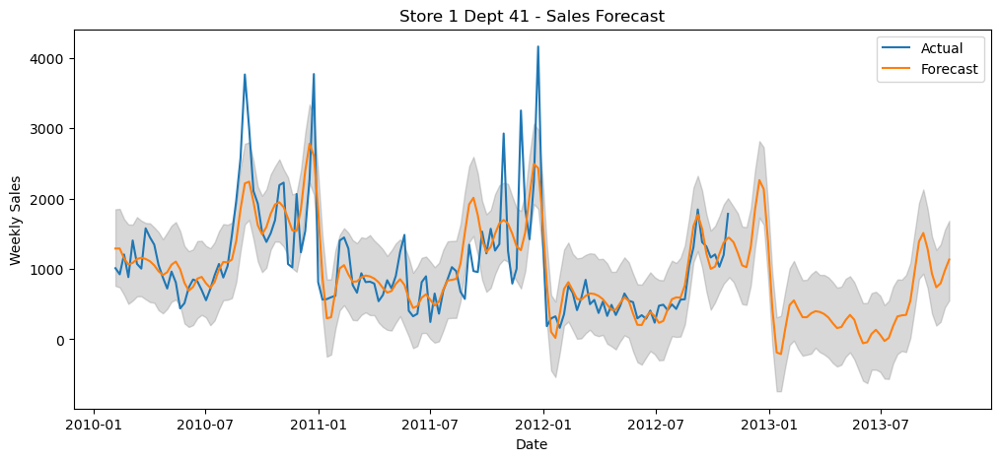

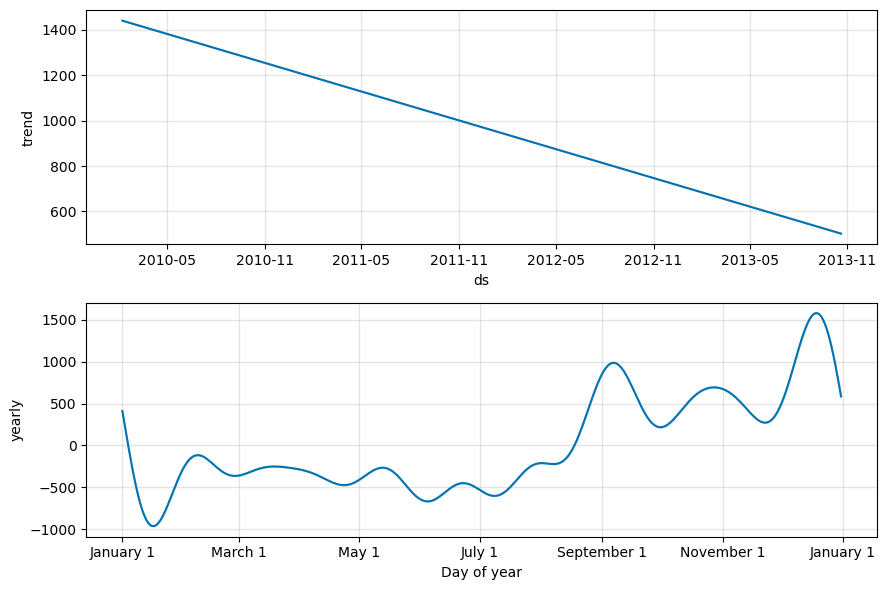


Forecasting for Store 1, Department 42


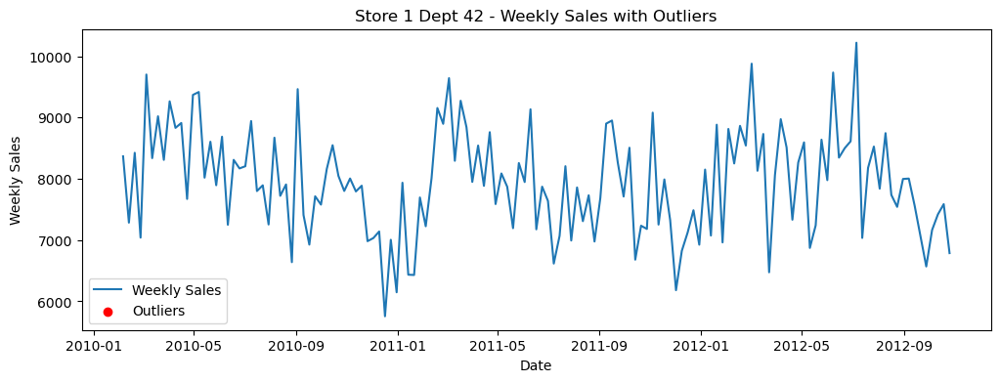

12:12:21 - cmdstanpy - INFO - Chain [1] start processing
12:12:21 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 42 - MAE: 543.27, RMSE: 698.87


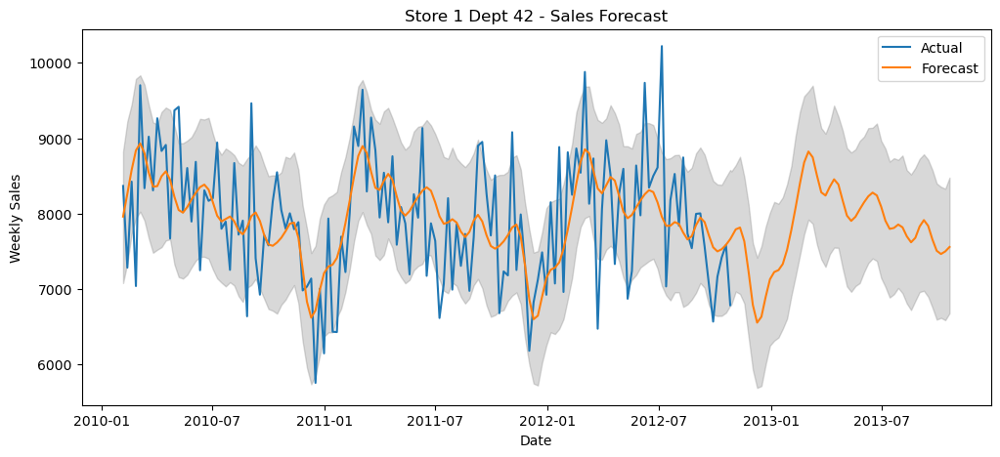

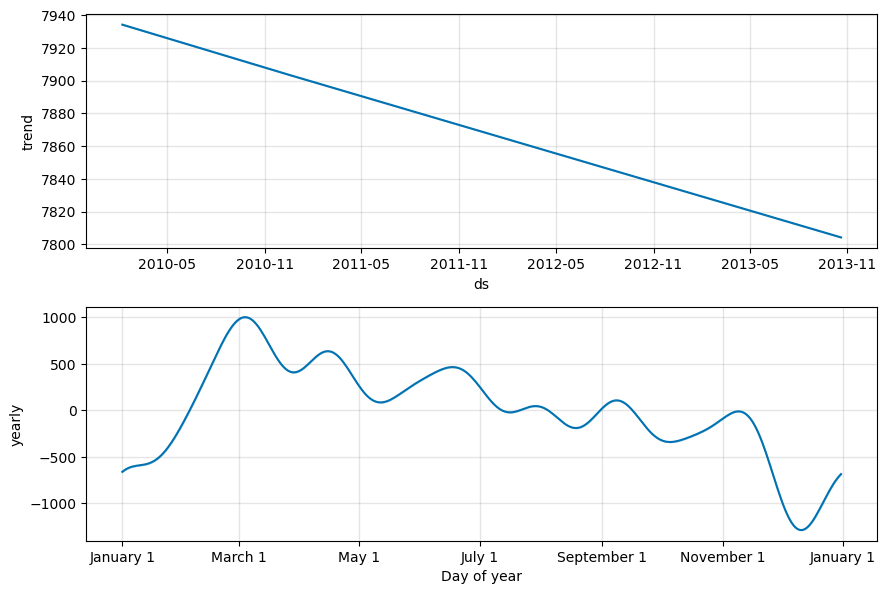


Forecasting for Store 1, Department 44


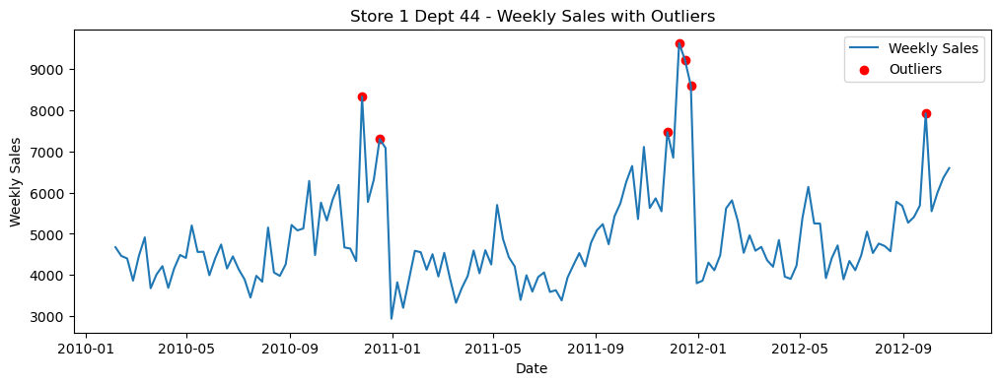

12:12:24 - cmdstanpy - INFO - Chain [1] start processing
12:12:24 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 44 - MAE: 418.54, RMSE: 580.78


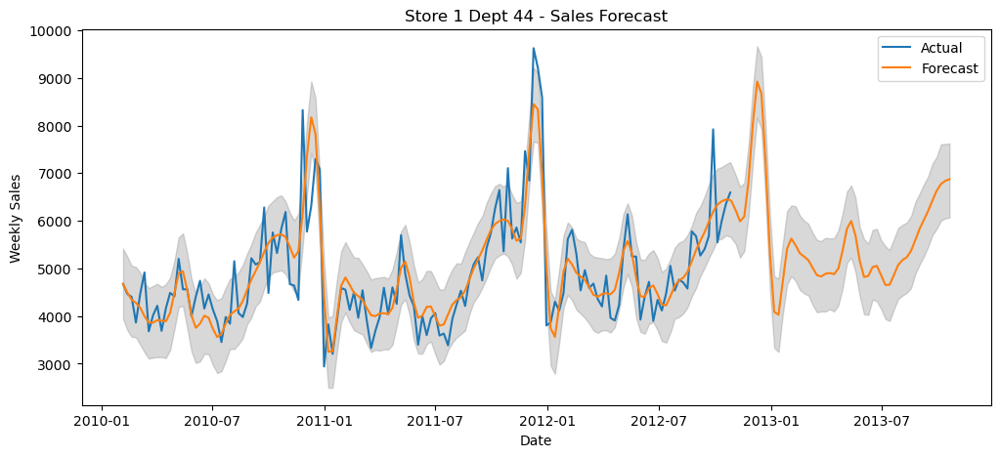

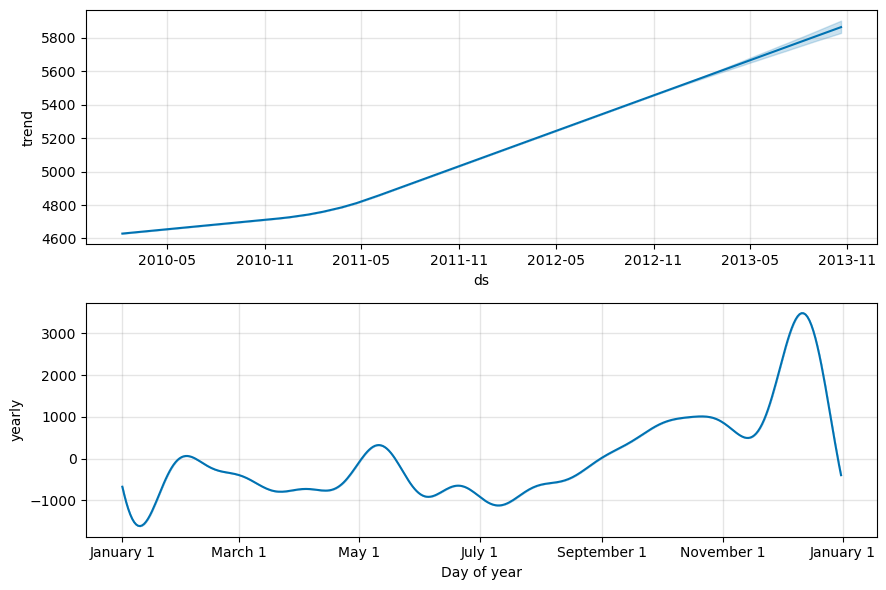


Forecasting for Store 1, Department 45


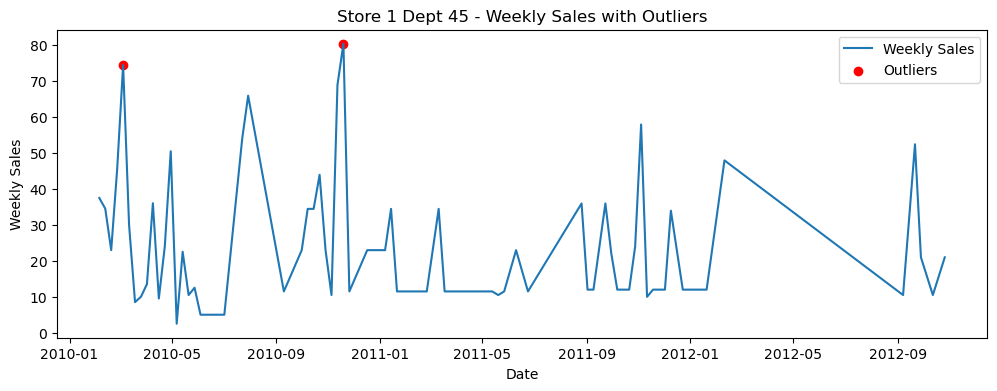

12:12:26 - cmdstanpy - INFO - Chain [1] start processing
12:12:26 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 45 - MAE: 10.56, RMSE: 13.93


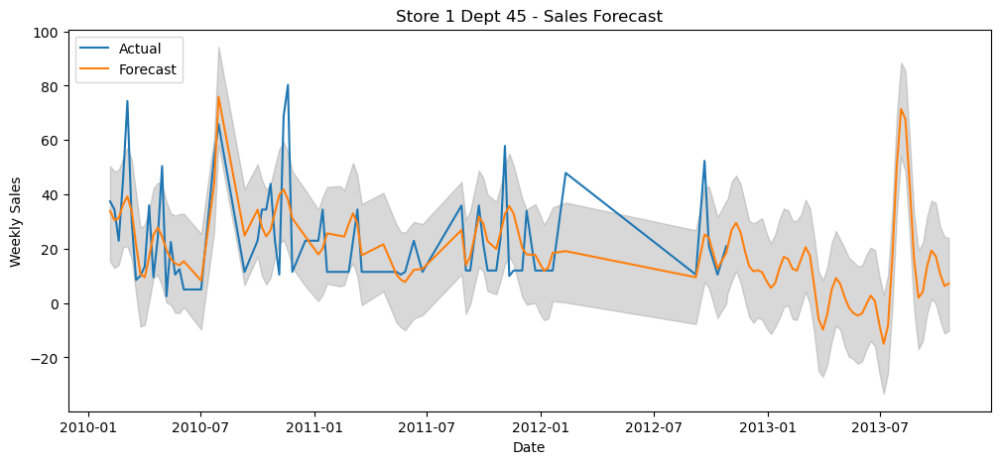

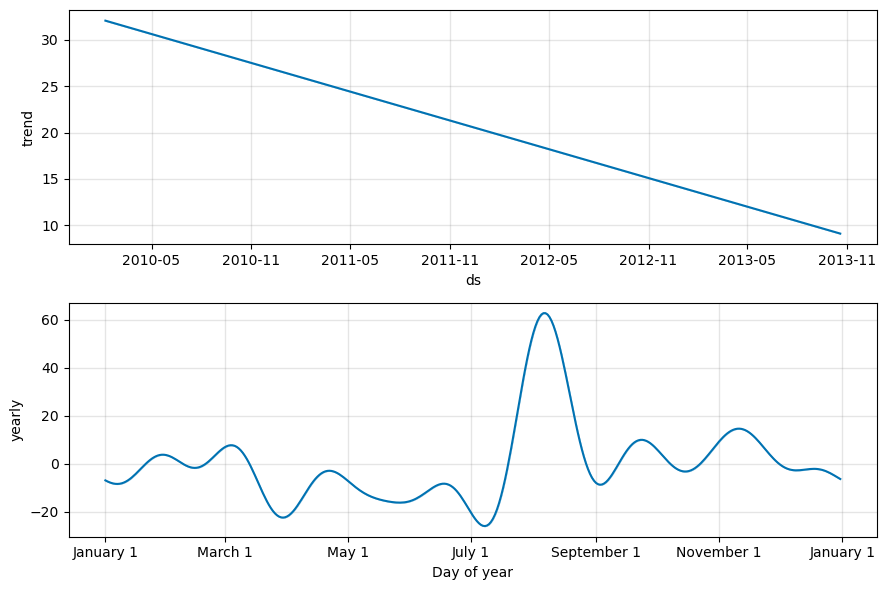


Forecasting for Store 1, Department 46


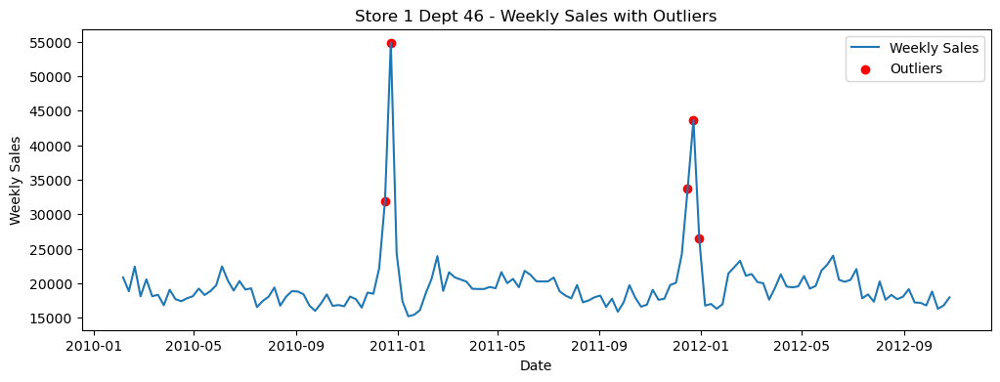

12:12:28 - cmdstanpy - INFO - Chain [1] start processing
12:12:28 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 46 - MAE: 1310.88, RMSE: 2234.09


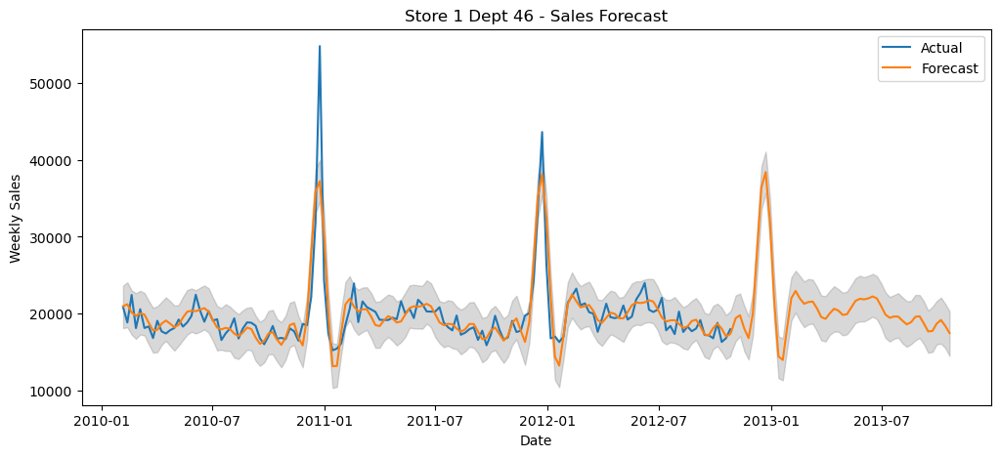

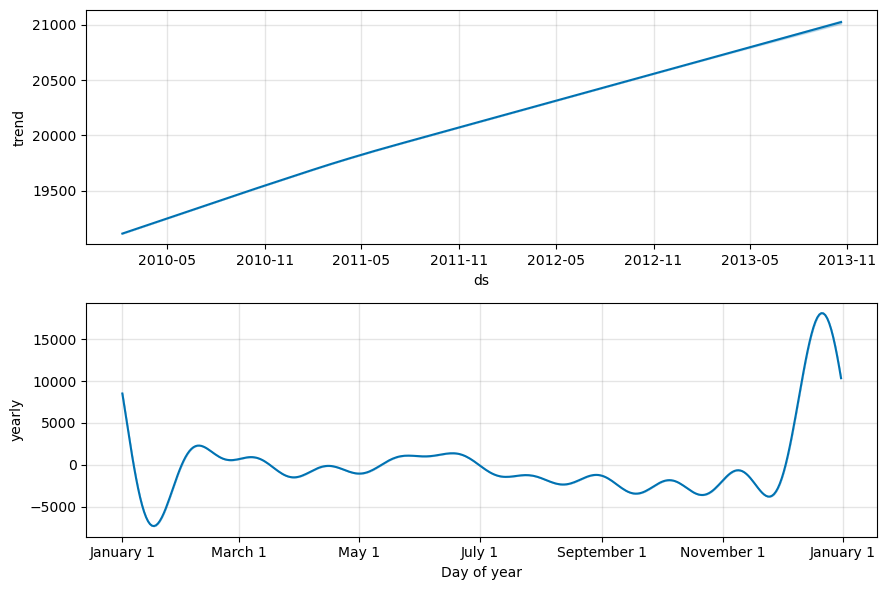


Forecasting for Store 1, Department 47


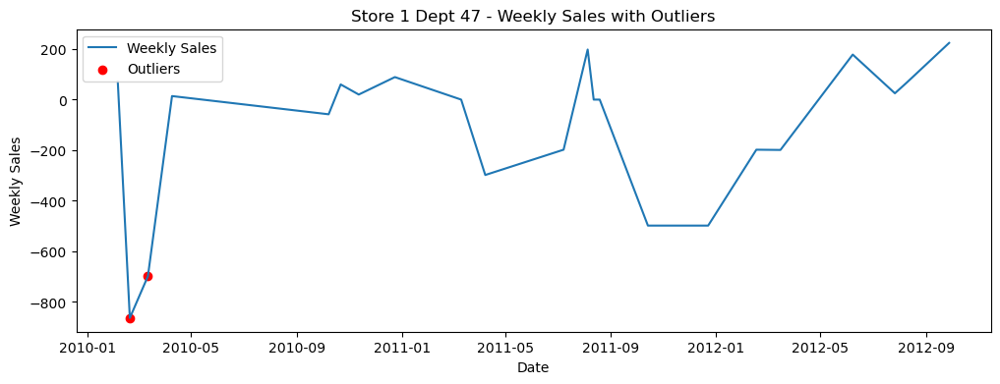

12:12:30 - cmdstanpy - INFO - Chain [1] start processing
12:12:31 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 47 - MAE: 31.85, RMSE: 62.81


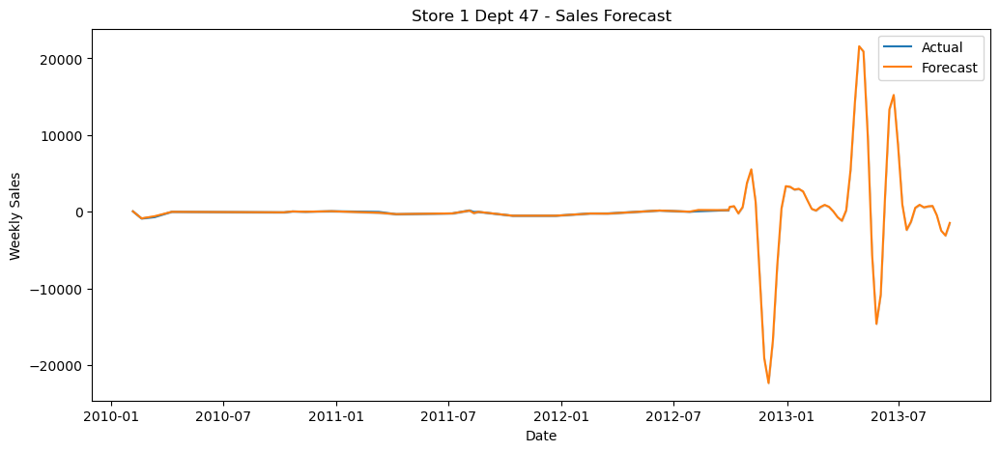

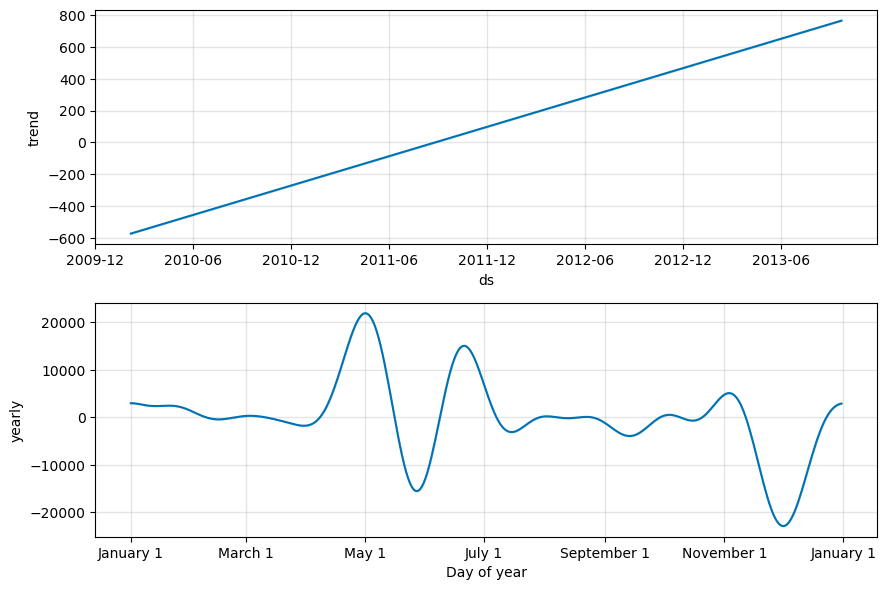


Forecasting for Store 1, Department 48


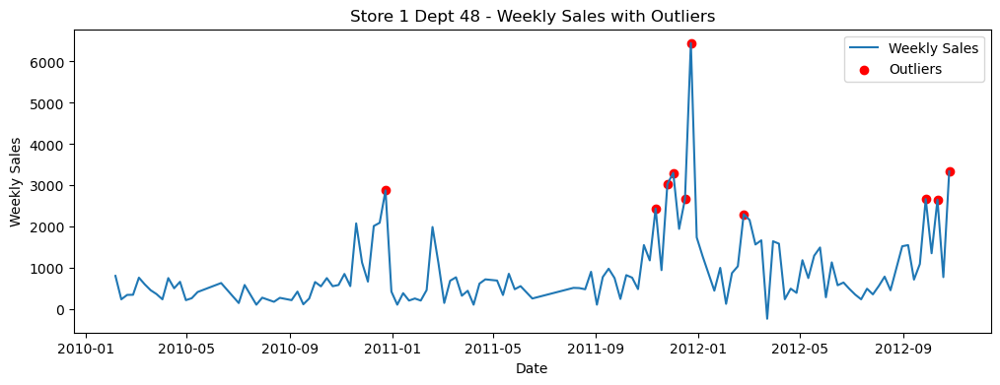

12:12:33 - cmdstanpy - INFO - Chain [1] start processing
12:12:33 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 48 - MAE: 417.38, RMSE: 591.16


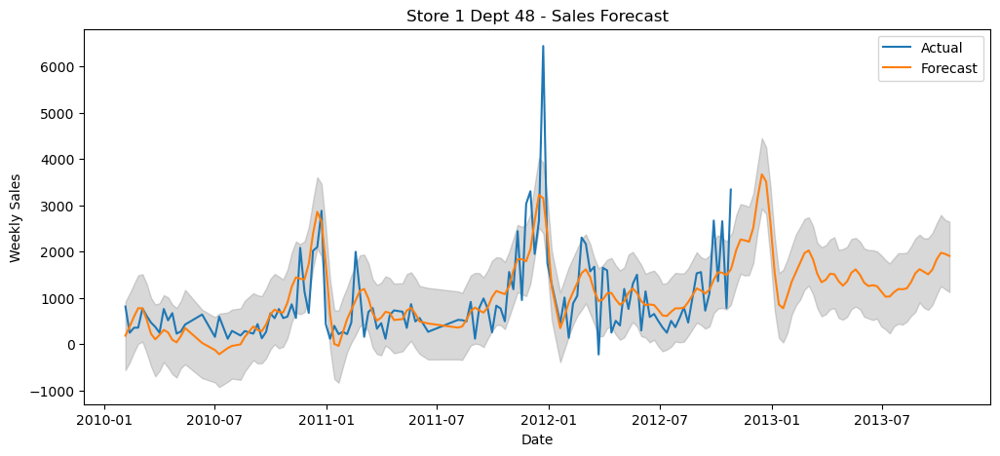

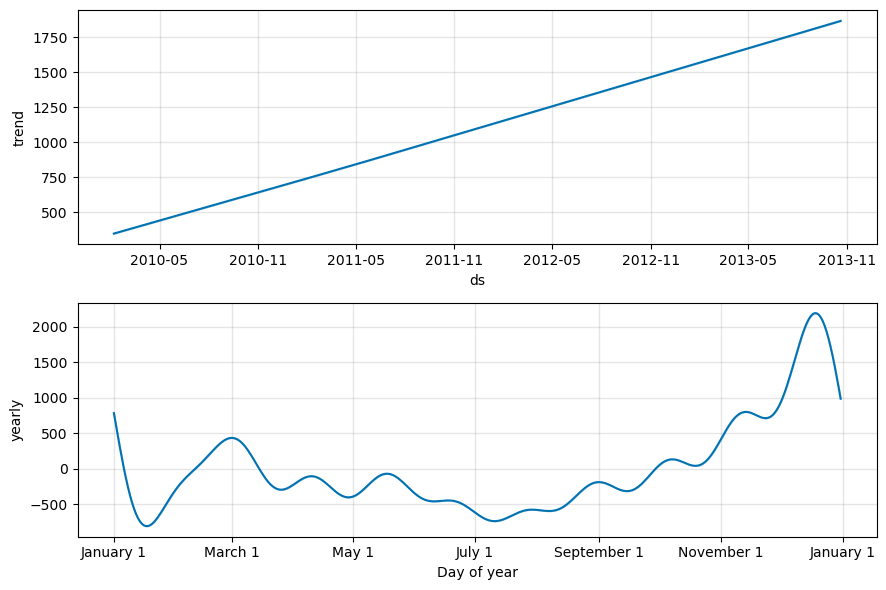


Forecasting for Store 1, Department 49


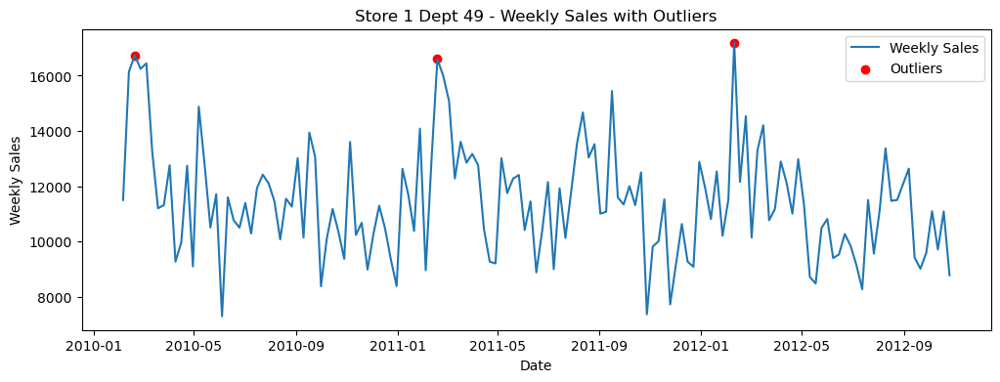

12:12:35 - cmdstanpy - INFO - Chain [1] start processing
12:12:35 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 49 - MAE: 1197.75, RMSE: 1487.06


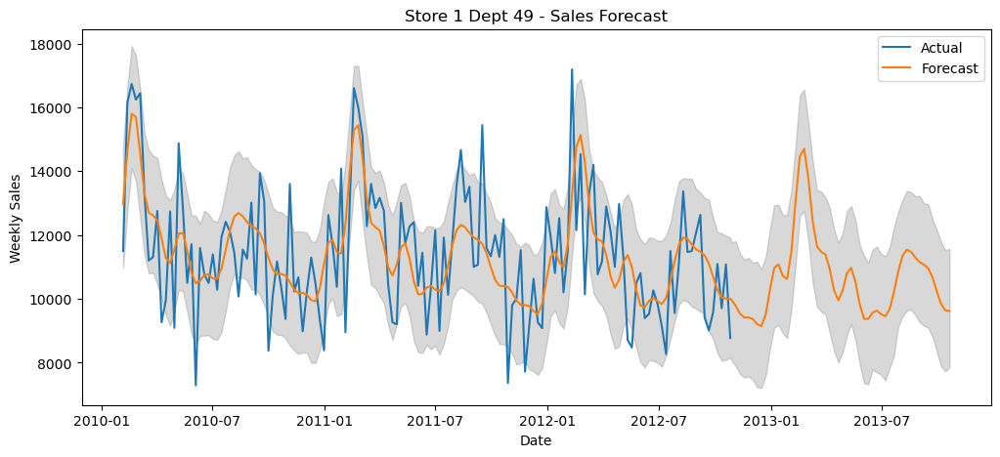

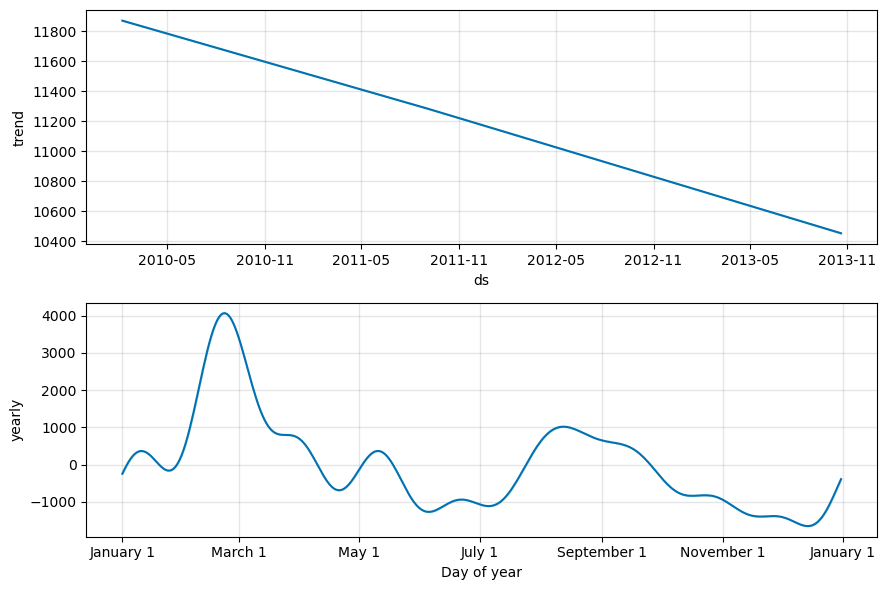


Forecasting for Store 1, Department 51


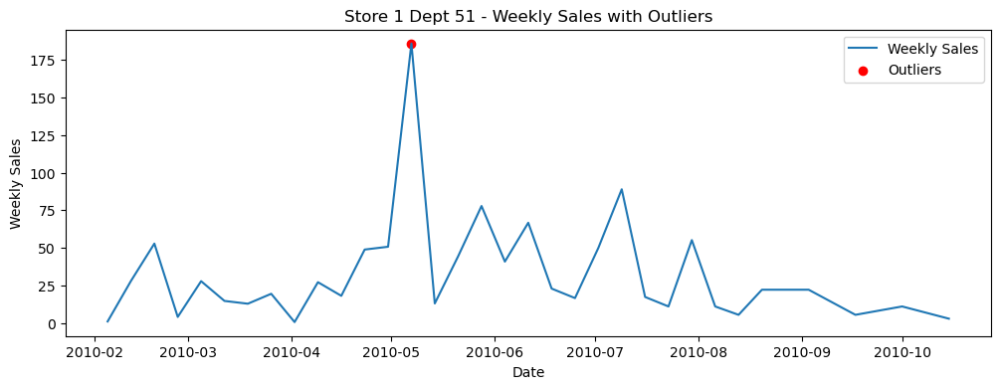

12:12:37 - cmdstanpy - INFO - Chain [1] start processing
12:12:37 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 51 - MAE: 16.95, RMSE: 25.13


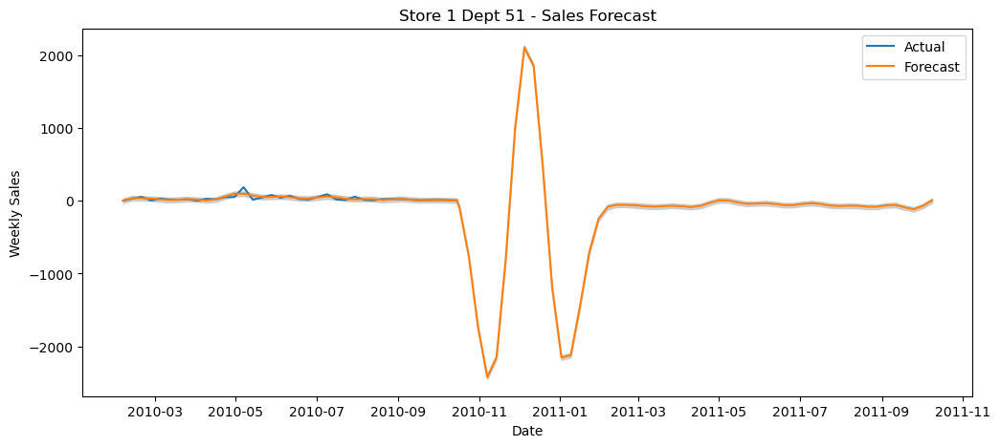

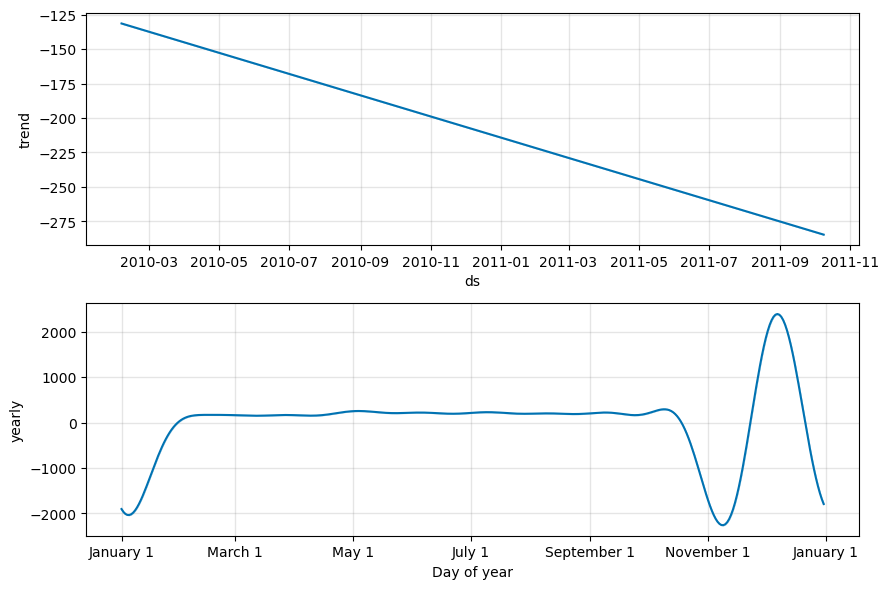


Forecasting for Store 1, Department 52


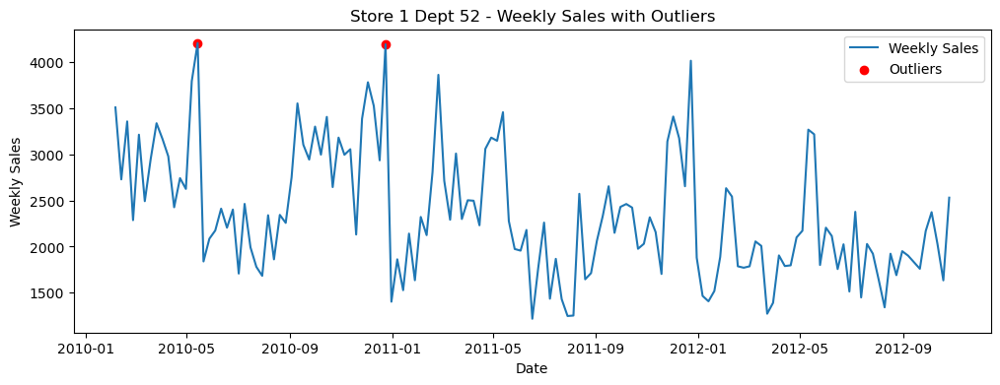

12:12:39 - cmdstanpy - INFO - Chain [1] start processing
12:12:39 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 52 - MAE: 342.54, RMSE: 431.98


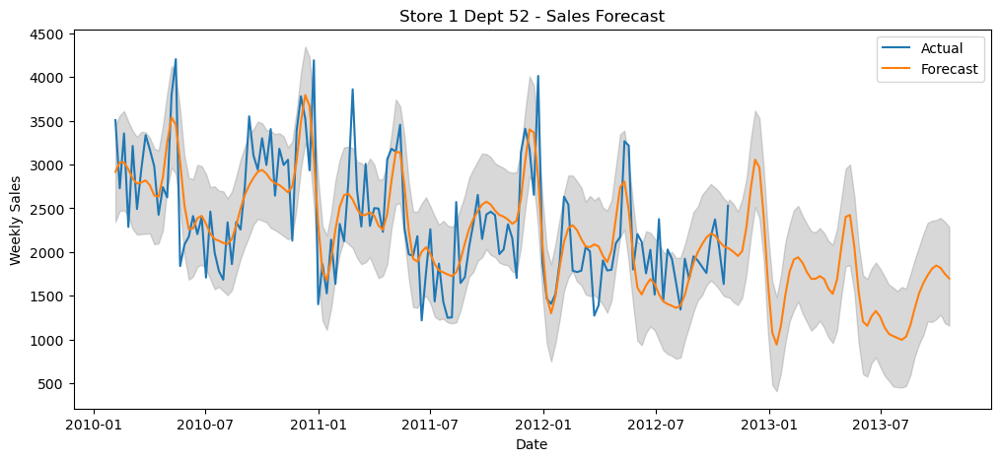

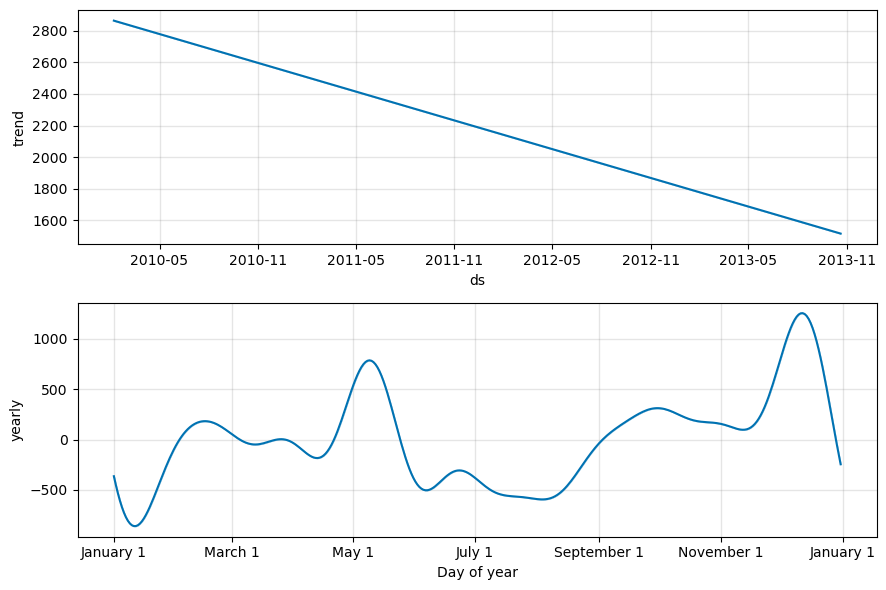


Forecasting for Store 1, Department 54


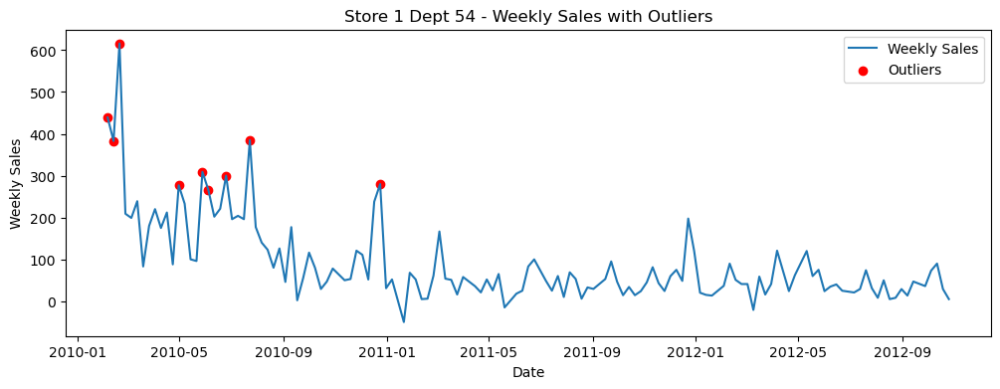

12:12:41 - cmdstanpy - INFO - Chain [1] start processing
12:12:41 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 54 - MAE: 41.51, RMSE: 60.01


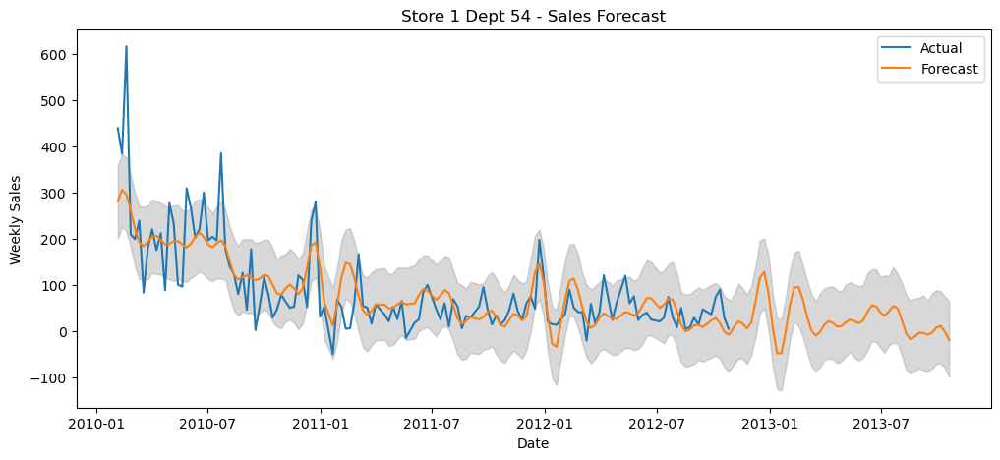

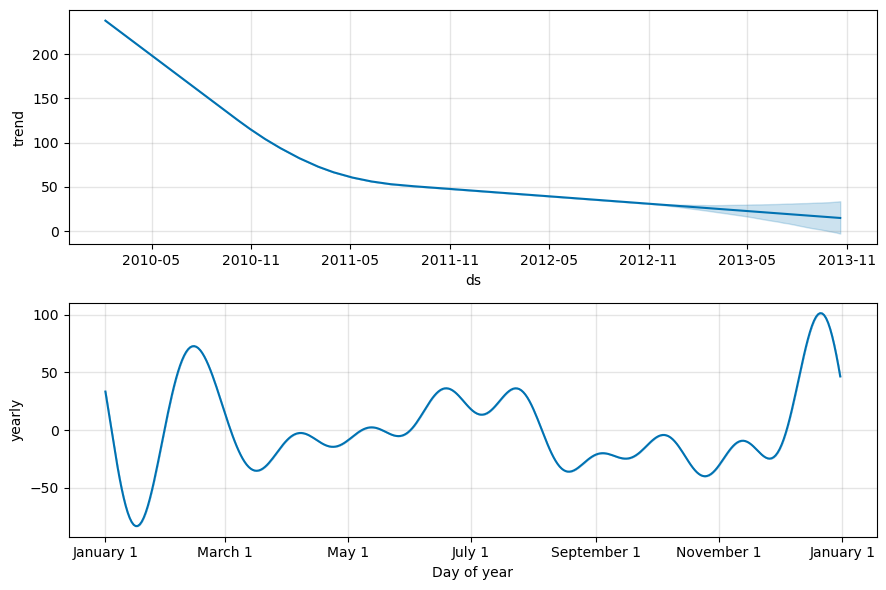


Forecasting for Store 1, Department 55


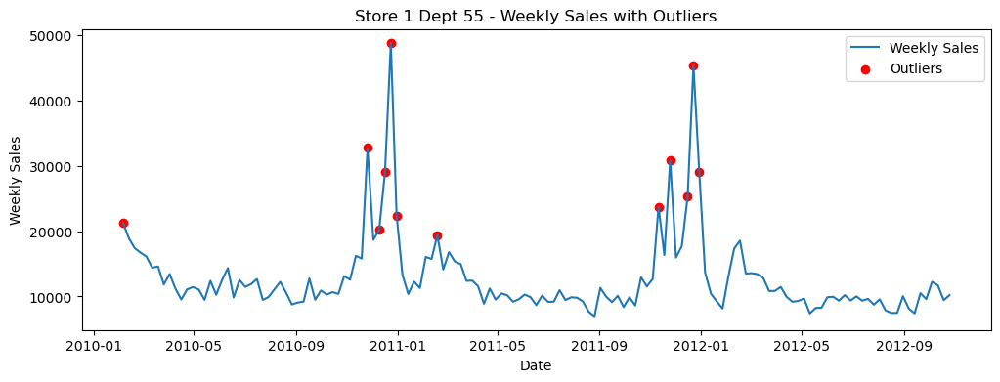

12:12:43 - cmdstanpy - INFO - Chain [1] start processing
12:12:43 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 55 - MAE: 1786.55, RMSE: 2851.58


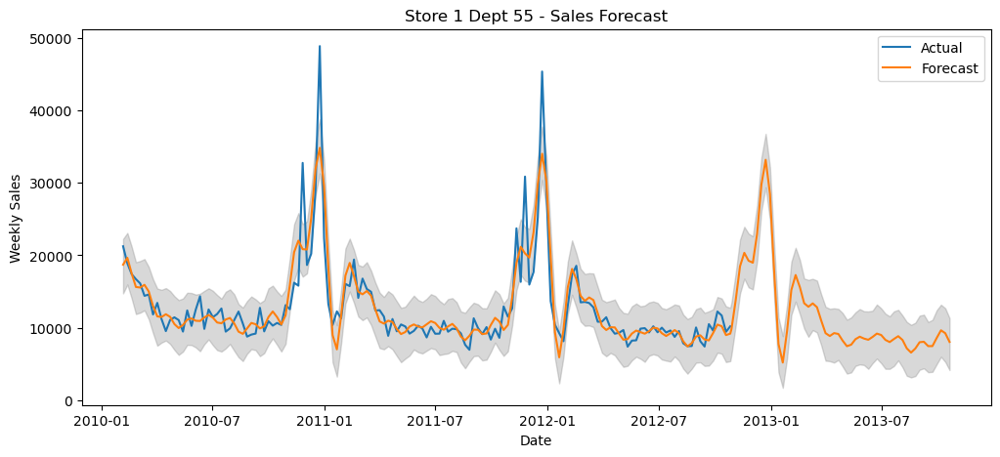

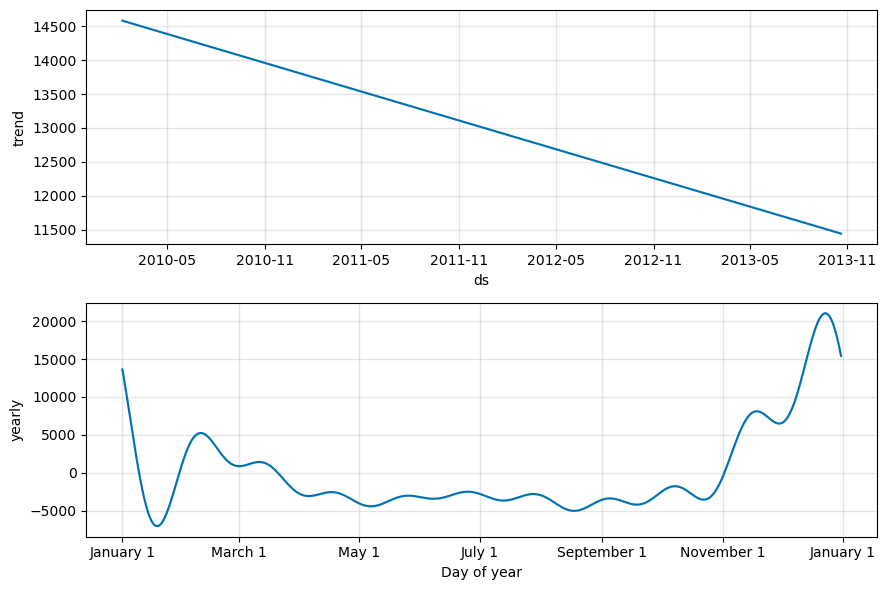


Forecasting for Store 1, Department 56


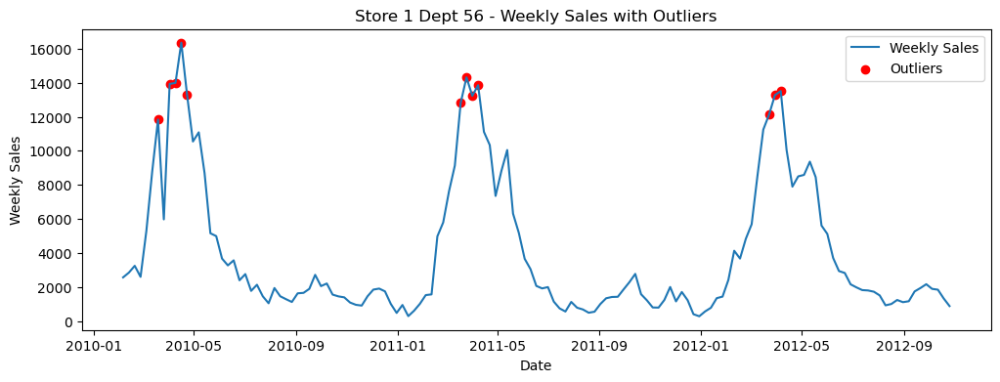

12:12:45 - cmdstanpy - INFO - Chain [1] start processing
12:12:45 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 56 - MAE: 604.21, RMSE: 1032.29


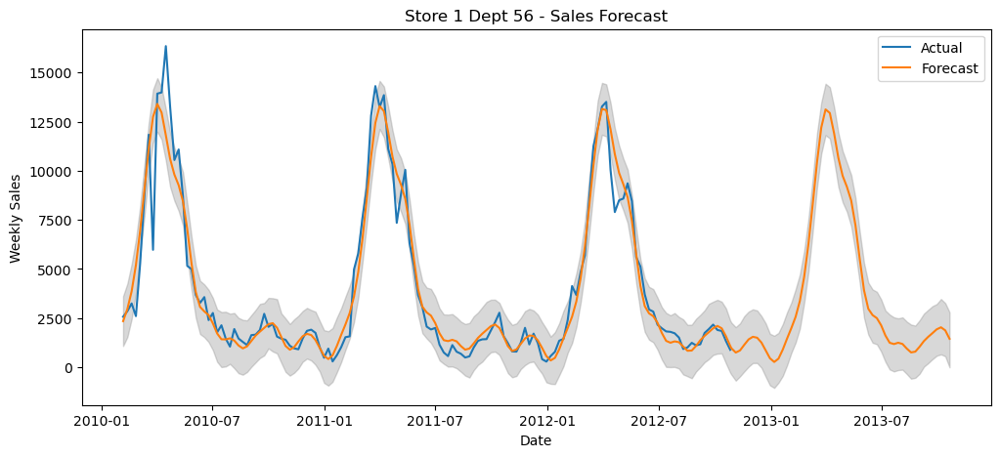

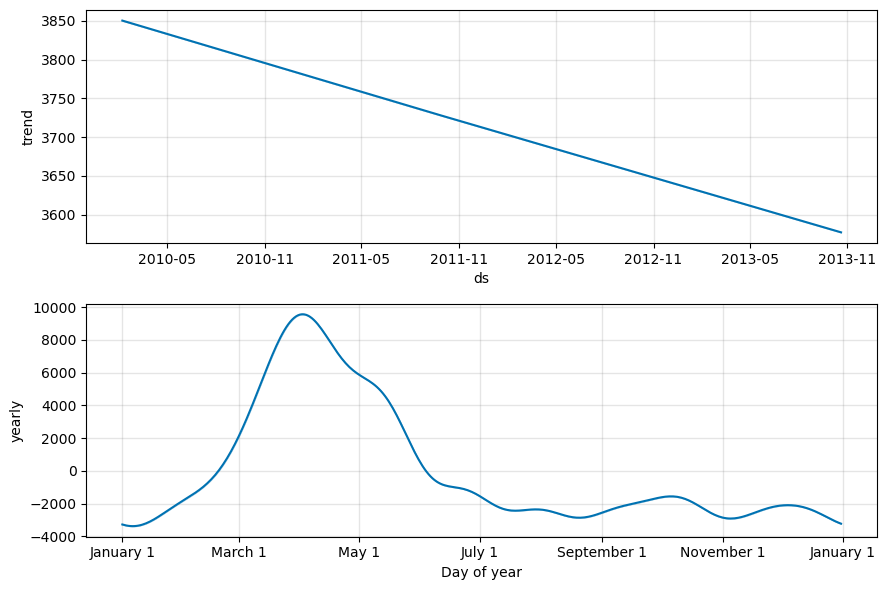


Forecasting for Store 1, Department 58


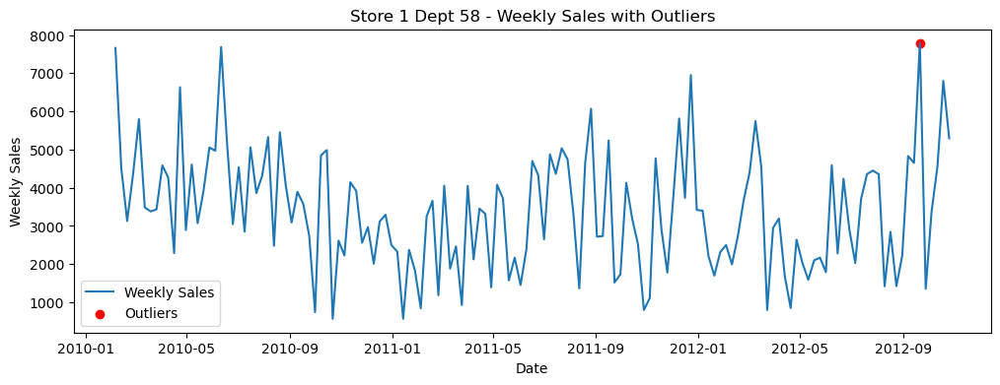

12:12:47 - cmdstanpy - INFO - Chain [1] start processing
12:12:47 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 58 - MAE: 1067.43, RMSE: 1358.27


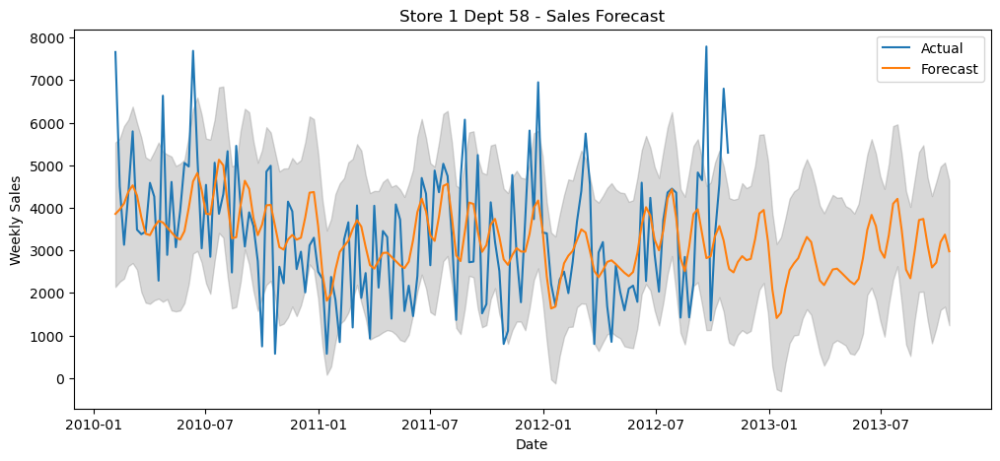

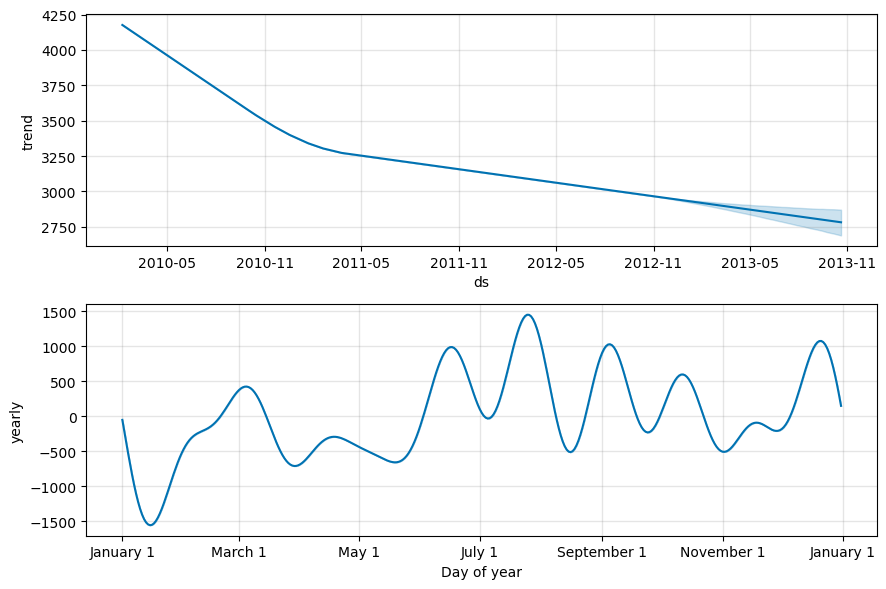


Forecasting for Store 1, Department 59


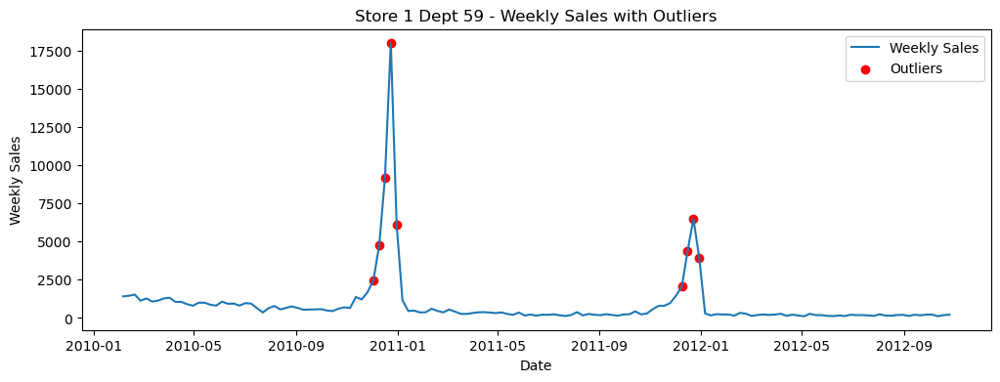

12:12:50 - cmdstanpy - INFO - Chain [1] start processing
12:12:50 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 59 - MAE: 395.59, RMSE: 952.89


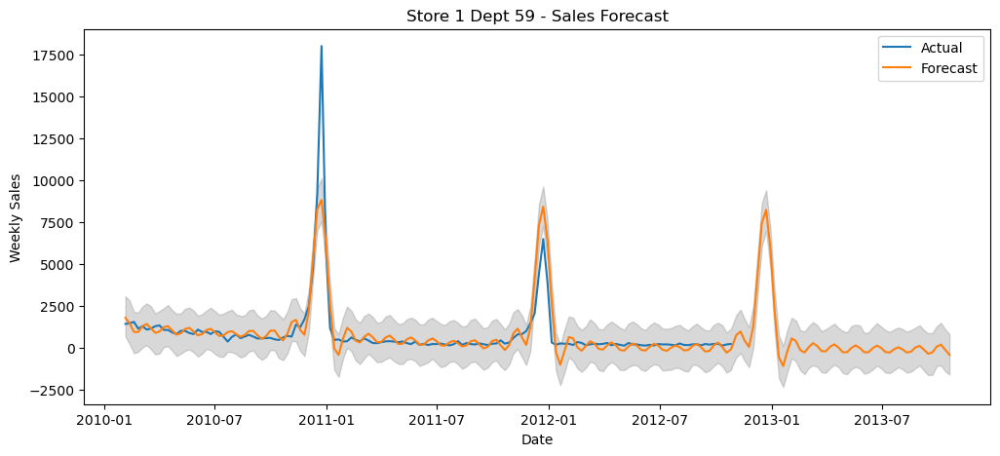

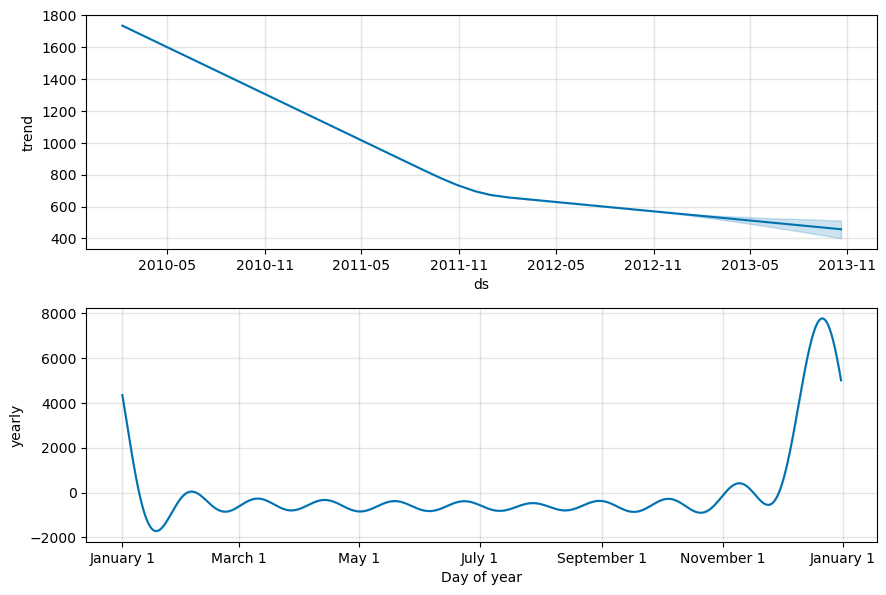


Forecasting for Store 1, Department 60


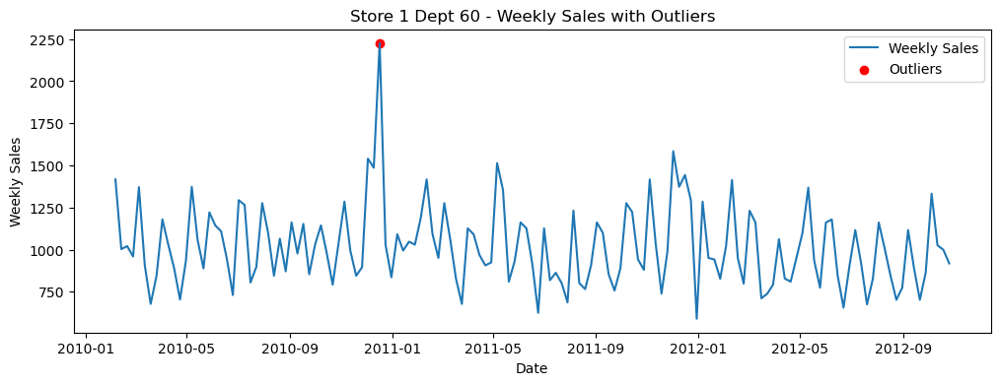

12:12:52 - cmdstanpy - INFO - Chain [1] start processing
12:12:52 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 60 - MAE: 163.46, RMSE: 194.37


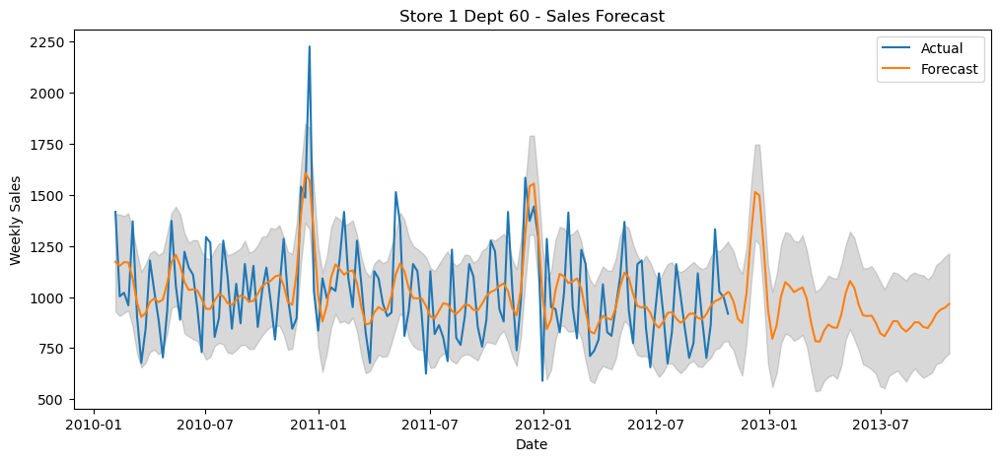

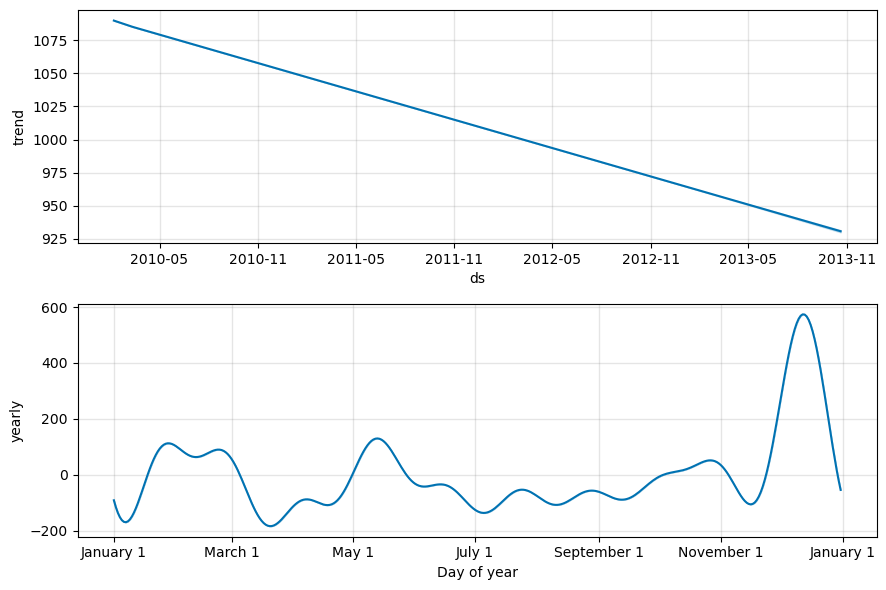


Forecasting for Store 1, Department 67


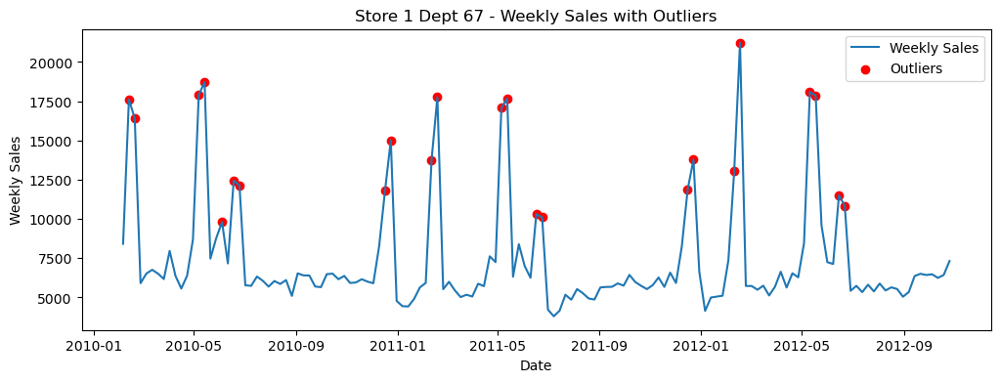

12:12:54 - cmdstanpy - INFO - Chain [1] start processing
12:12:54 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 67 - MAE: 1327.80, RMSE: 1933.05


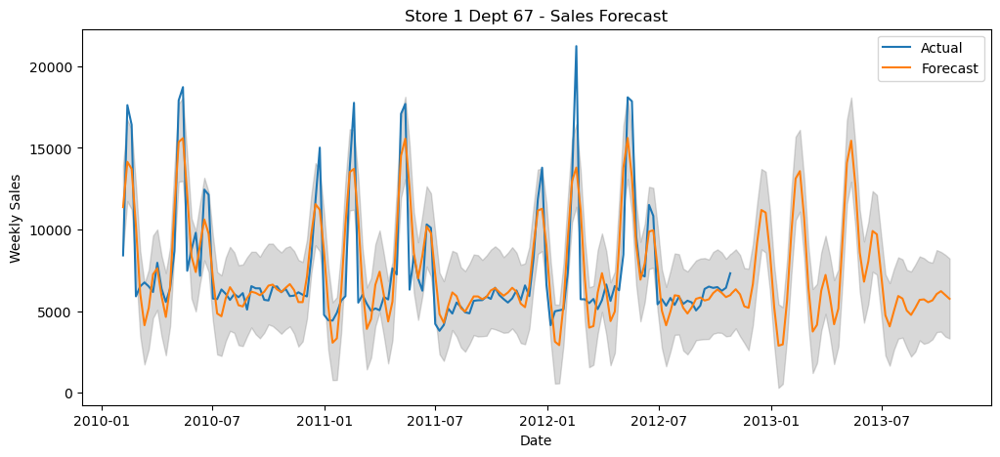

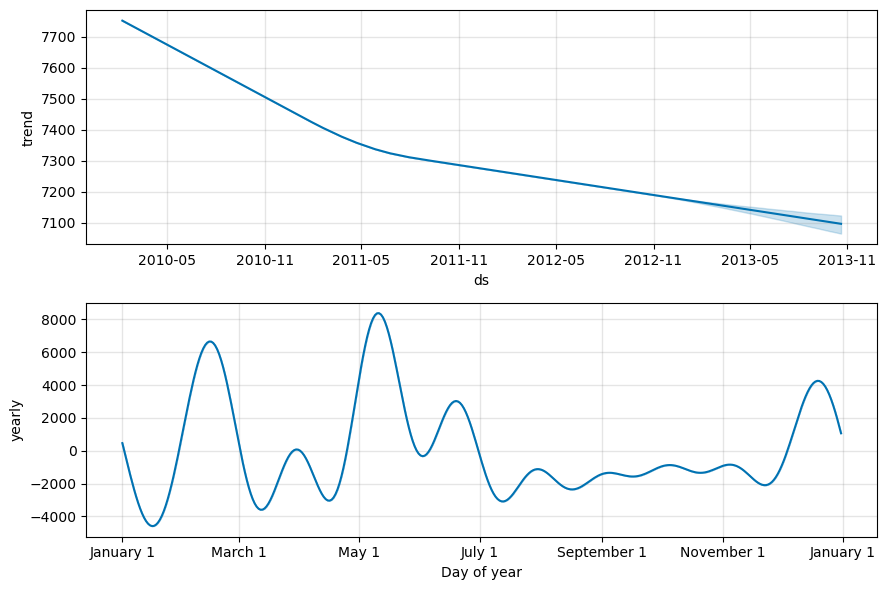


Forecasting for Store 1, Department 71


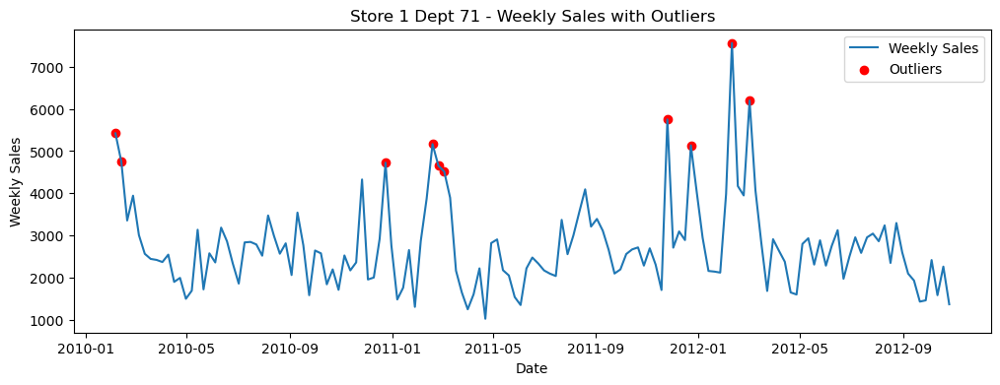

12:12:56 - cmdstanpy - INFO - Chain [1] start processing
12:12:56 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 71 - MAE: 530.60, RMSE: 686.35


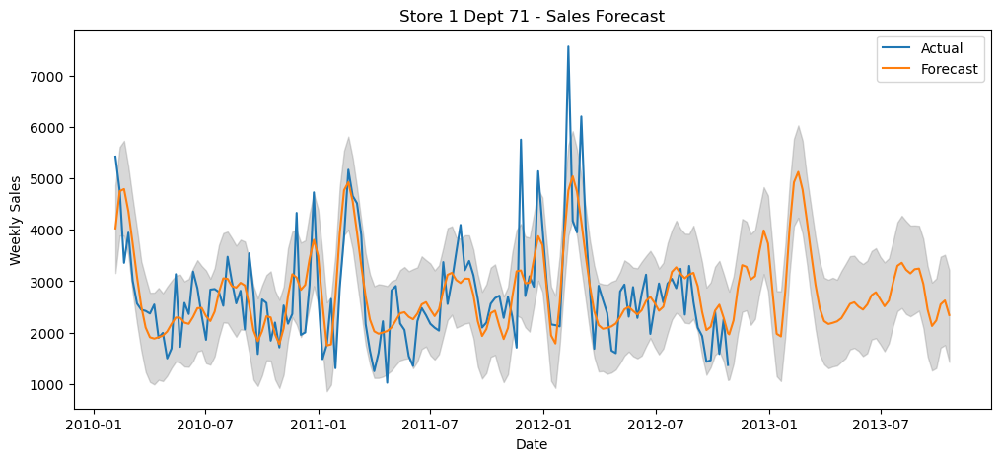

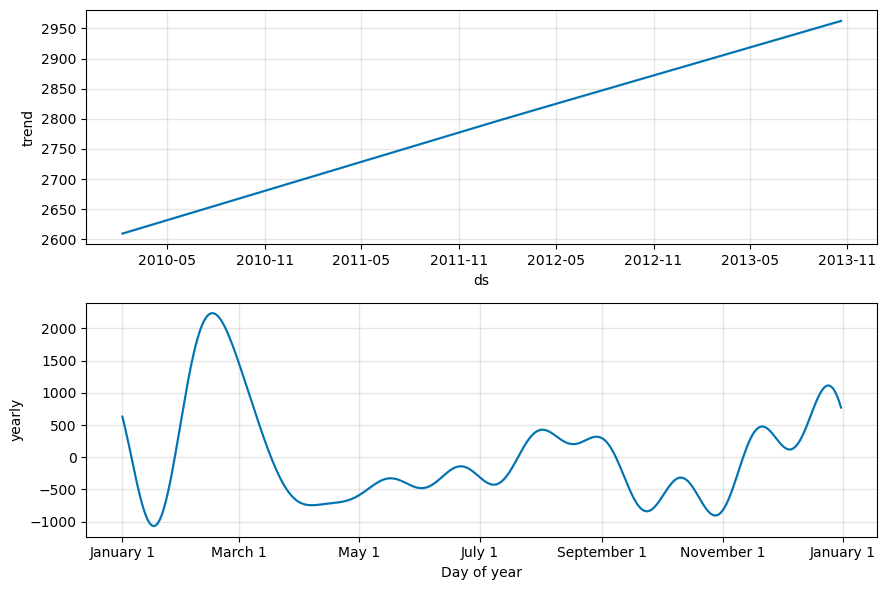


Forecasting for Store 1, Department 72


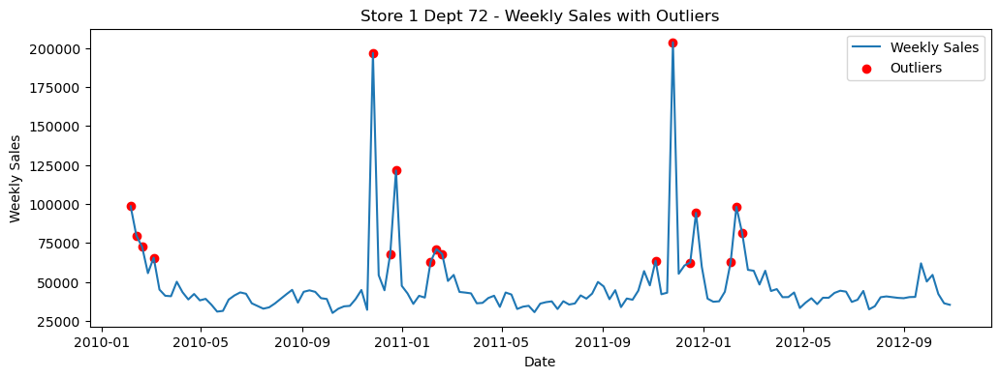

12:12:58 - cmdstanpy - INFO - Chain [1] start processing
12:12:59 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 72 - MAE: 8495.56, RMSE: 16676.73


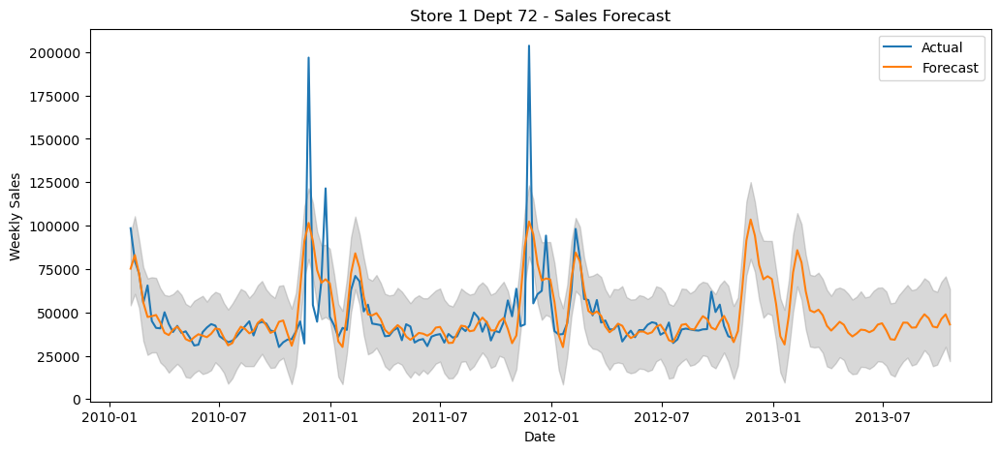

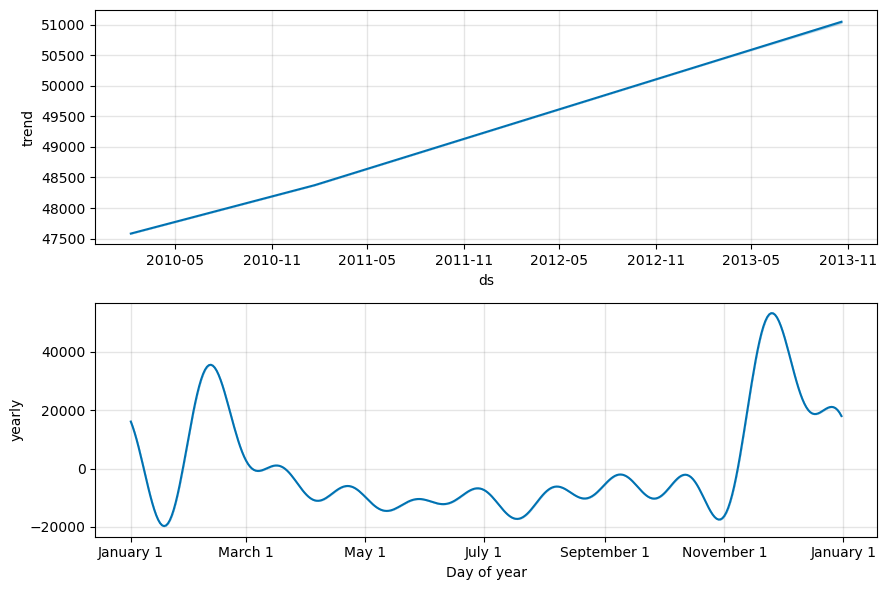


Forecasting for Store 1, Department 74


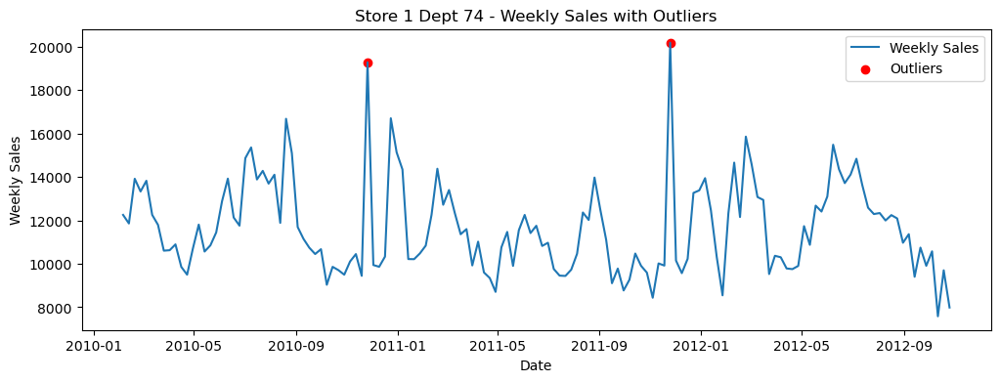

12:13:01 - cmdstanpy - INFO - Chain [1] start processing
12:13:01 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 74 - MAE: 1065.64, RMSE: 1447.41


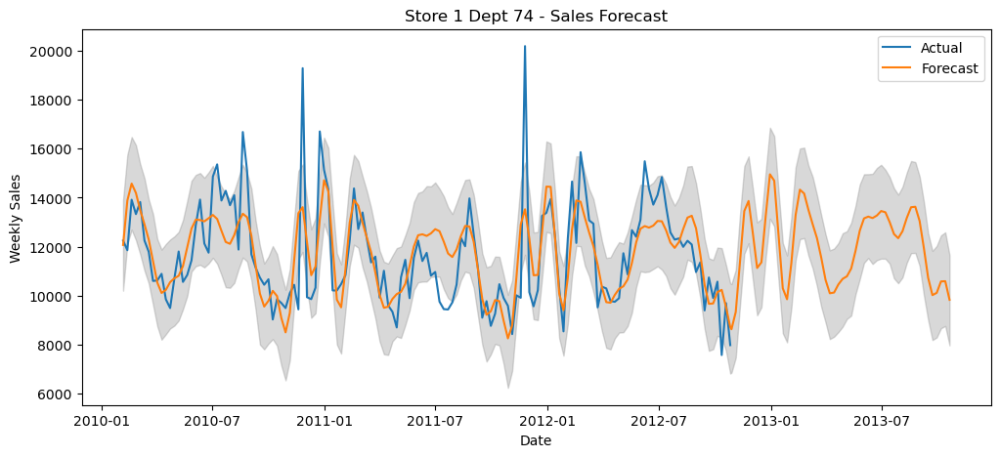

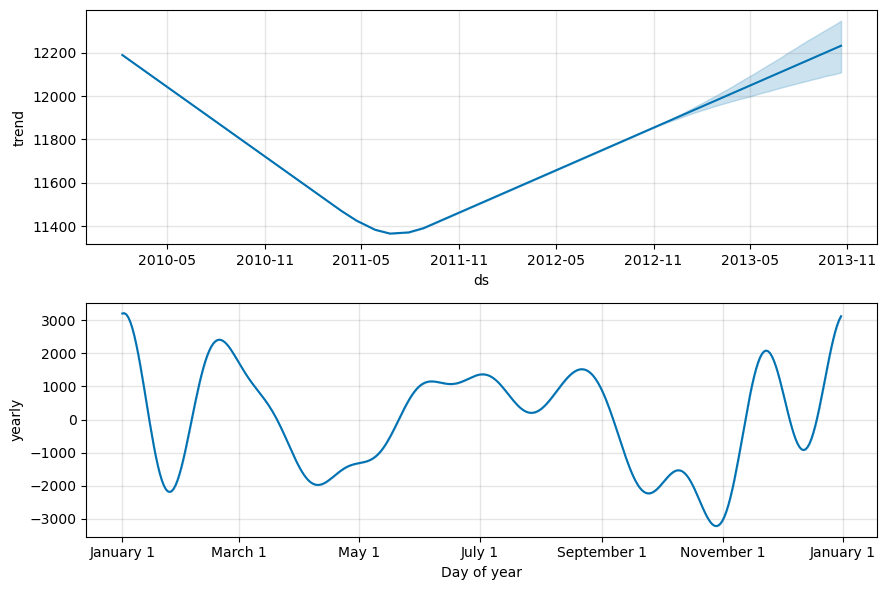


Forecasting for Store 1, Department 77


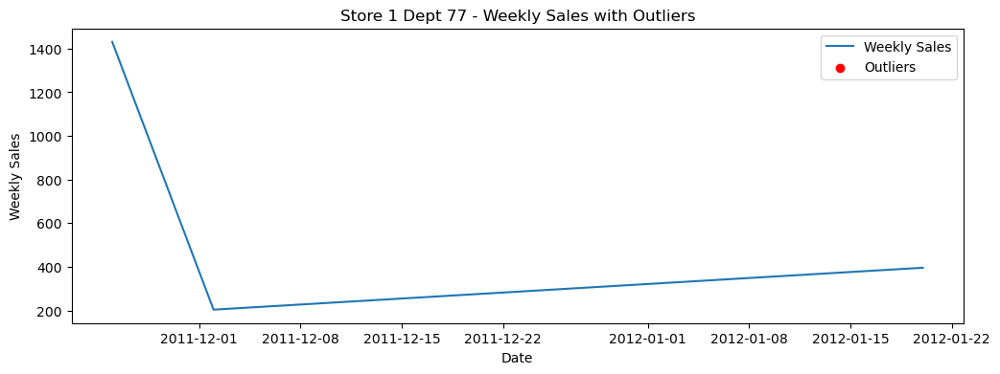

12:13:03 - cmdstanpy - INFO - Chain [1] start processing
12:13:03 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 77 - MAE: 0.00, RMSE: 0.00


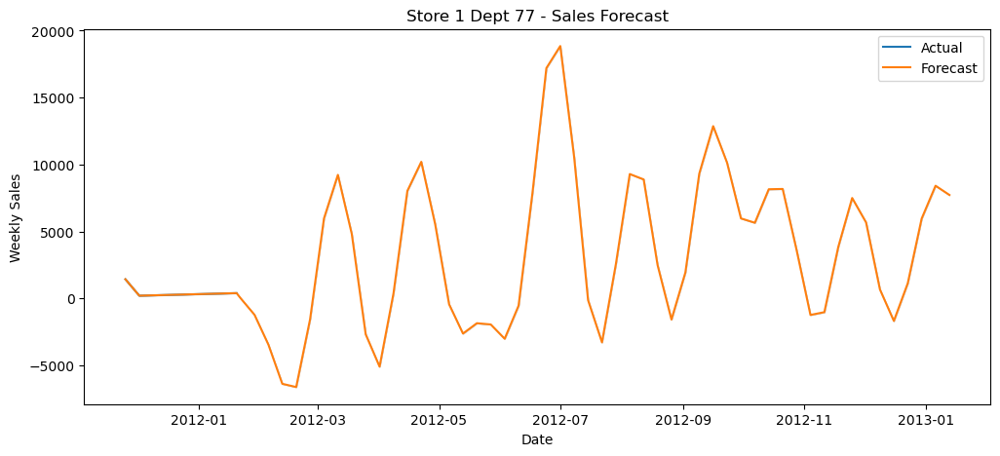

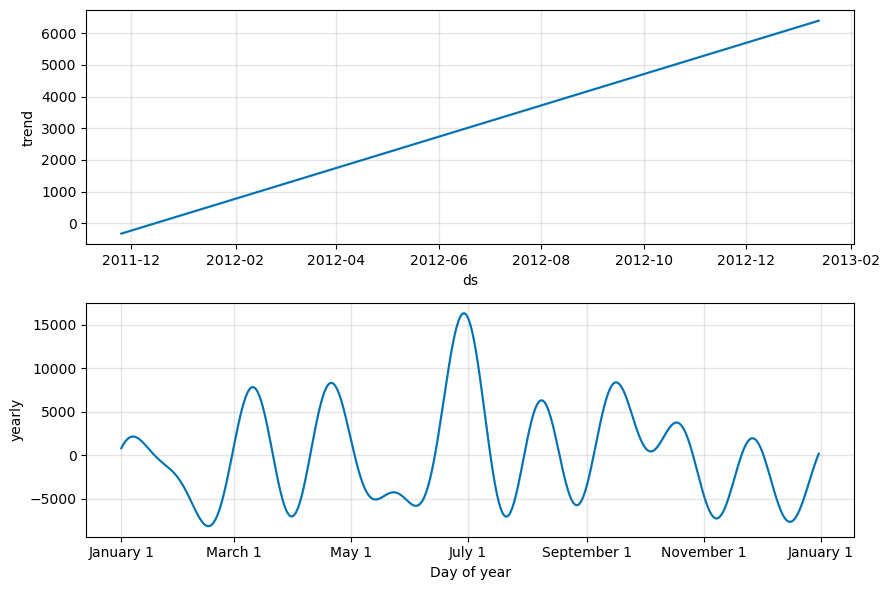


Forecasting for Store 1, Department 78


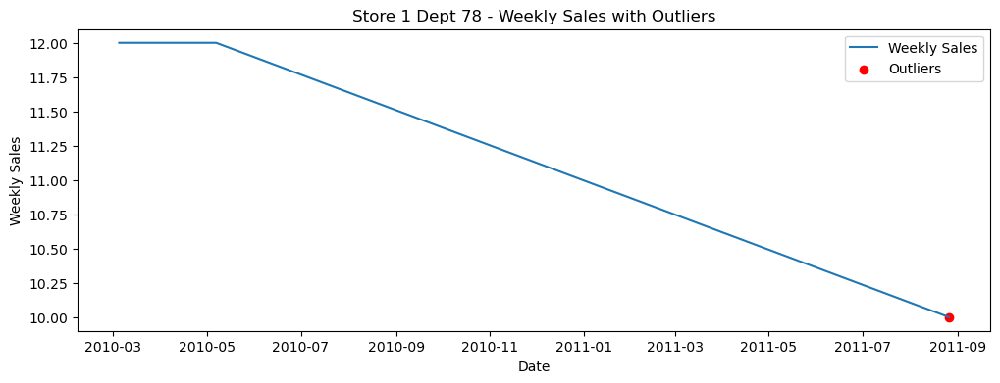

12:13:04 - cmdstanpy - INFO - Chain [1] start processing
12:13:05 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 78 - MAE: 0.00, RMSE: 0.00


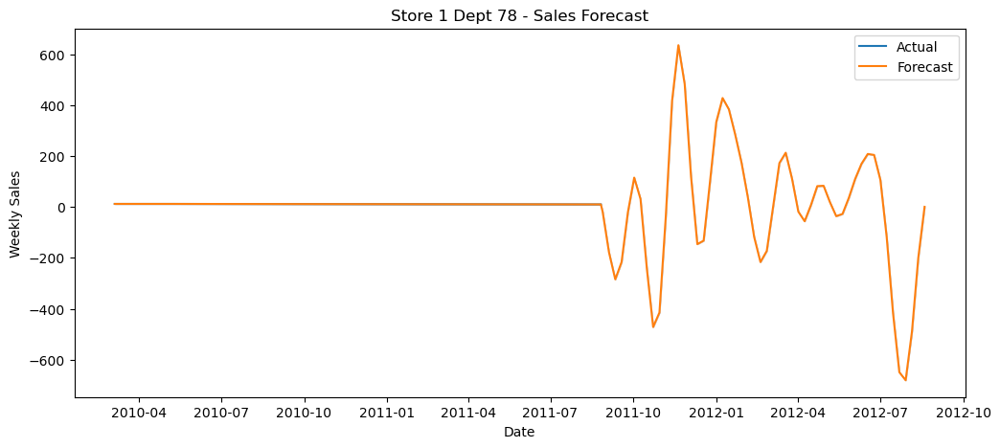

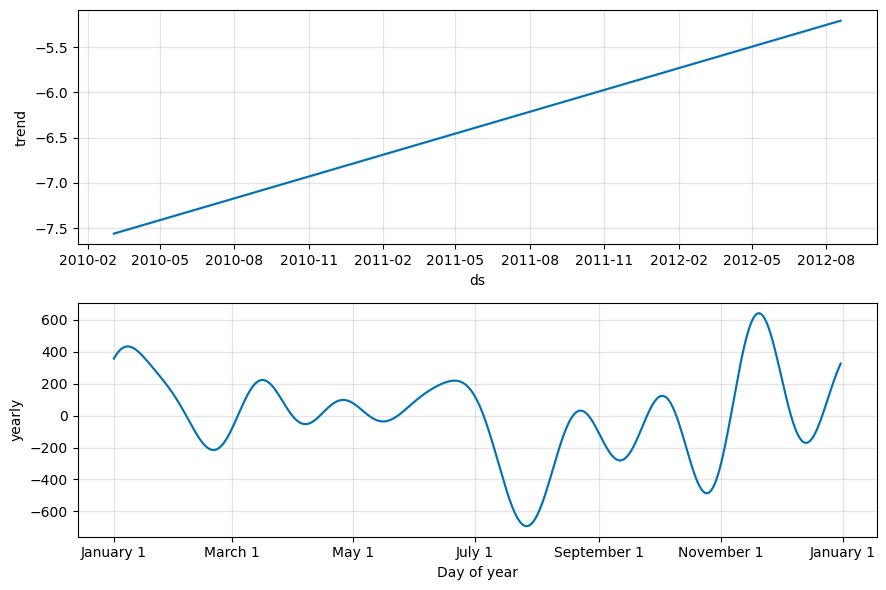


Forecasting for Store 1, Department 79


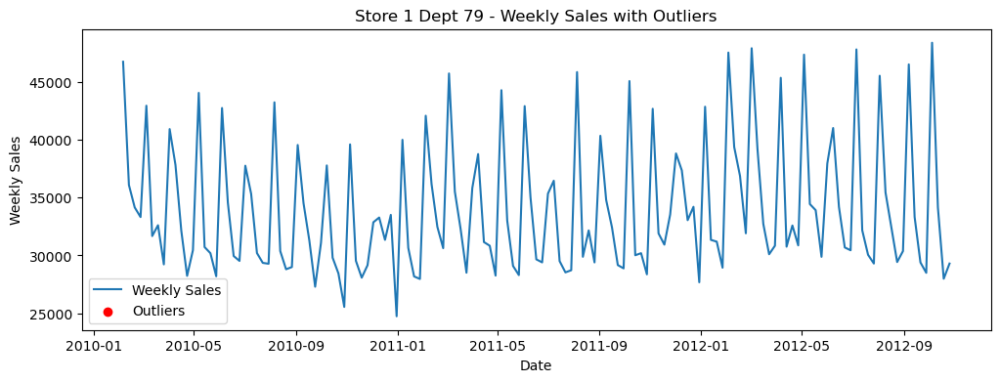

12:13:07 - cmdstanpy - INFO - Chain [1] start processing
12:13:07 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 79 - MAE: 4401.70, RMSE: 5447.59


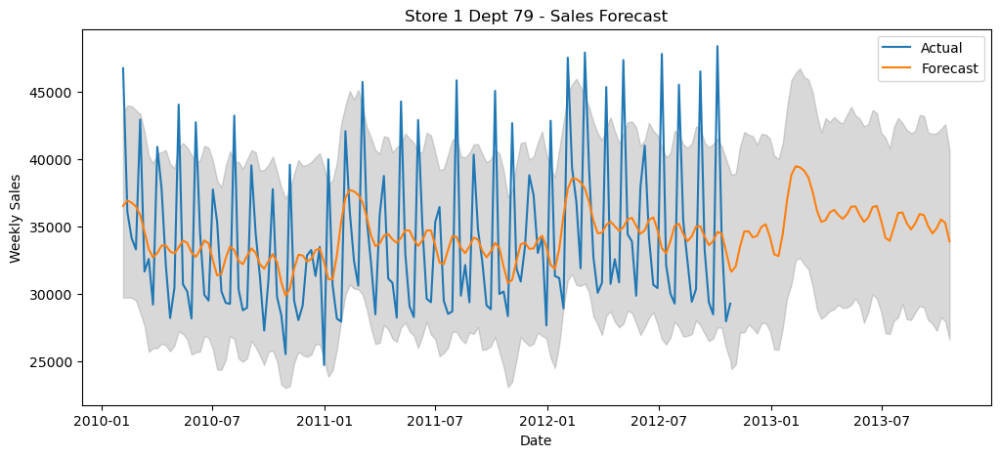

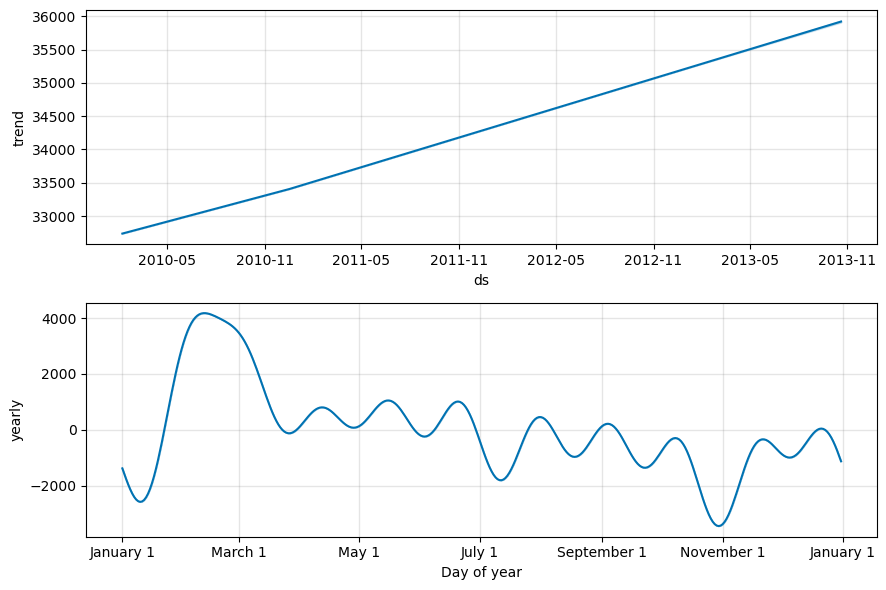


Forecasting for Store 1, Department 80


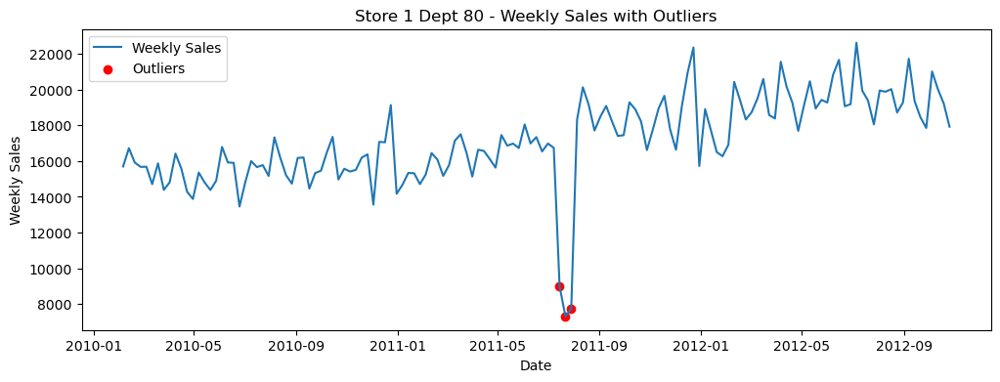

12:13:09 - cmdstanpy - INFO - Chain [1] start processing
12:13:09 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 80 - MAE: 1084.96, RMSE: 1554.44


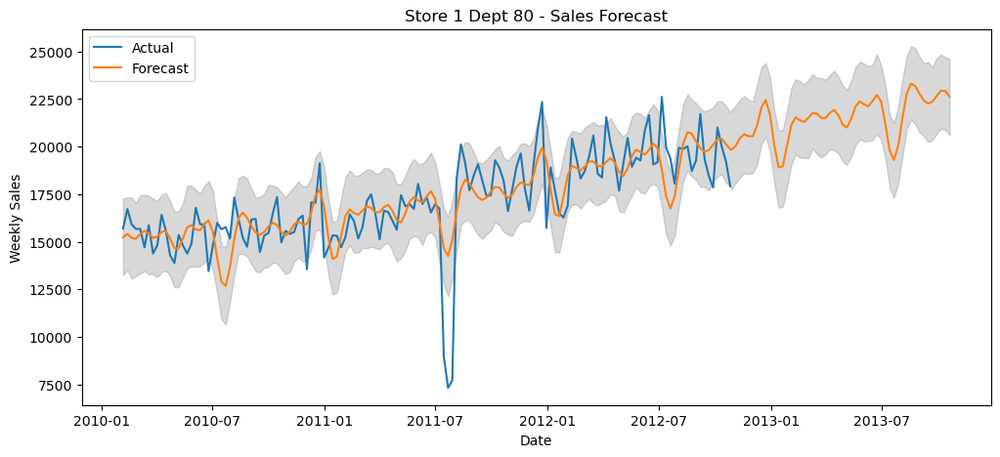

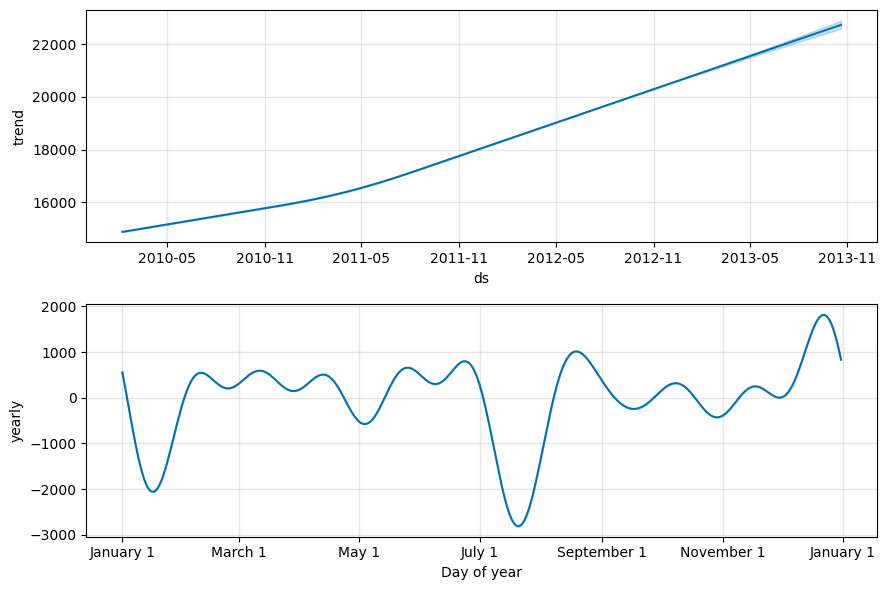


Forecasting for Store 1, Department 81


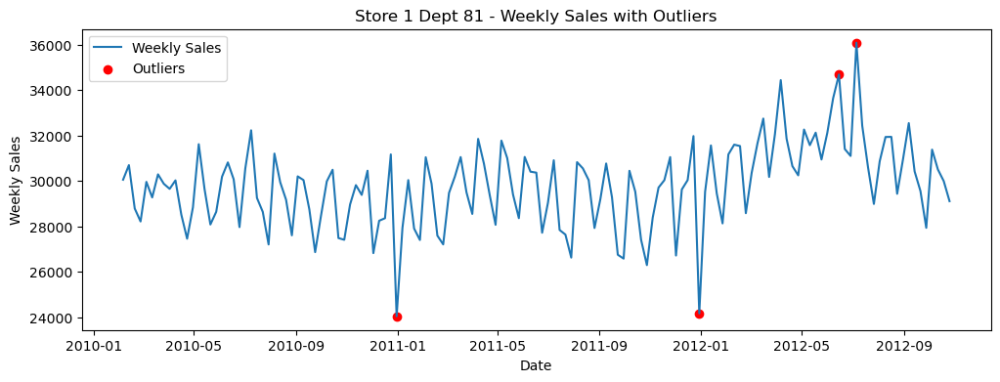

12:13:10 - cmdstanpy - INFO - Chain [1] start processing
12:13:10 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 81 - MAE: 1118.34, RMSE: 1449.15


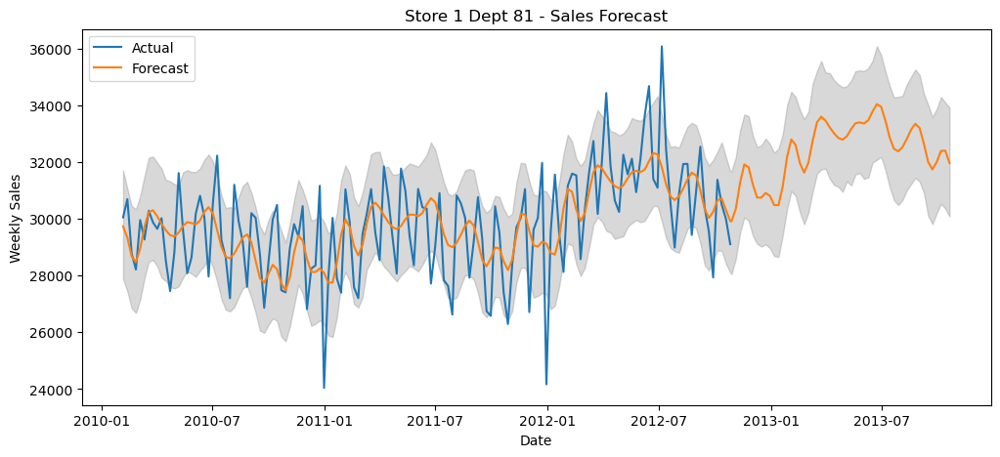

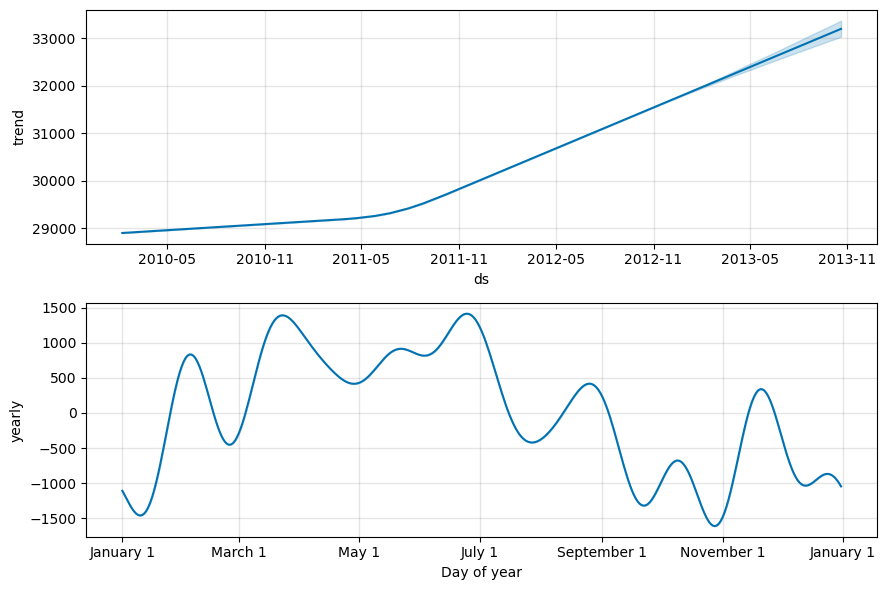


Forecasting for Store 1, Department 82


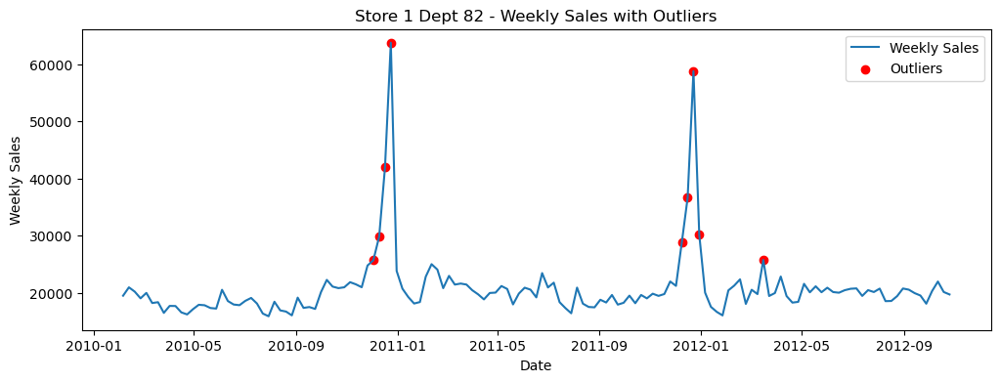

12:13:12 - cmdstanpy - INFO - Chain [1] start processing
12:13:12 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 82 - MAE: 1707.22, RMSE: 2886.15


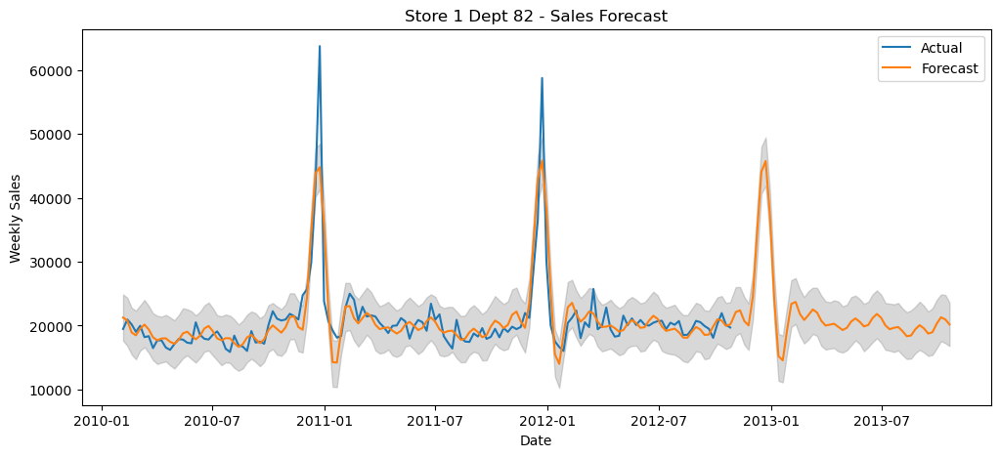

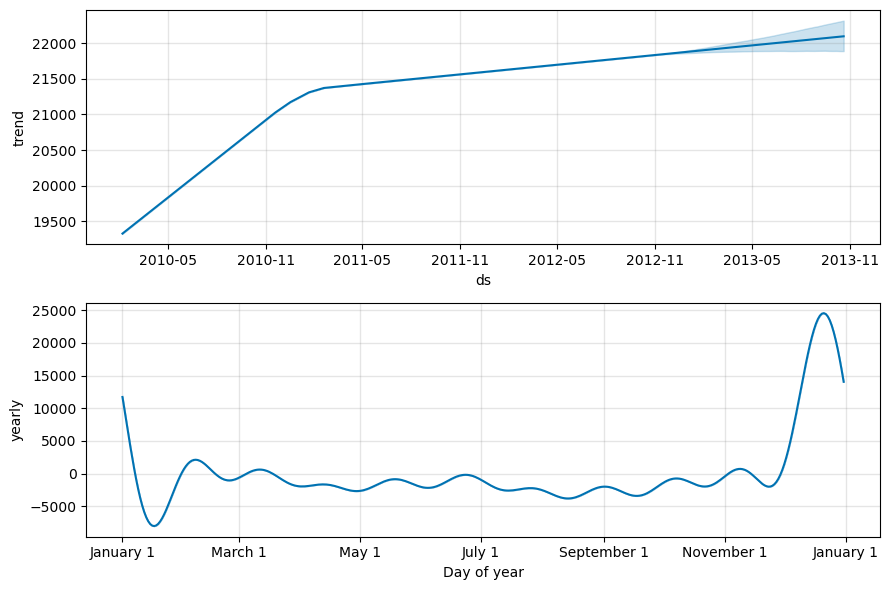


Forecasting for Store 1, Department 83


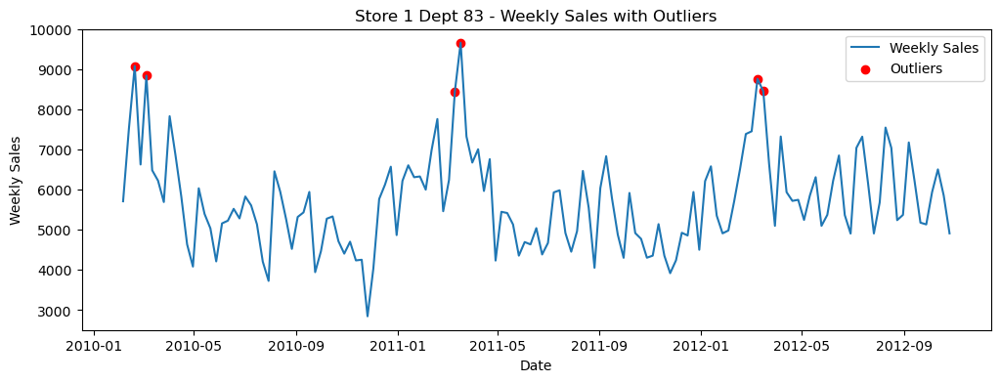

12:13:14 - cmdstanpy - INFO - Chain [1] start processing
12:13:14 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 83 - MAE: 651.86, RMSE: 800.70


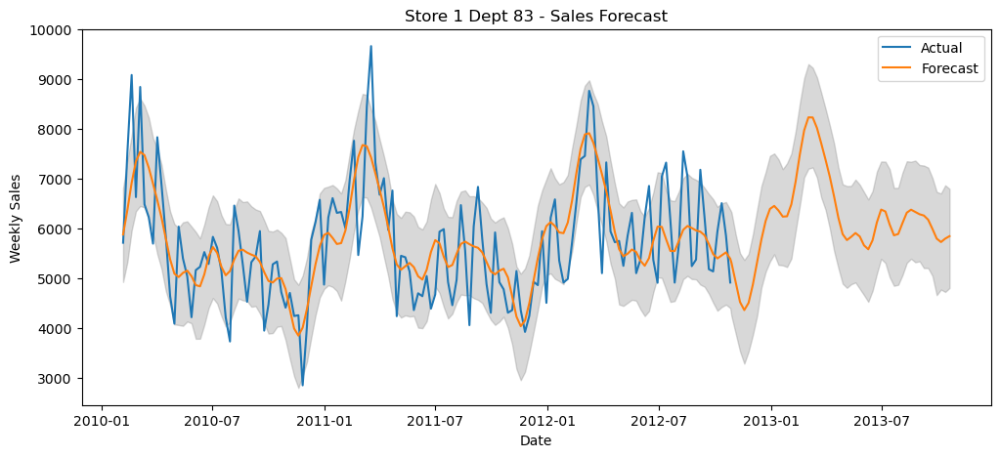

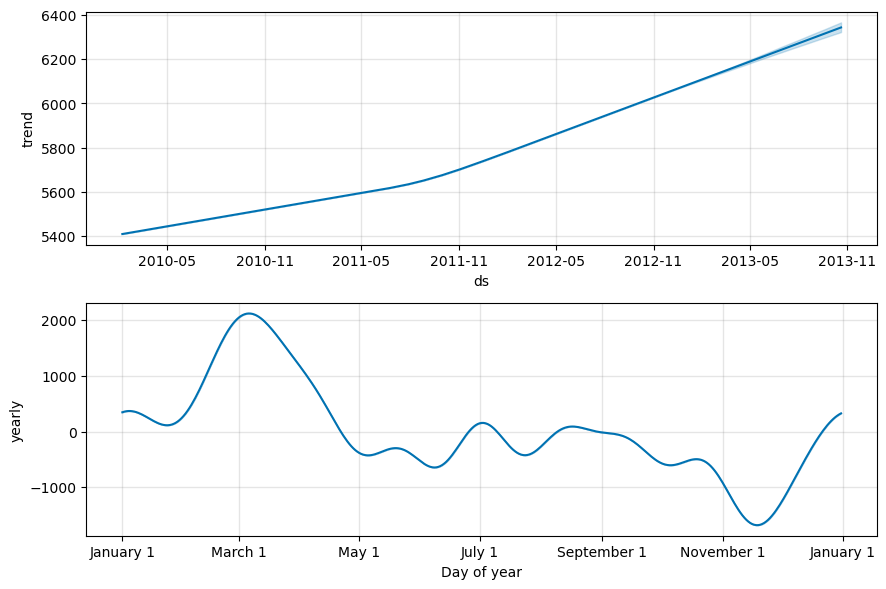


Forecasting for Store 1, Department 85


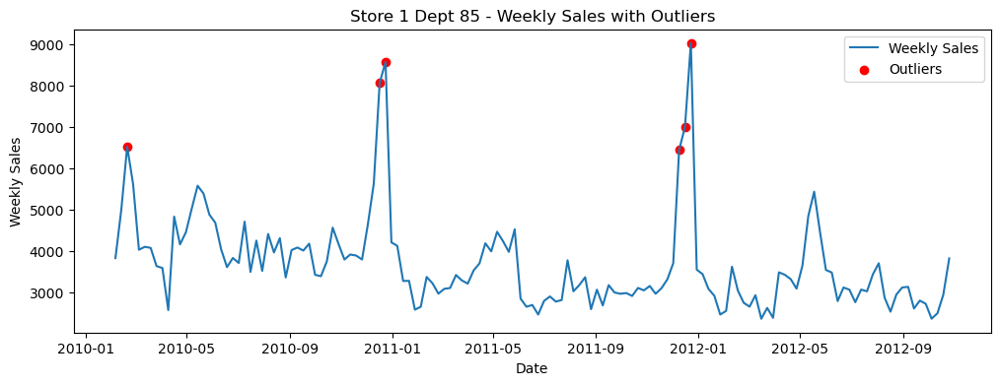

12:13:15 - cmdstanpy - INFO - Chain [1] start processing
12:13:15 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 85 - MAE: 376.30, RMSE: 521.68


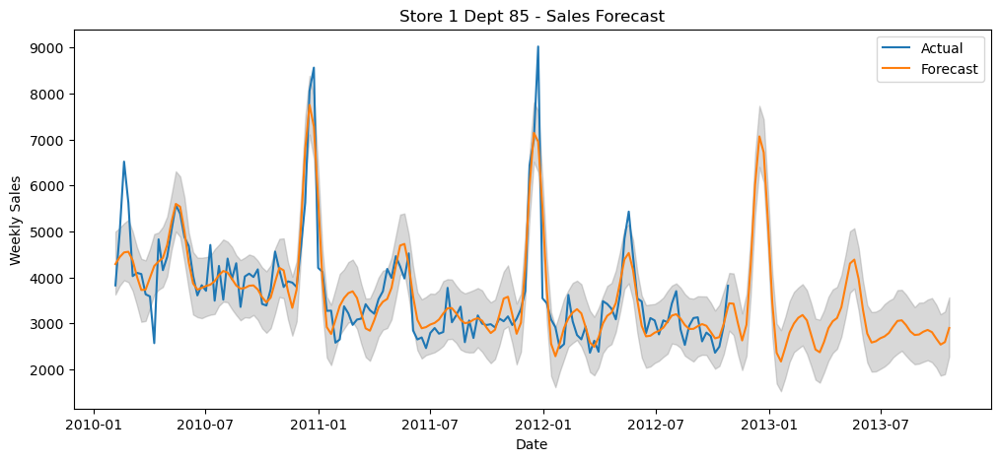

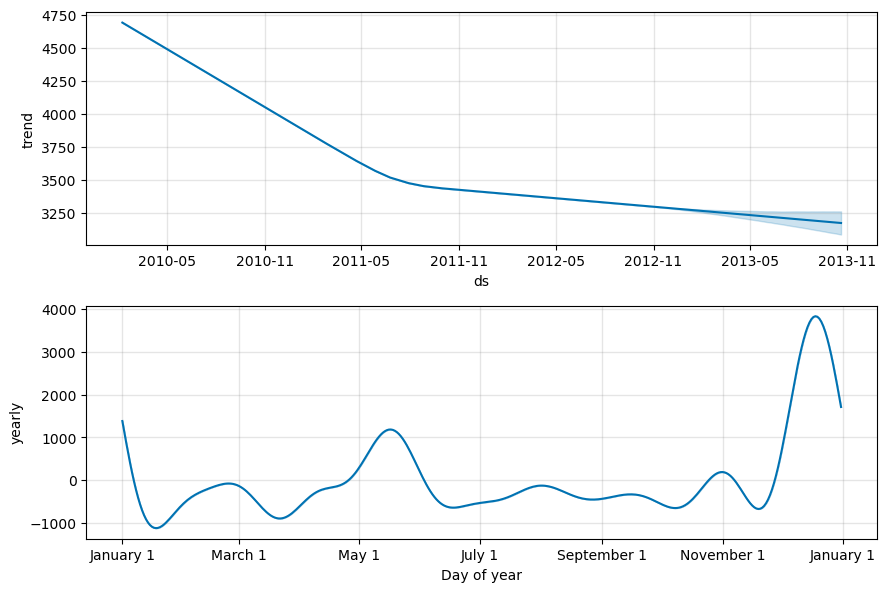


Forecasting for Store 1, Department 87


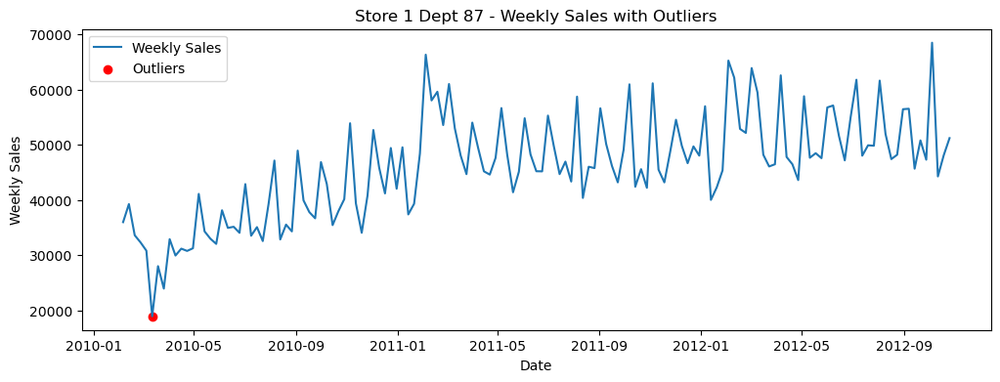

12:13:17 - cmdstanpy - INFO - Chain [1] start processing
12:13:17 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 87 - MAE: 4426.76, RMSE: 5525.75


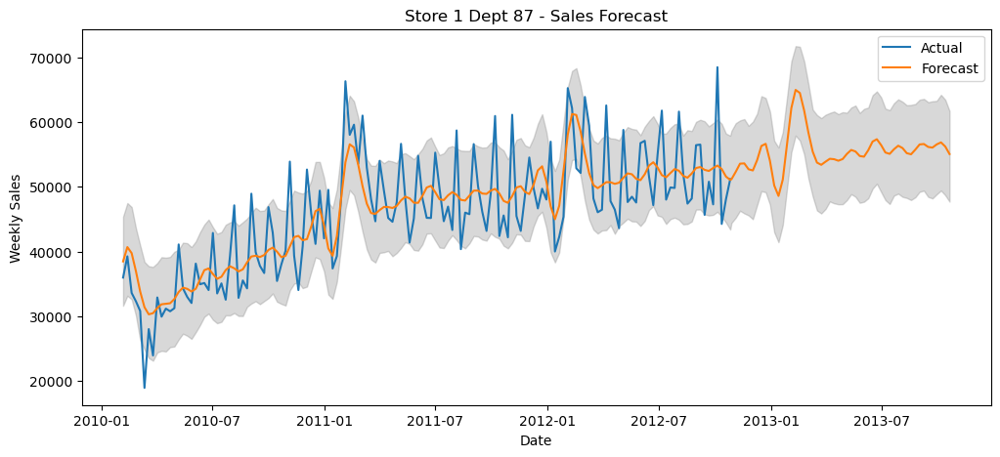

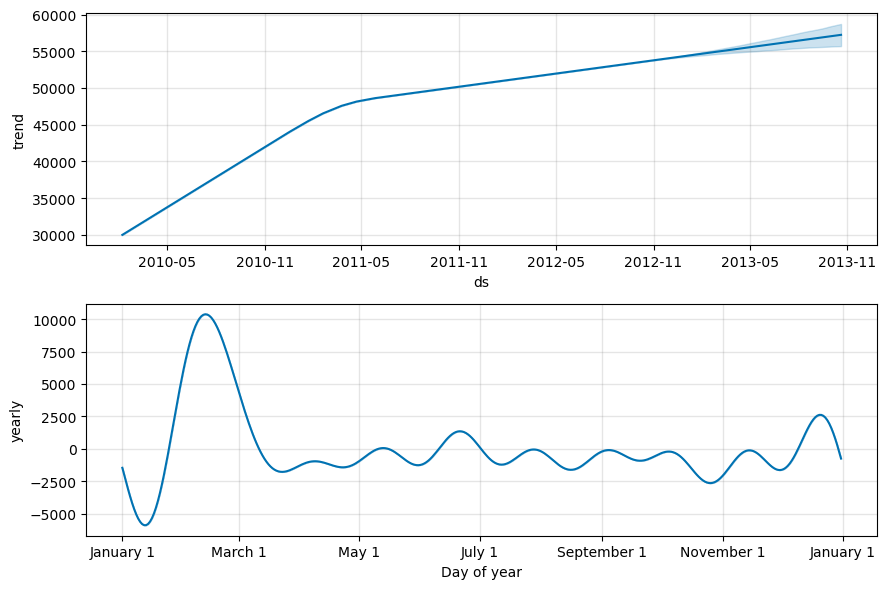


Forecasting for Store 1, Department 90


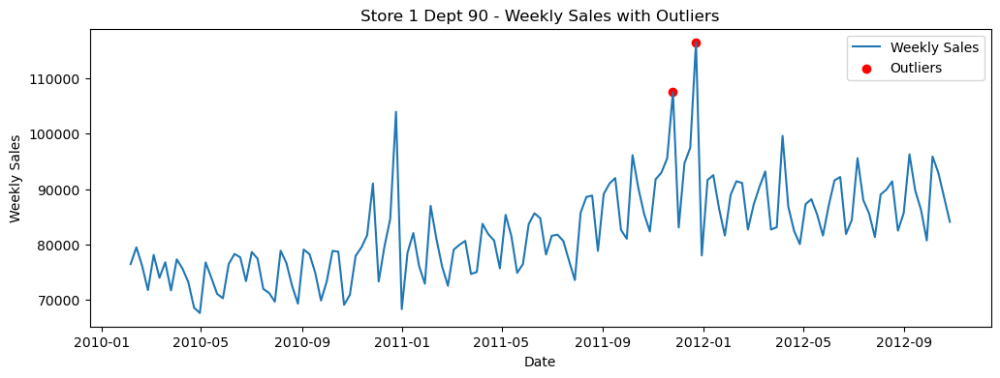

12:13:19 - cmdstanpy - INFO - Chain [1] start processing
12:13:19 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 90 - MAE: 3976.44, RMSE: 5248.69


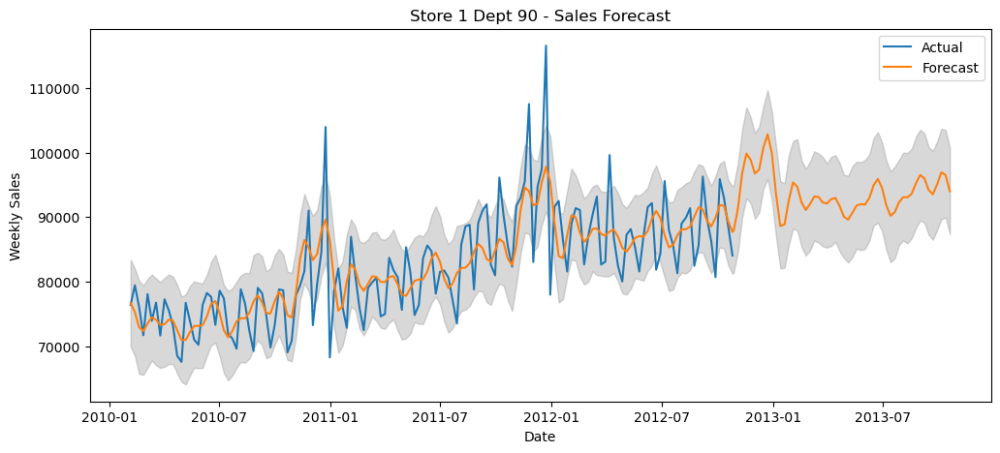

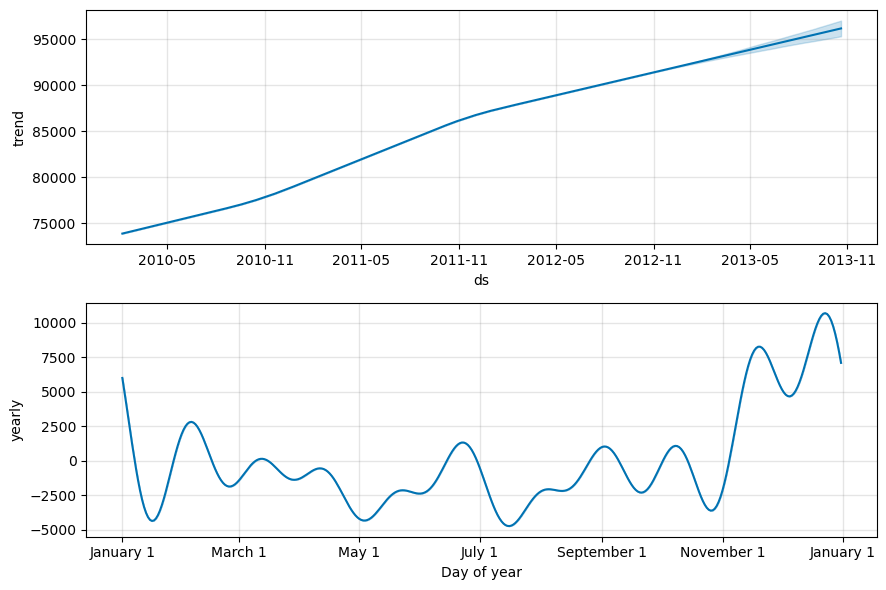


Forecasting for Store 1, Department 91


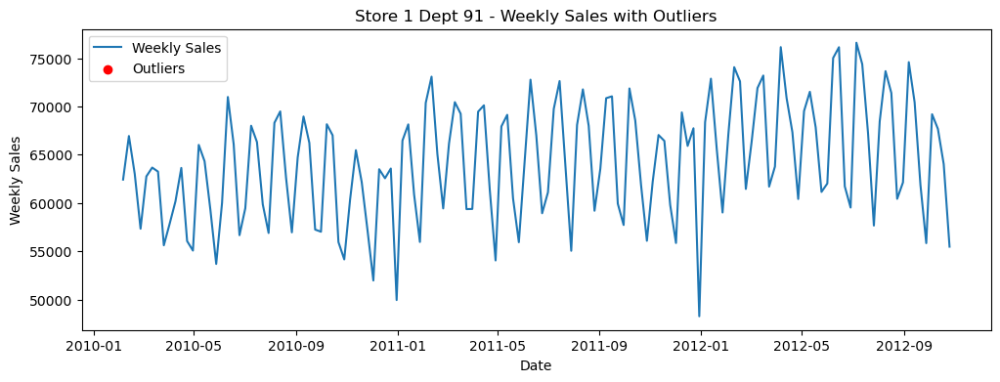

12:13:21 - cmdstanpy - INFO - Chain [1] start processing
12:13:21 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 91 - MAE: 4725.80, RMSE: 5461.94


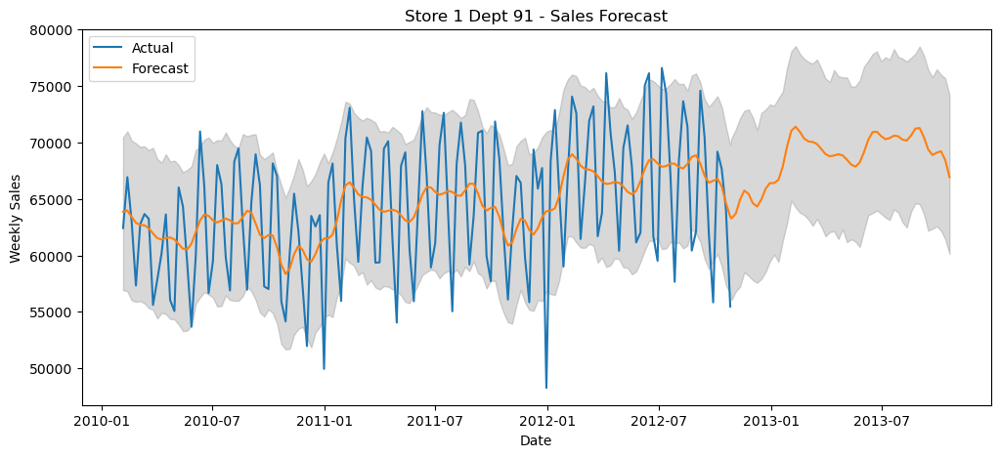

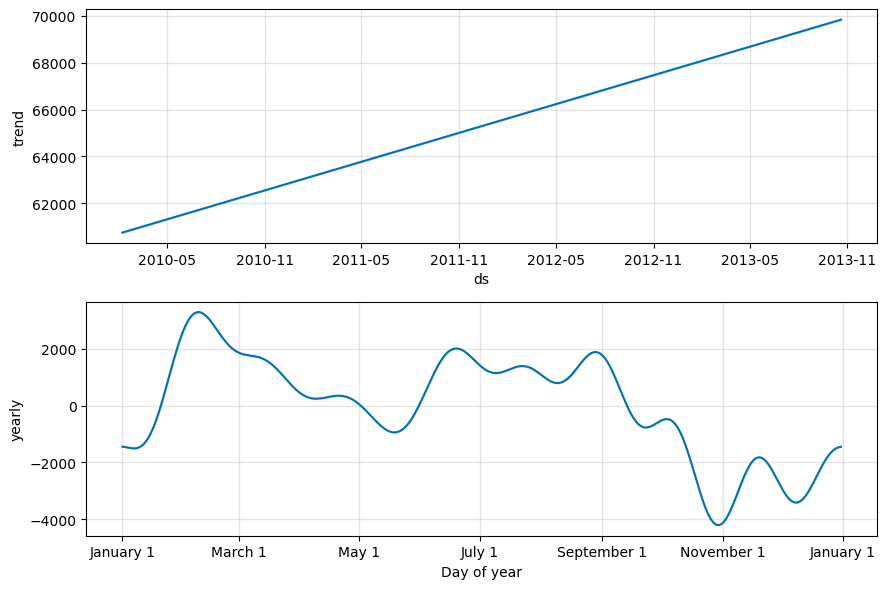


Forecasting for Store 1, Department 92


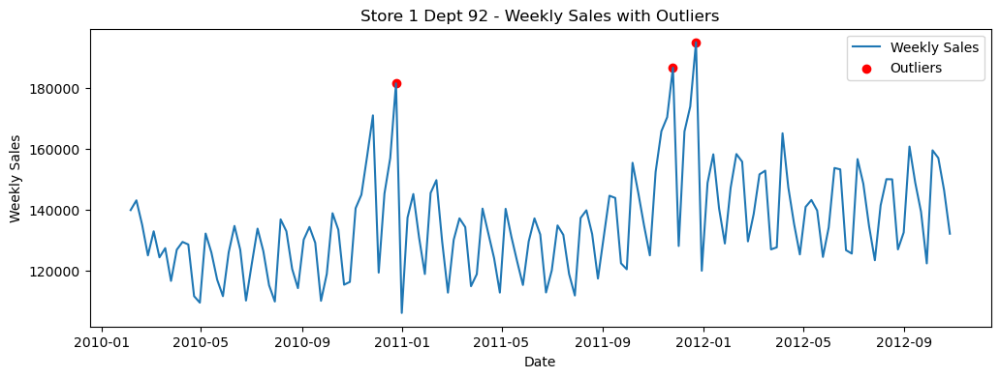

12:13:23 - cmdstanpy - INFO - Chain [1] start processing
12:13:23 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 92 - MAE: 9857.73, RMSE: 12268.24


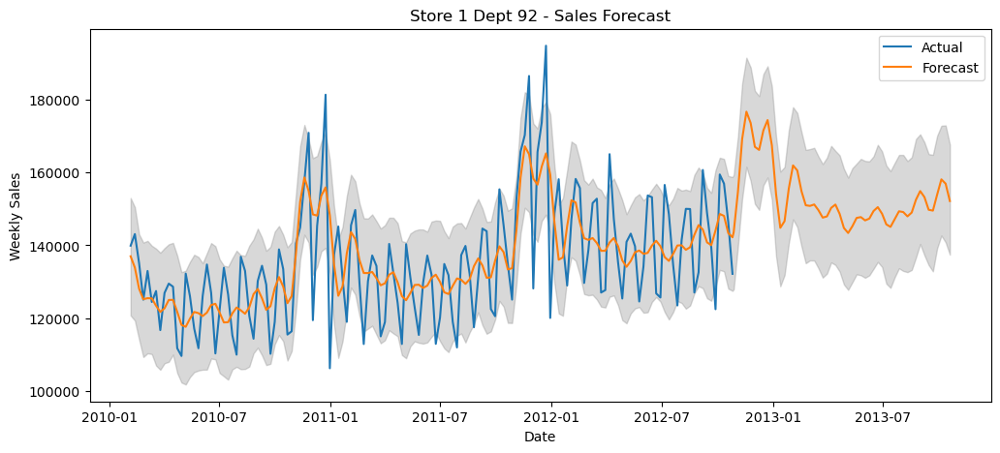

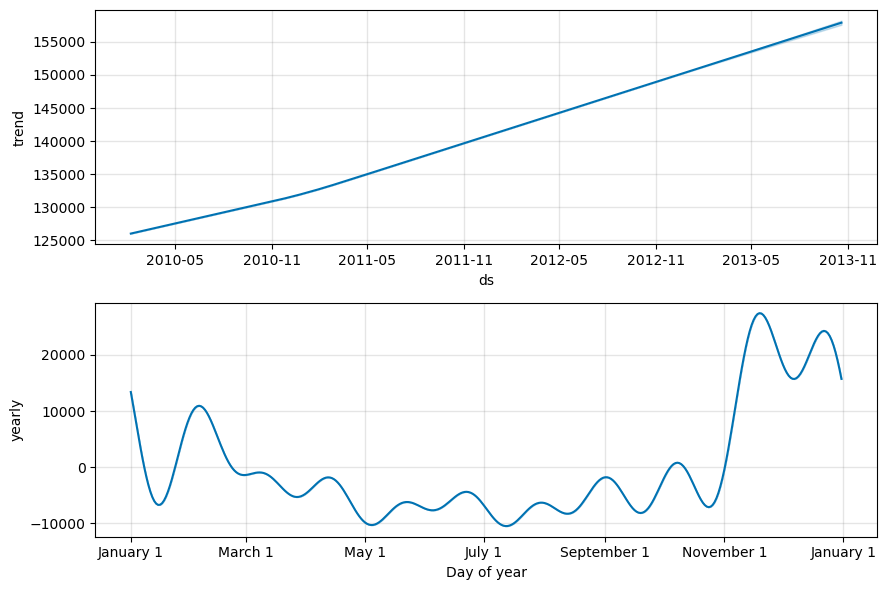


Forecasting for Store 1, Department 93


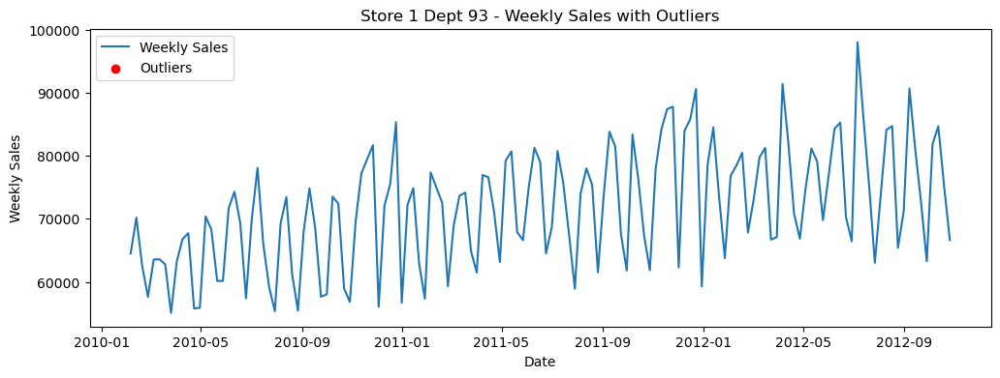

12:13:25 - cmdstanpy - INFO - Chain [1] start processing
12:13:25 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 93 - MAE: 6199.28, RMSE: 7500.61


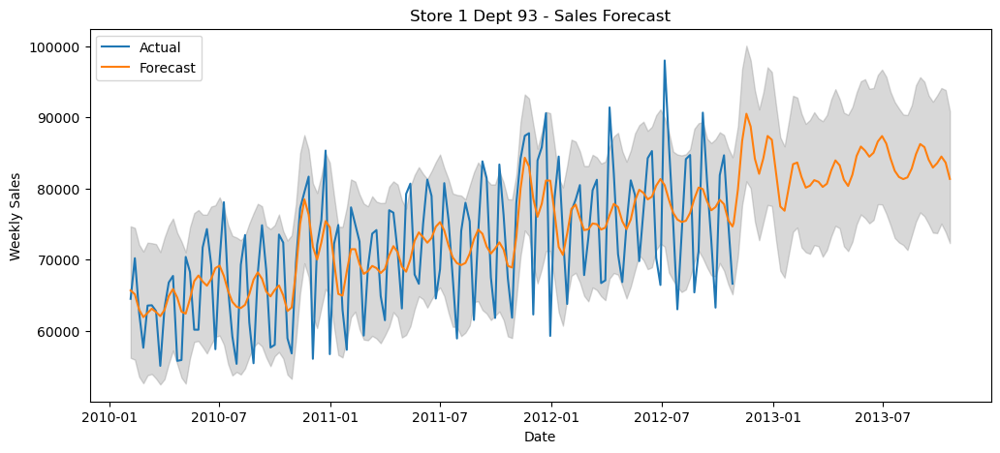

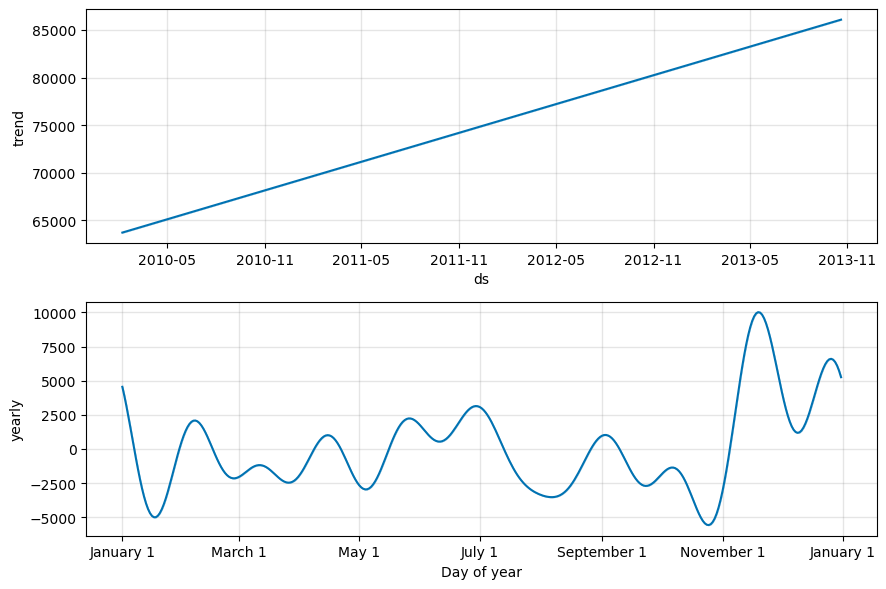


Forecasting for Store 1, Department 94


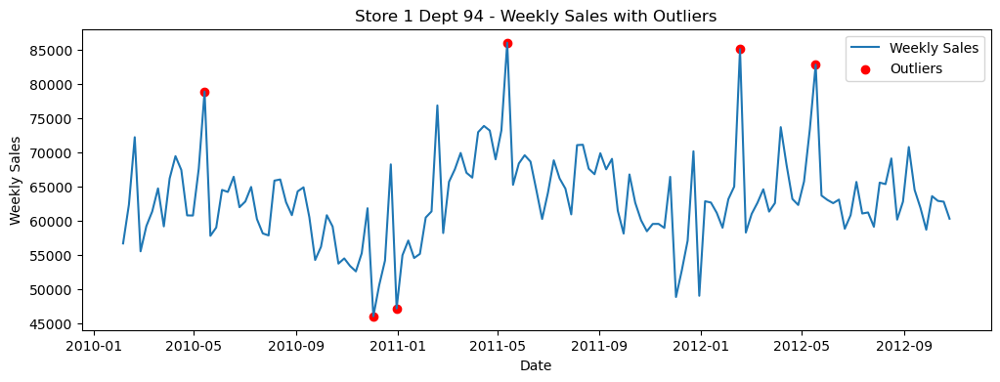

12:13:26 - cmdstanpy - INFO - Chain [1] start processing
12:13:26 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 94 - MAE: 3547.82, RMSE: 4678.92


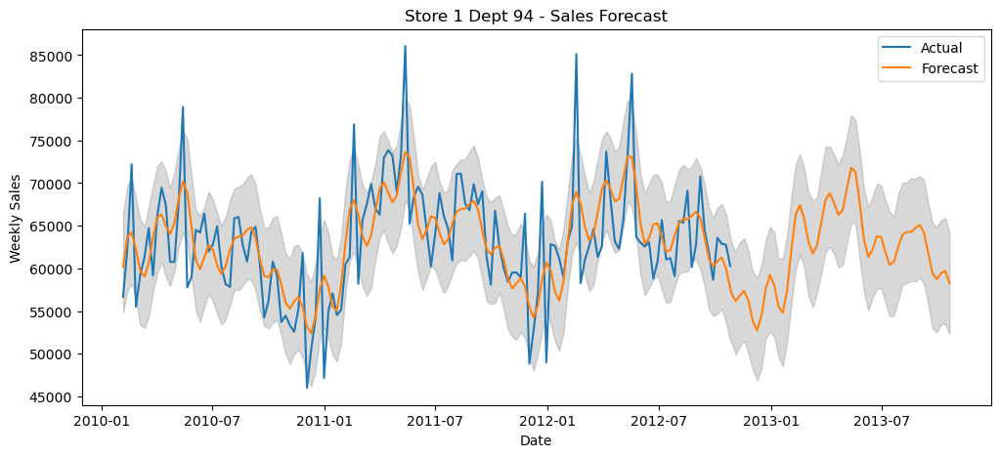

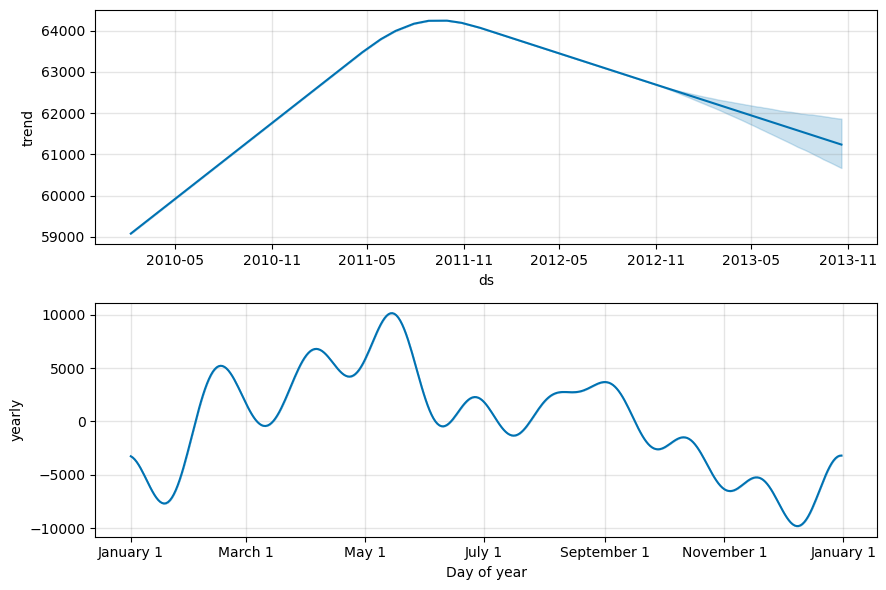


Forecasting for Store 1, Department 95


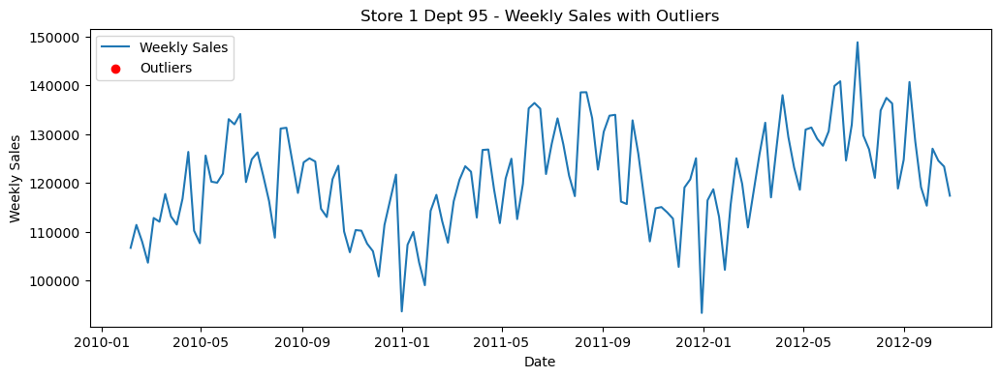

12:13:28 - cmdstanpy - INFO - Chain [1] start processing
12:13:28 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 95 - MAE: 5079.07, RMSE: 6305.55


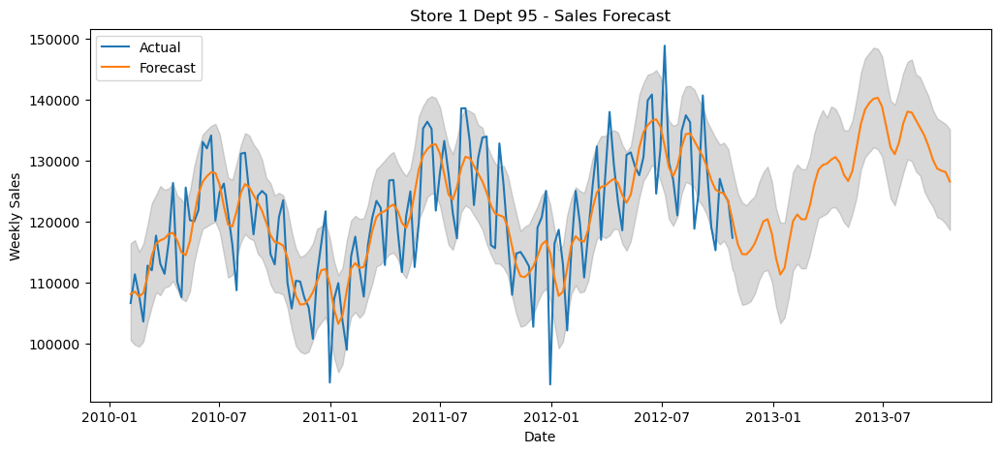

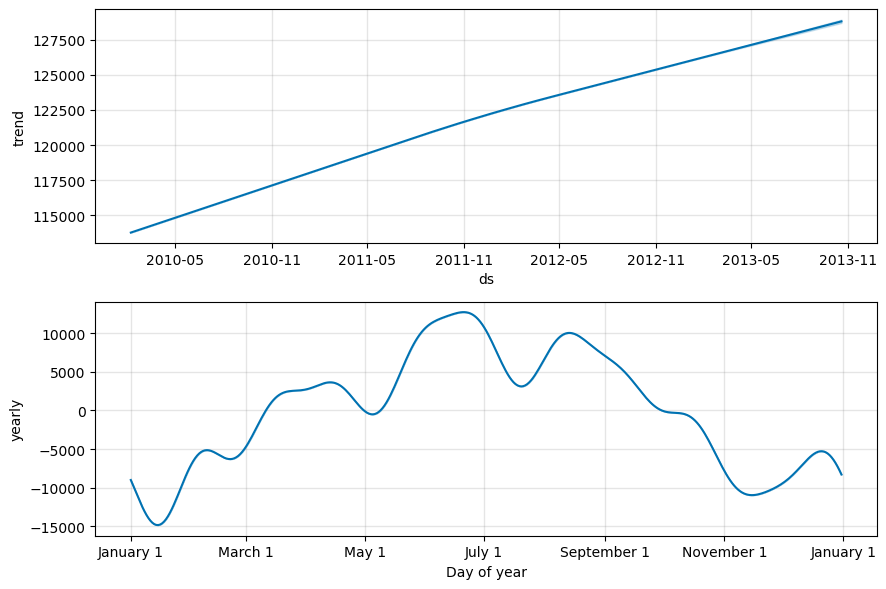


Forecasting for Store 1, Department 96


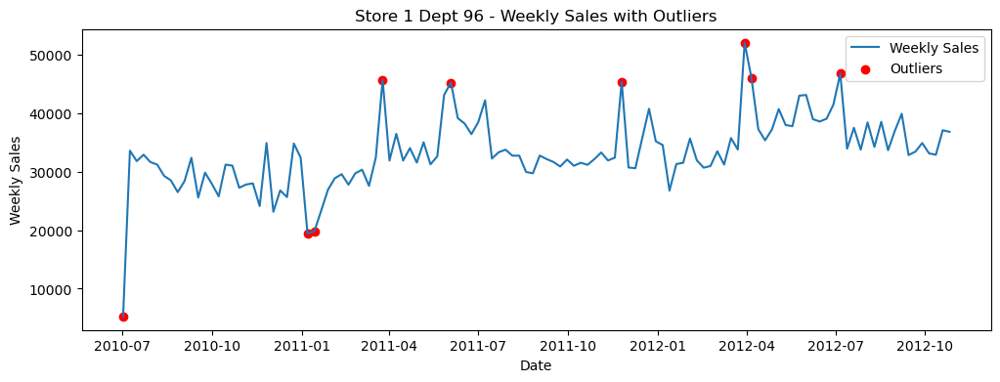

12:13:30 - cmdstanpy - INFO - Chain [1] start processing
12:13:30 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 96 - MAE: 2690.11, RMSE: 3956.71


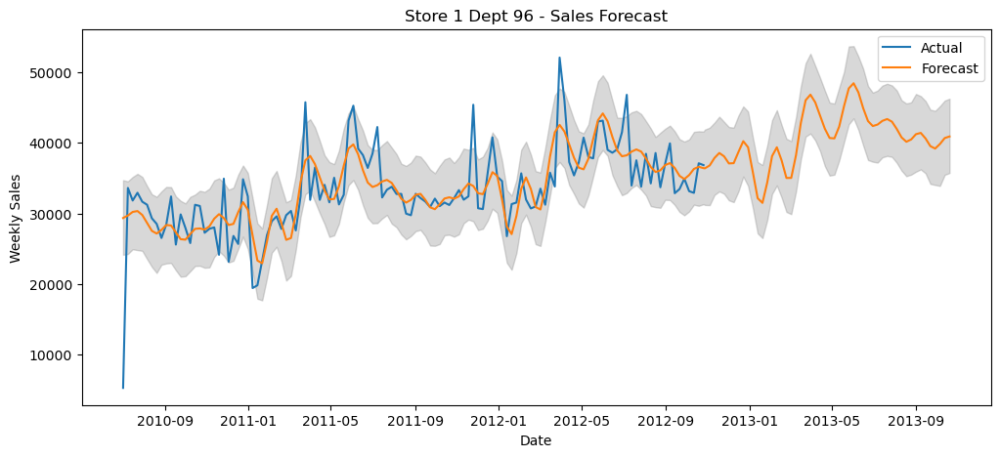

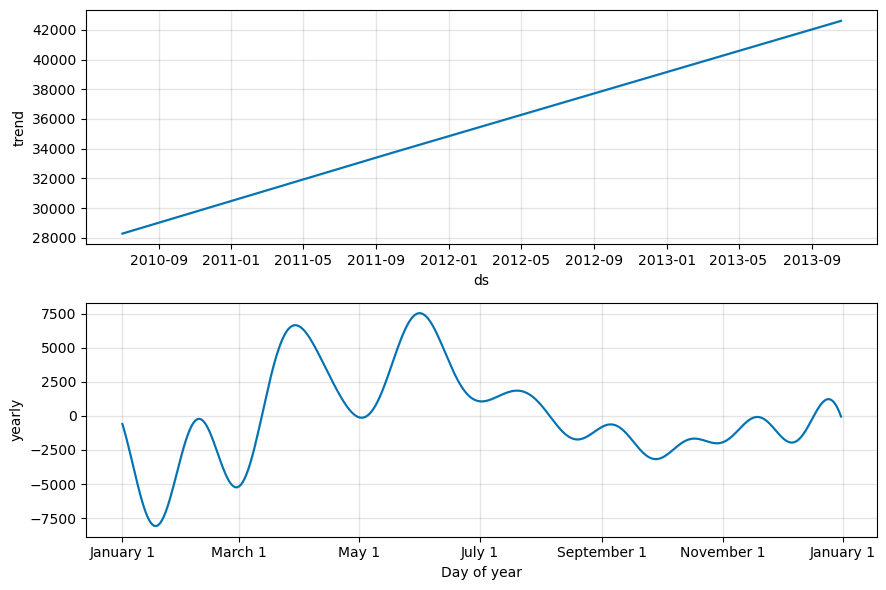


Forecasting for Store 1, Department 97


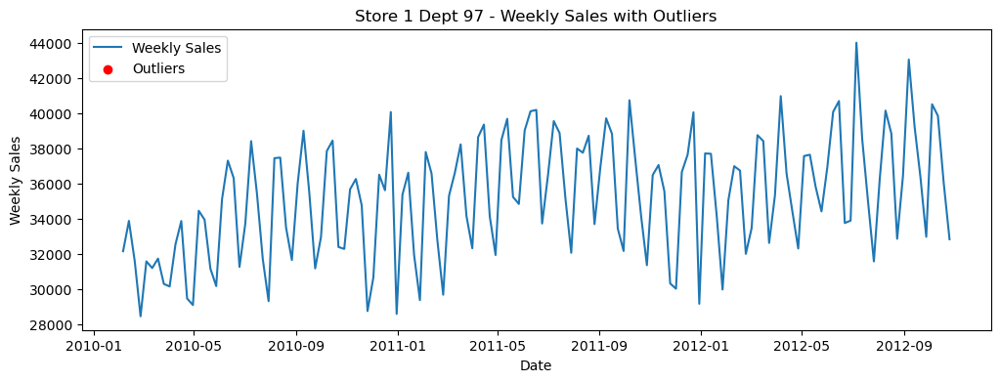

12:13:32 - cmdstanpy - INFO - Chain [1] start processing
12:13:32 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 97 - MAE: 2441.02, RMSE: 2846.69


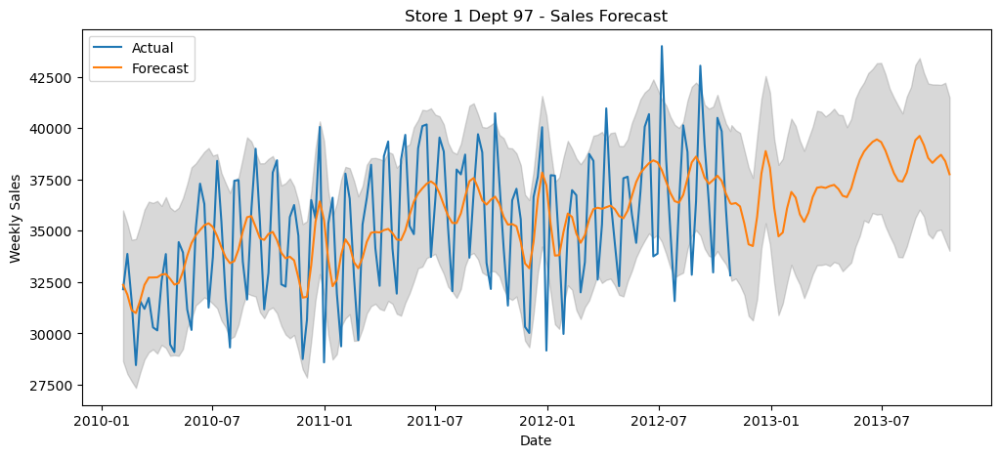

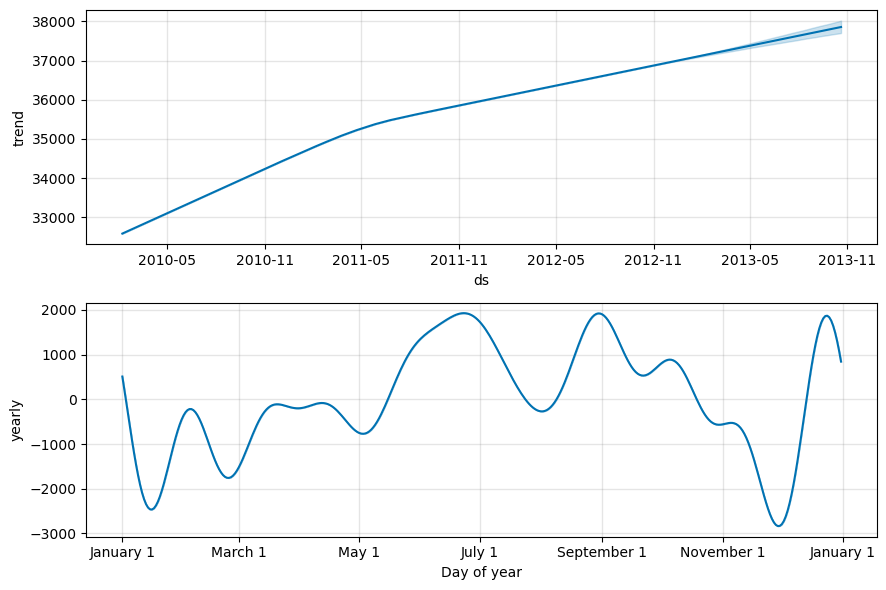


Forecasting for Store 1, Department 98


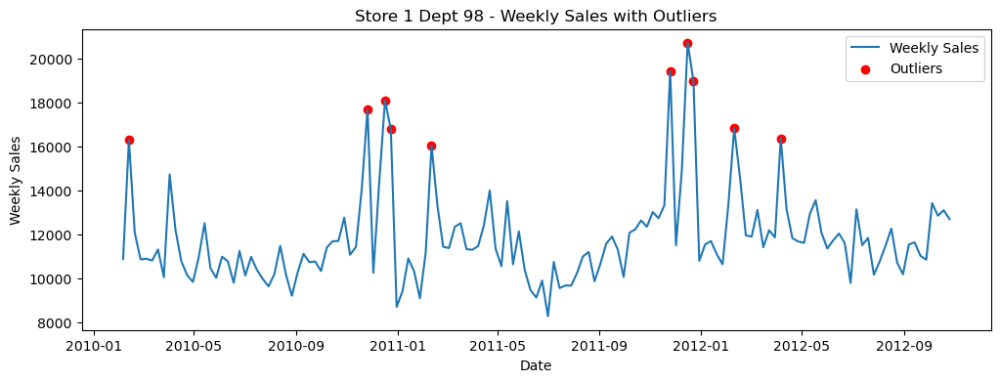

12:13:34 - cmdstanpy - INFO - Chain [1] start processing
12:13:34 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 98 - MAE: 997.25, RMSE: 1386.38


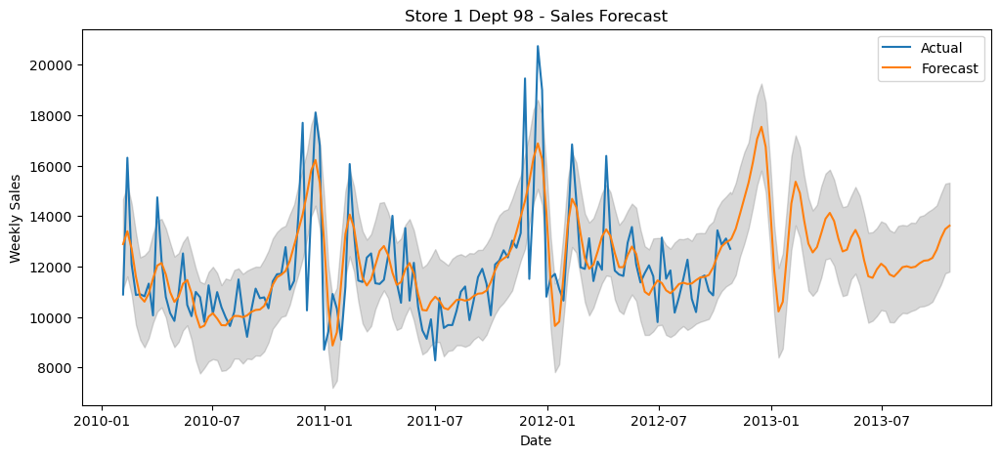

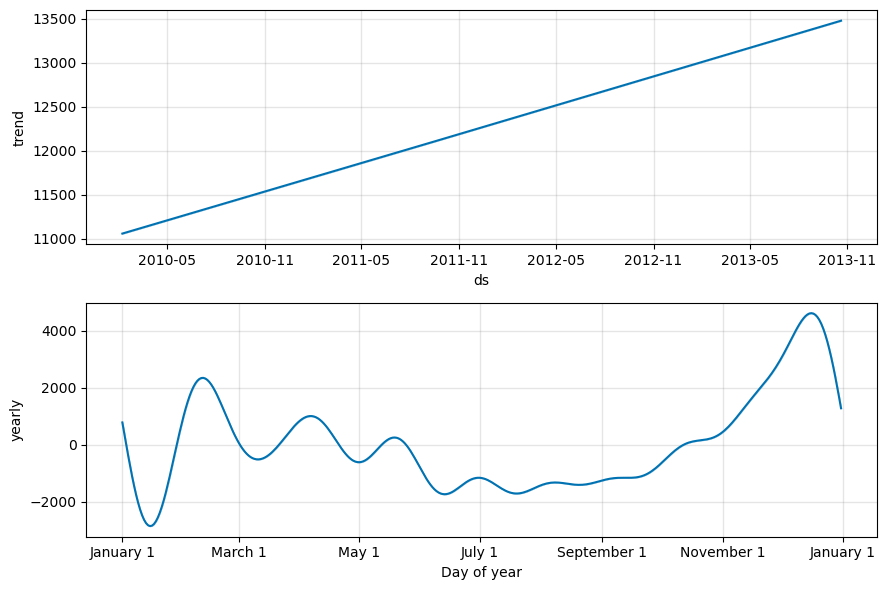


Forecasting for Store 1, Department 99


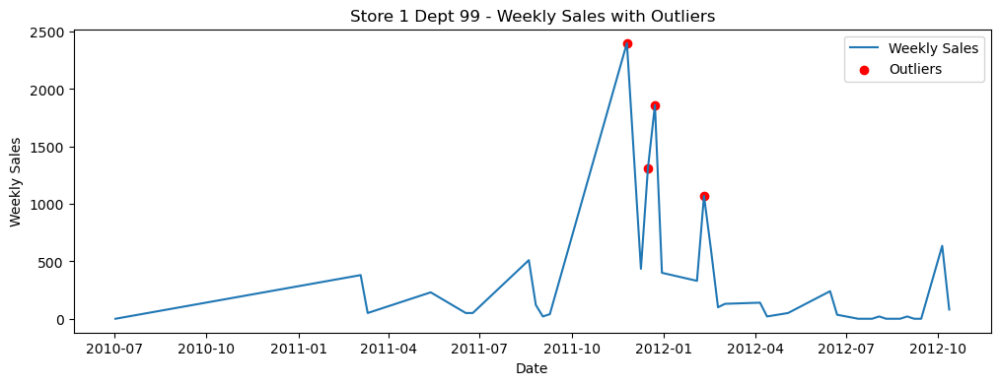

12:13:36 - cmdstanpy - INFO - Chain [1] start processing
12:13:36 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 1 Dept 99 - MAE: 77.75, RMSE: 97.78


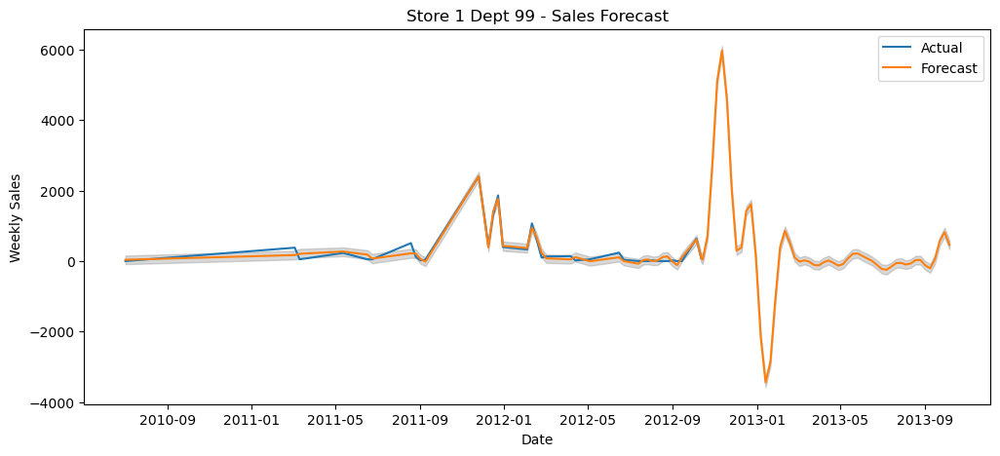

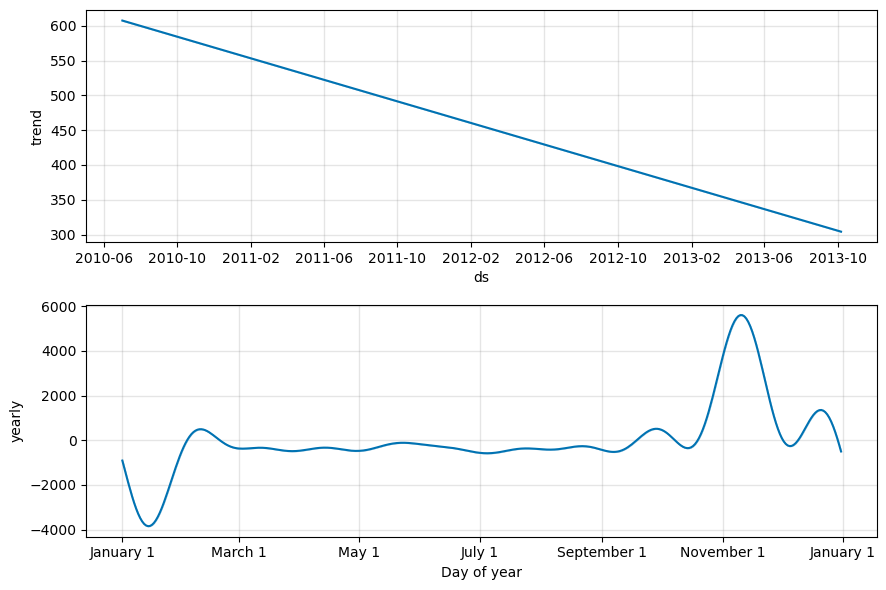


Forecasting for Store 1, Department 39


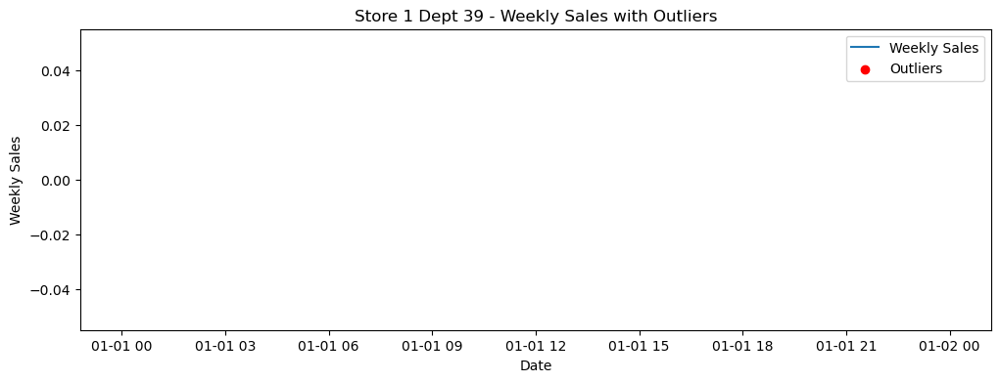

Failed for Store 1, Dept 39 due to: Dataframe has less than 2 non-NaN rows.

Forecasting for Store 1, Department 50


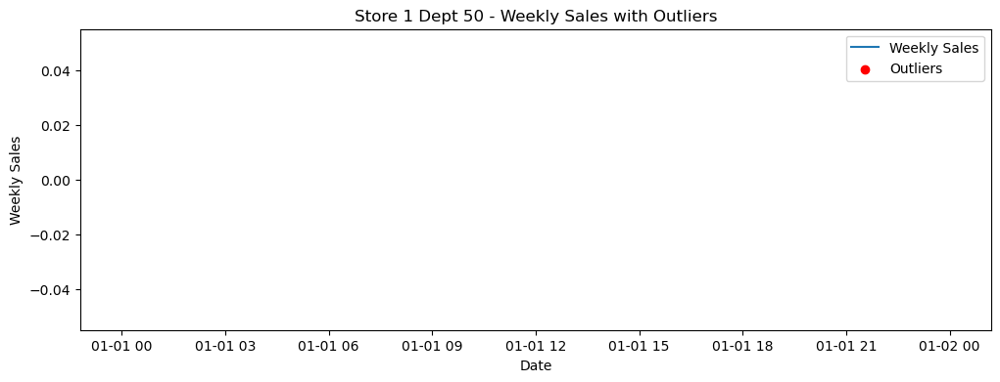

Failed for Store 1, Dept 50 due to: Dataframe has less than 2 non-NaN rows.

Forecasting for Store 1, Department 43


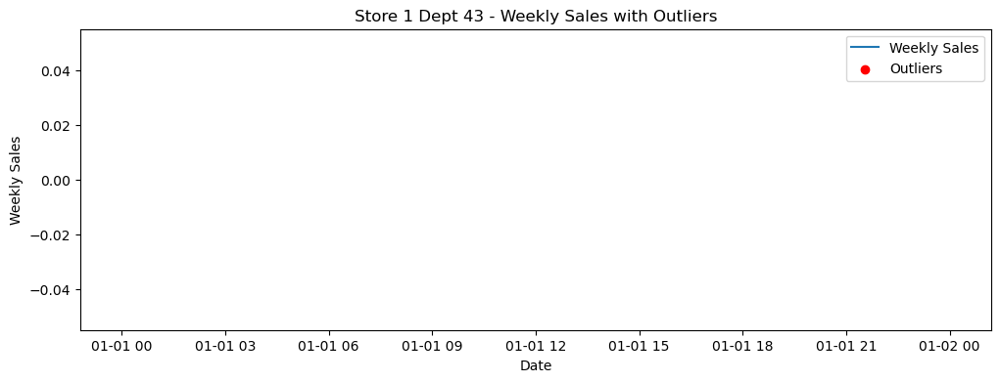

Failed for Store 1, Dept 43 due to: Dataframe has less than 2 non-NaN rows.

Forecasting for Store 1, Department 65


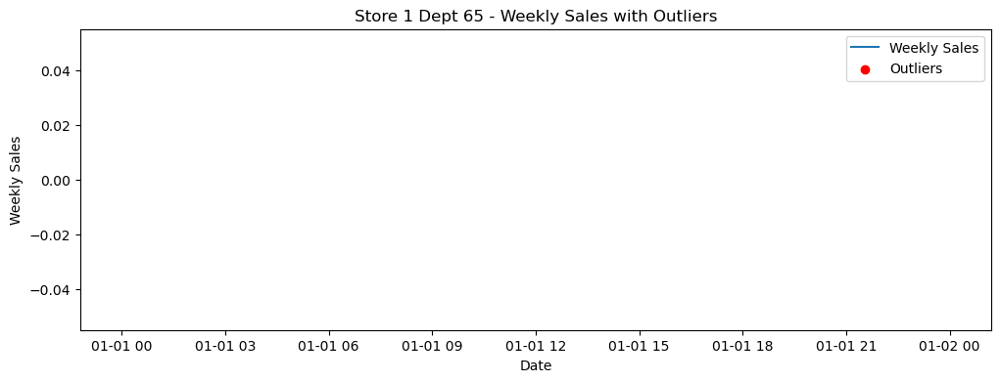

Failed for Store 1, Dept 65 due to: Dataframe has less than 2 non-NaN rows.

Forecasting for Store 2, Department 1


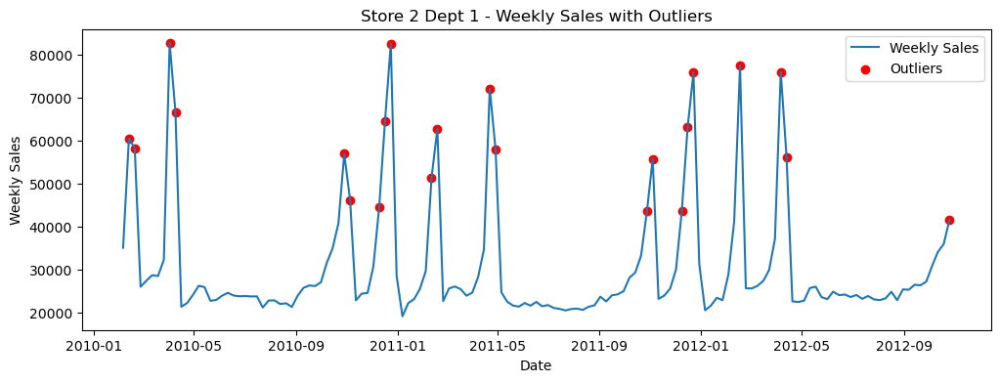

12:13:39 - cmdstanpy - INFO - Chain [1] start processing
12:13:39 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 1 - MAE: 5494.96, RMSE: 8884.82


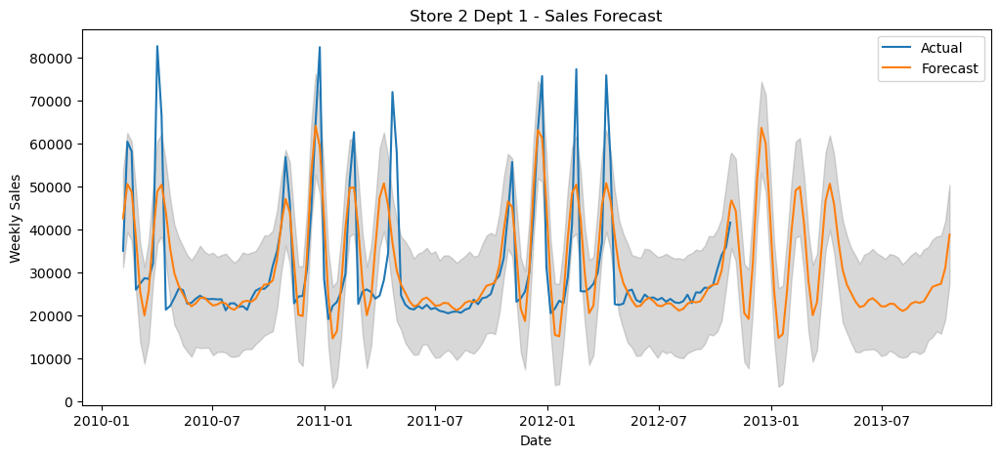

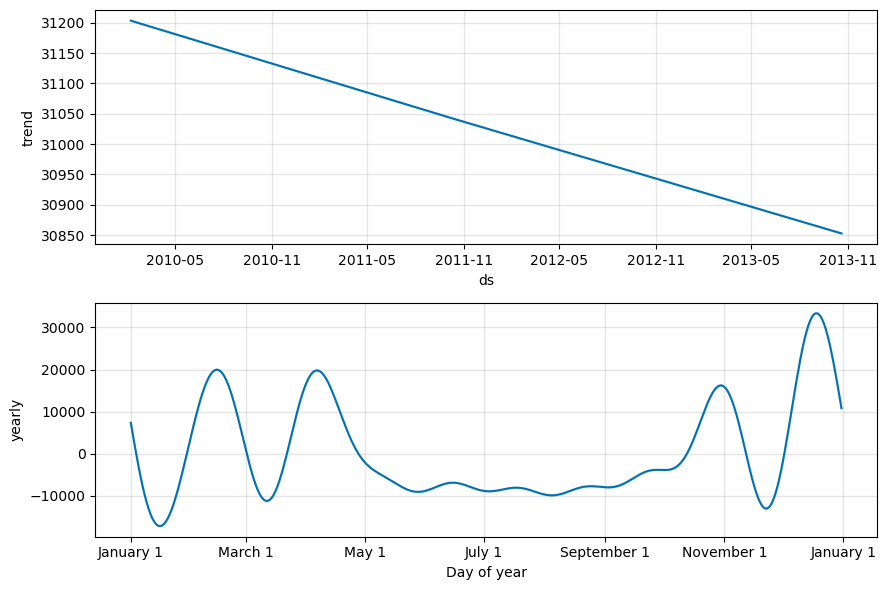


Forecasting for Store 2, Department 2


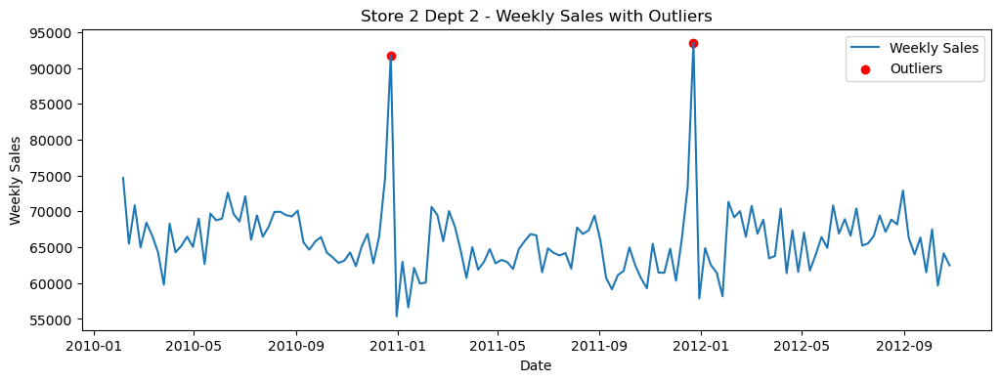

12:13:41 - cmdstanpy - INFO - Chain [1] start processing
12:13:41 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 2 - MAE: 2332.25, RMSE: 3475.15


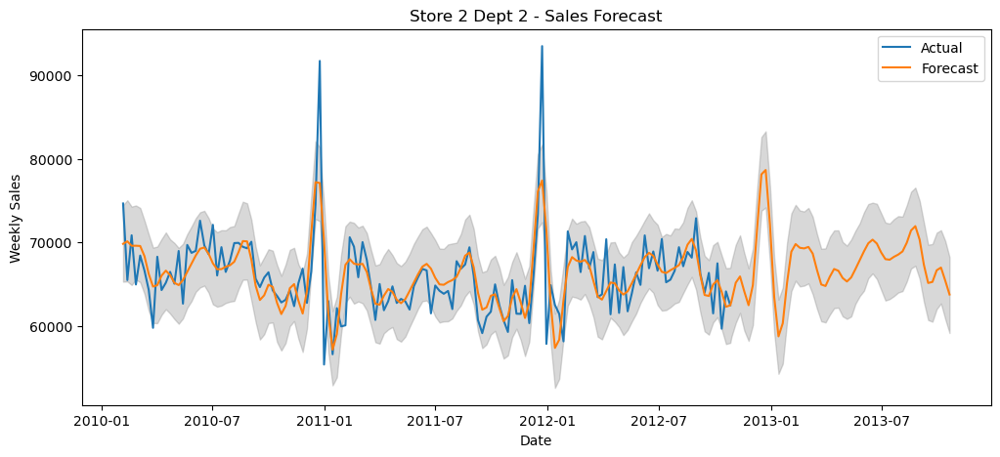

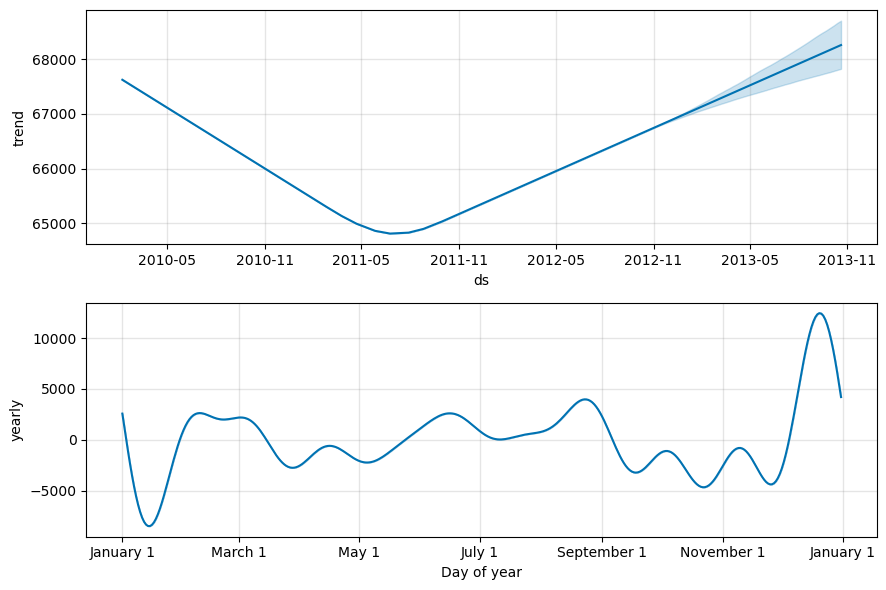


Forecasting for Store 2, Department 3


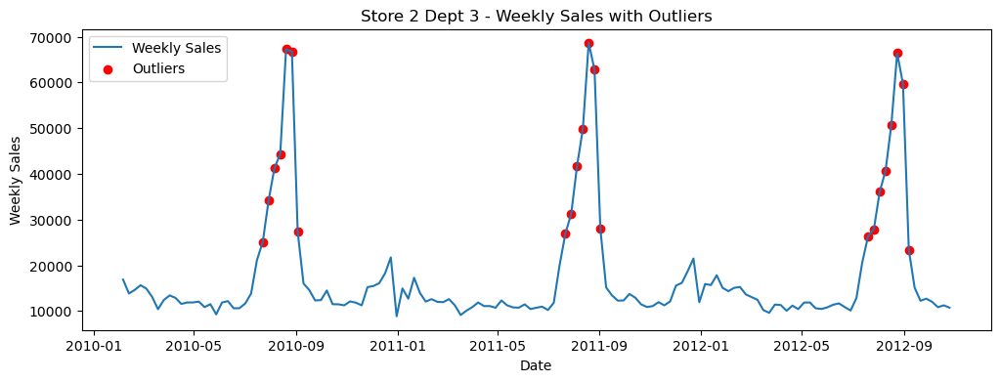

12:13:43 - cmdstanpy - INFO - Chain [1] start processing
12:13:43 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 3 - MAE: 2005.84, RMSE: 3229.22


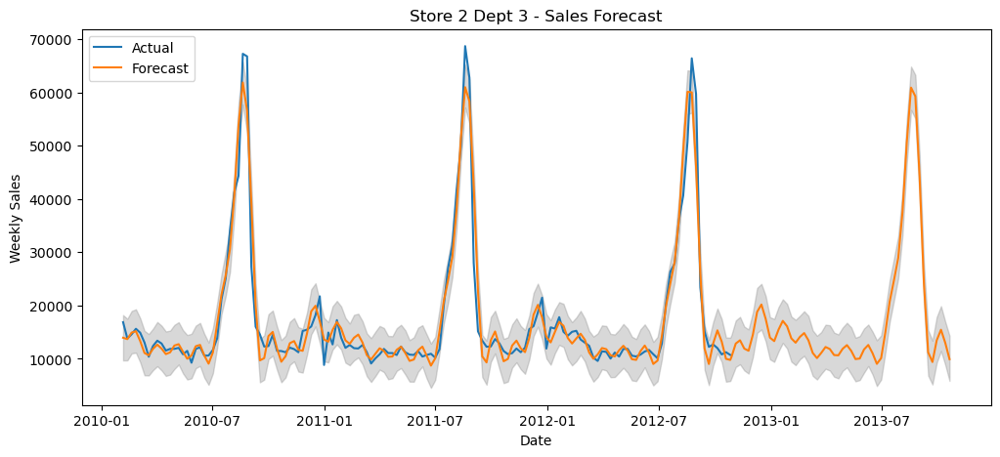

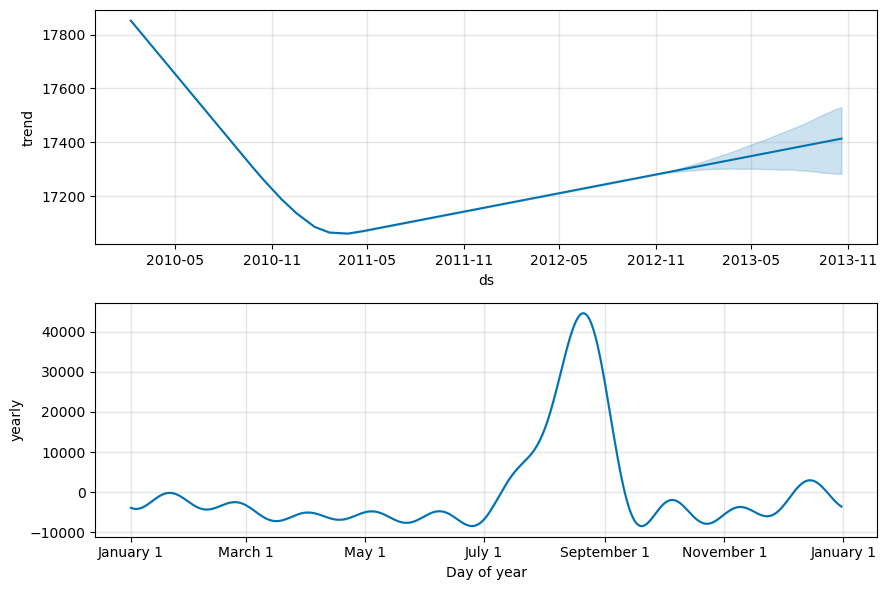


Forecasting for Store 2, Department 4


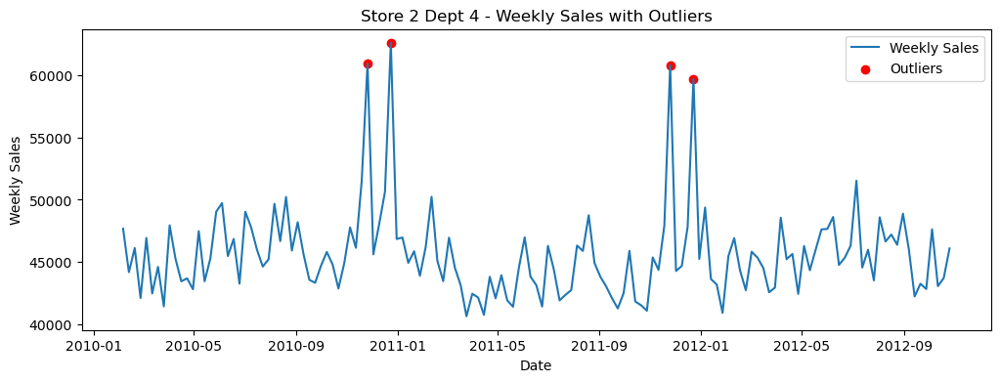

12:13:45 - cmdstanpy - INFO - Chain [1] start processing
12:13:45 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 4 - MAE: 1770.93, RMSE: 2504.55


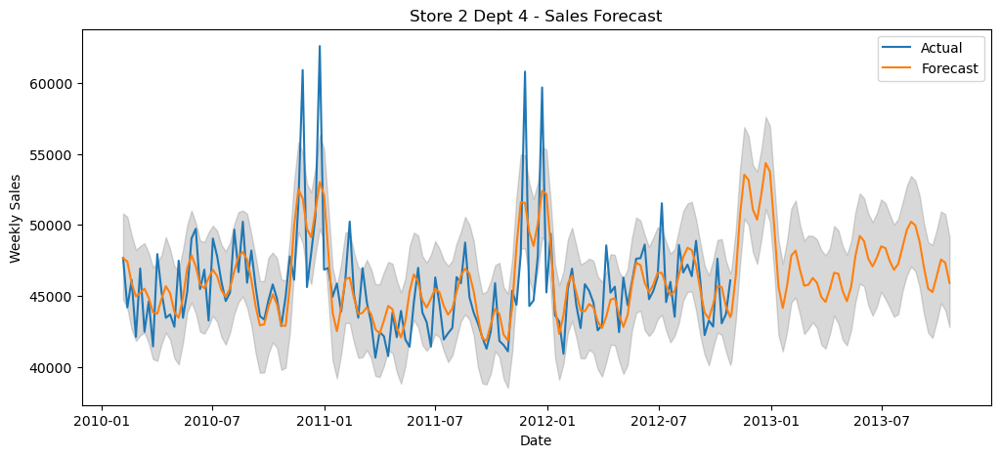

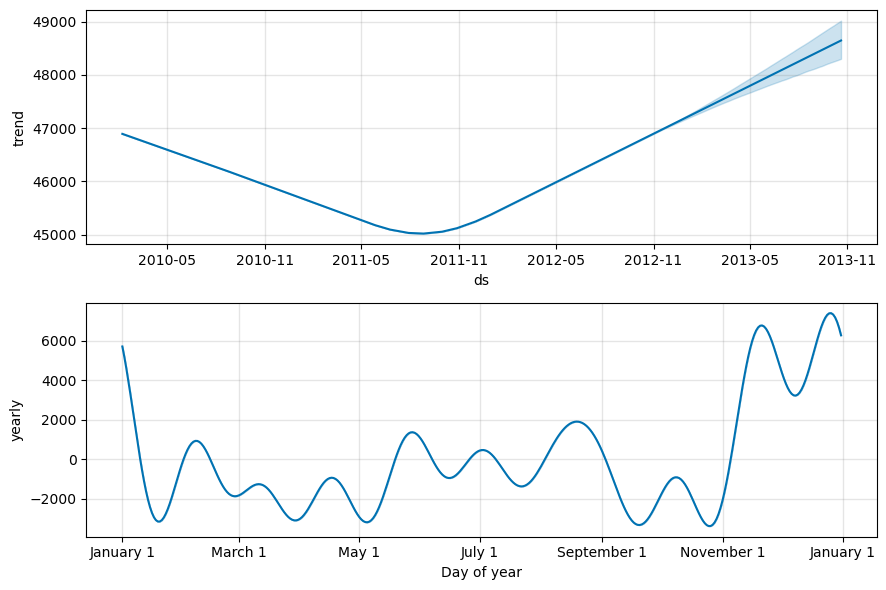


Forecasting for Store 2, Department 5


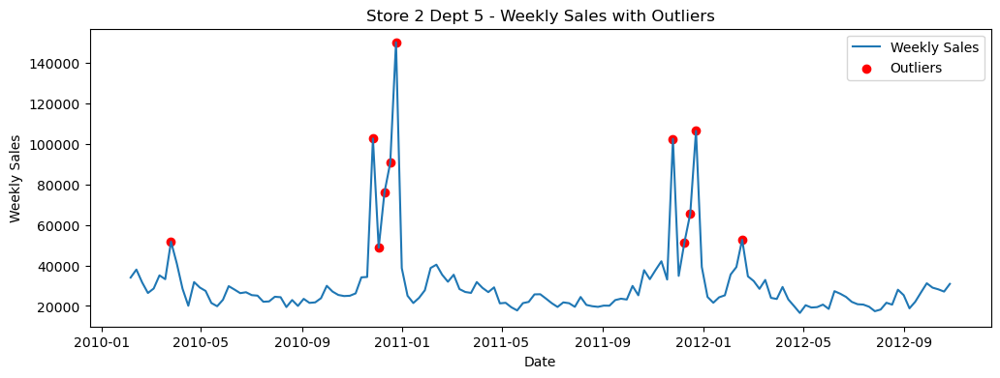

12:13:47 - cmdstanpy - INFO - Chain [1] start processing
12:13:47 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 5 - MAE: 5485.37, RMSE: 10539.43


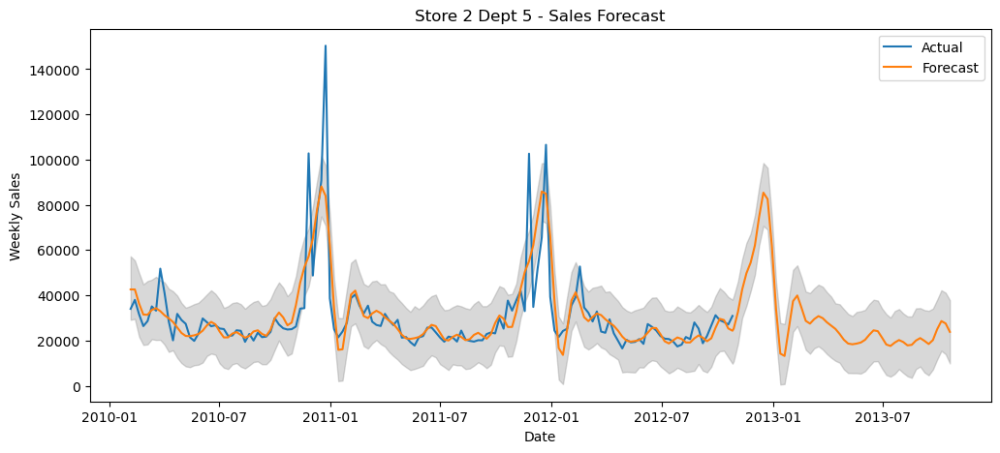

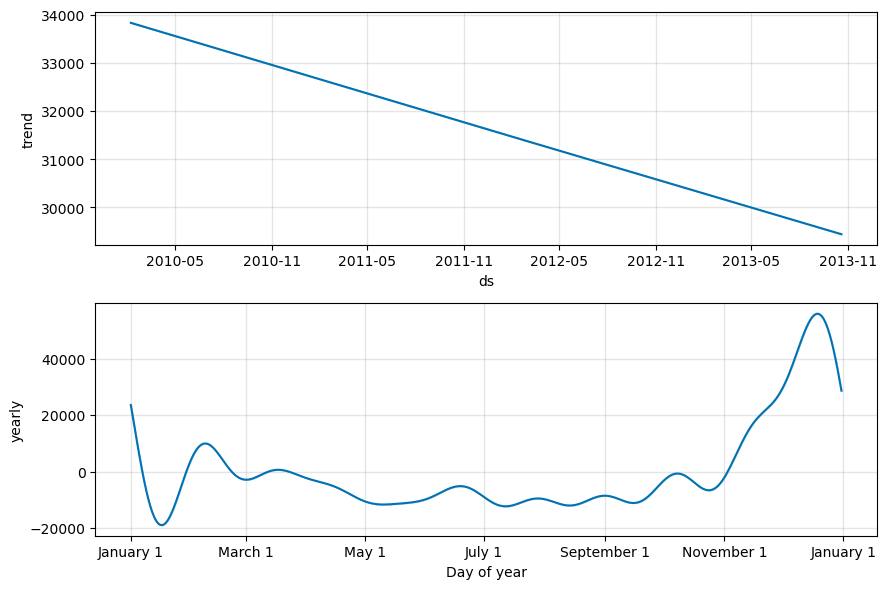


Forecasting for Store 2, Department 6


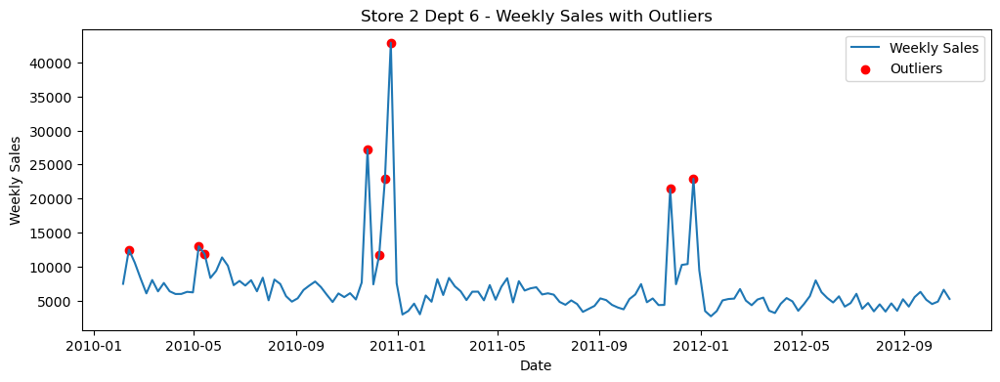

12:13:48 - cmdstanpy - INFO - Chain [1] start processing
12:13:48 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 6 - MAE: 1789.97, RMSE: 3239.65


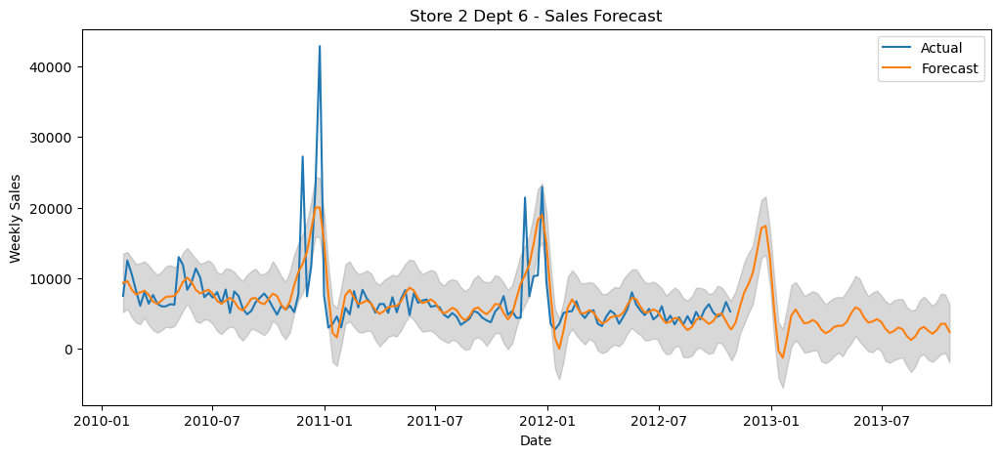

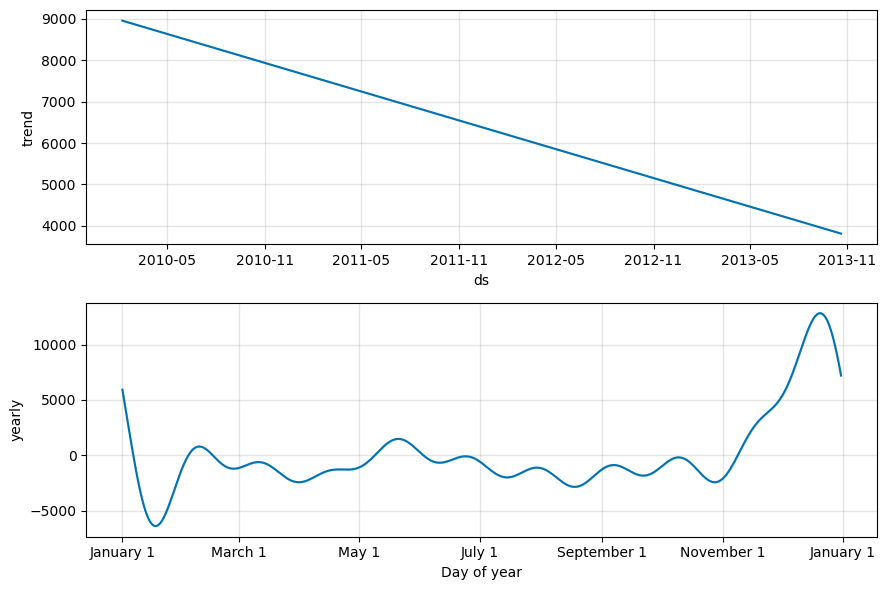


Forecasting for Store 2, Department 7


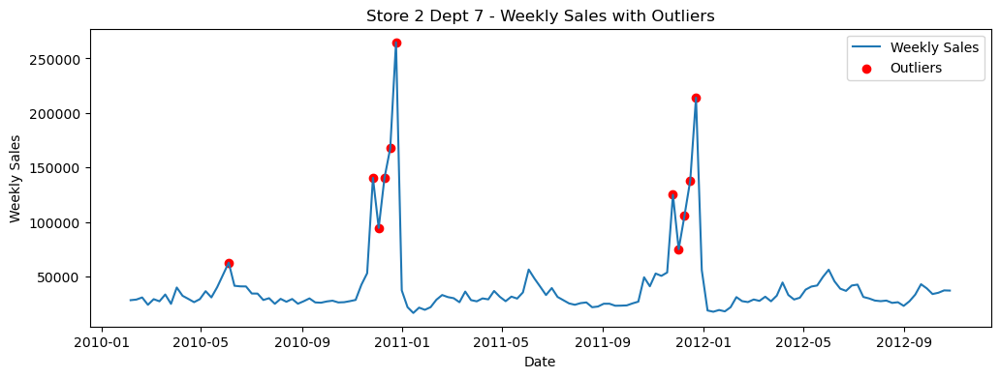

12:13:50 - cmdstanpy - INFO - Chain [1] start processing
12:13:50 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 7 - MAE: 8403.42, RMSE: 16409.72


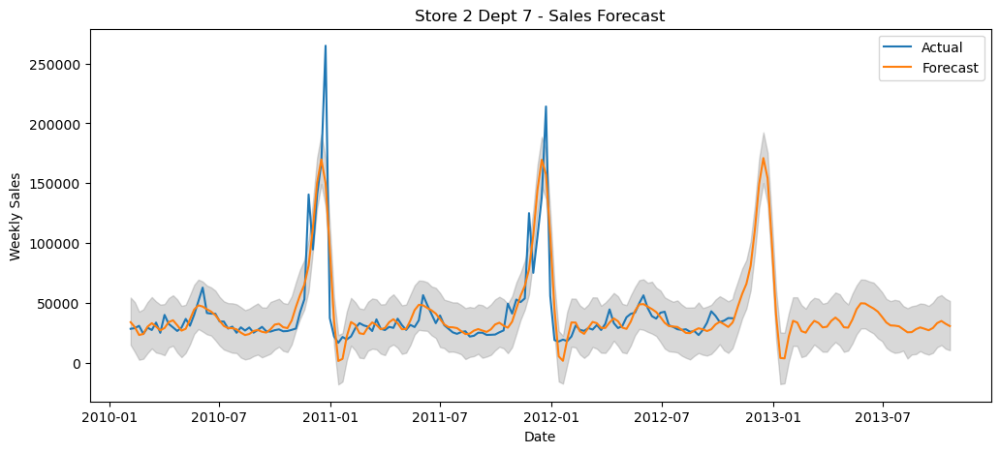

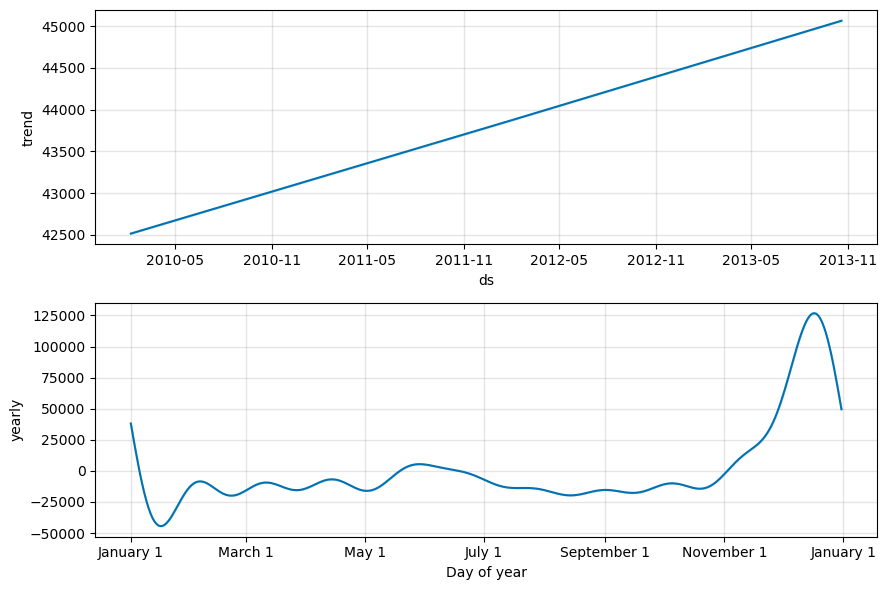


Forecasting for Store 2, Department 8


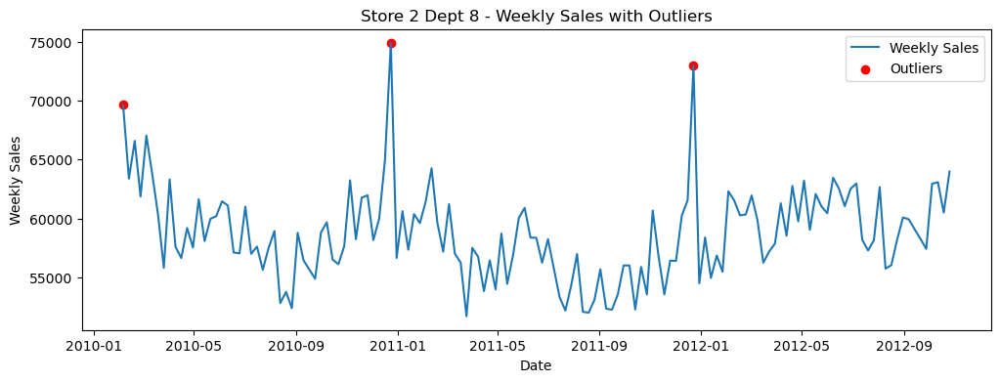

12:13:51 - cmdstanpy - INFO - Chain [1] start processing
12:13:52 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 8 - MAE: 1816.11, RMSE: 2369.79


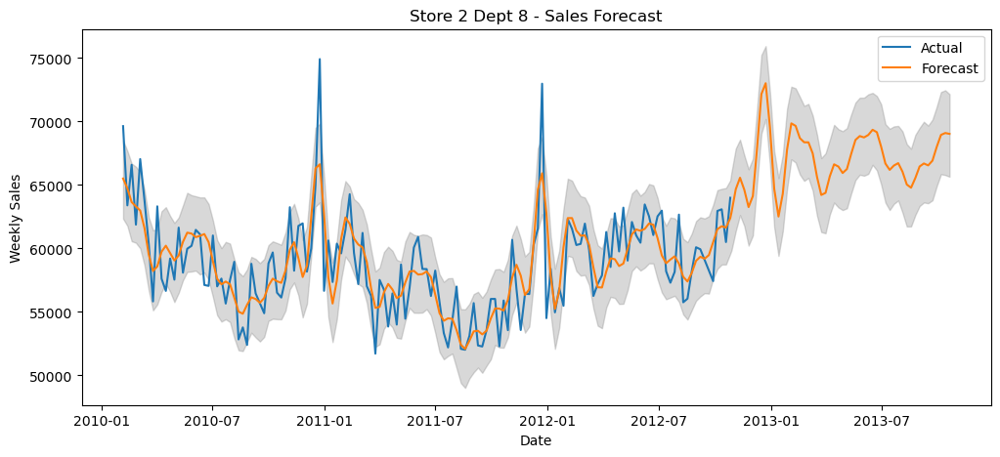

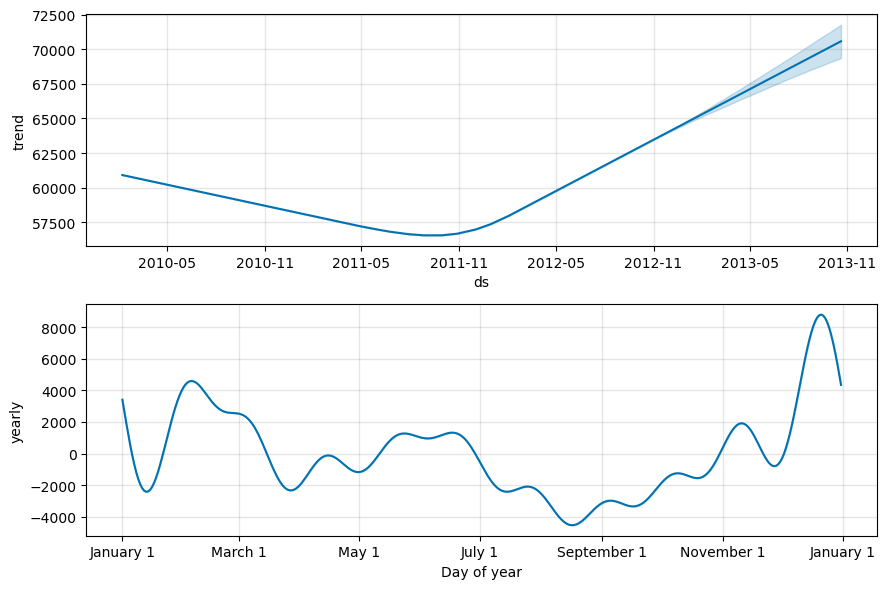


Forecasting for Store 2, Department 9


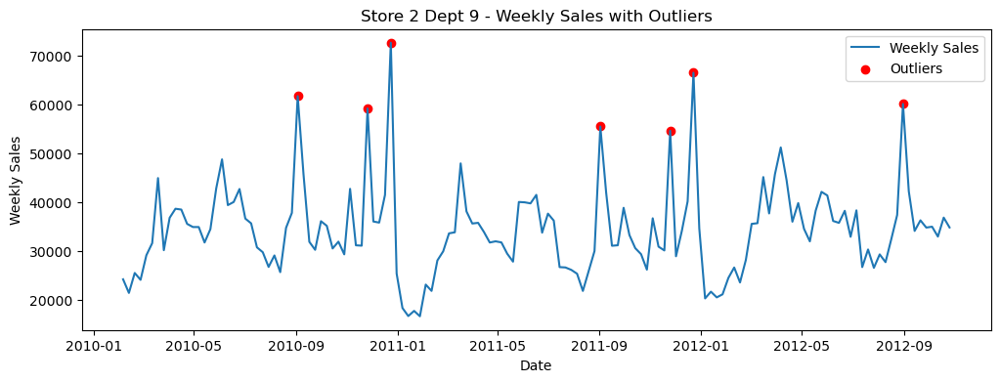

12:13:53 - cmdstanpy - INFO - Chain [1] start processing
12:13:53 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 9 - MAE: 4251.60, RMSE: 5784.17


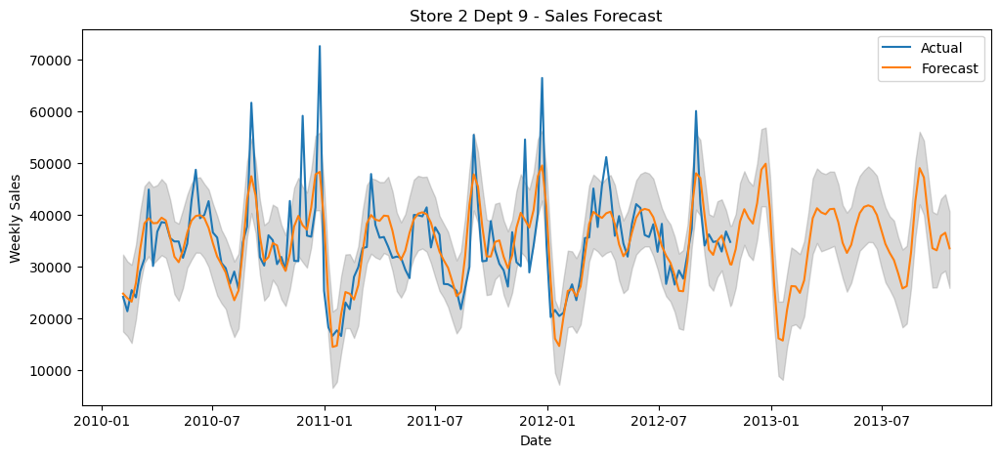

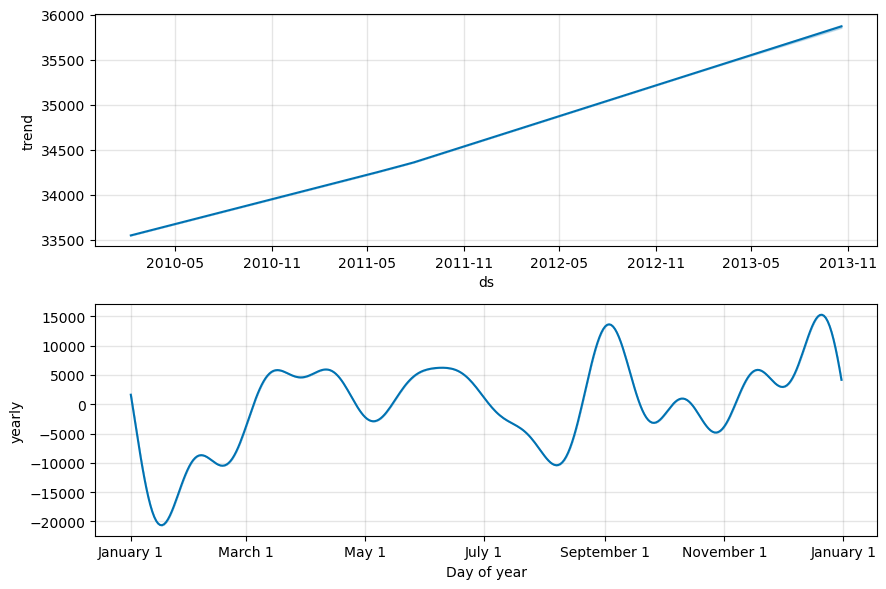


Forecasting for Store 2, Department 10


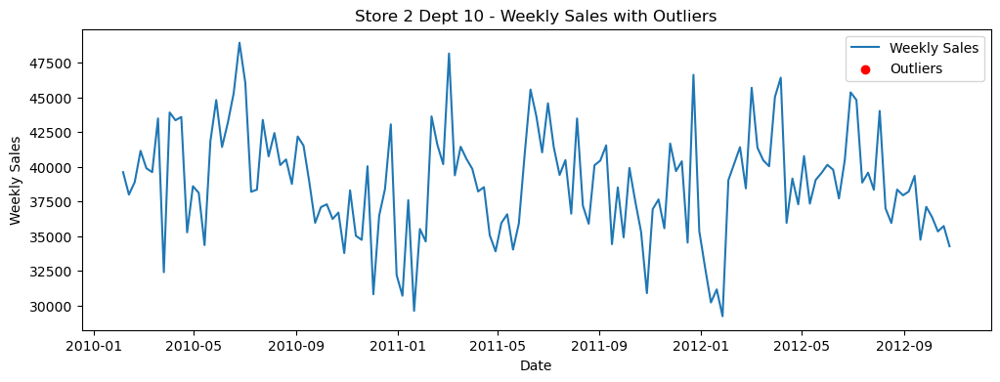

12:13:55 - cmdstanpy - INFO - Chain [1] start processing
12:13:55 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 10 - MAE: 2108.58, RMSE: 2680.38


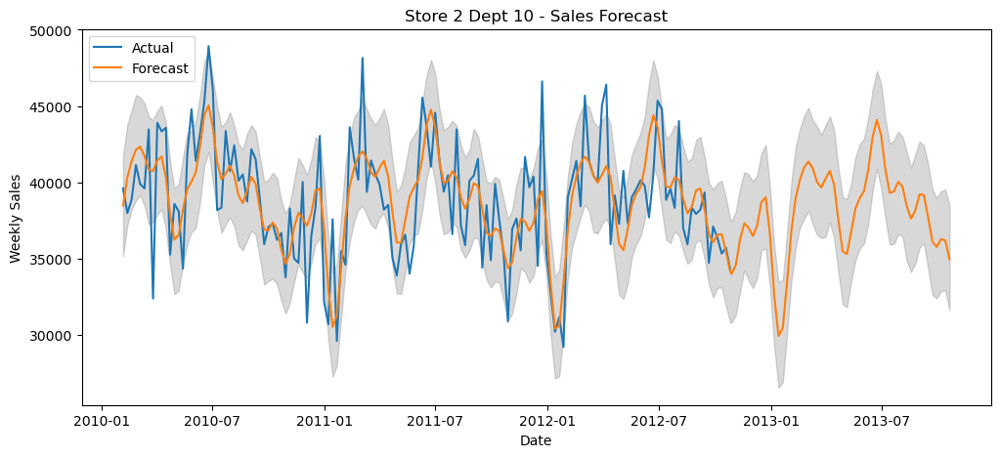

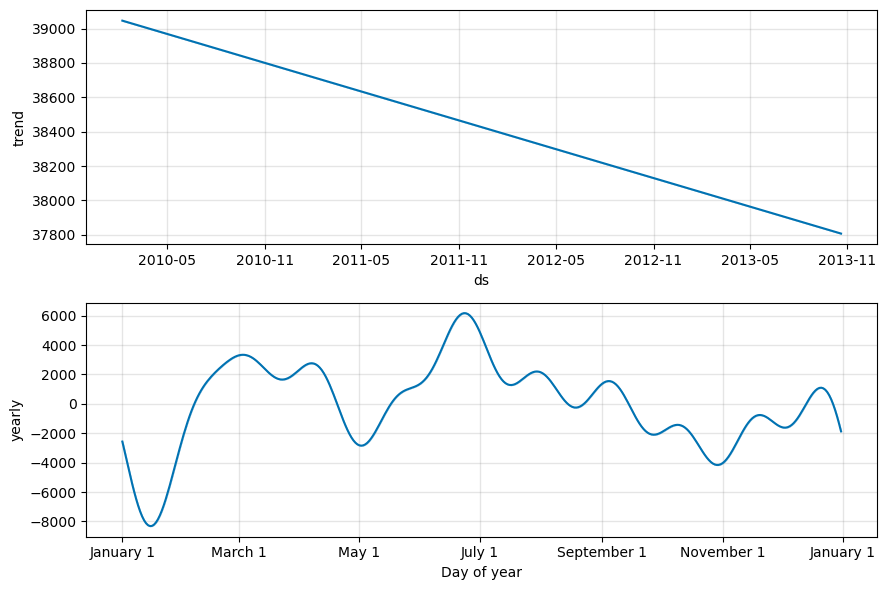


Forecasting for Store 2, Department 11


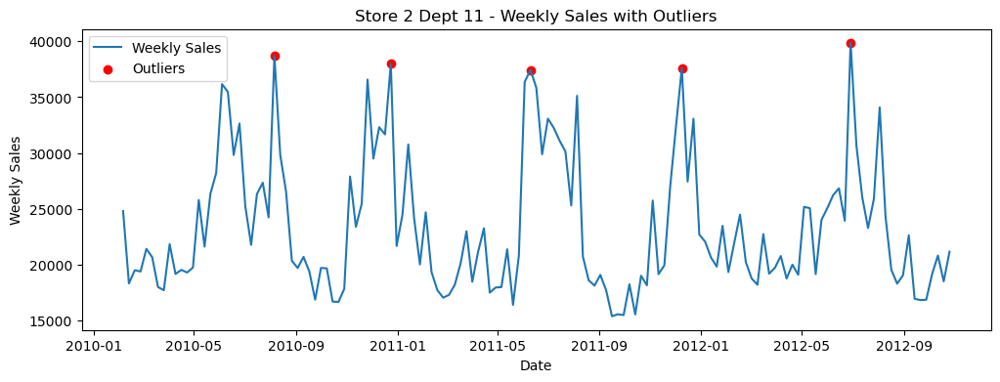

12:13:57 - cmdstanpy - INFO - Chain [1] start processing
12:13:57 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 11 - MAE: 2707.25, RMSE: 3412.89


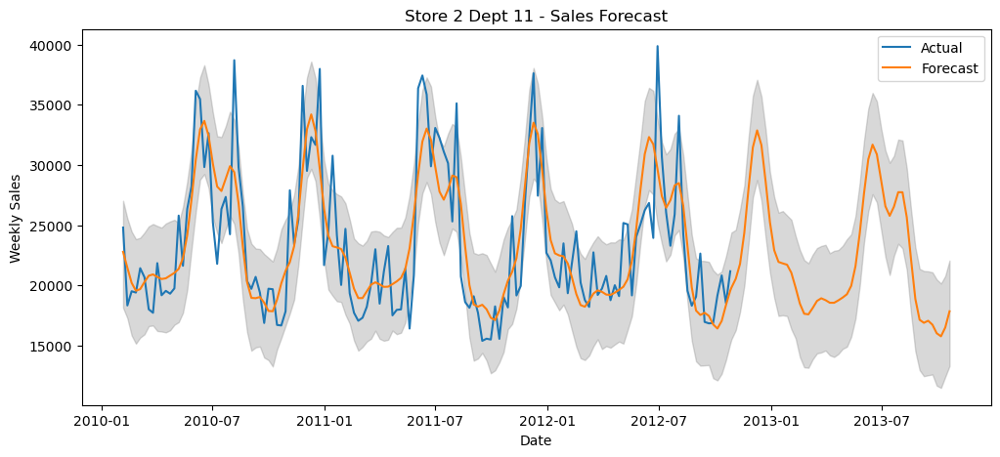

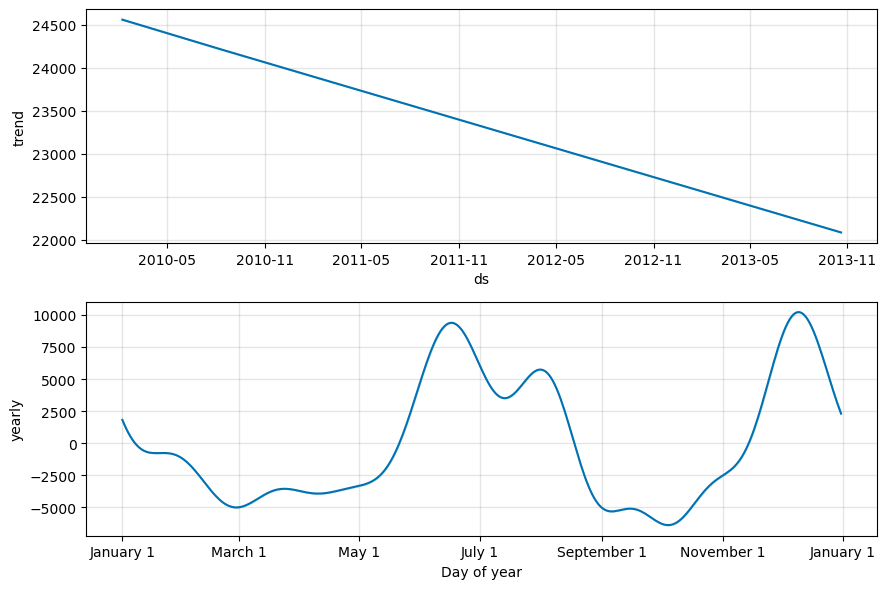


Forecasting for Store 2, Department 12


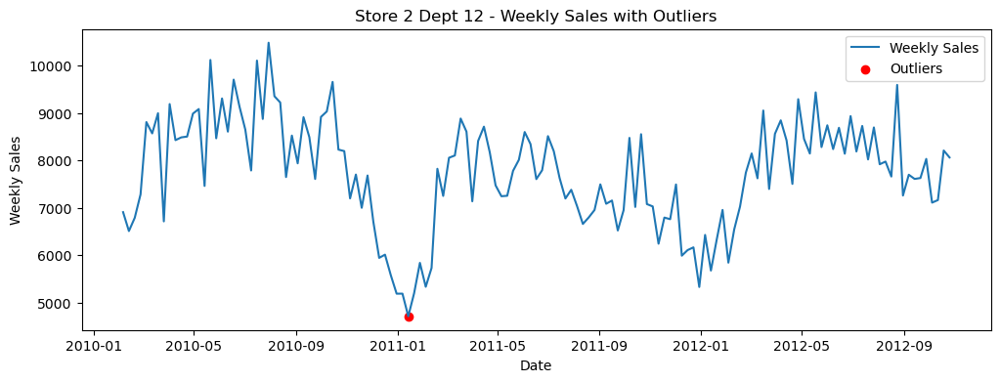

12:13:59 - cmdstanpy - INFO - Chain [1] start processing
12:13:59 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 12 - MAE: 512.76, RMSE: 633.21


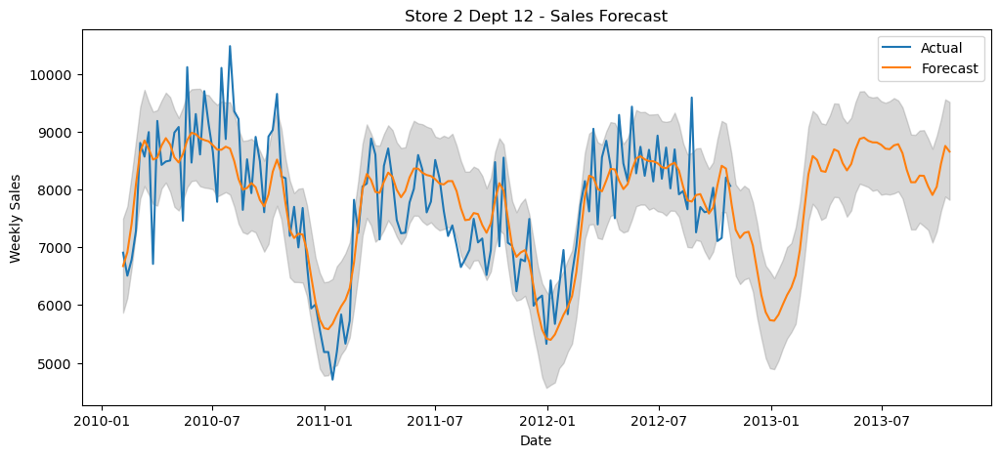

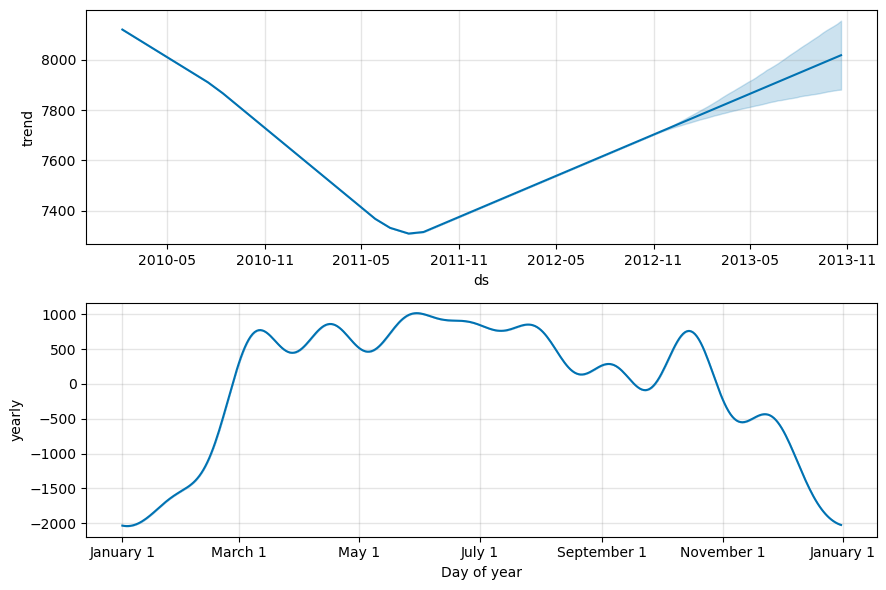


Forecasting for Store 2, Department 13


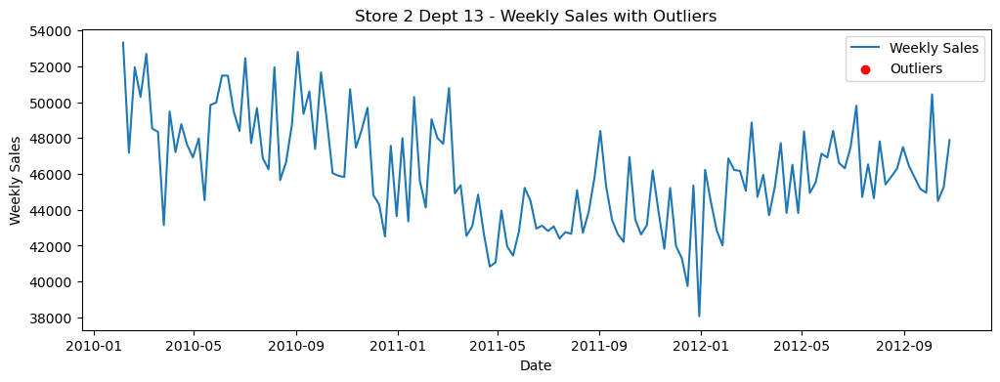

12:14:01 - cmdstanpy - INFO - Chain [1] start processing
12:14:01 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 13 - MAE: 1543.18, RMSE: 1913.43


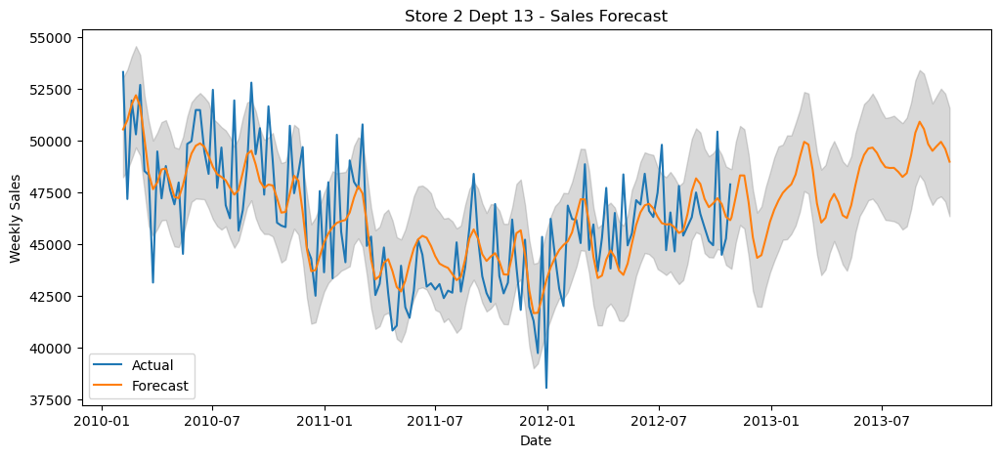

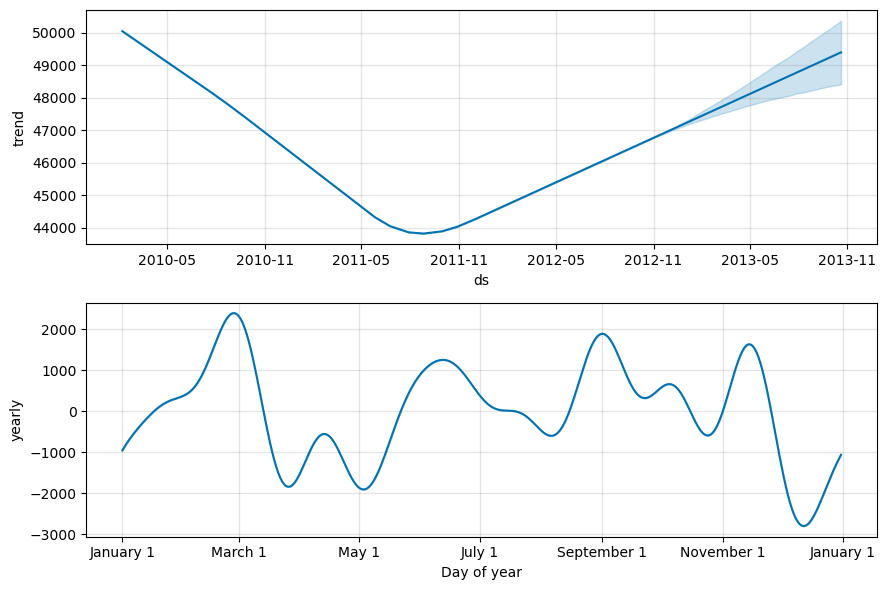


Forecasting for Store 2, Department 14


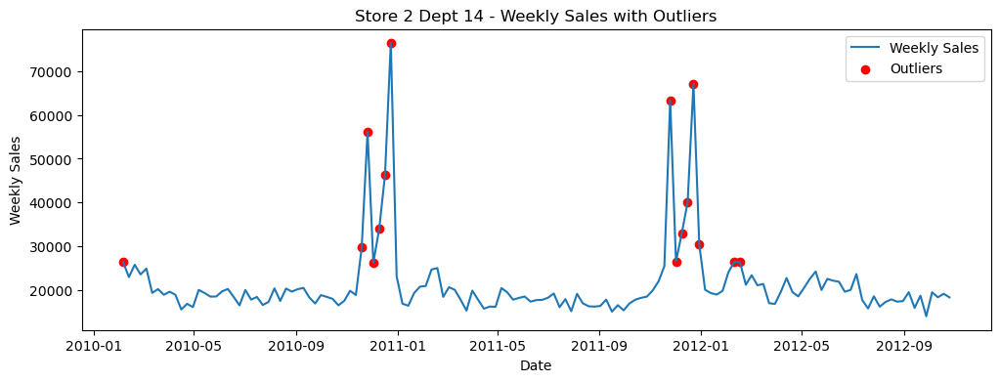

12:14:03 - cmdstanpy - INFO - Chain [1] start processing
12:14:03 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 14 - MAE: 2998.09, RMSE: 5269.92


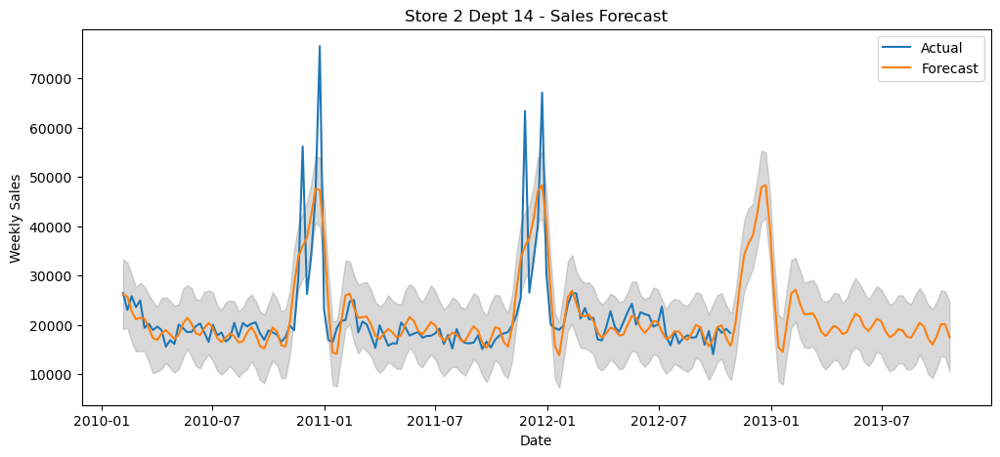

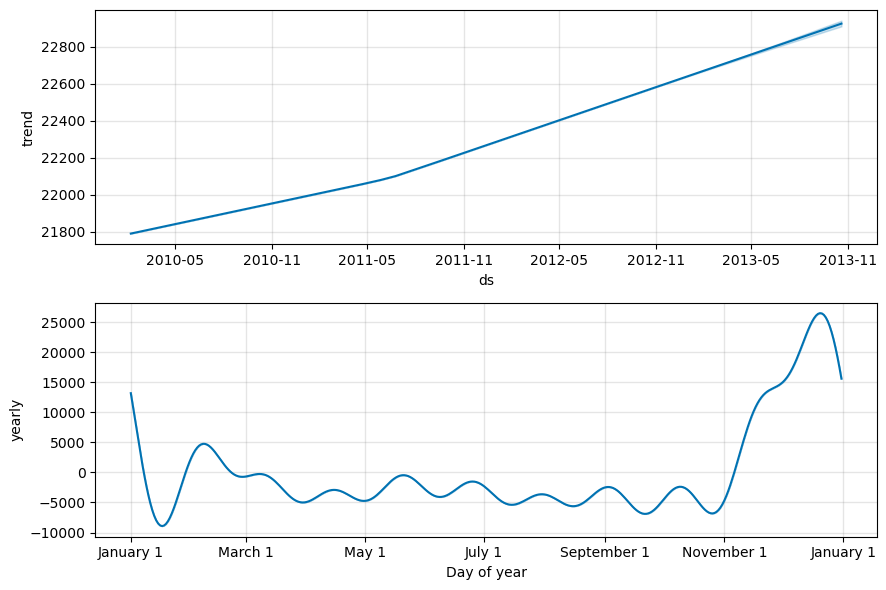


Forecasting for Store 2, Department 16


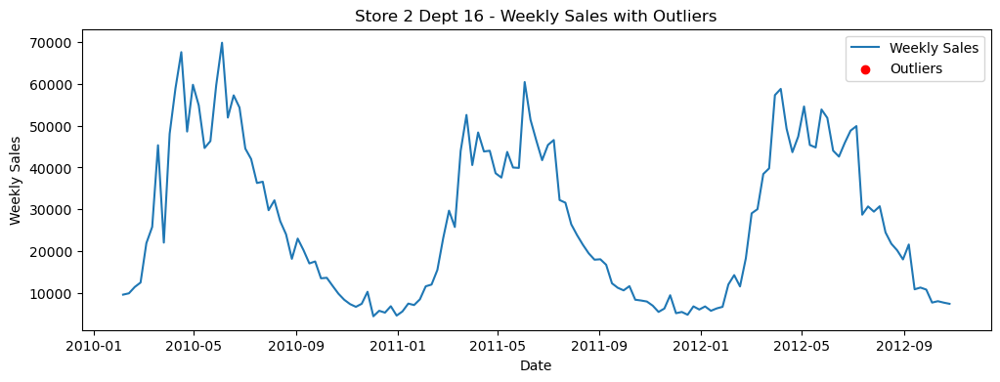

12:14:05 - cmdstanpy - INFO - Chain [1] start processing
12:14:05 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 16 - MAE: 3340.09, RMSE: 4913.61


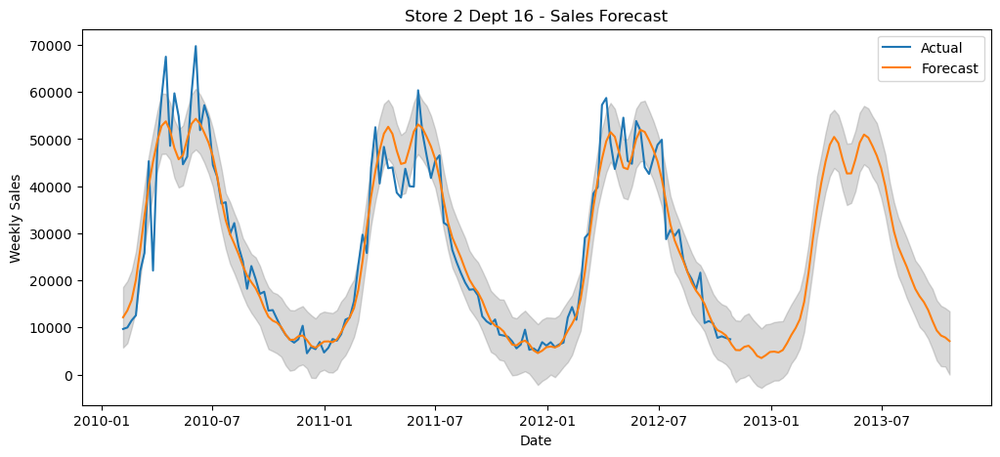

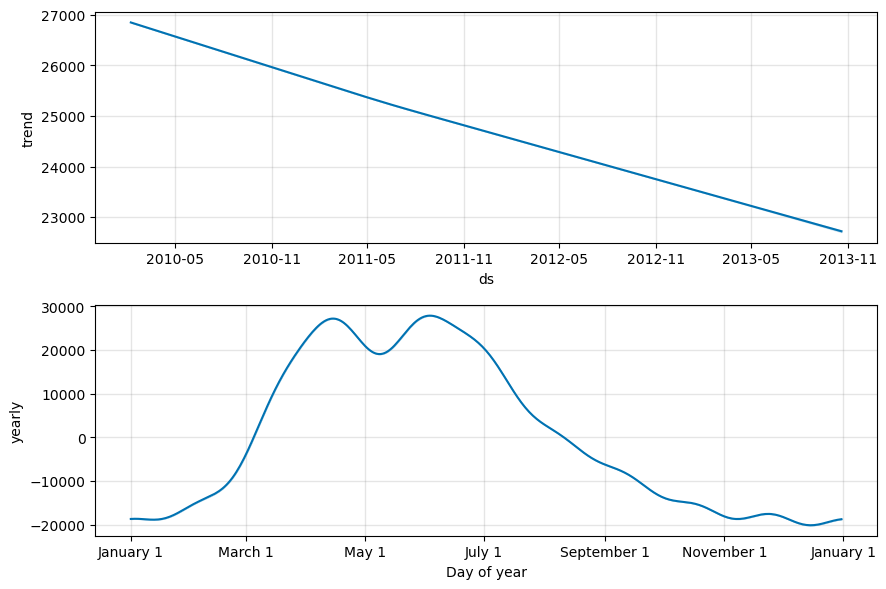


Forecasting for Store 2, Department 17


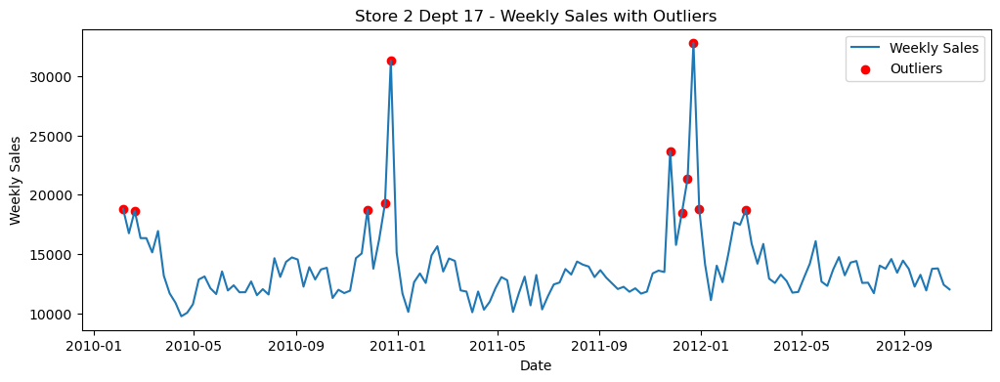

12:14:07 - cmdstanpy - INFO - Chain [1] start processing
12:14:07 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 17 - MAE: 1159.40, RMSE: 1755.67


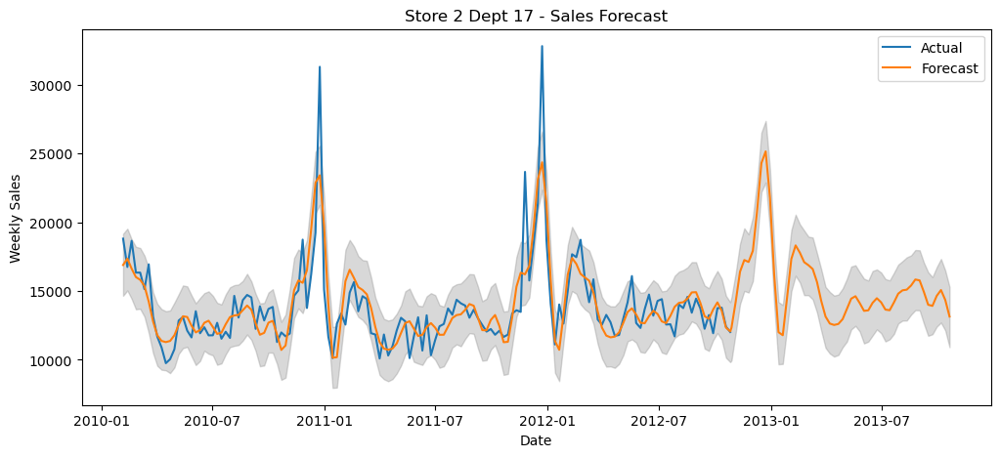

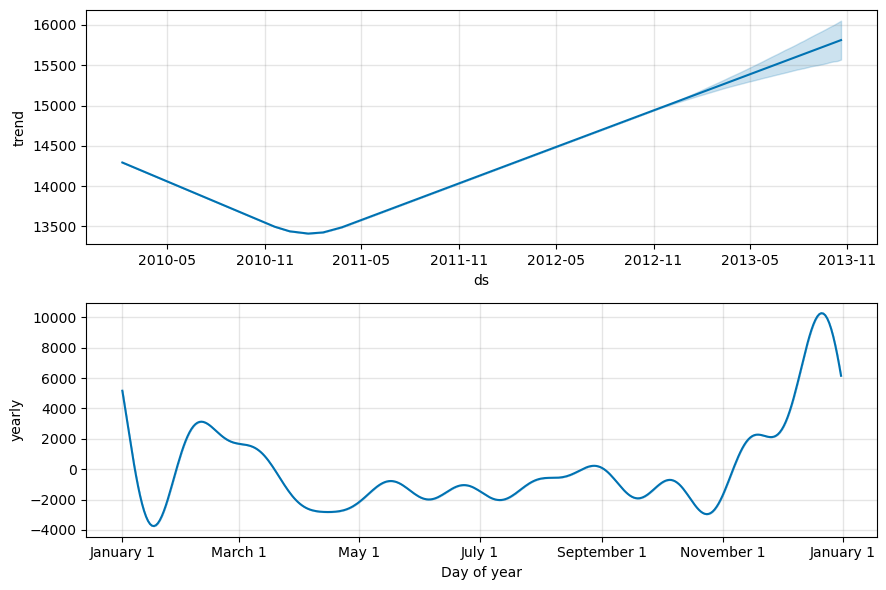


Forecasting for Store 2, Department 18


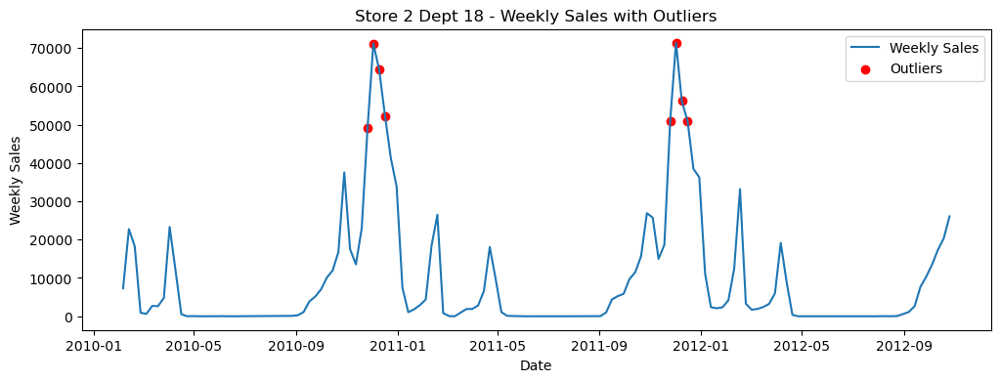

12:14:08 - cmdstanpy - INFO - Chain [1] start processing
12:14:08 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 18 - MAE: 3622.12, RMSE: 4845.49


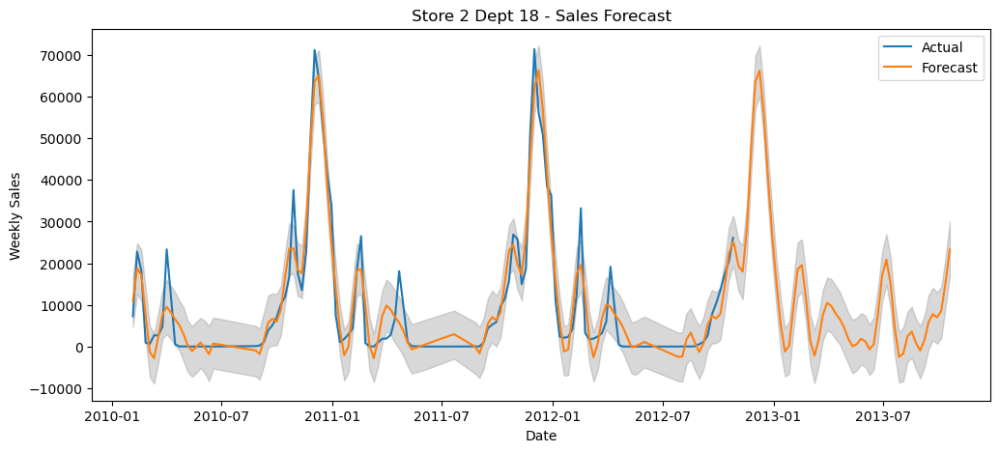

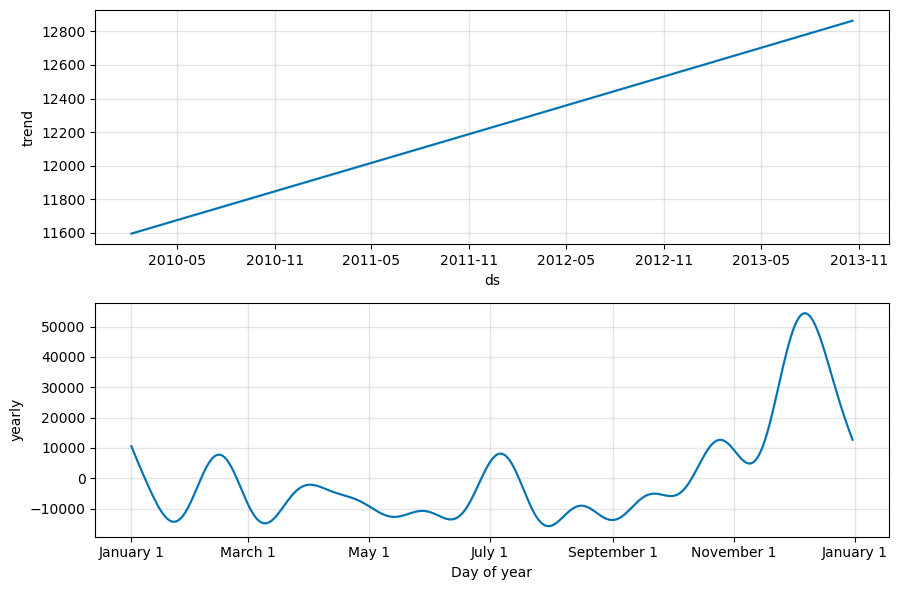


Forecasting for Store 2, Department 19


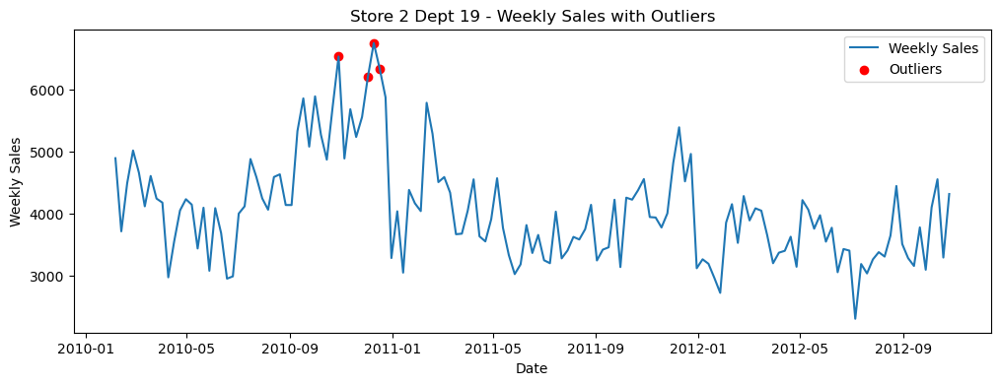

12:14:10 - cmdstanpy - INFO - Chain [1] start processing
12:14:11 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 19 - MAE: 400.79, RMSE: 503.73


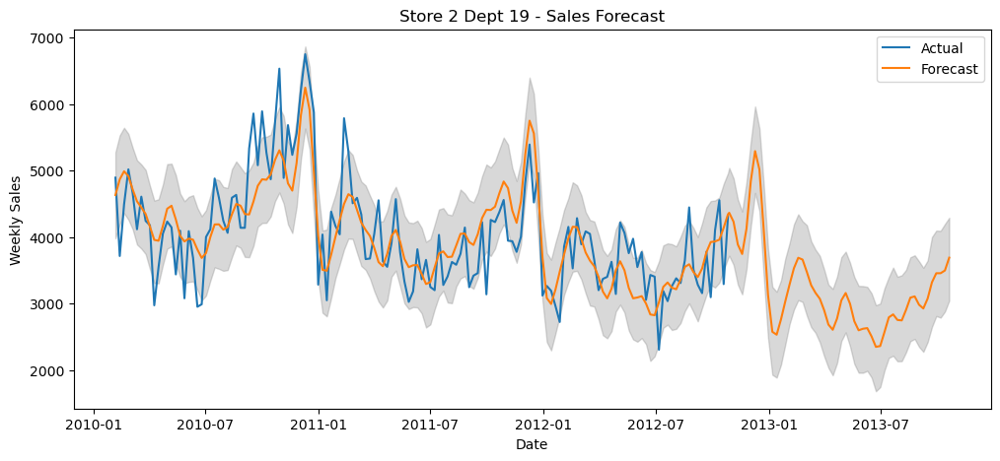

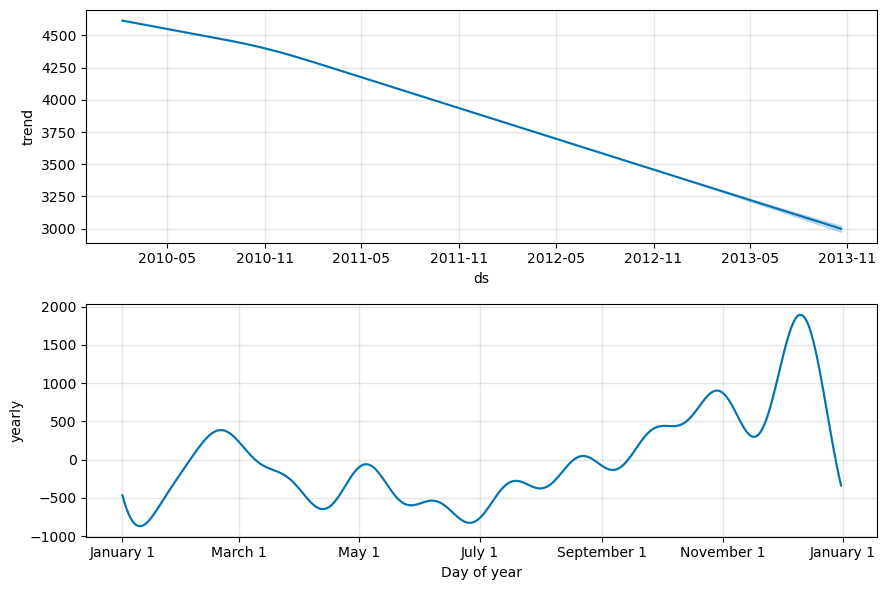


Forecasting for Store 2, Department 20


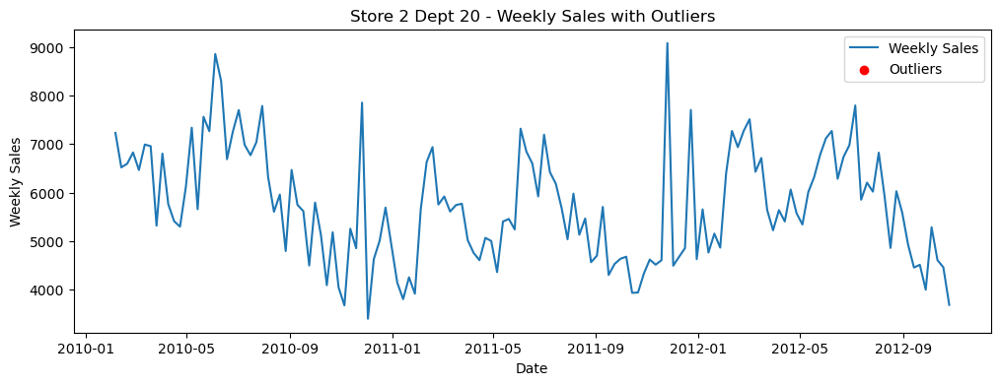

12:14:12 - cmdstanpy - INFO - Chain [1] start processing
12:14:12 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 20 - MAE: 499.70, RMSE: 682.63


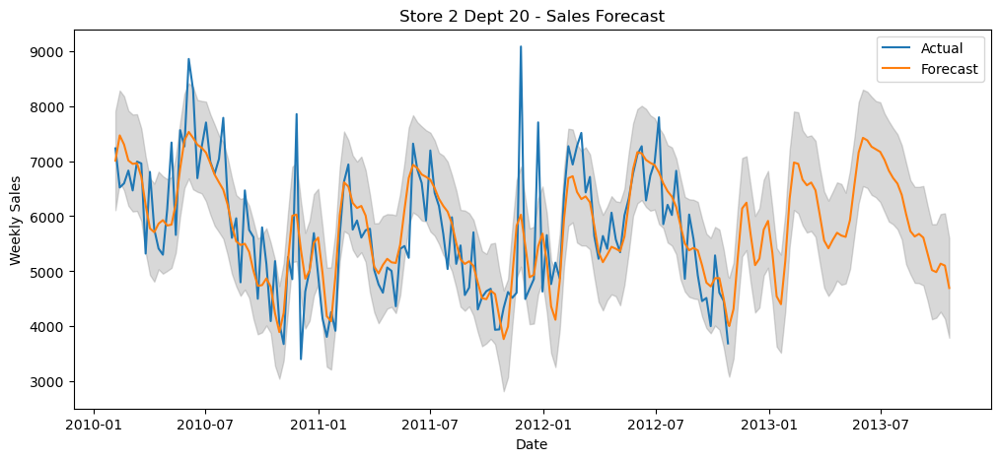

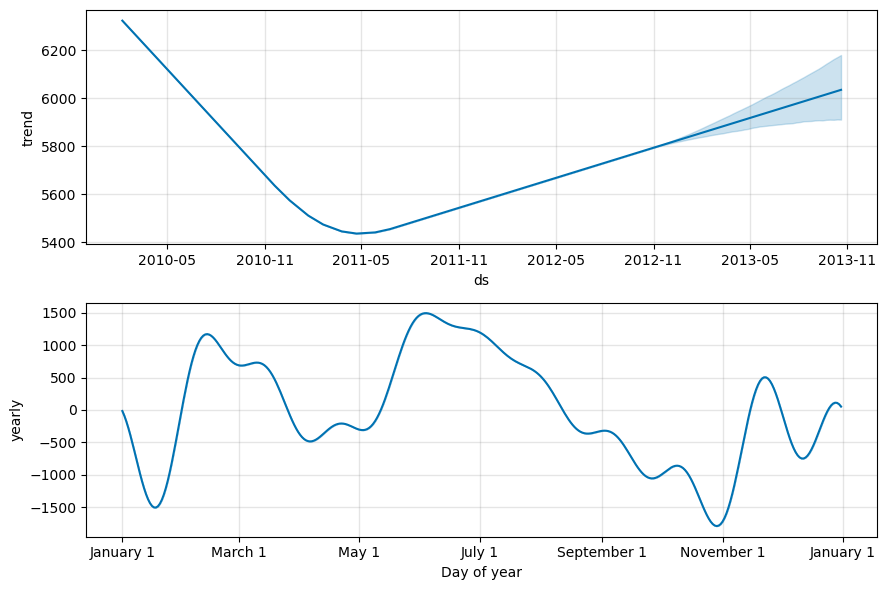


Forecasting for Store 2, Department 21


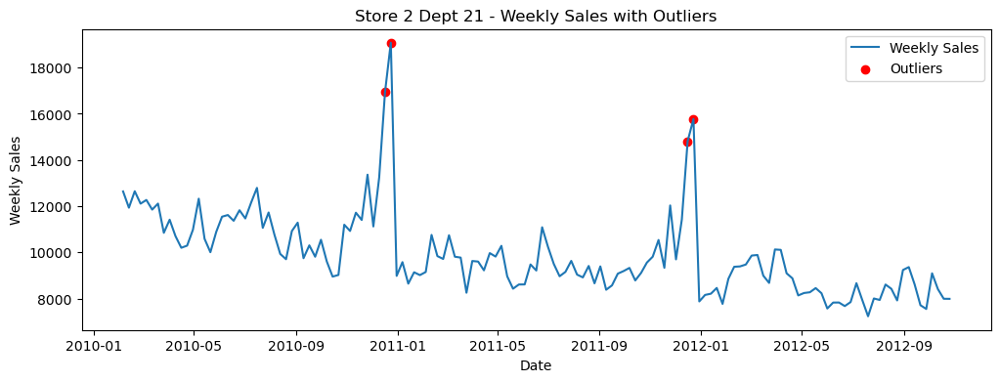

12:14:14 - cmdstanpy - INFO - Chain [1] start processing
12:14:14 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 21 - MAE: 626.38, RMSE: 887.32


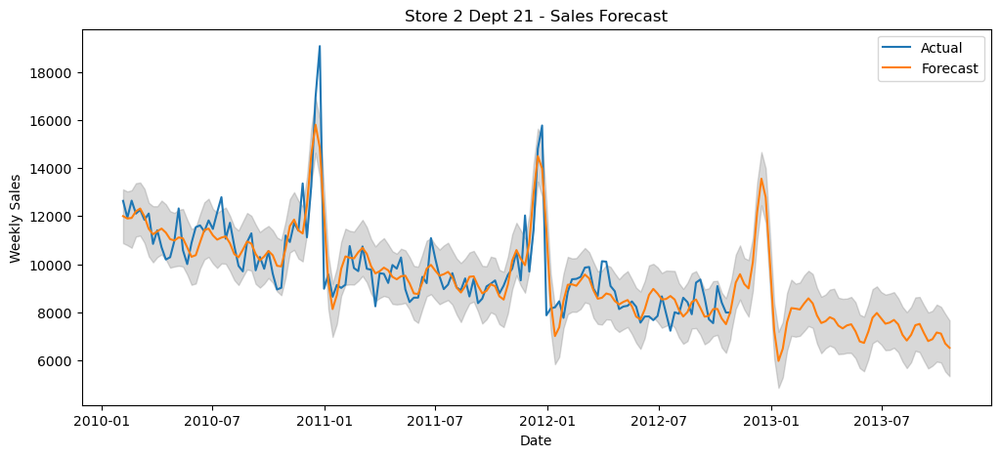

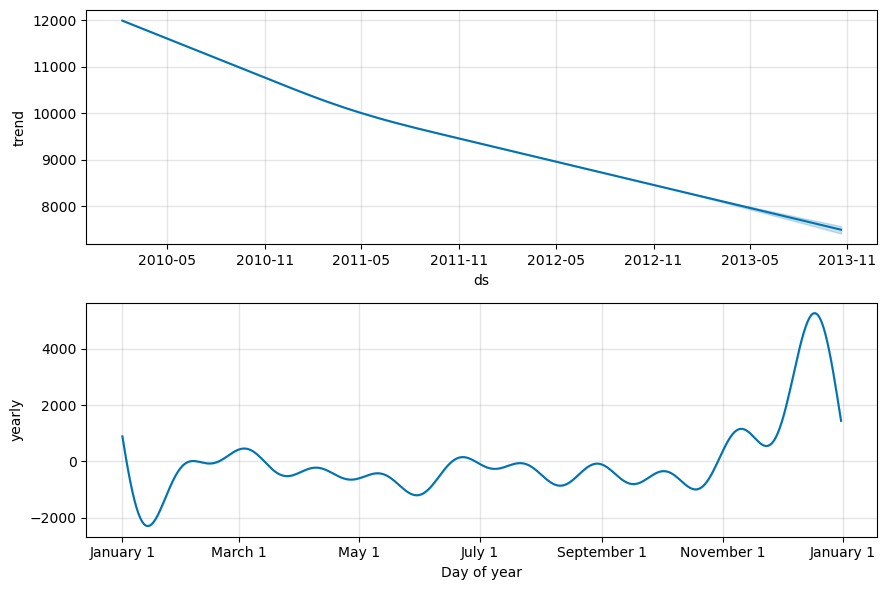


Forecasting for Store 2, Department 22


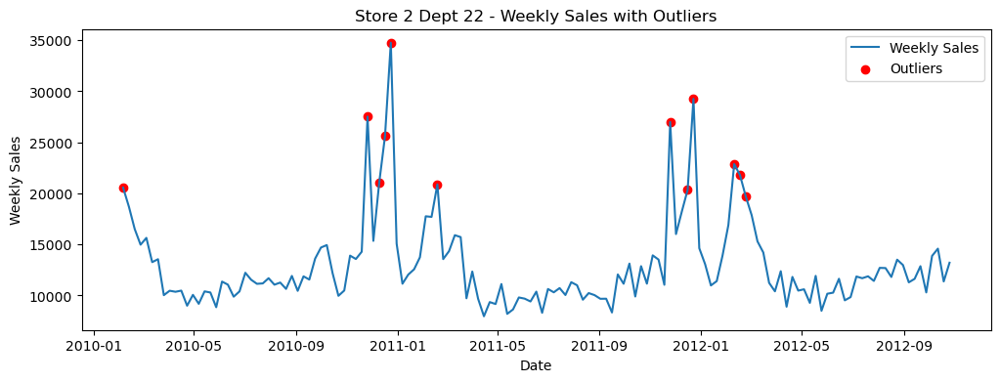

12:14:16 - cmdstanpy - INFO - Chain [1] start processing
12:14:16 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 22 - MAE: 1448.83, RMSE: 2186.08


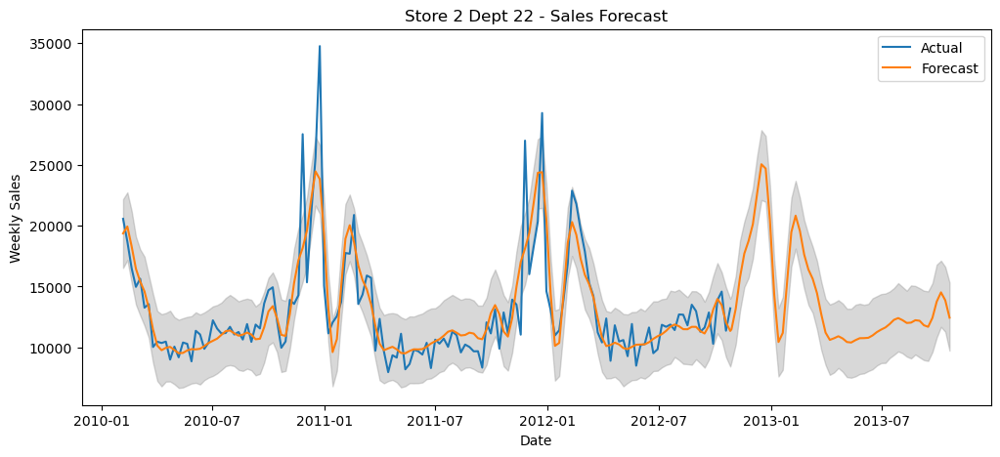

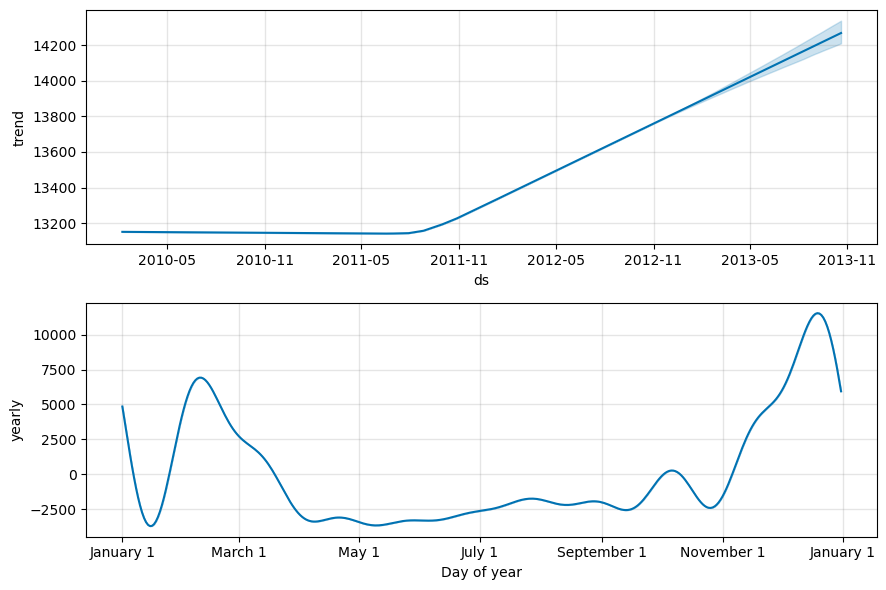


Forecasting for Store 2, Department 23


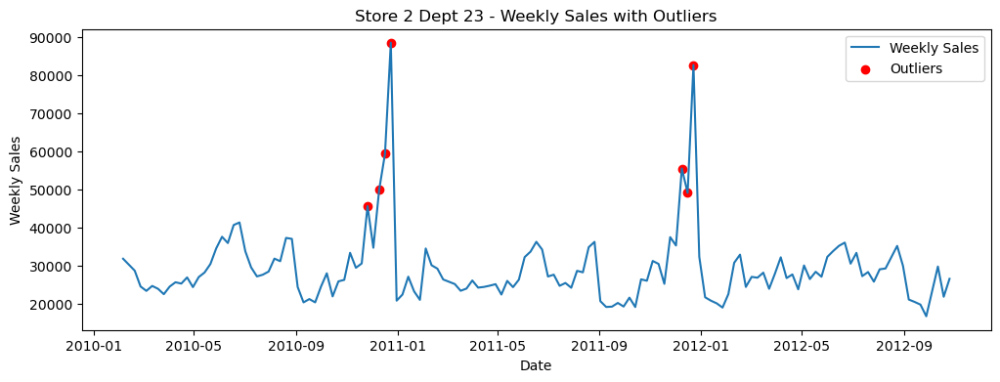

12:14:18 - cmdstanpy - INFO - Chain [1] start processing
12:14:18 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 23 - MAE: 2916.60, RMSE: 4952.39


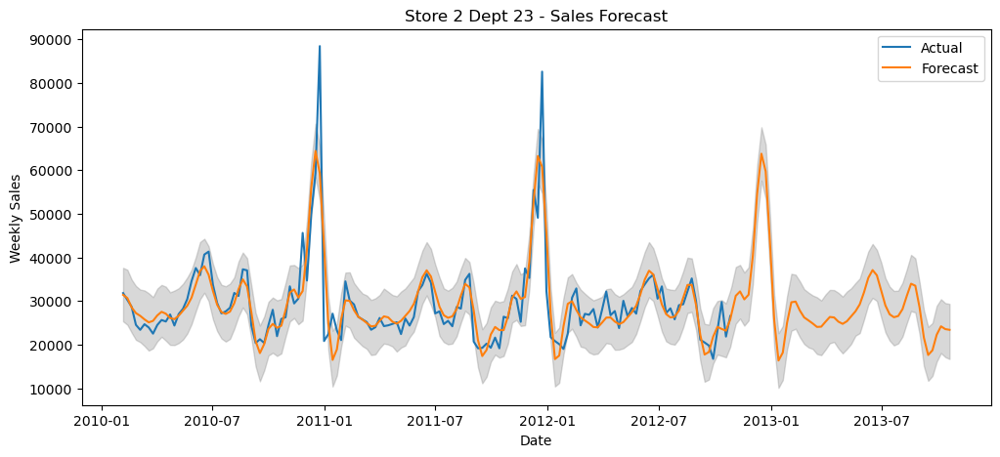

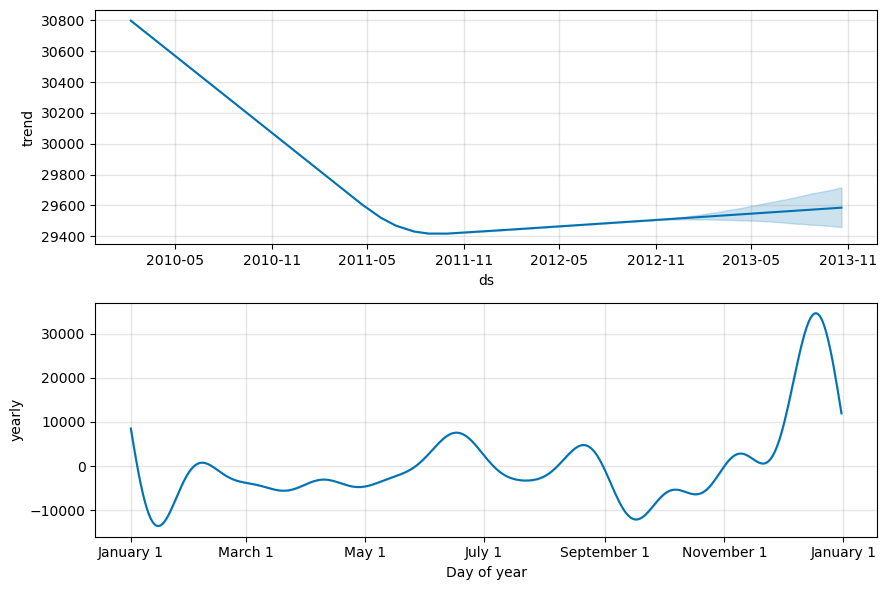


Forecasting for Store 2, Department 24


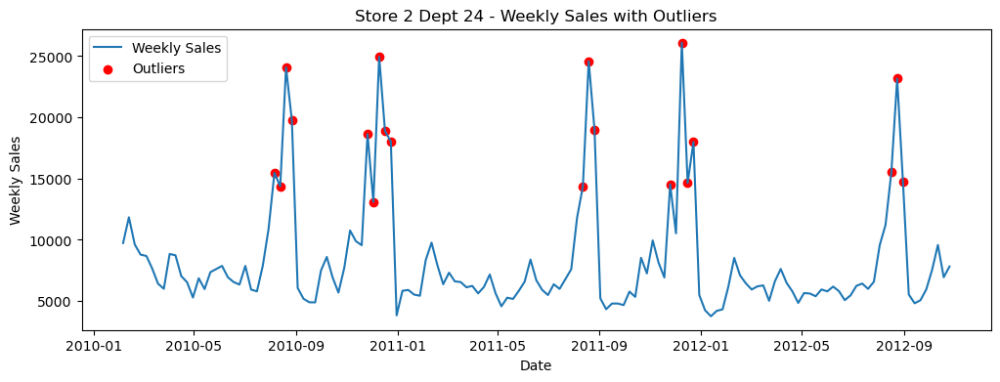

12:14:19 - cmdstanpy - INFO - Chain [1] start processing
12:14:19 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 24 - MAE: 1331.19, RMSE: 1937.75


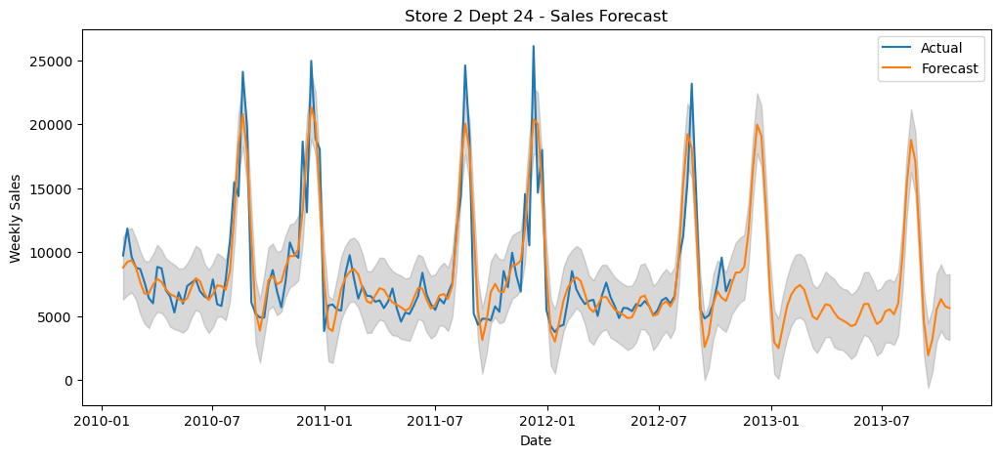

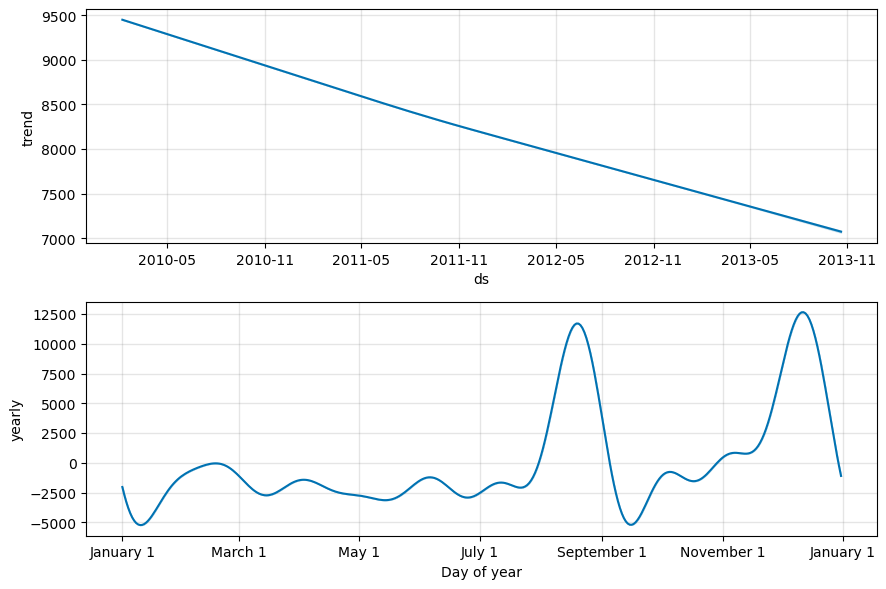


Forecasting for Store 2, Department 25


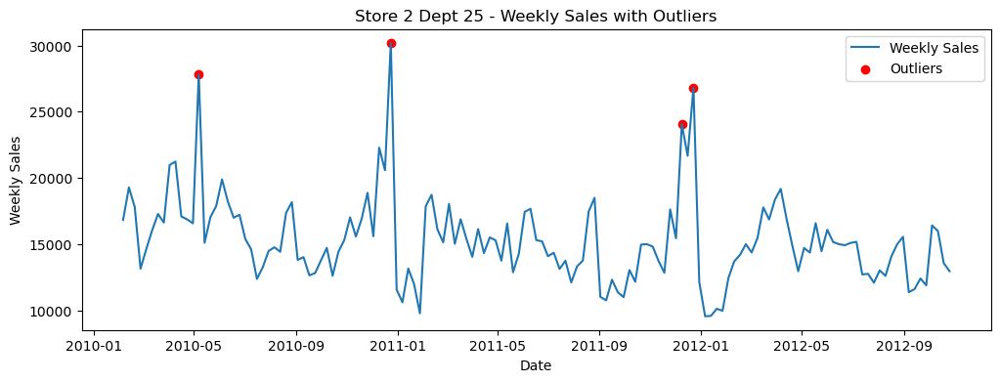

12:14:21 - cmdstanpy - INFO - Chain [1] start processing
12:14:21 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 25 - MAE: 1425.21, RMSE: 2015.62


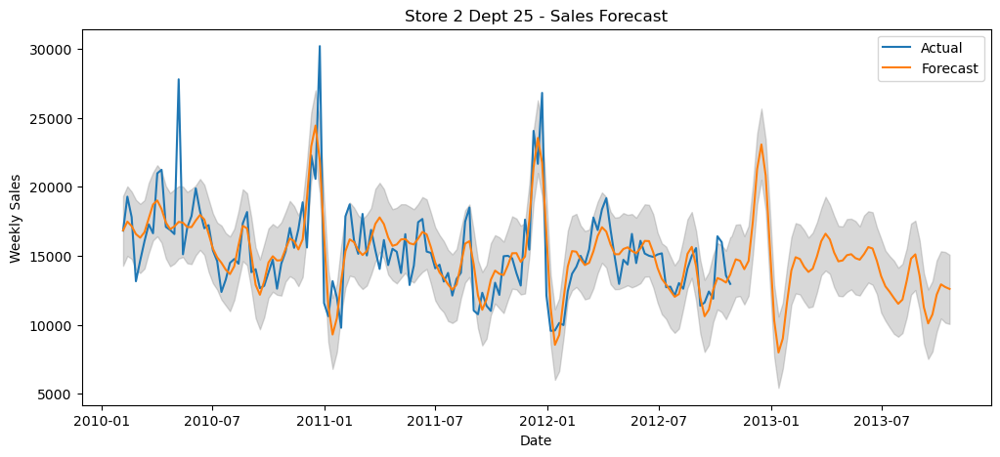

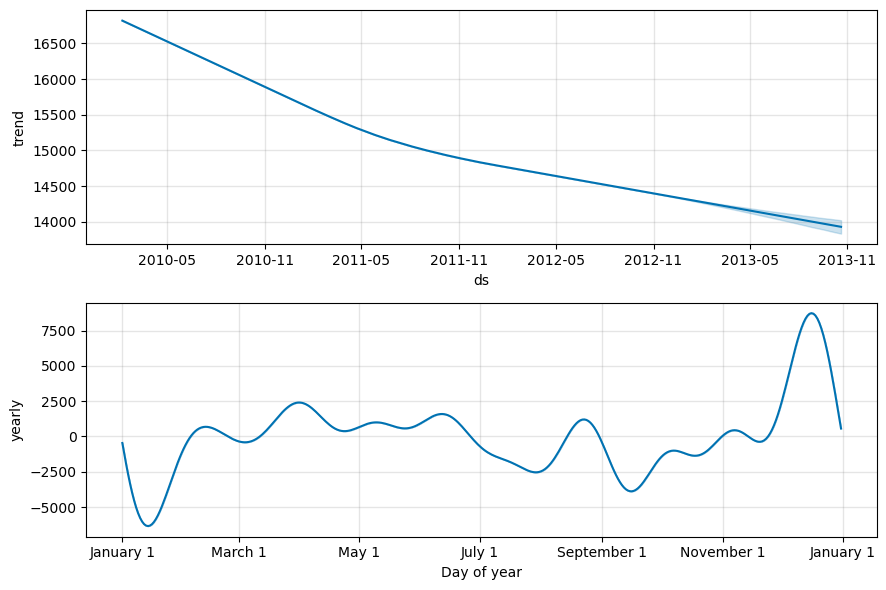


Forecasting for Store 2, Department 26


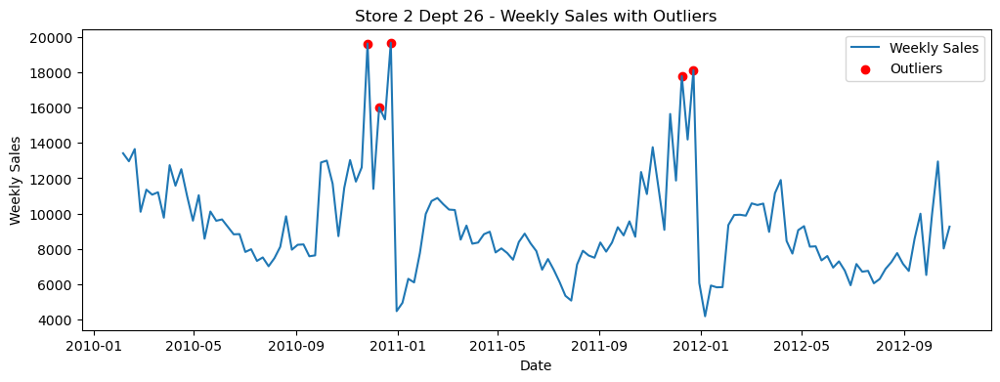

12:14:23 - cmdstanpy - INFO - Chain [1] start processing
12:14:23 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 26 - MAE: 1000.37, RMSE: 1461.73


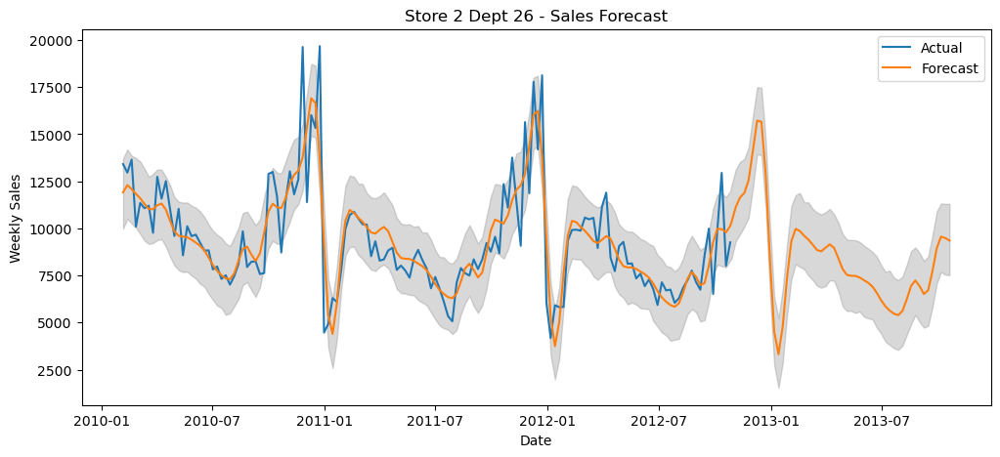

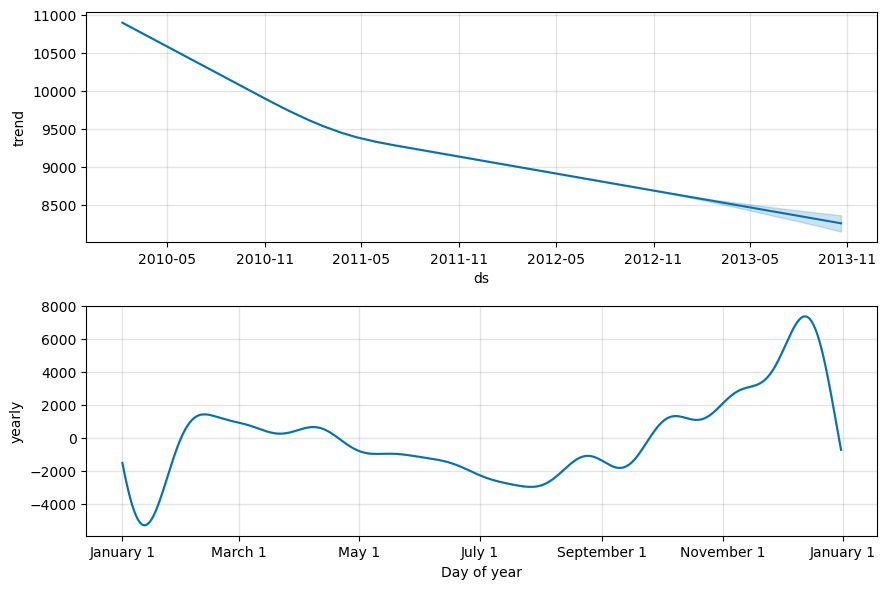


Forecasting for Store 2, Department 27


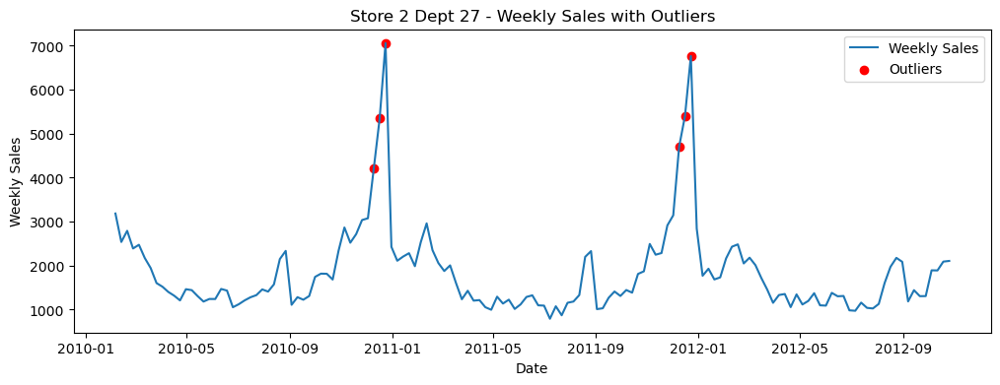

12:14:24 - cmdstanpy - INFO - Chain [1] start processing
12:14:24 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 27 - MAE: 194.05, RMSE: 322.51


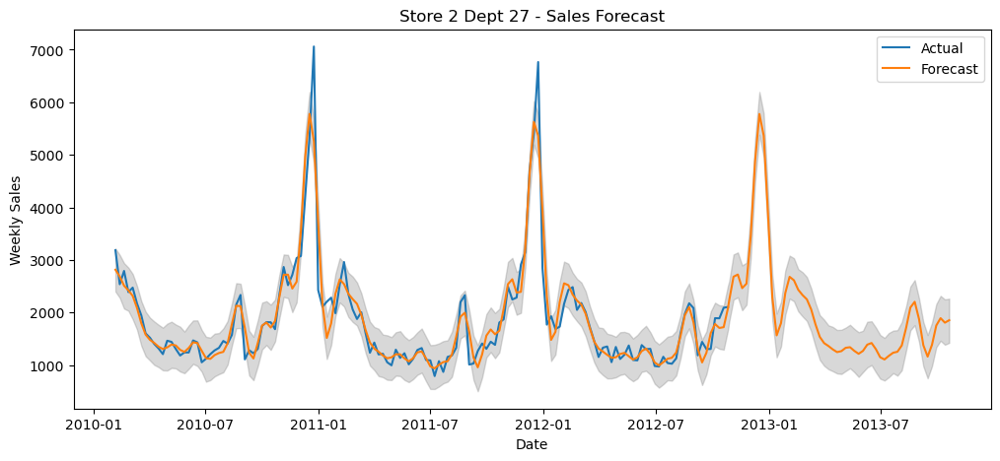

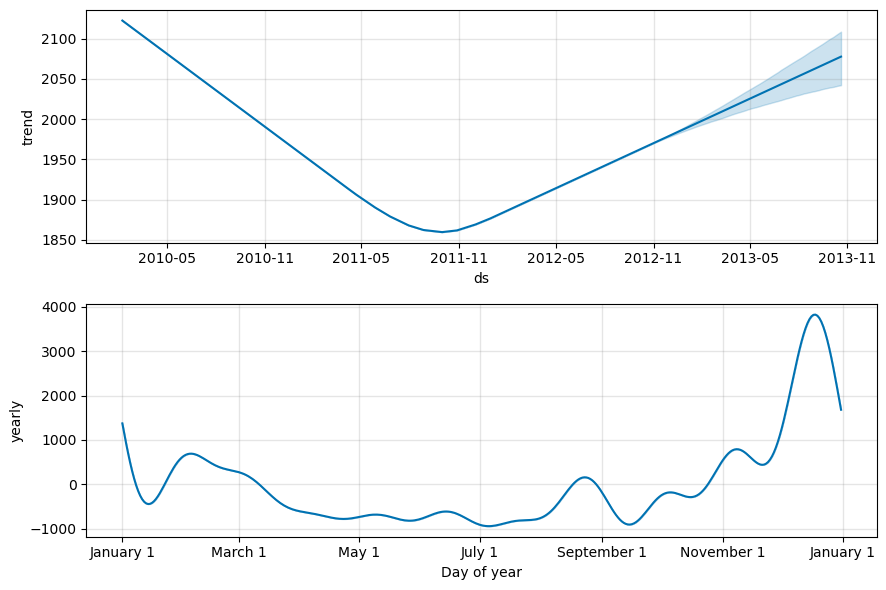


Forecasting for Store 2, Department 28


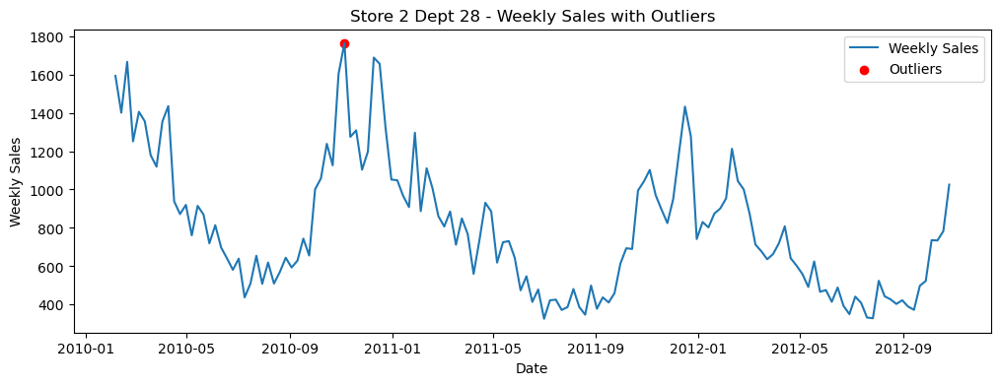

12:14:26 - cmdstanpy - INFO - Chain [1] start processing
12:14:26 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 28 - MAE: 85.37, RMSE: 110.52


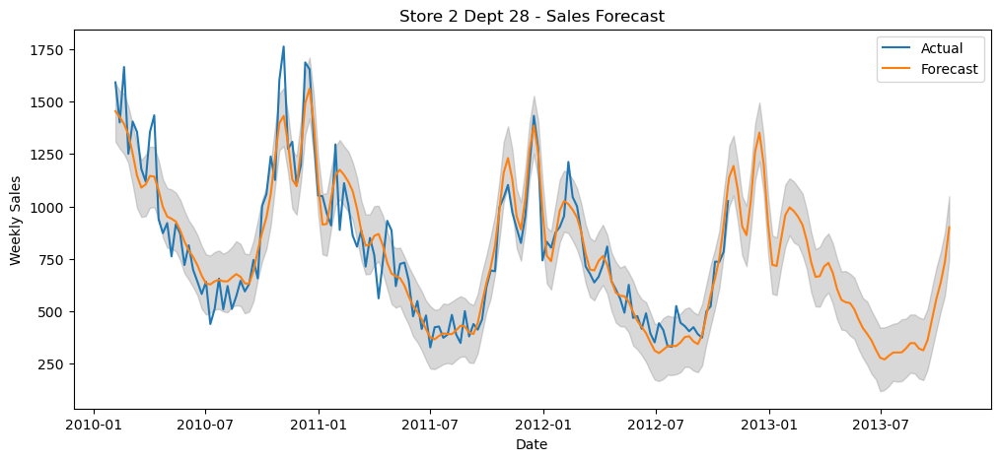

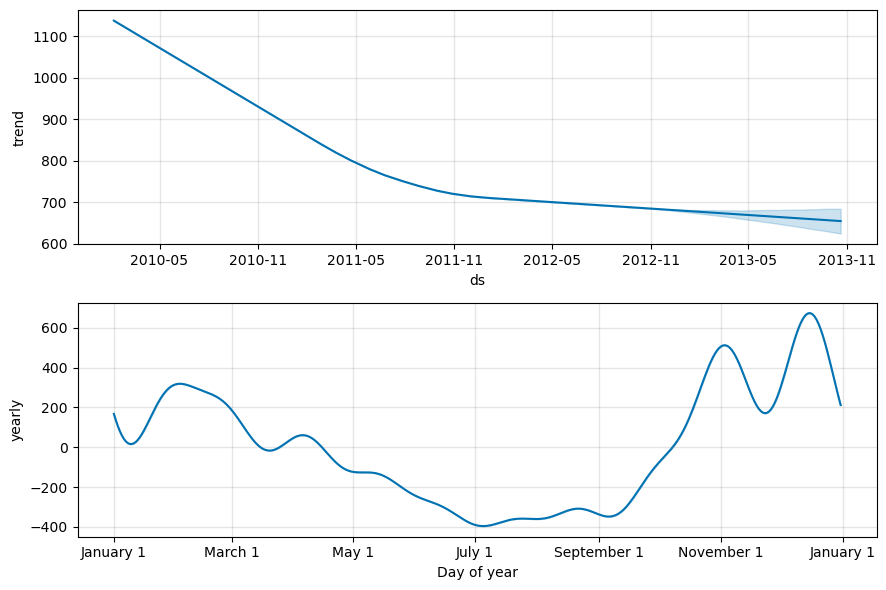


Forecasting for Store 2, Department 29


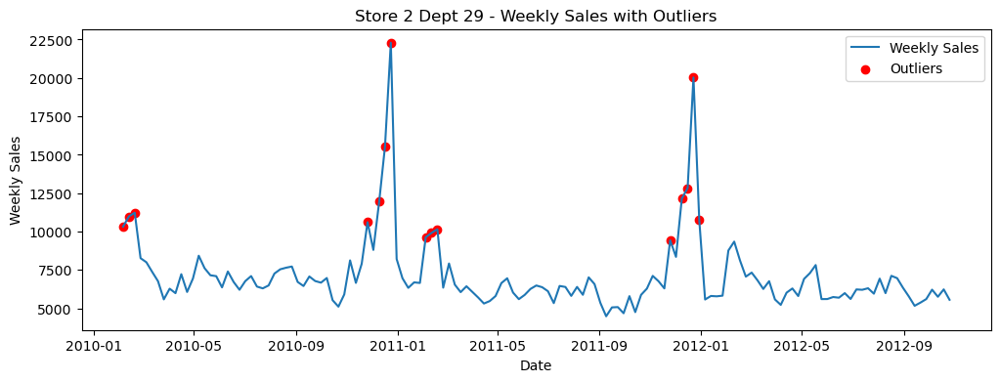

12:14:28 - cmdstanpy - INFO - Chain [1] start processing
12:14:28 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 29 - MAE: 633.23, RMSE: 1029.28


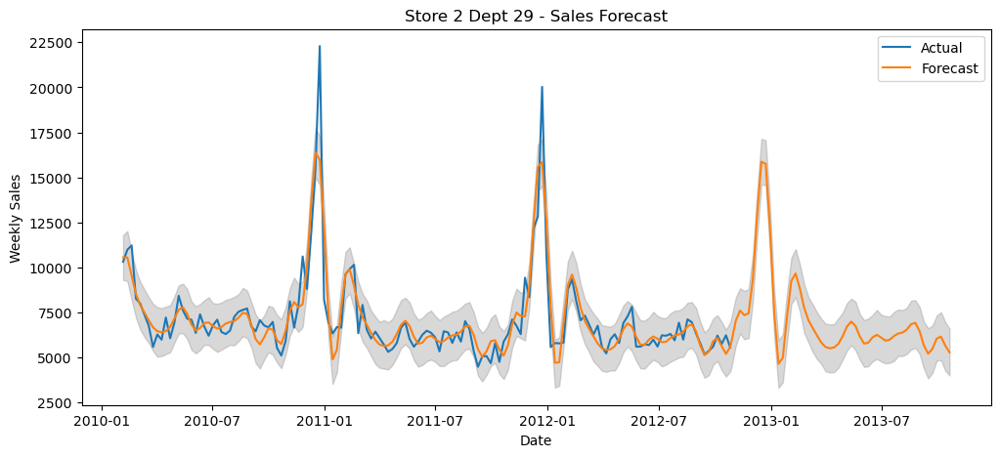

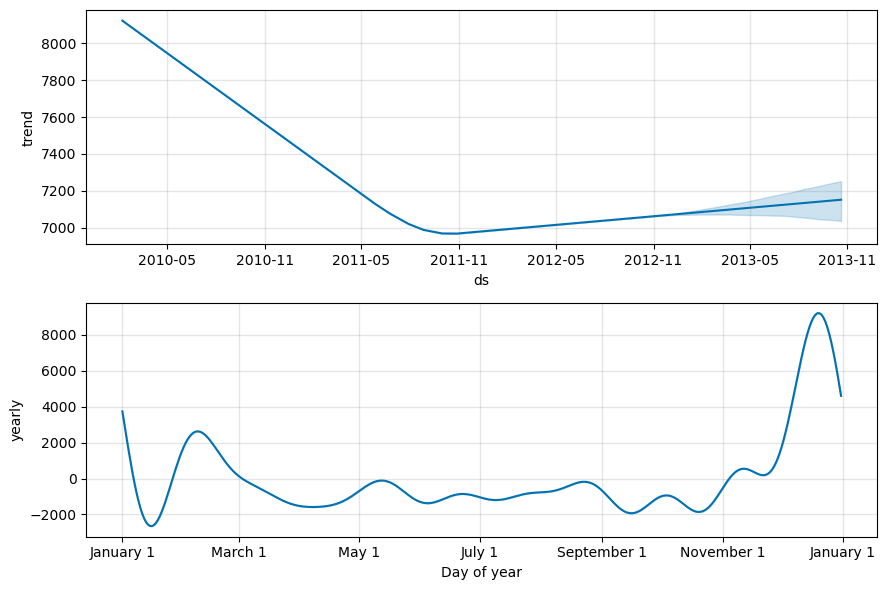


Forecasting for Store 2, Department 30


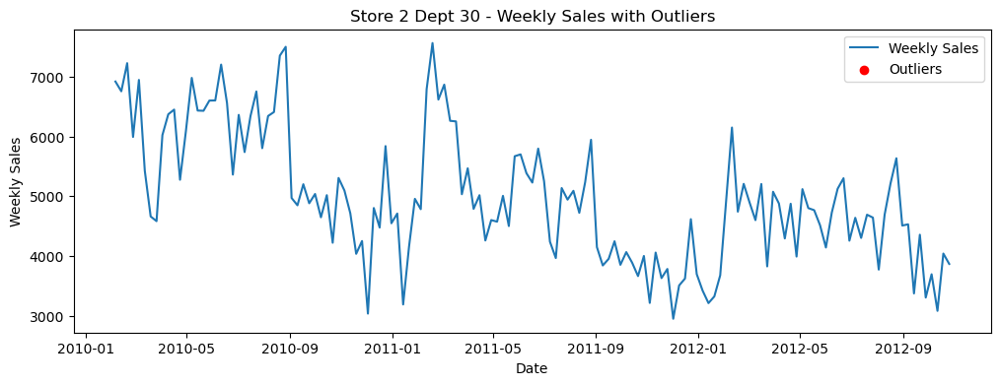

12:14:29 - cmdstanpy - INFO - Chain [1] start processing
12:14:30 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 30 - MAE: 412.57, RMSE: 517.77


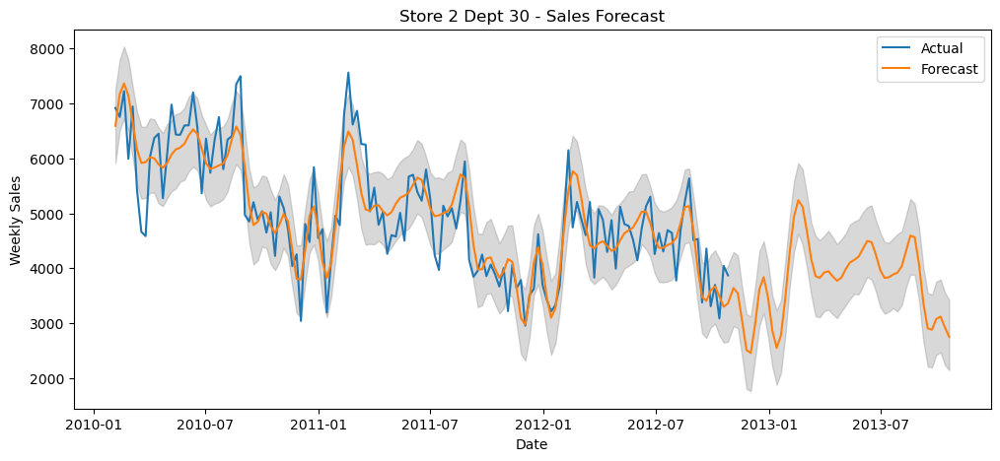

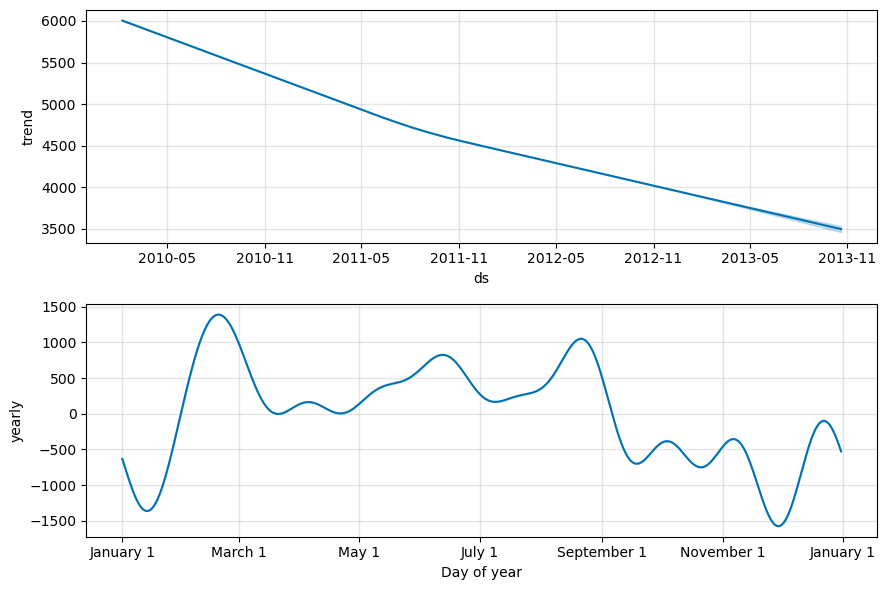


Forecasting for Store 2, Department 31


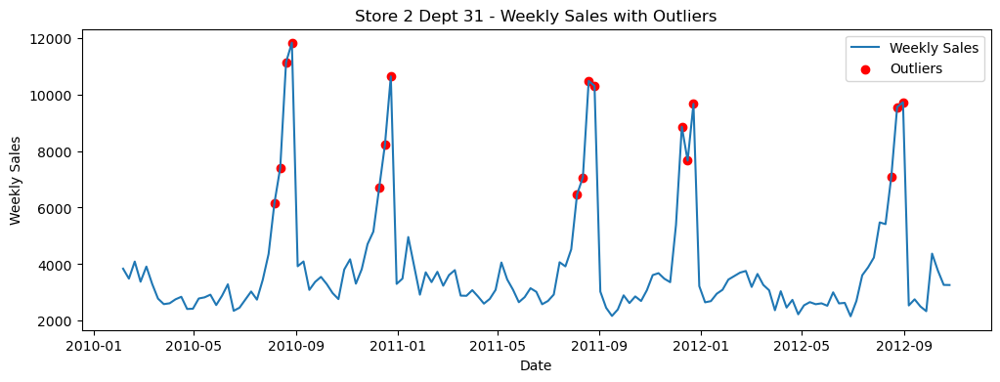

12:14:32 - cmdstanpy - INFO - Chain [1] start processing
12:14:32 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 31 - MAE: 537.31, RMSE: 832.15


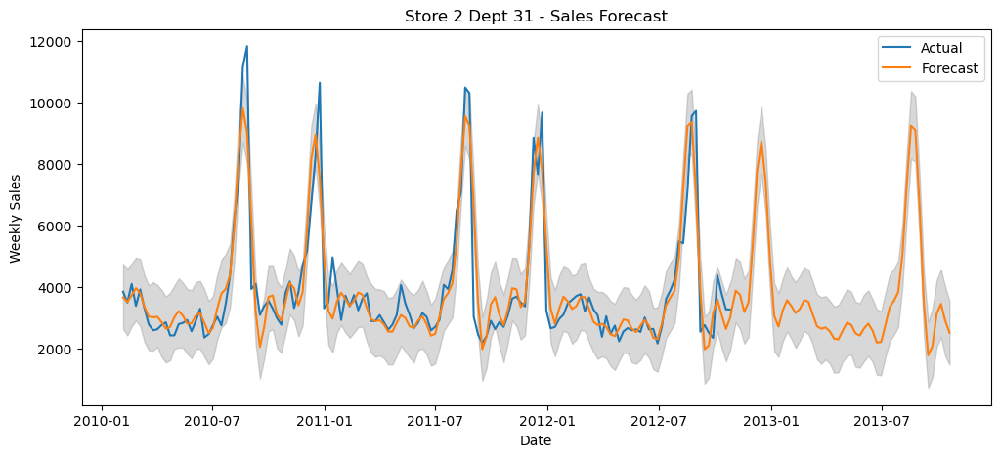

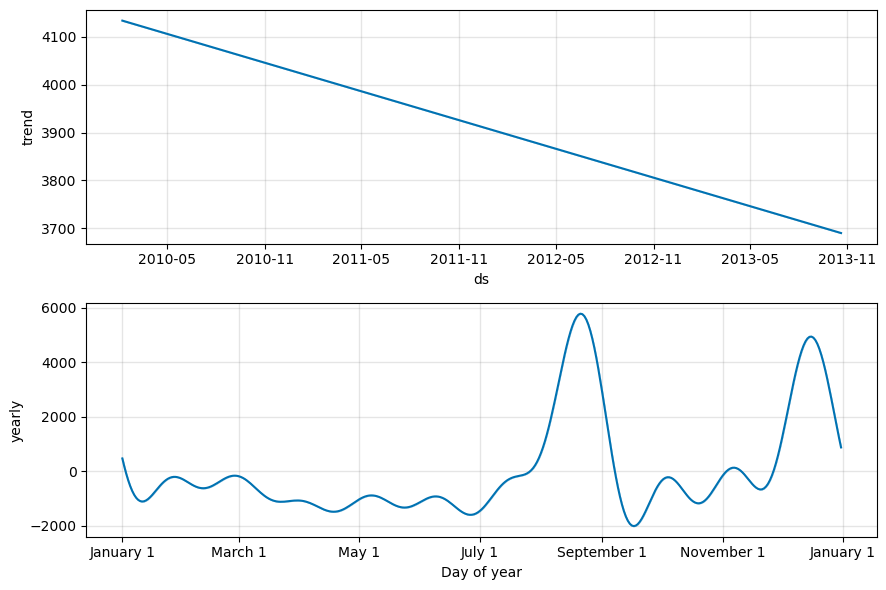


Forecasting for Store 2, Department 32


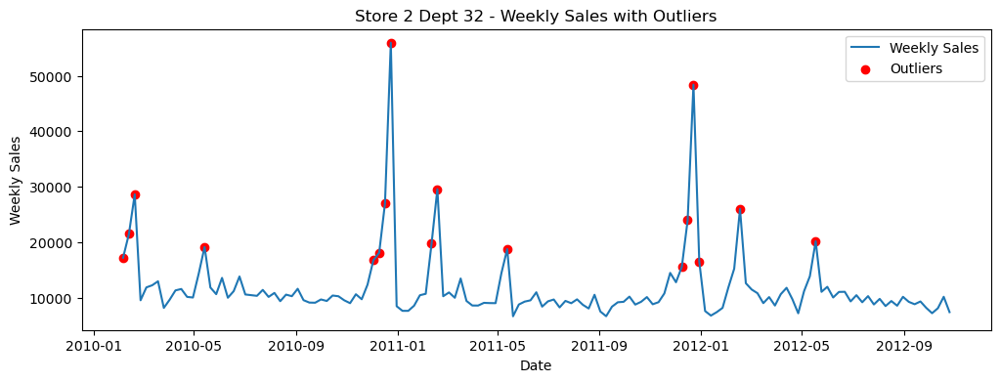

12:14:33 - cmdstanpy - INFO - Chain [1] start processing
12:14:33 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 32 - MAE: 2201.57, RMSE: 3849.76


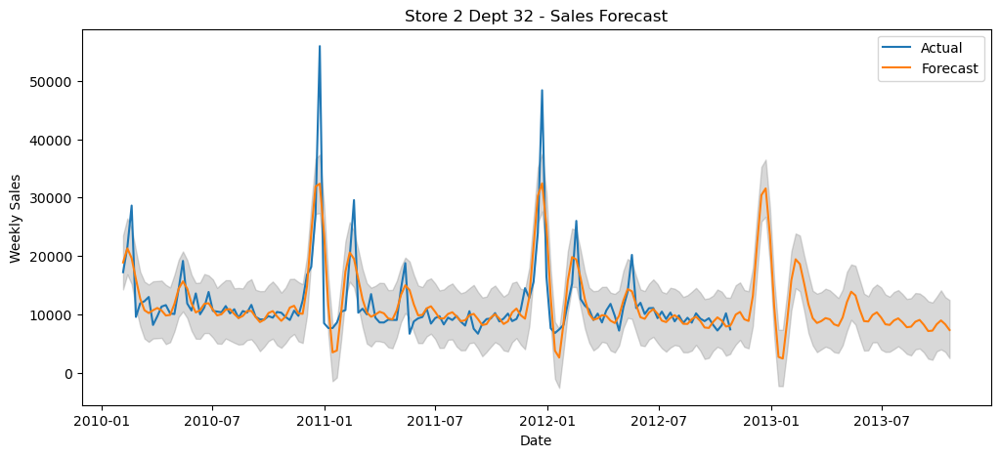

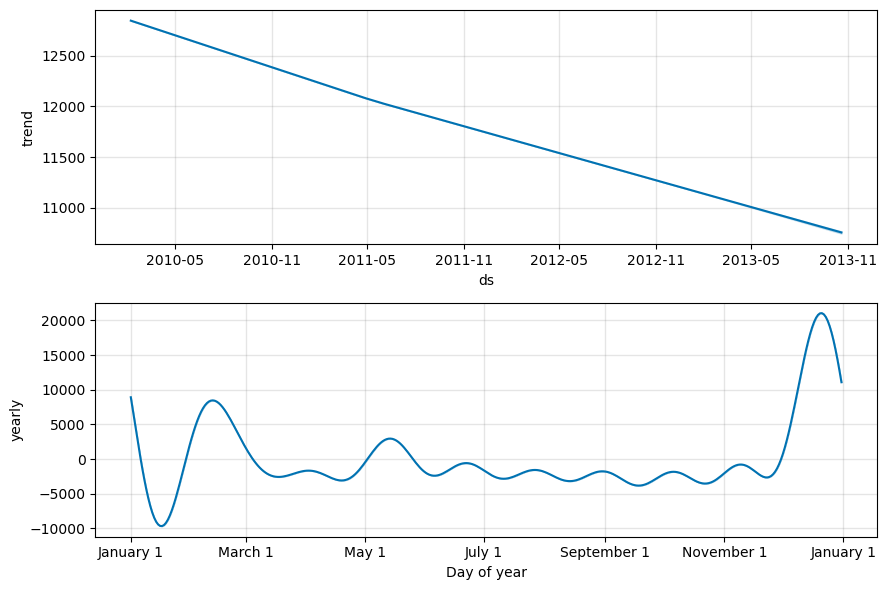


Forecasting for Store 2, Department 33


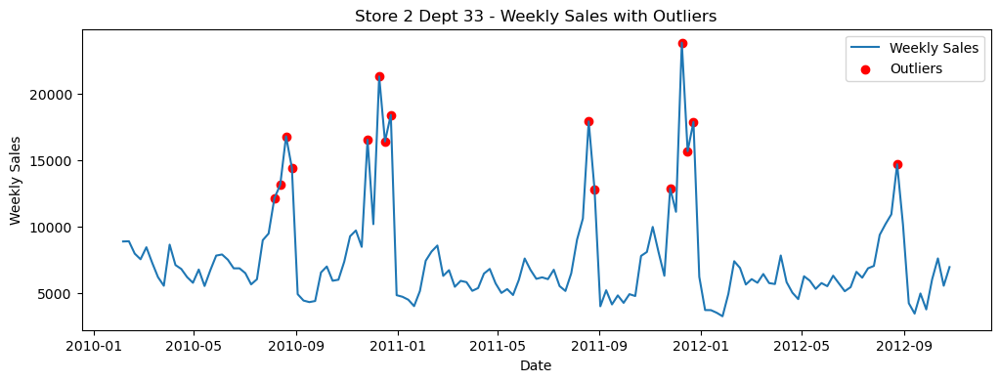

12:14:35 - cmdstanpy - INFO - Chain [1] start processing
12:14:35 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 33 - MAE: 1045.02, RMSE: 1507.51


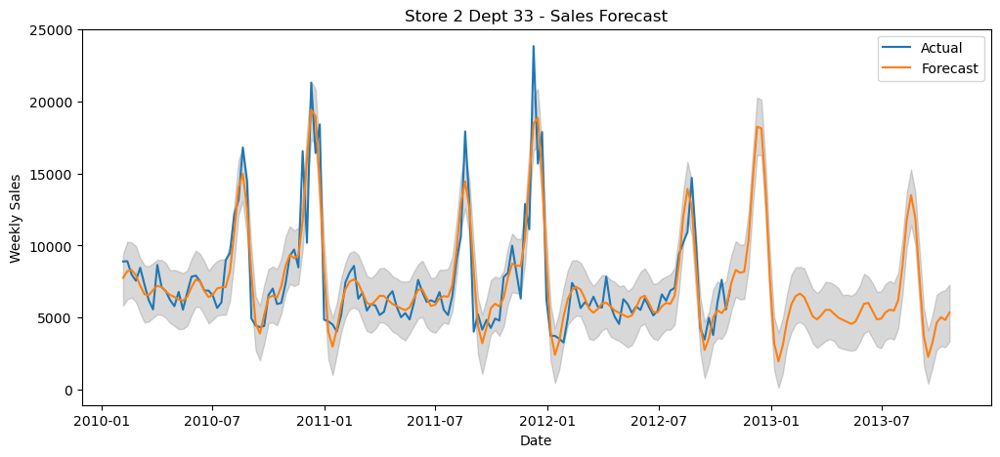

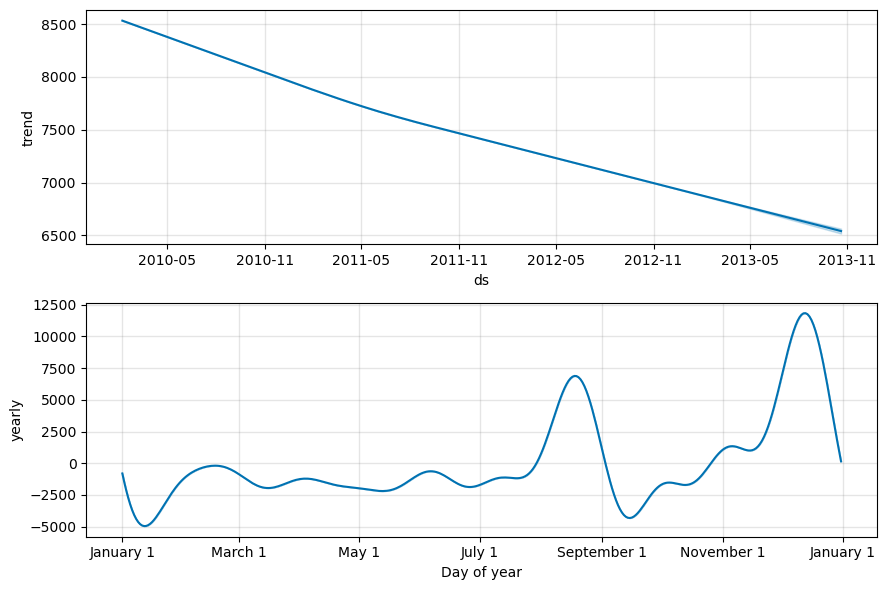


Forecasting for Store 2, Department 34


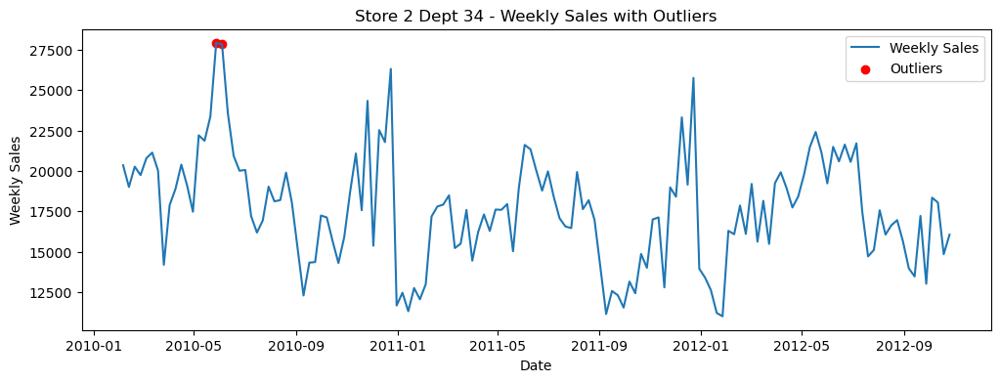

12:14:37 - cmdstanpy - INFO - Chain [1] start processing
12:14:37 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 34 - MAE: 1392.11, RMSE: 1876.40


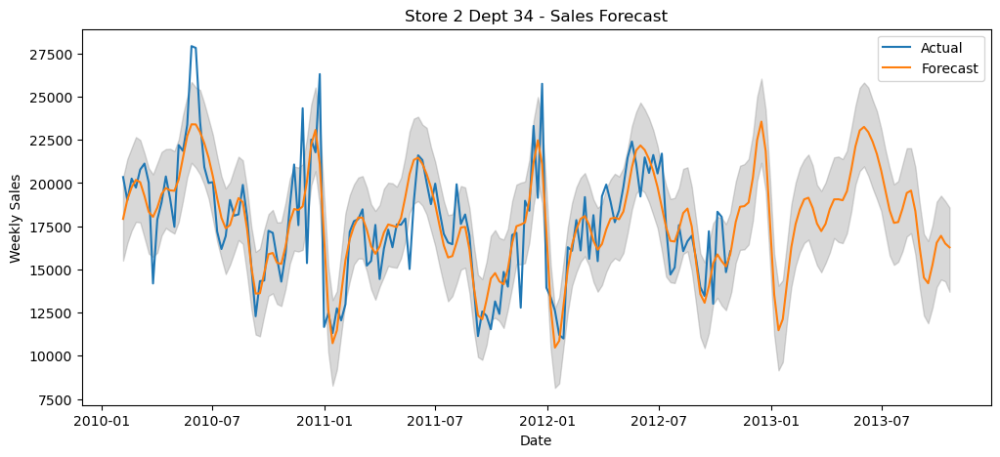

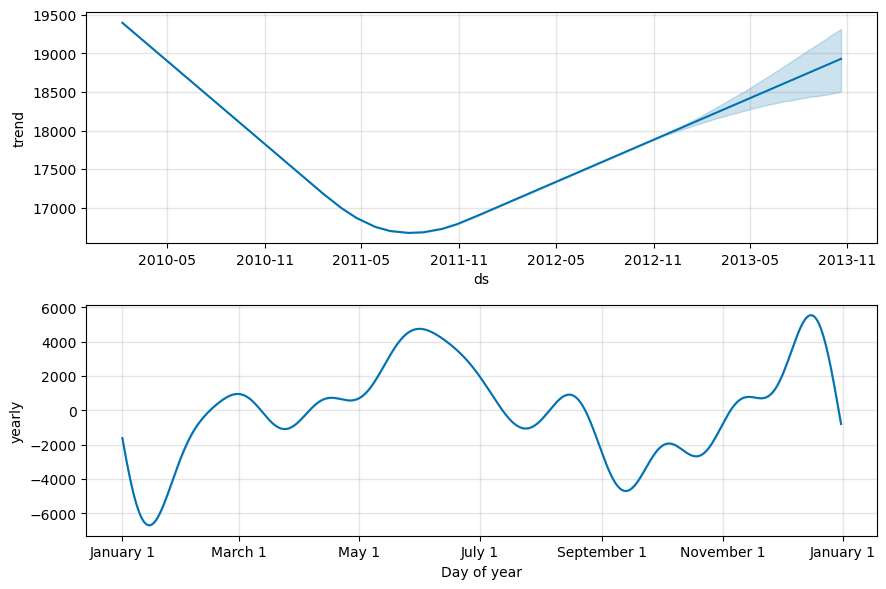


Forecasting for Store 2, Department 35


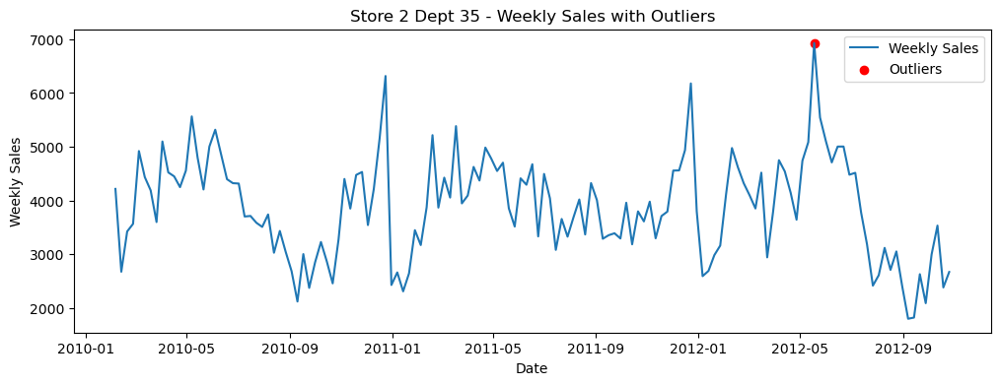

12:14:39 - cmdstanpy - INFO - Chain [1] start processing
12:14:39 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 35 - MAE: 433.79, RMSE: 561.57


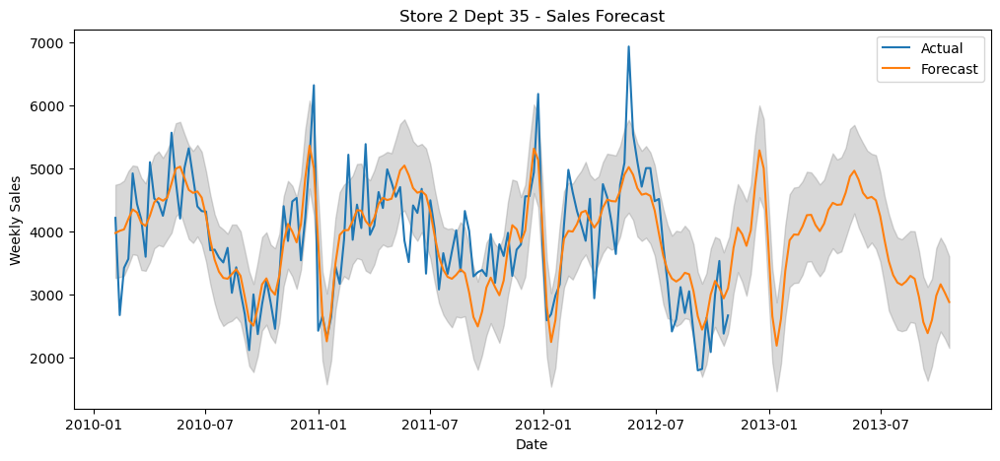

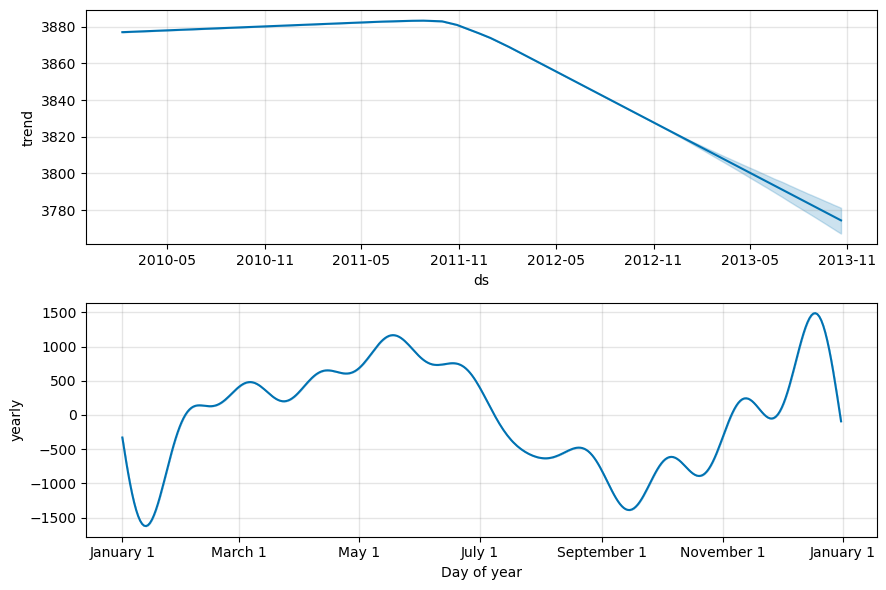


Forecasting for Store 2, Department 36


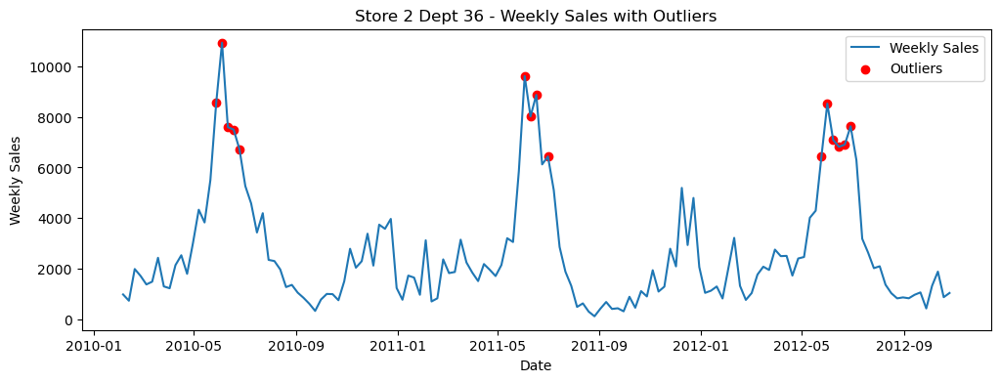

12:14:41 - cmdstanpy - INFO - Chain [1] start processing
12:14:41 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 36 - MAE: 549.86, RMSE: 710.00


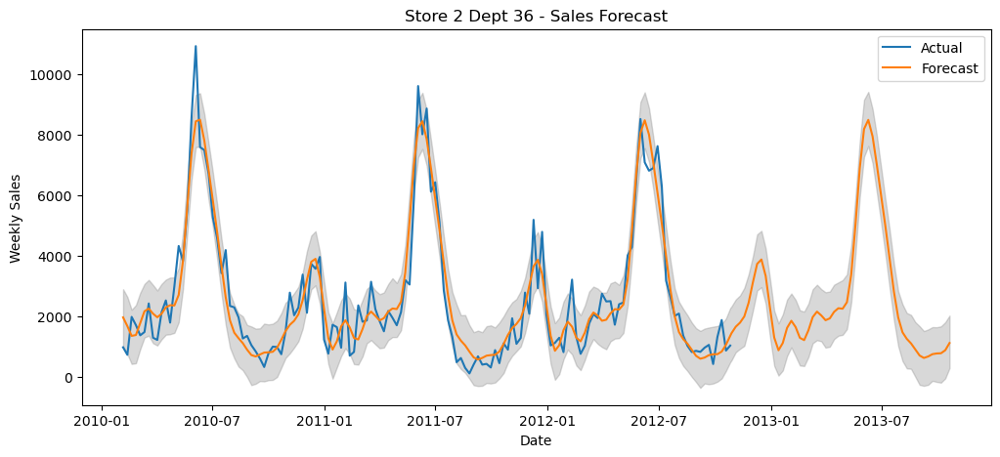

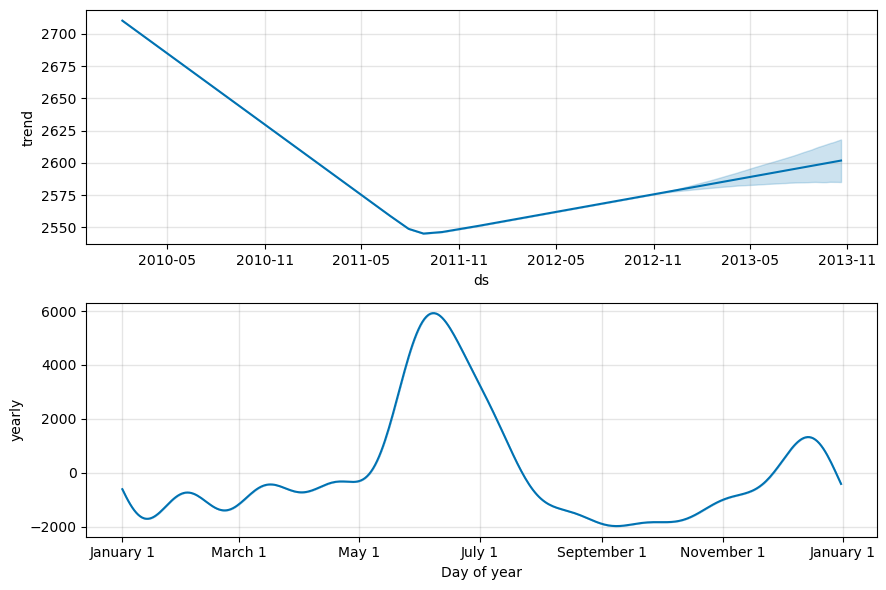


Forecasting for Store 2, Department 37


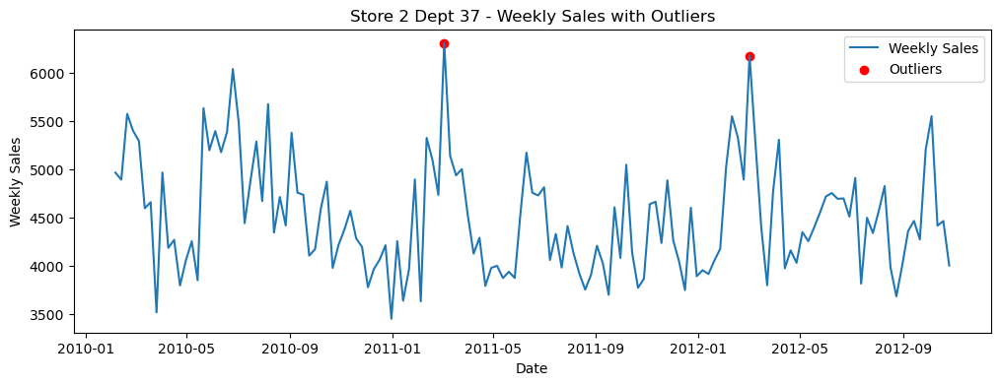

12:14:42 - cmdstanpy - INFO - Chain [1] start processing
12:14:43 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 37 - MAE: 321.35, RMSE: 403.86


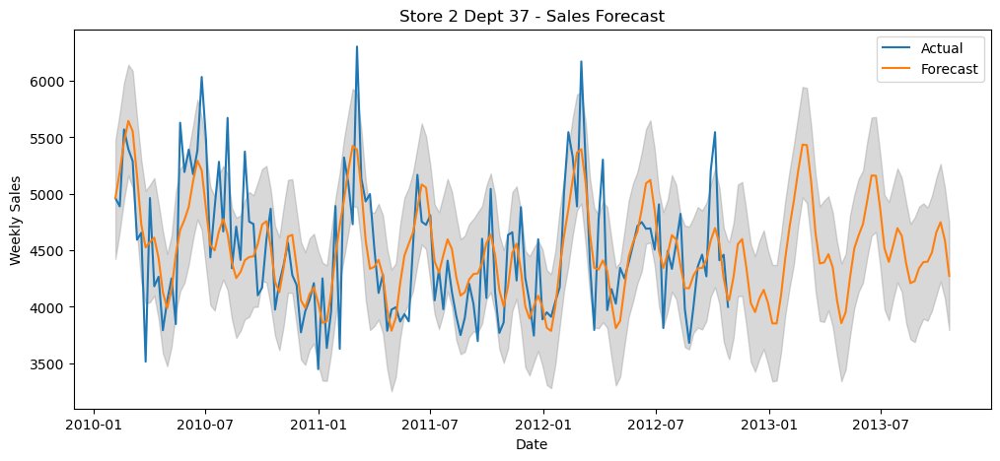

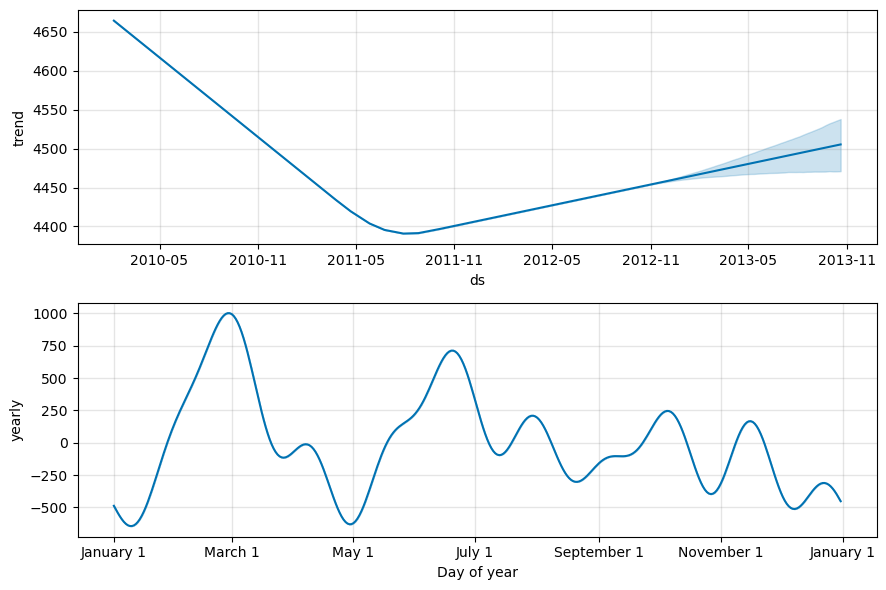


Forecasting for Store 2, Department 38


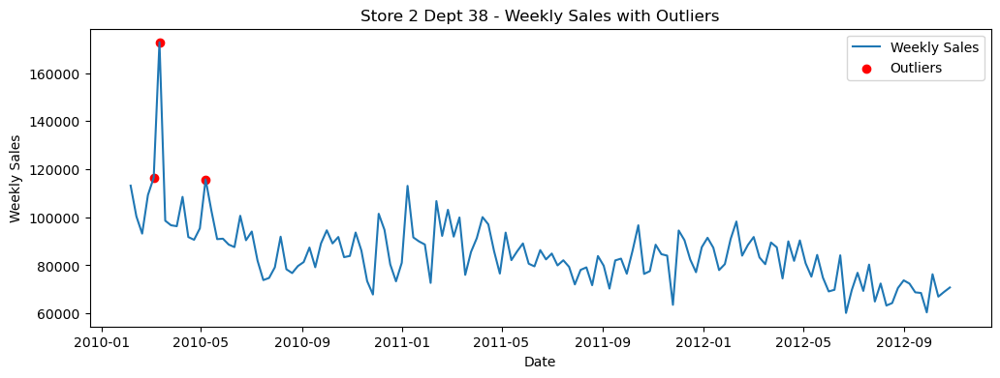

12:14:44 - cmdstanpy - INFO - Chain [1] start processing
12:14:44 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 38 - MAE: 6473.18, RMSE: 9129.84


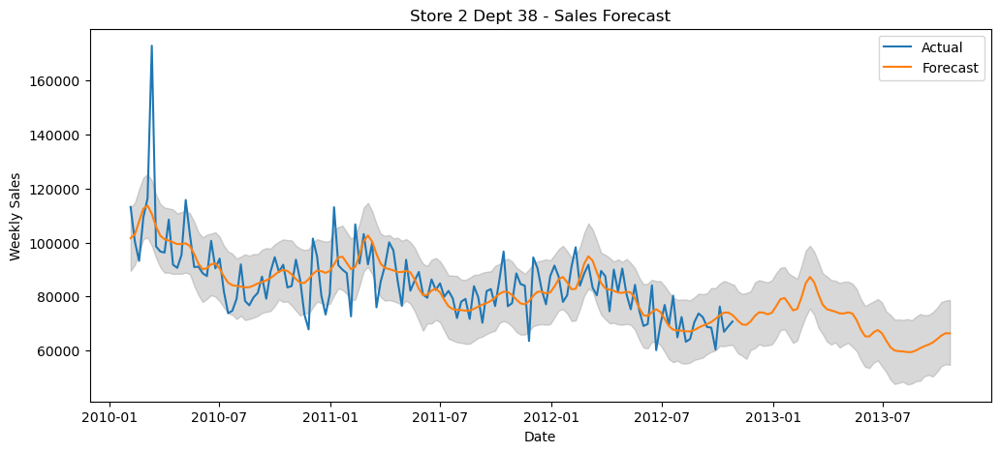

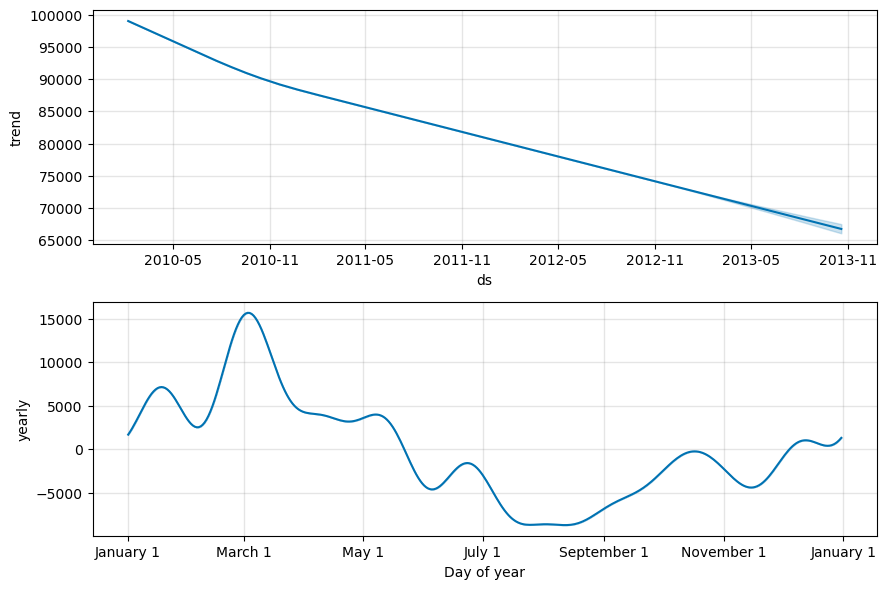


Forecasting for Store 2, Department 40


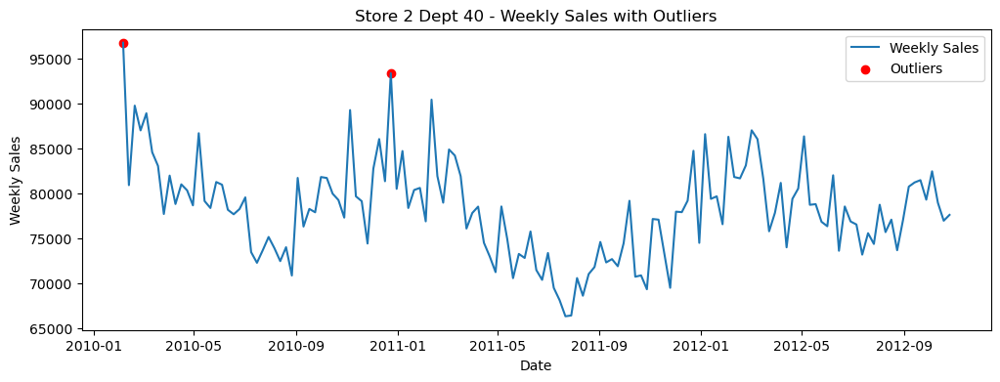

12:14:46 - cmdstanpy - INFO - Chain [1] start processing
12:14:46 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 40 - MAE: 2319.75, RMSE: 3028.17


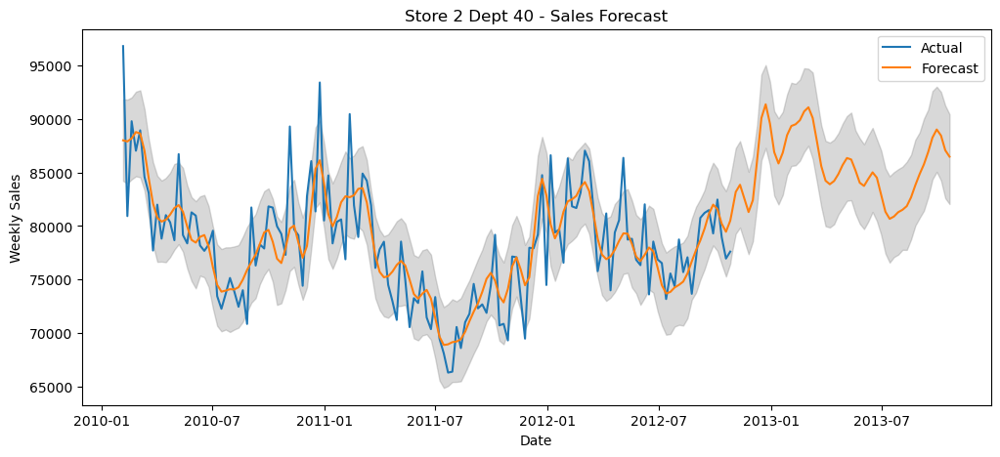

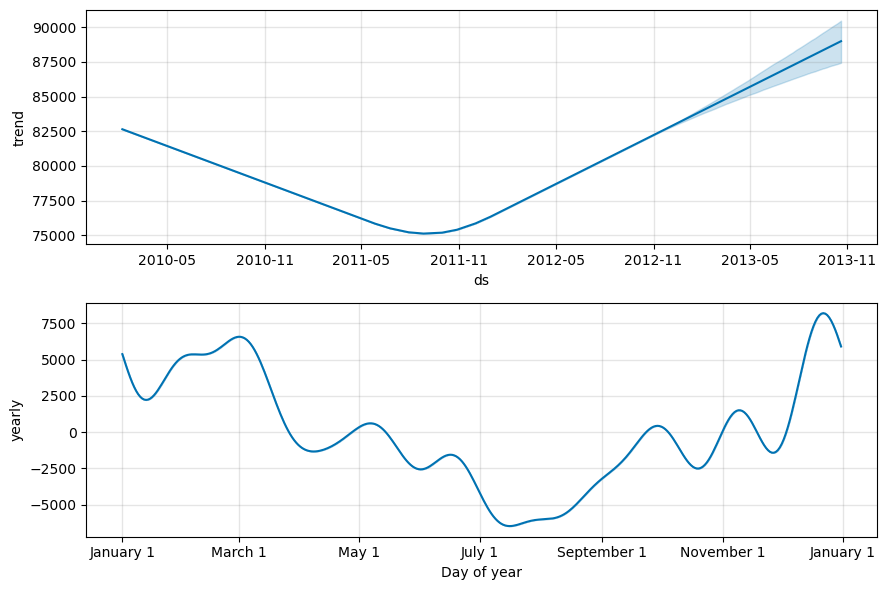


Forecasting for Store 2, Department 41


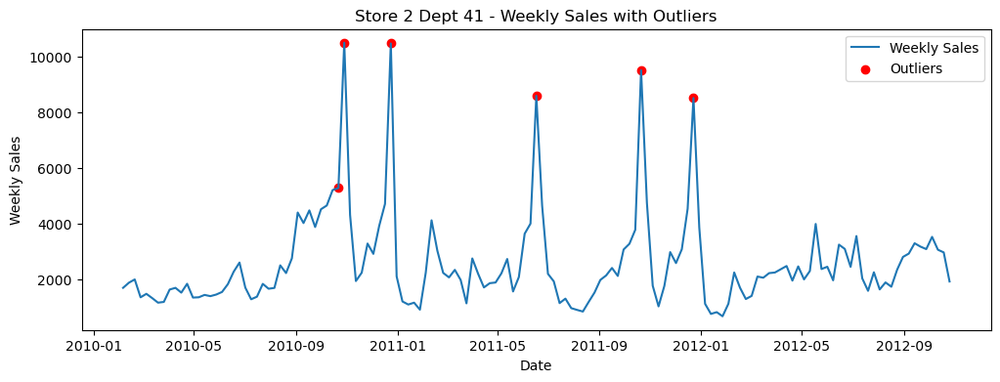

12:14:48 - cmdstanpy - INFO - Chain [1] start processing
12:14:48 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 41 - MAE: 758.95, RMSE: 1157.50


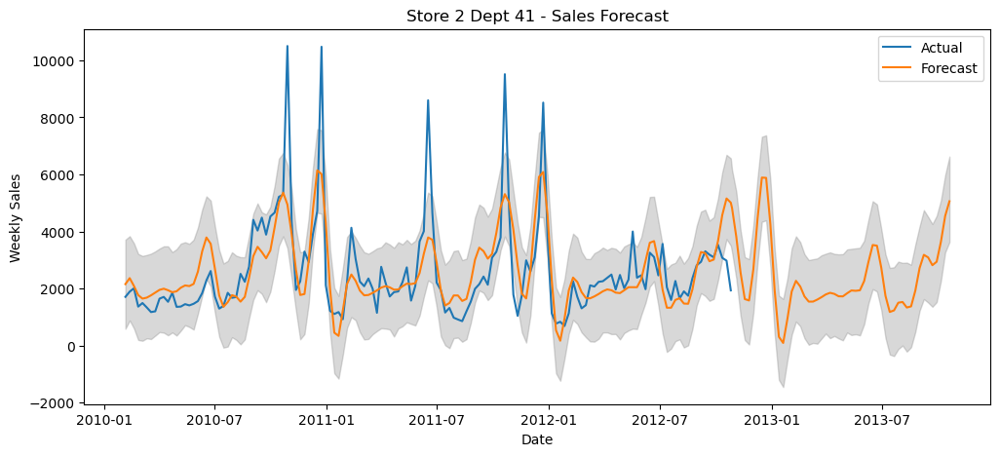

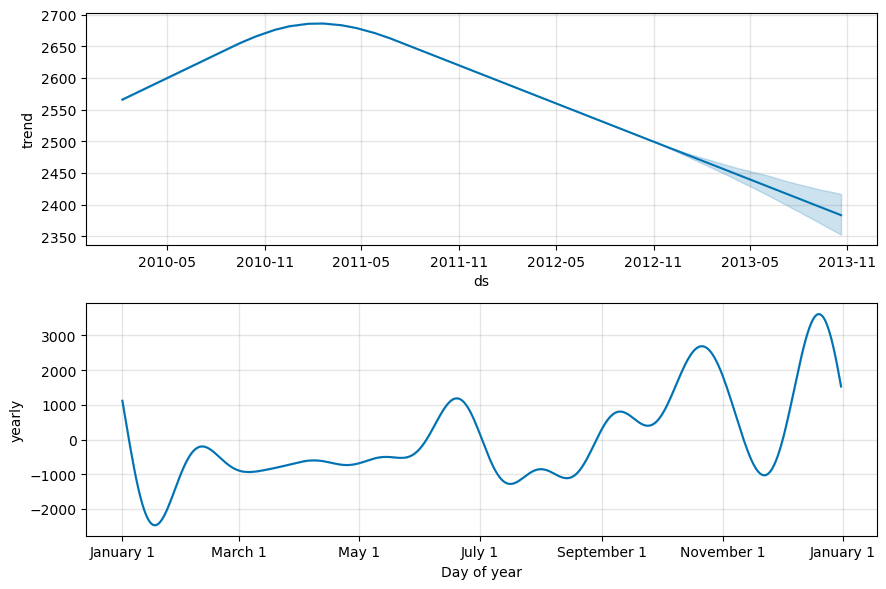


Forecasting for Store 2, Department 42


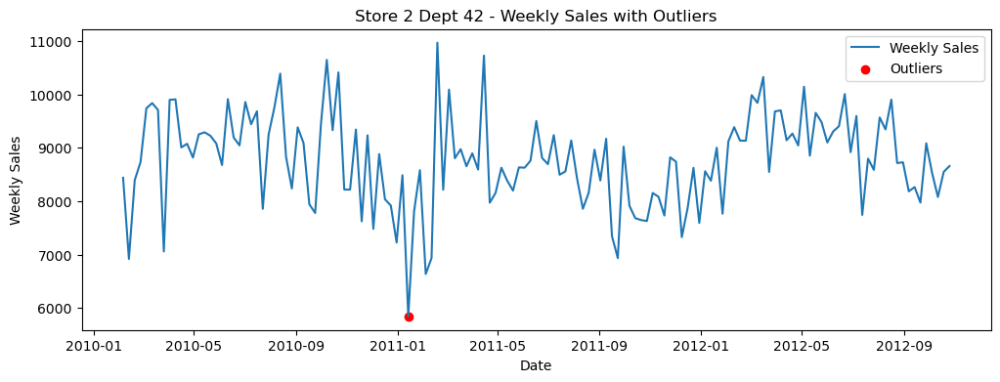

12:14:50 - cmdstanpy - INFO - Chain [1] start processing
12:14:50 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 42 - MAE: 561.36, RMSE: 716.14


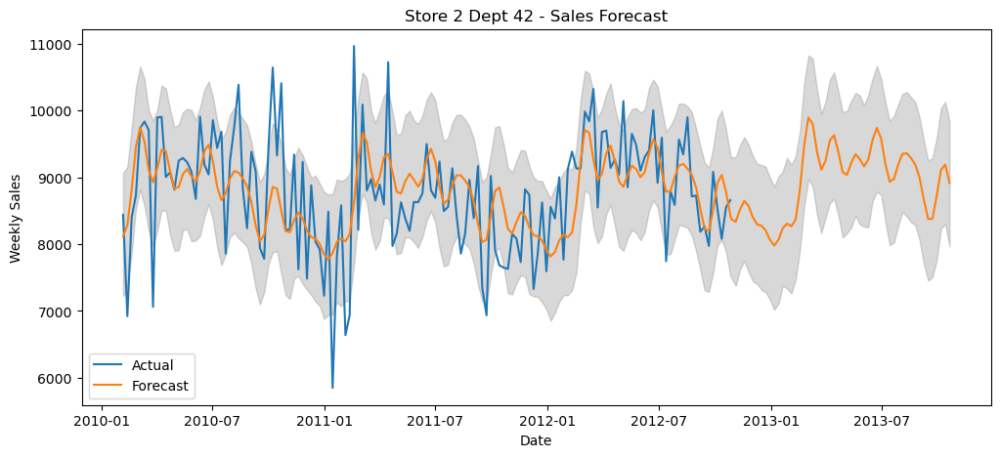

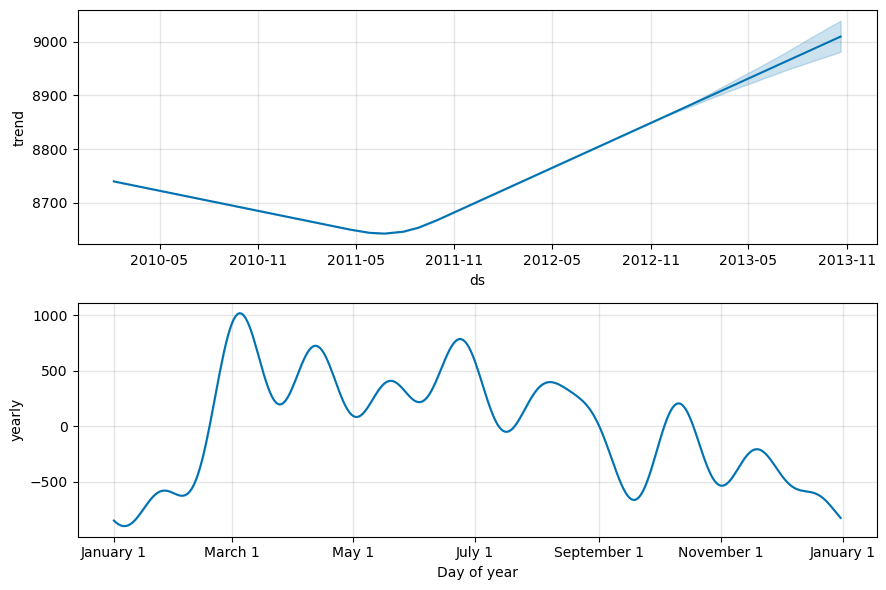


Forecasting for Store 2, Department 44


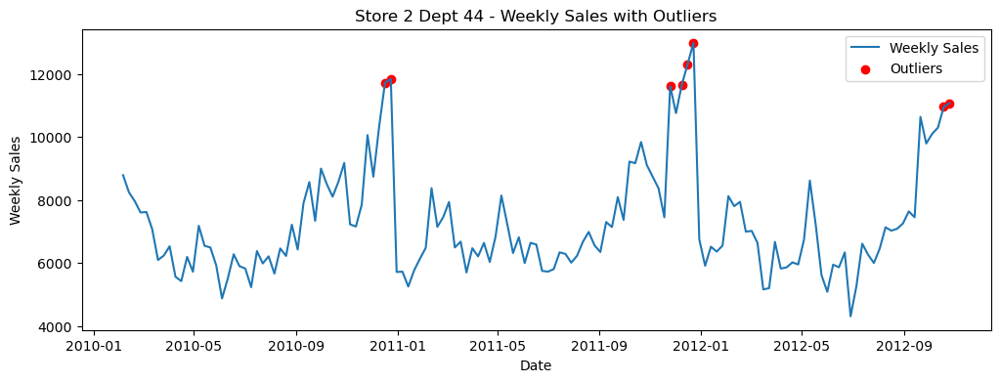

12:14:51 - cmdstanpy - INFO - Chain [1] start processing
12:14:51 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 44 - MAE: 542.80, RMSE: 739.73


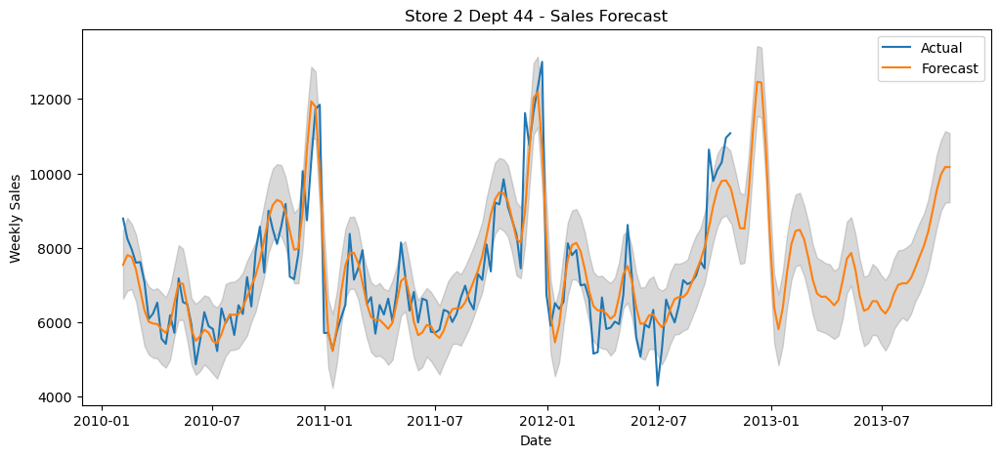

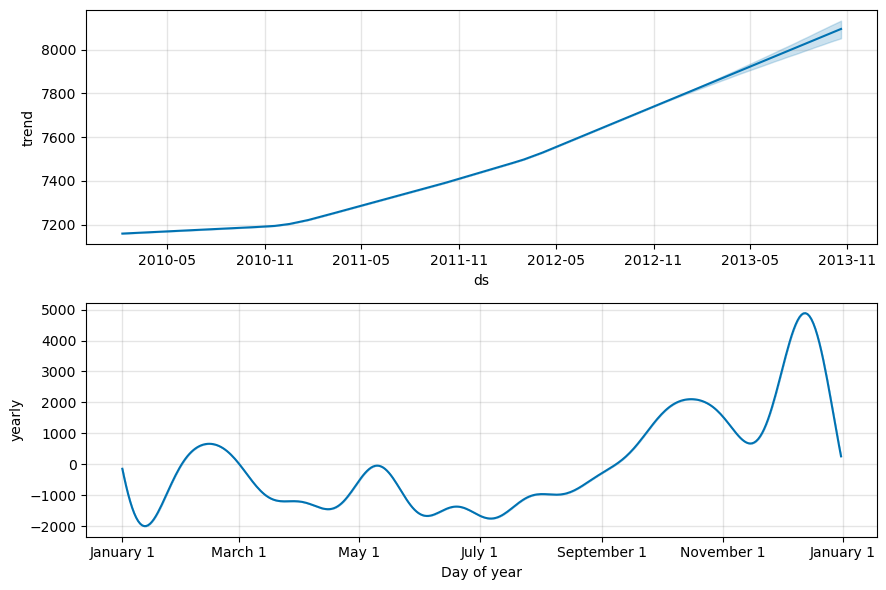


Forecasting for Store 2, Department 45


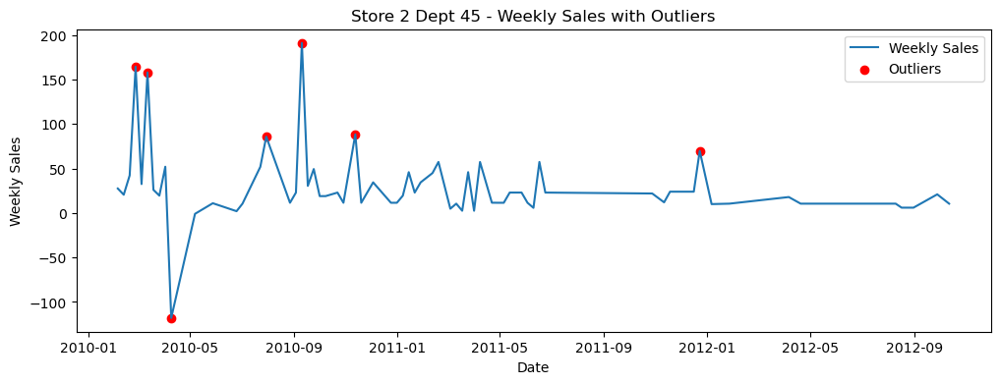

12:14:53 - cmdstanpy - INFO - Chain [1] start processing
12:14:53 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 45 - MAE: 21.88, RMSE: 33.94


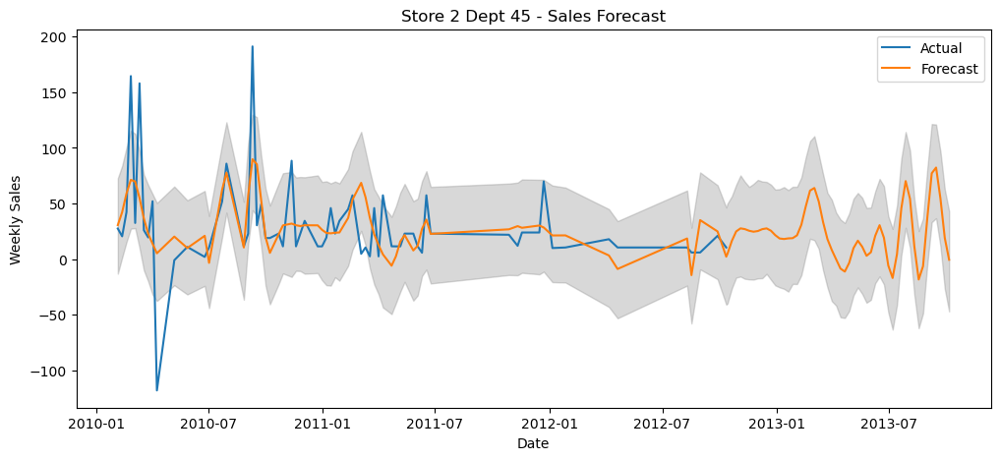

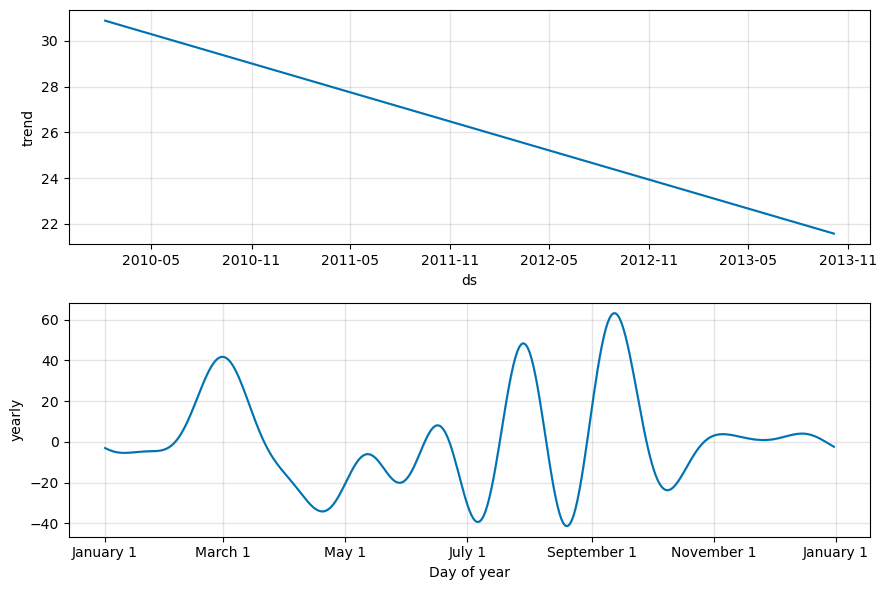


Forecasting for Store 2, Department 46


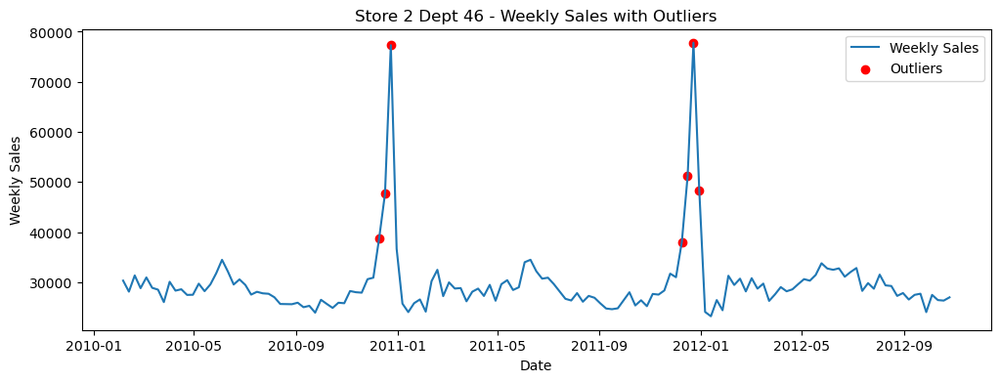

12:14:55 - cmdstanpy - INFO - Chain [1] start processing
12:14:55 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 46 - MAE: 1776.62, RMSE: 3237.44


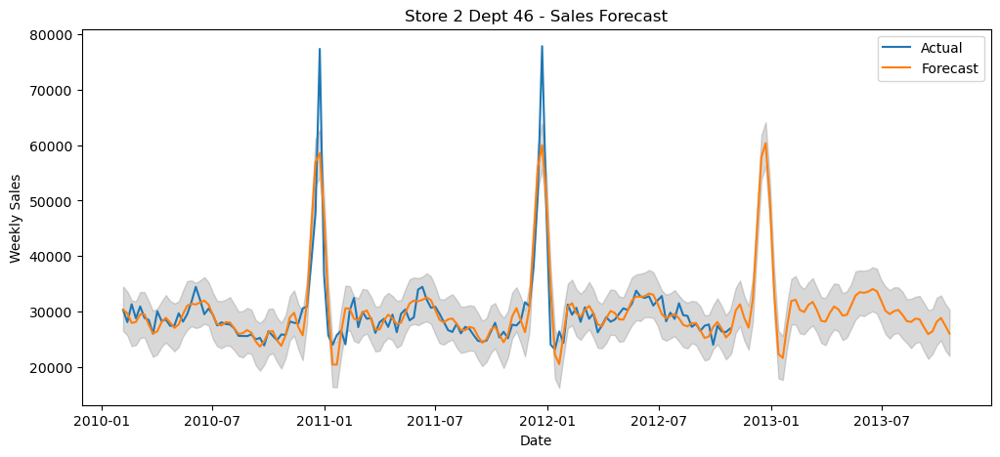

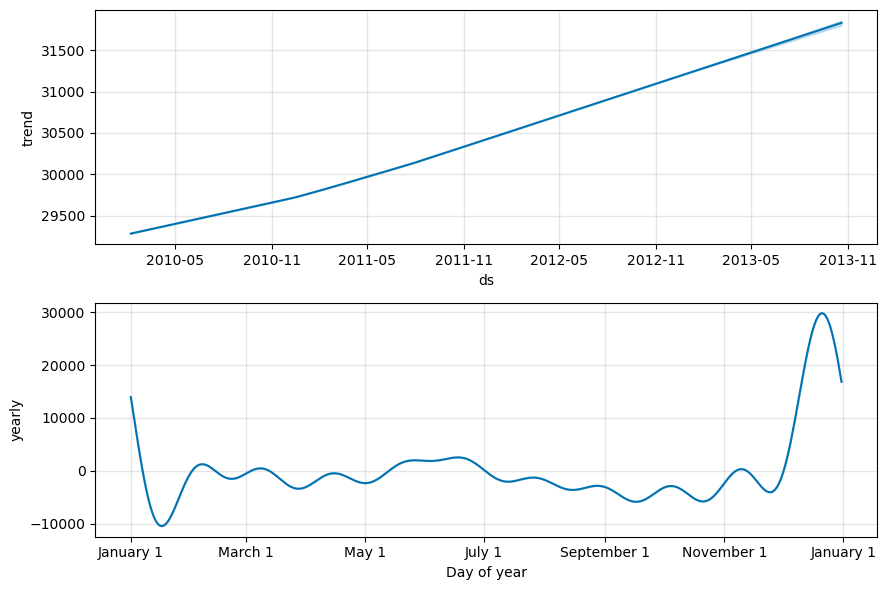


Forecasting for Store 2, Department 47


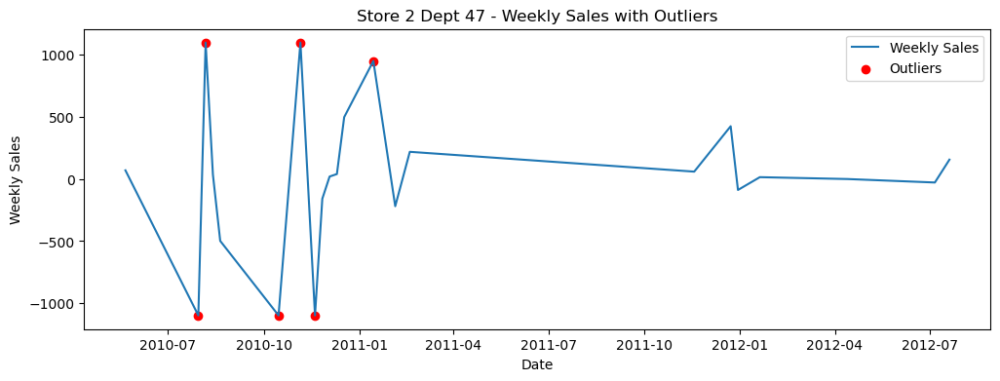

12:14:57 - cmdstanpy - INFO - Chain [1] start processing
12:14:57 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 47 - MAE: 190.14, RMSE: 246.08


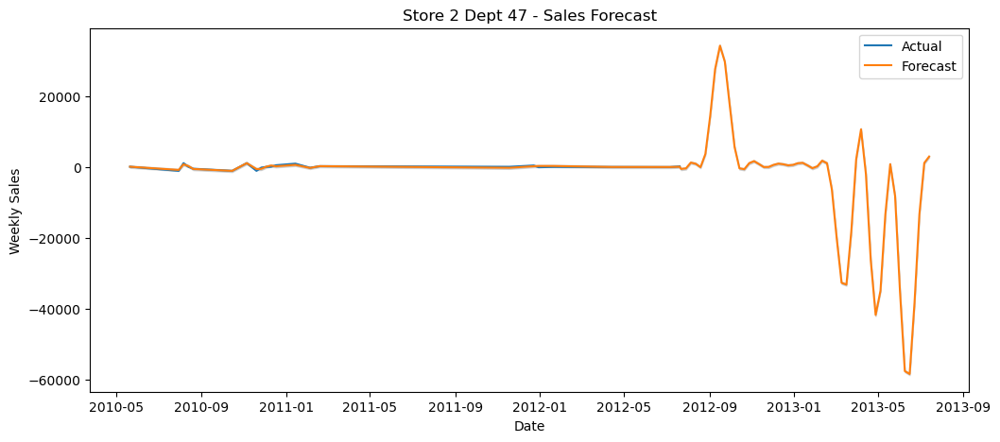

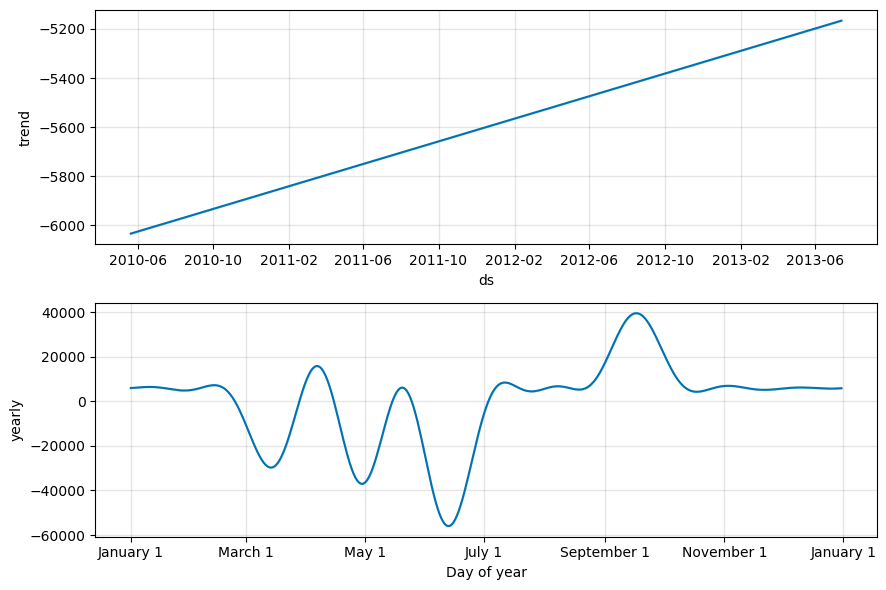


Forecasting for Store 2, Department 48


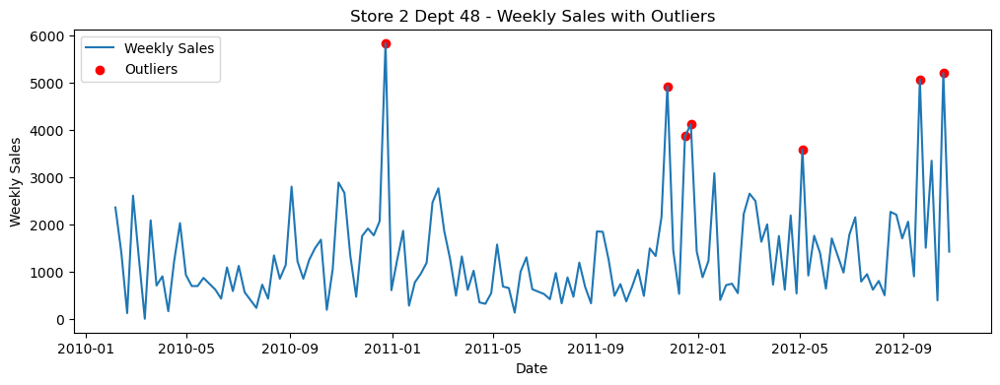

12:14:59 - cmdstanpy - INFO - Chain [1] start processing
12:14:59 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 48 - MAE: 651.55, RMSE: 897.91


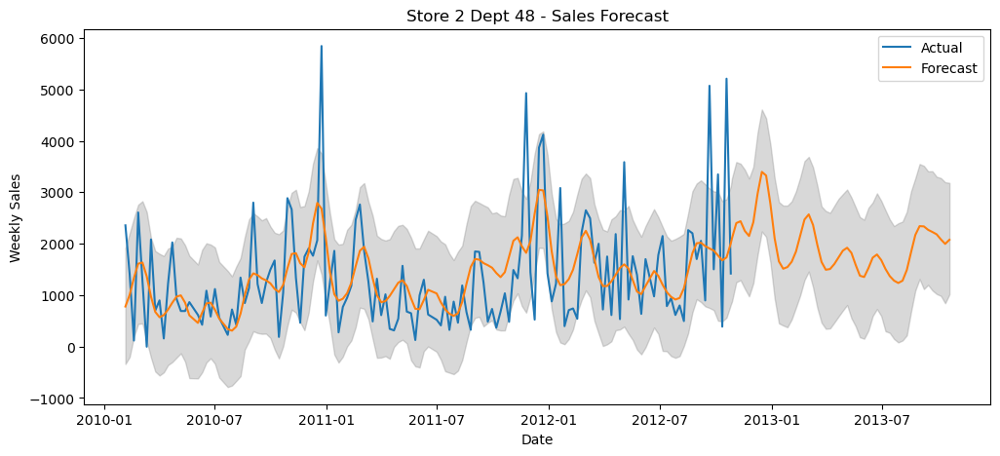

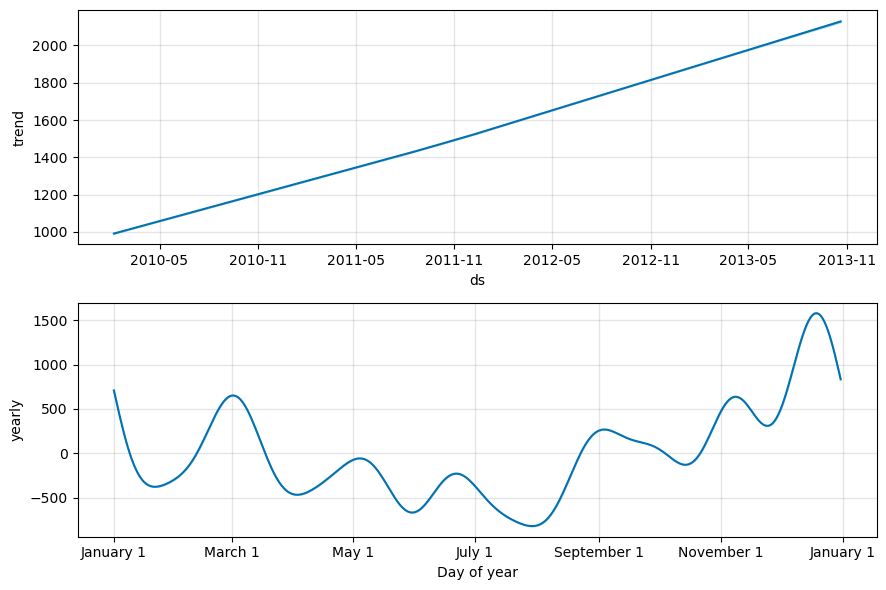


Forecasting for Store 2, Department 49


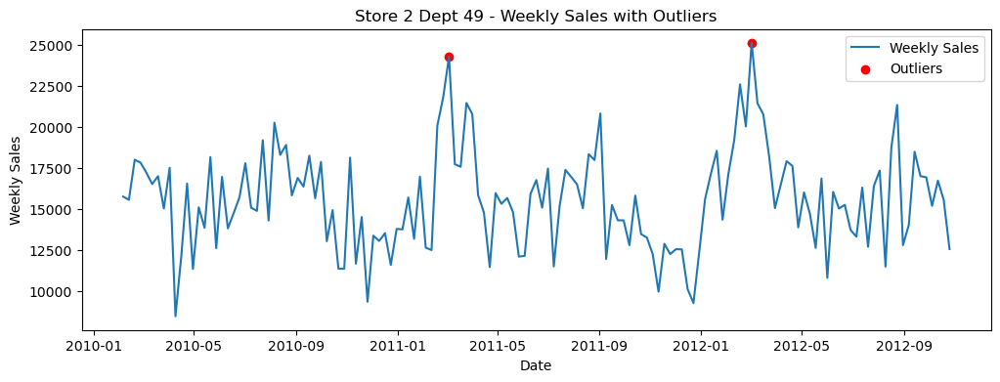

12:15:01 - cmdstanpy - INFO - Chain [1] start processing
12:15:01 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 49 - MAE: 1692.11, RMSE: 2137.46


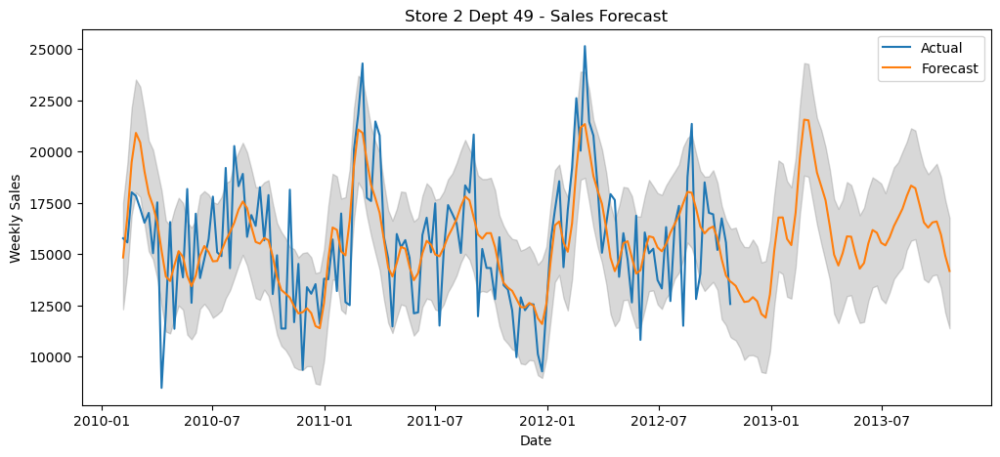

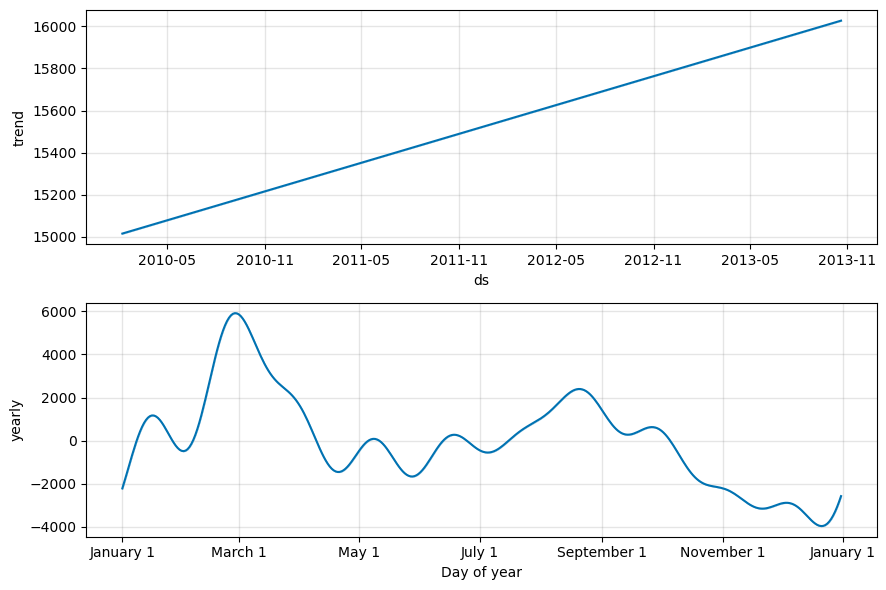


Forecasting for Store 2, Department 51


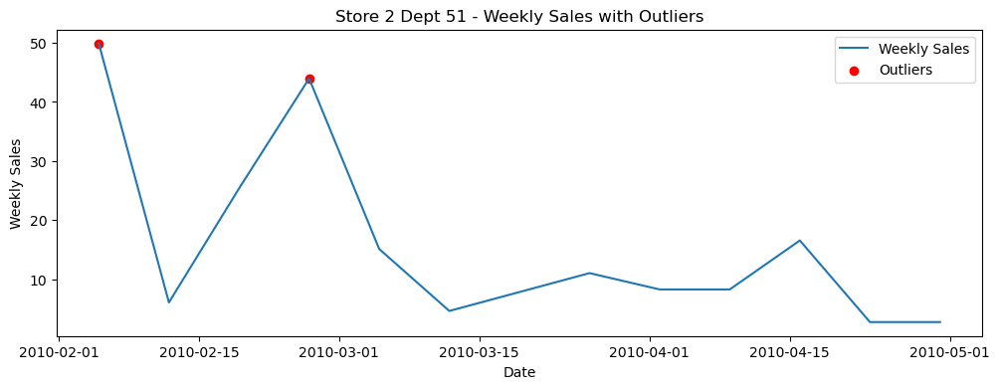

12:15:02 - cmdstanpy - INFO - Chain [1] start processing
12:15:03 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 51 - MAE: 1.45, RMSE: 1.96


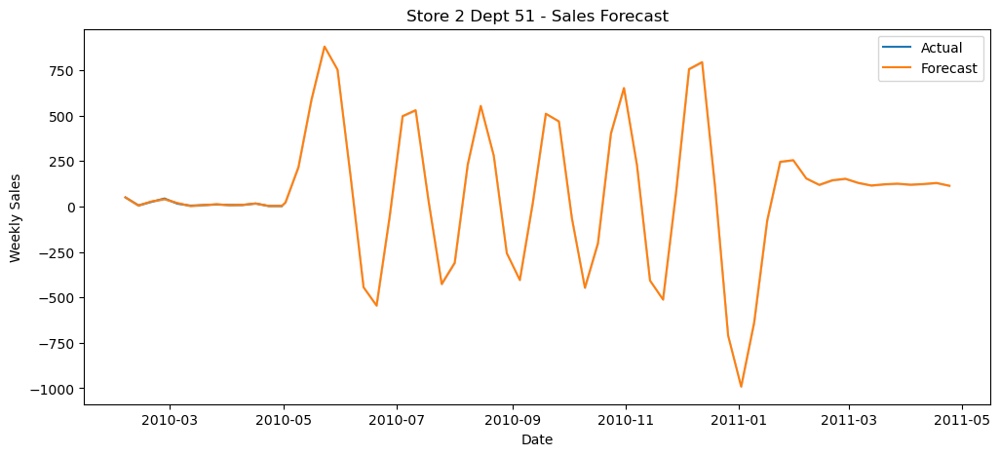

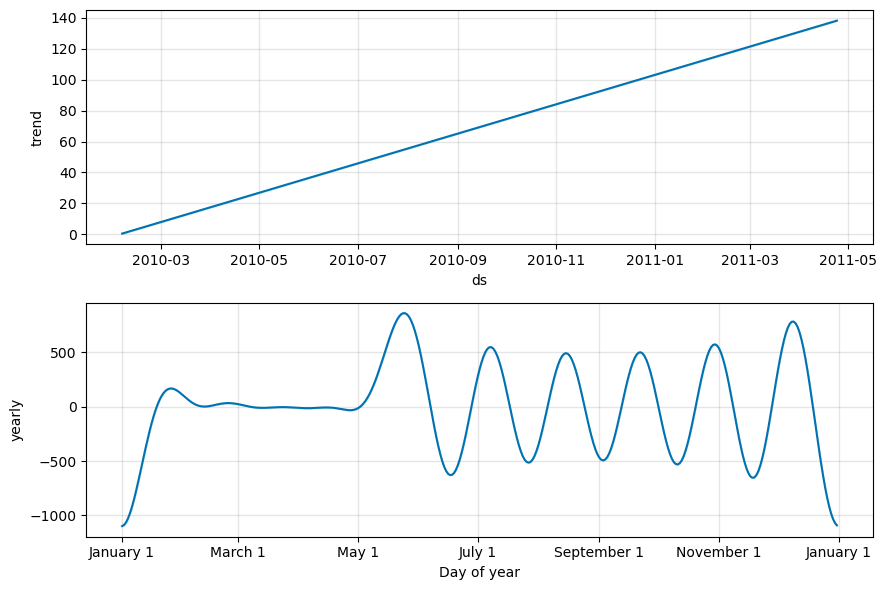


Forecasting for Store 2, Department 52


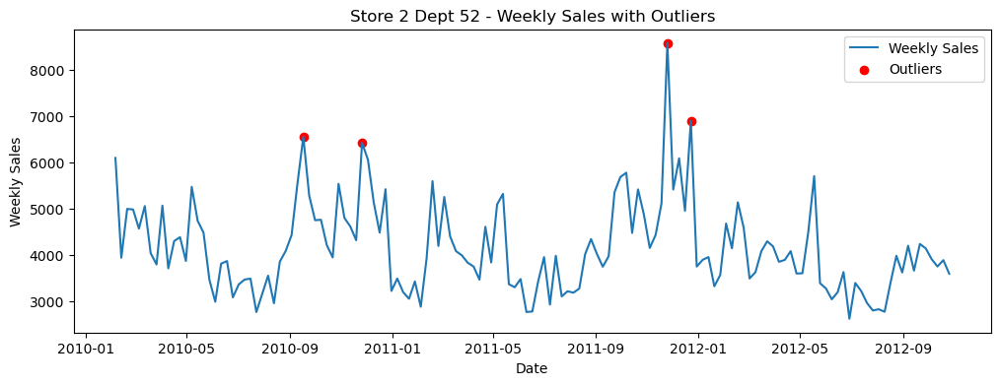

12:15:04 - cmdstanpy - INFO - Chain [1] start processing
12:15:04 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 52 - MAE: 456.51, RMSE: 613.35


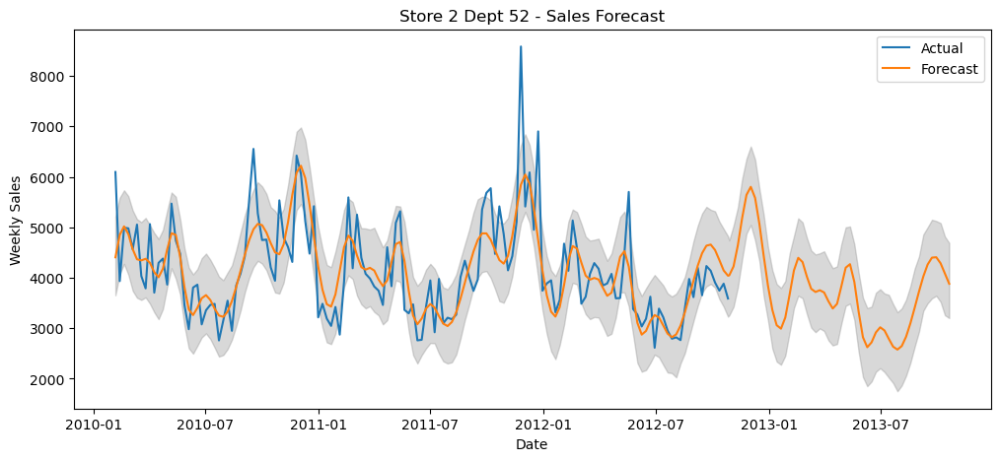

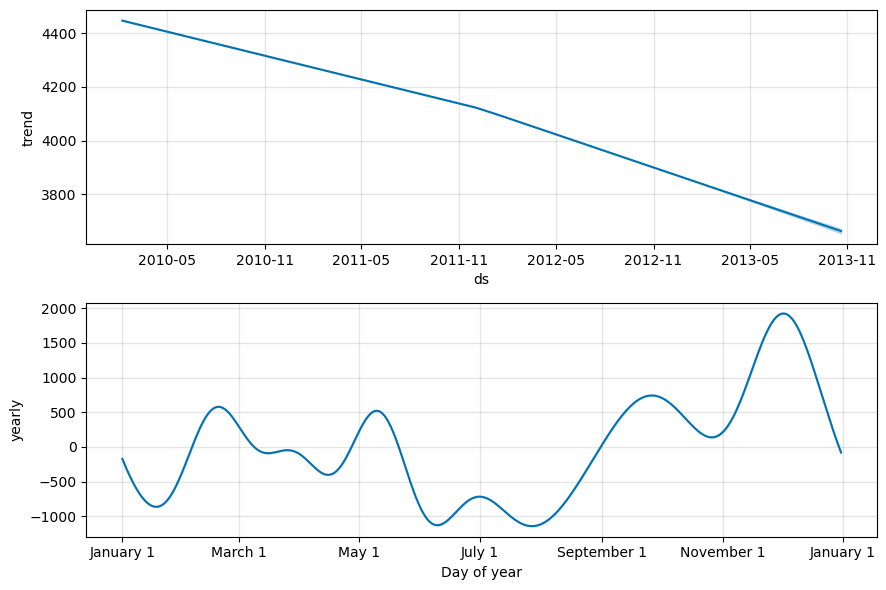


Forecasting for Store 2, Department 54


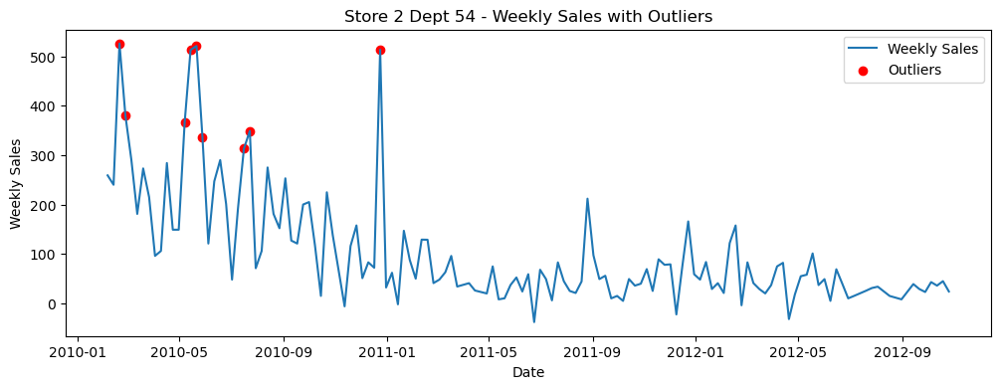

12:15:06 - cmdstanpy - INFO - Chain [1] start processing
12:15:06 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 54 - MAE: 52.97, RMSE: 73.22


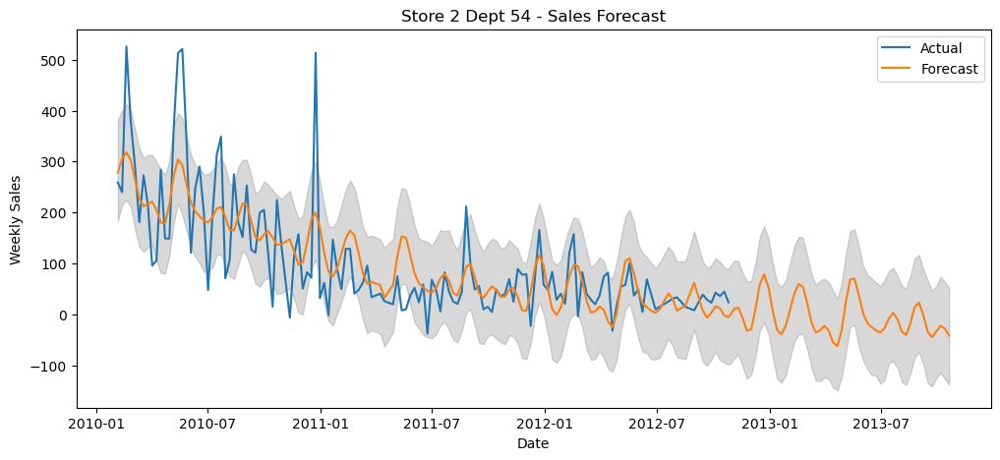

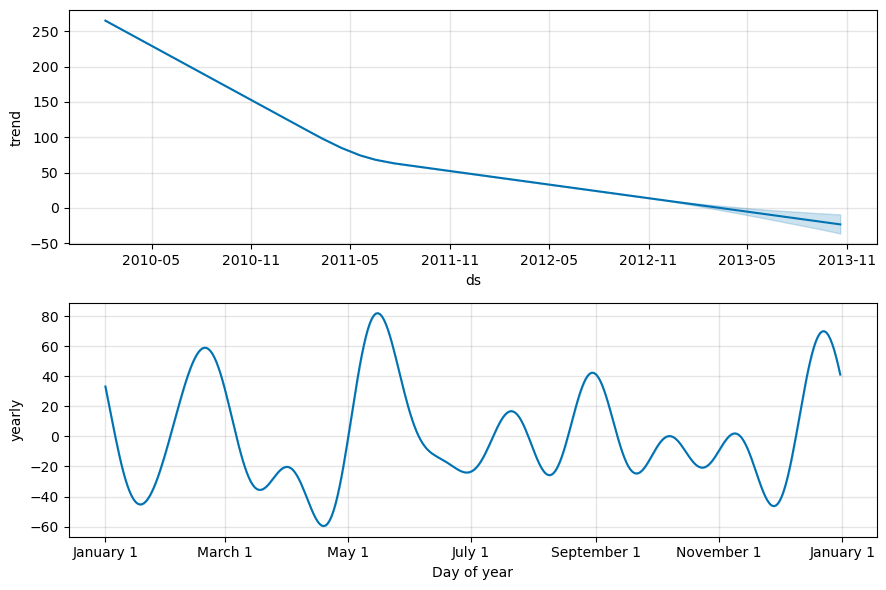


Forecasting for Store 2, Department 55


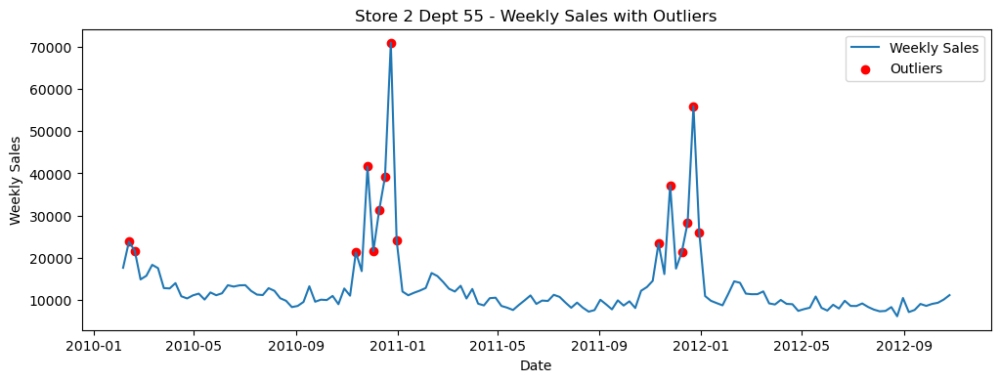

12:15:08 - cmdstanpy - INFO - Chain [1] start processing
12:15:08 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 55 - MAE: 2291.19, RMSE: 4236.44


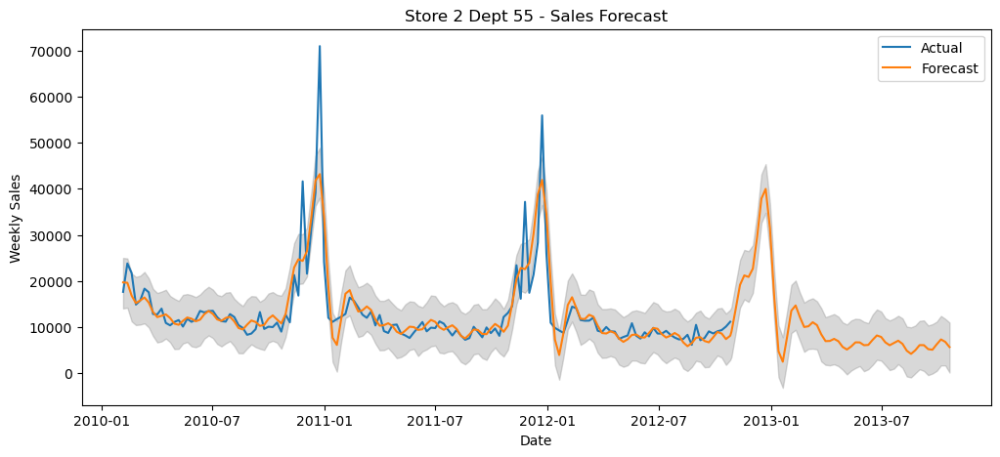

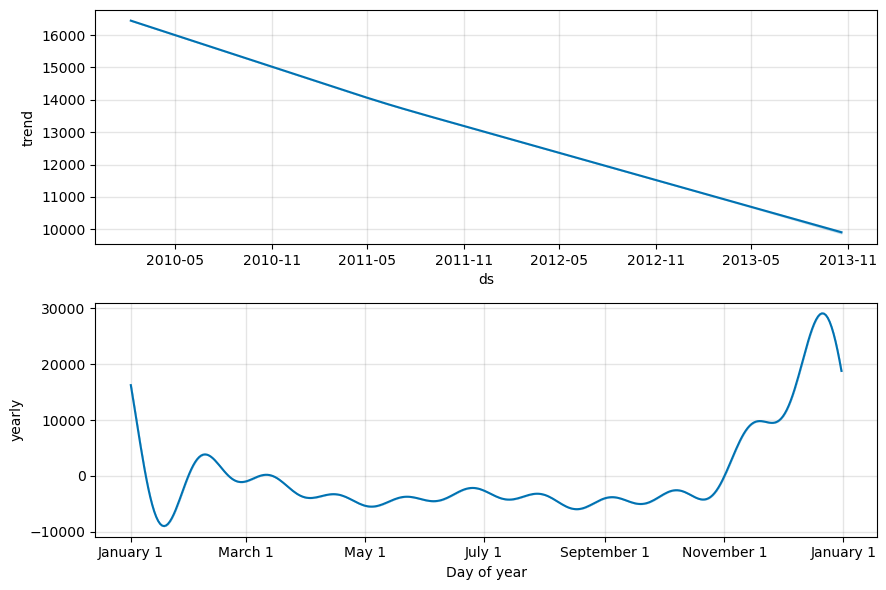


Forecasting for Store 2, Department 56


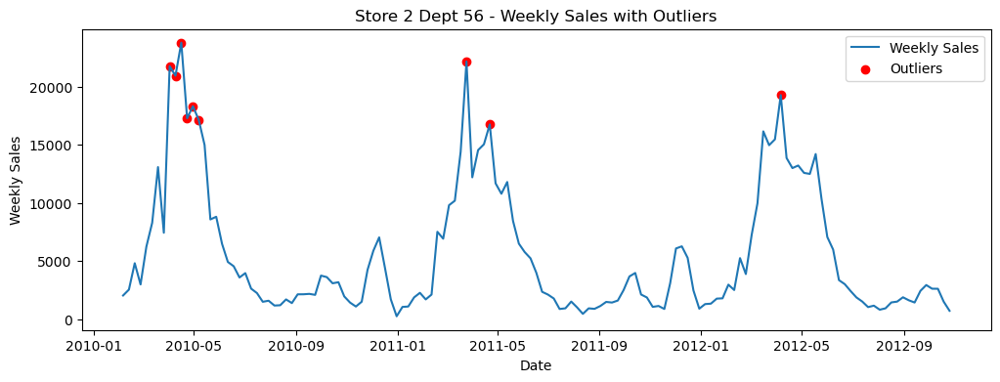

12:15:10 - cmdstanpy - INFO - Chain [1] start processing
12:15:10 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 56 - MAE: 1010.48, RMSE: 1716.04


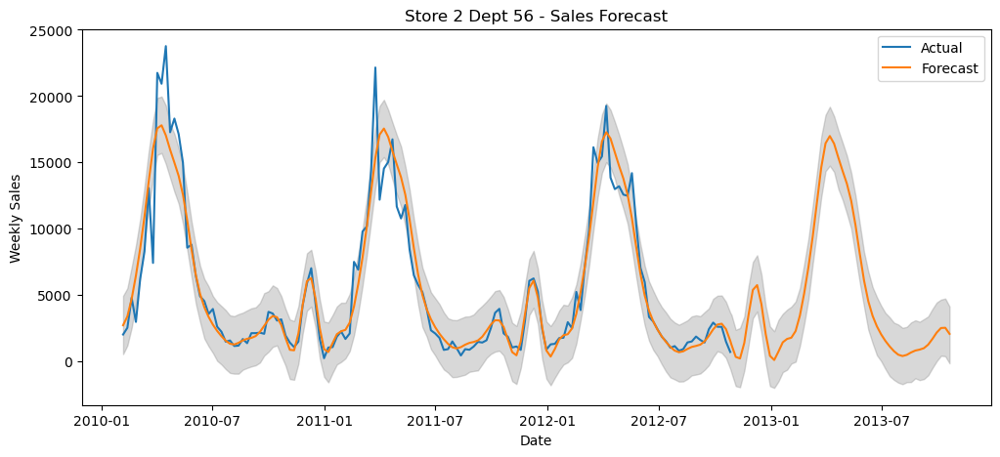

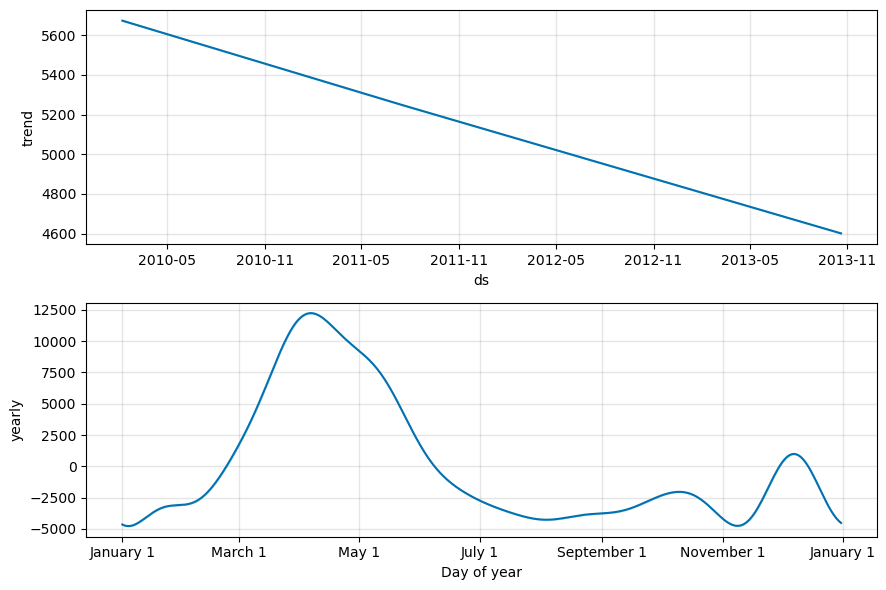


Forecasting for Store 2, Department 58


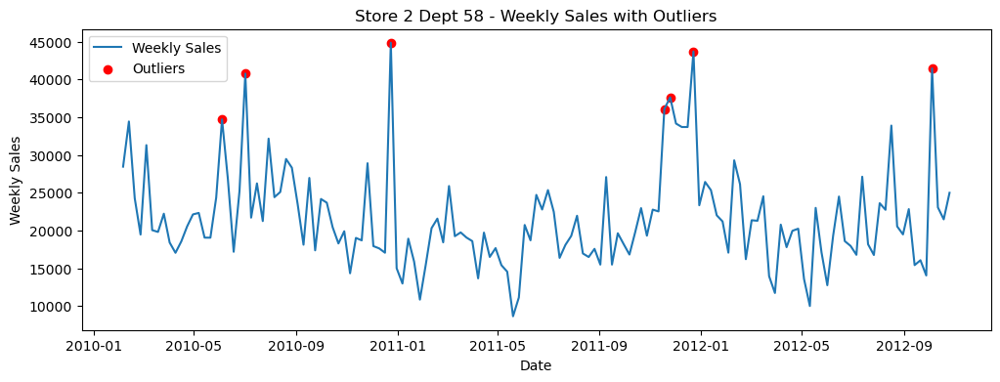

12:15:12 - cmdstanpy - INFO - Chain [1] start processing
12:15:12 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 58 - MAE: 4149.05, RMSE: 5474.31


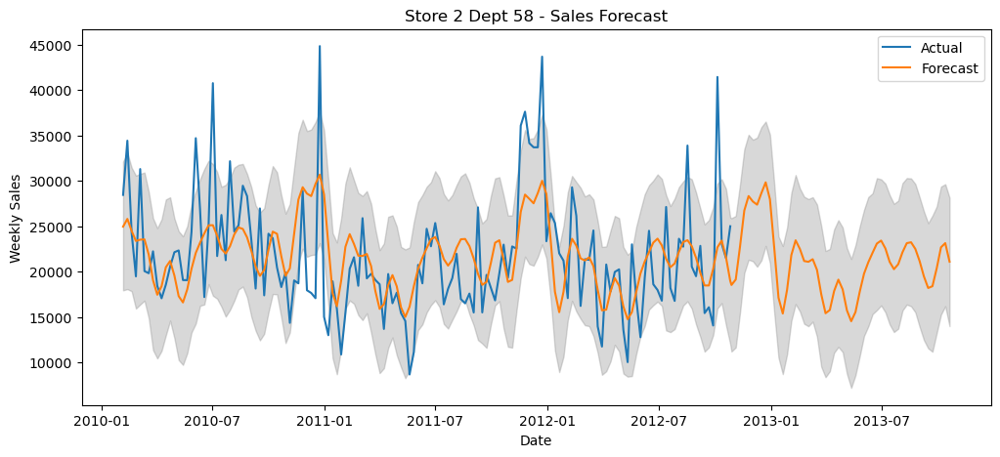

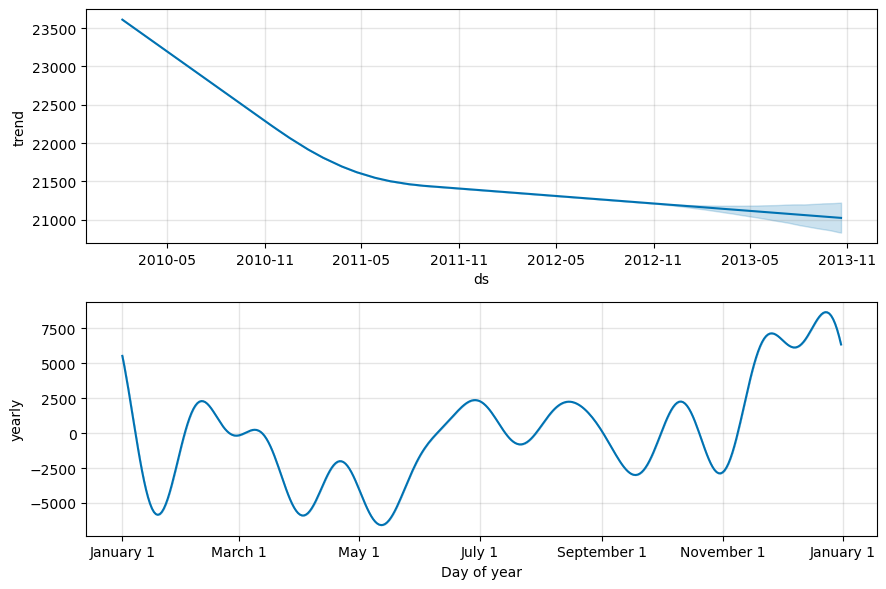


Forecasting for Store 2, Department 59


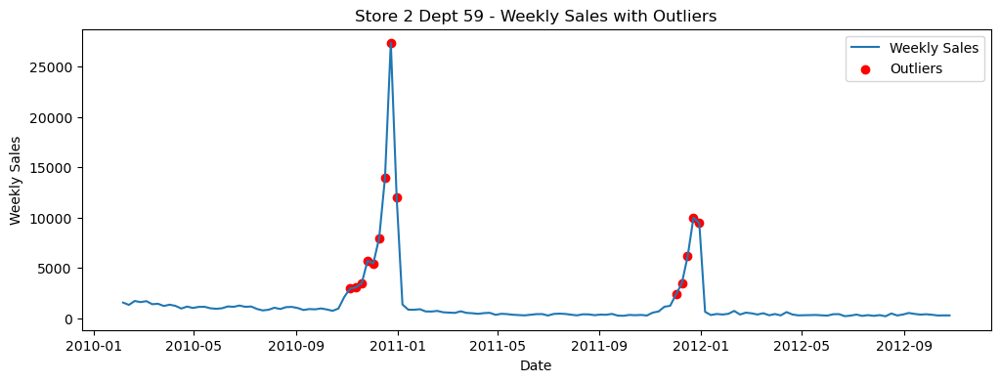

12:15:13 - cmdstanpy - INFO - Chain [1] start processing
12:15:13 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 59 - MAE: 625.09, RMSE: 1460.11


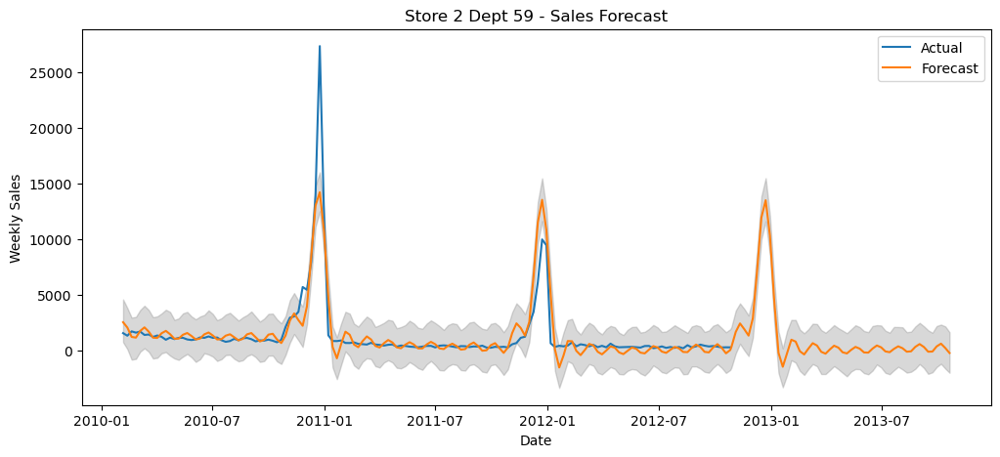

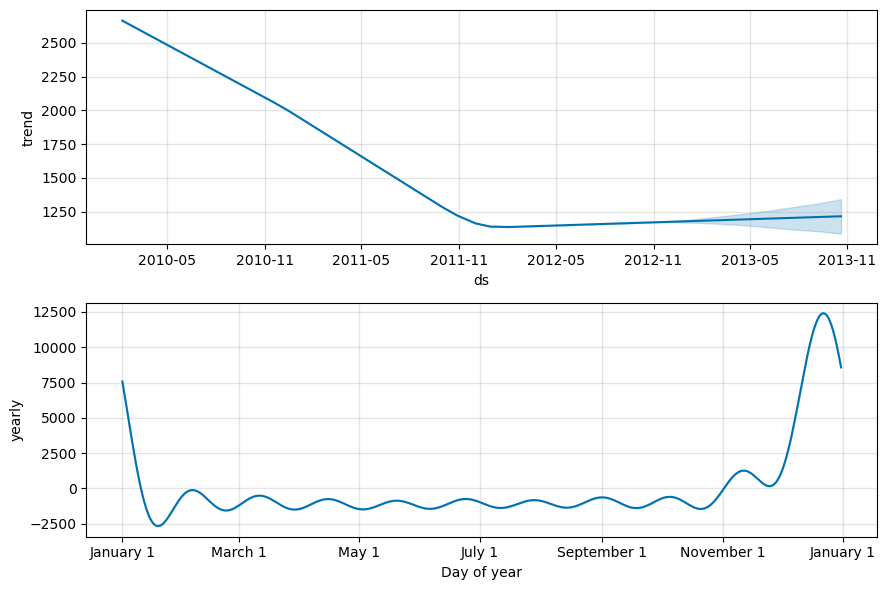


Forecasting for Store 2, Department 60


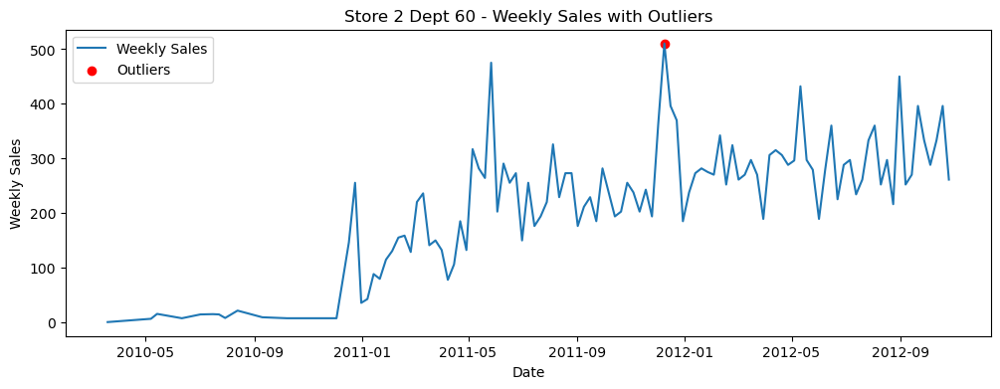

12:15:15 - cmdstanpy - INFO - Chain [1] start processing
12:15:15 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 60 - MAE: 44.76, RMSE: 58.28


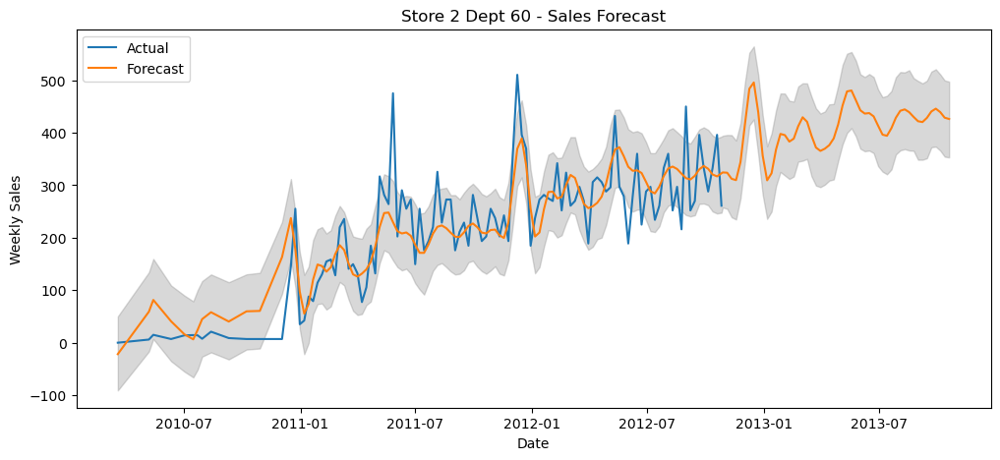

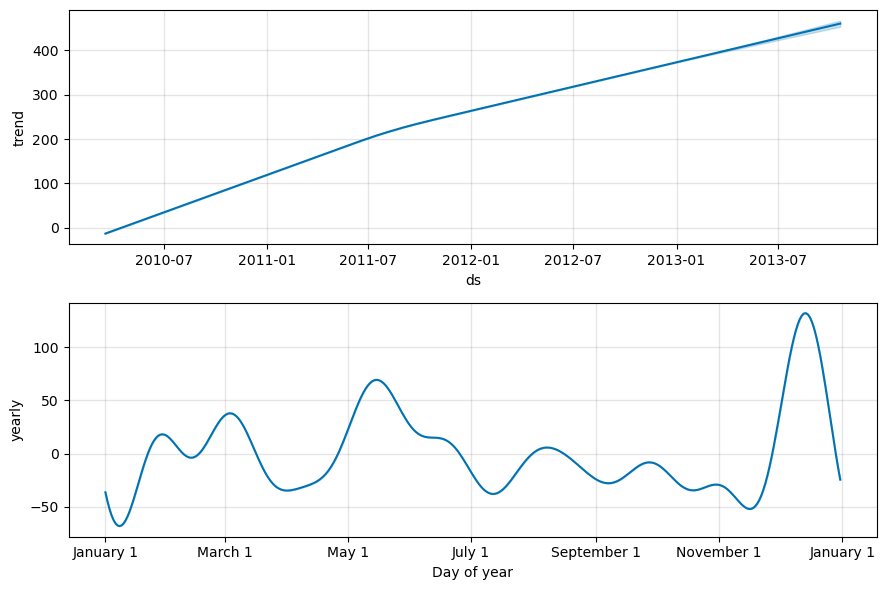


Forecasting for Store 2, Department 67


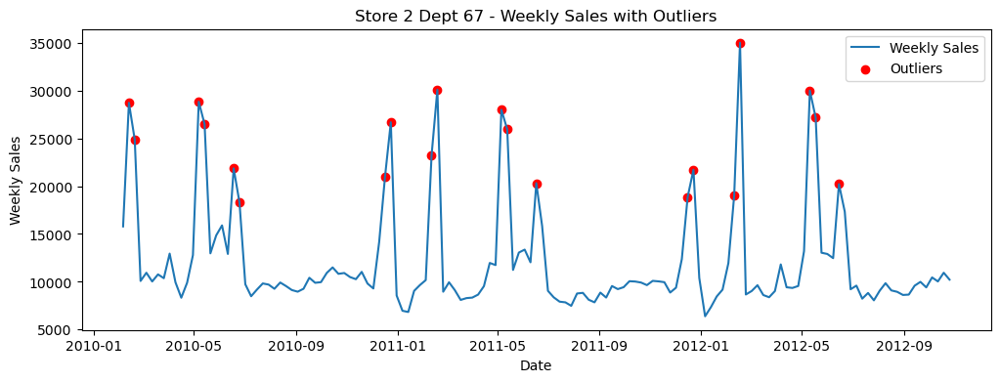

12:15:16 - cmdstanpy - INFO - Chain [1] start processing
12:15:16 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 67 - MAE: 2132.20, RMSE: 3063.95


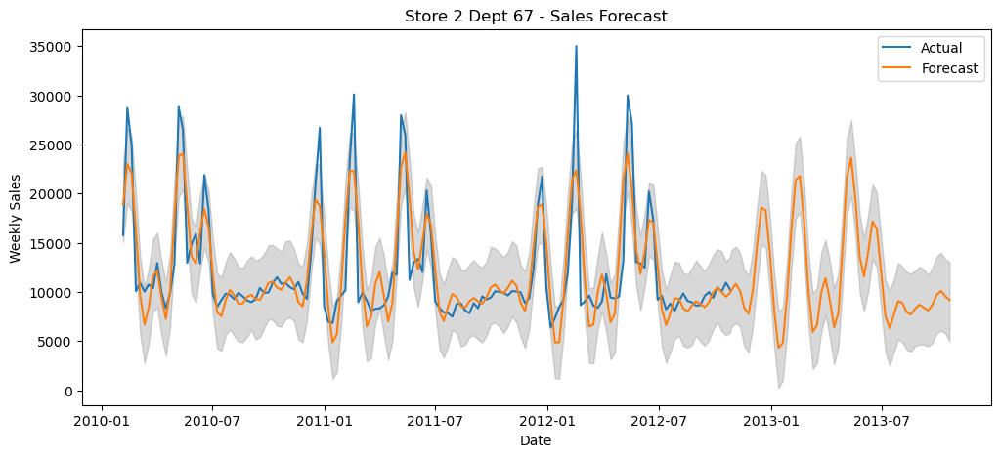

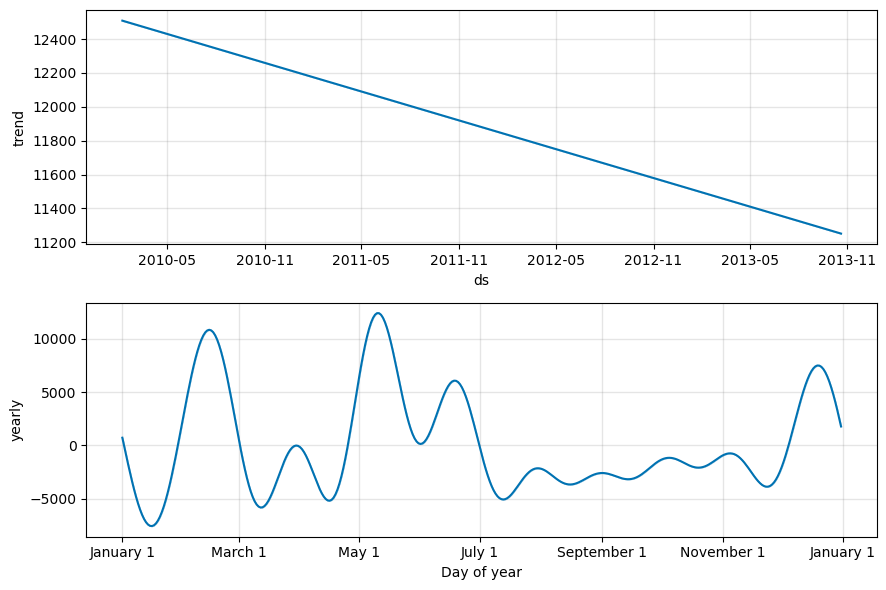


Forecasting for Store 2, Department 71


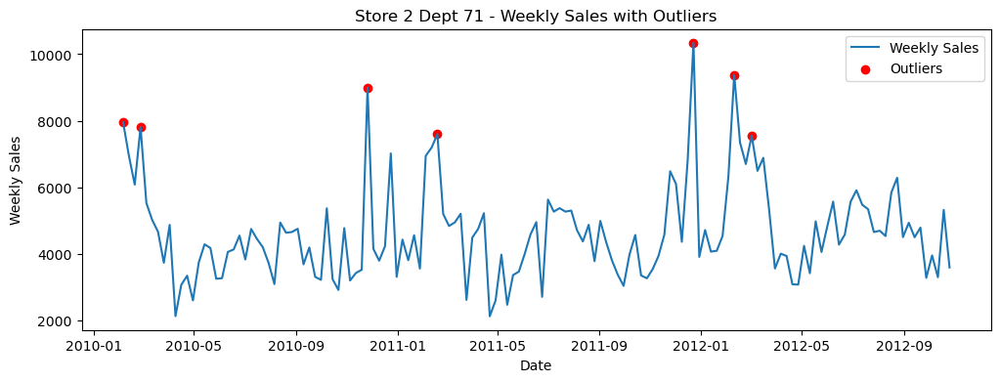

12:15:18 - cmdstanpy - INFO - Chain [1] start processing
12:15:18 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 71 - MAE: 663.37, RMSE: 912.58


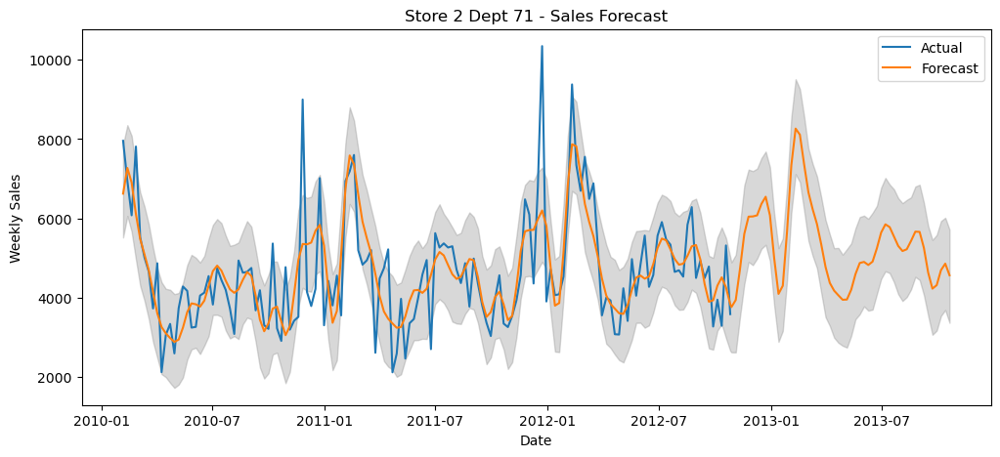

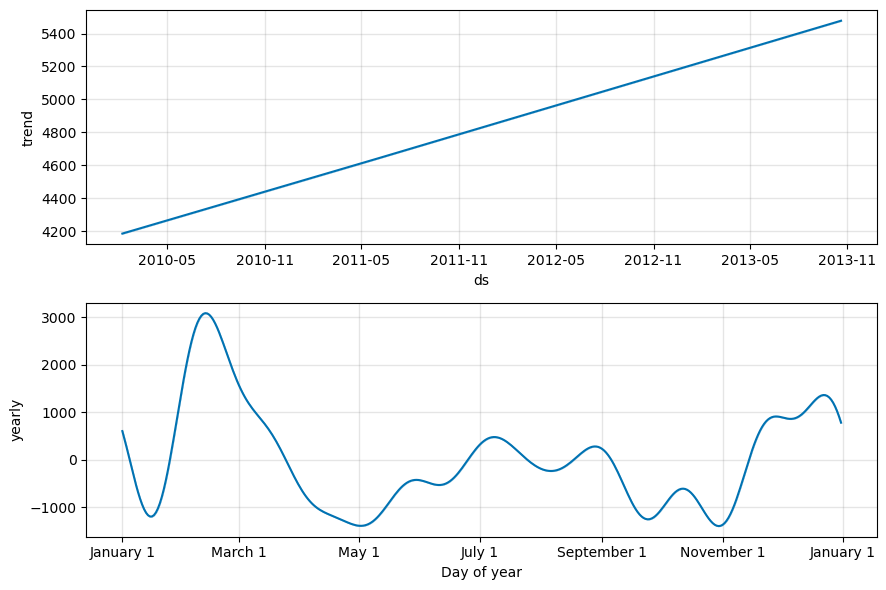


Forecasting for Store 2, Department 72


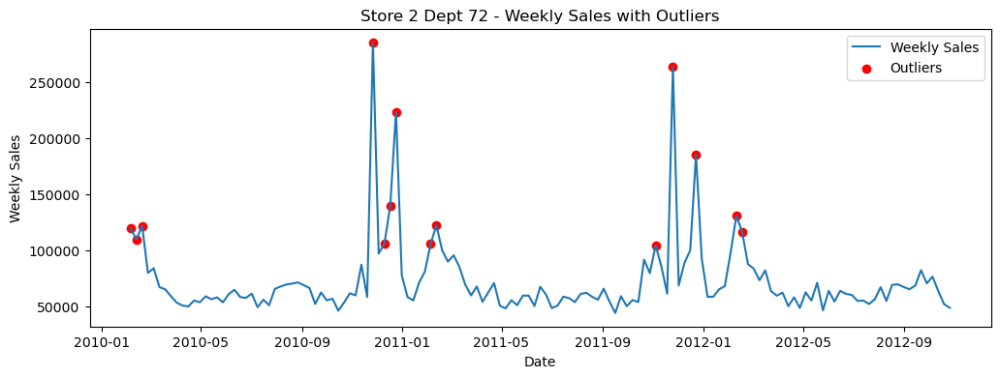

12:15:20 - cmdstanpy - INFO - Chain [1] start processing
12:15:20 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 72 - MAE: 12160.65, RMSE: 23592.75


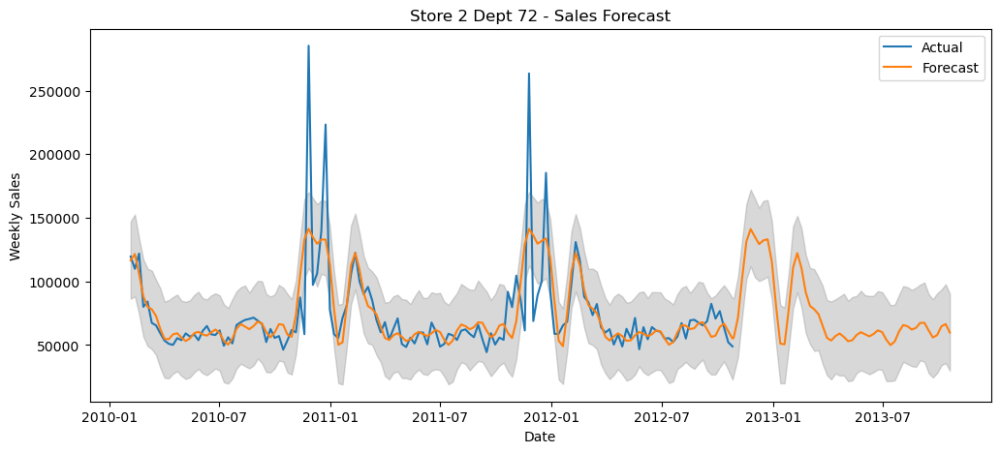

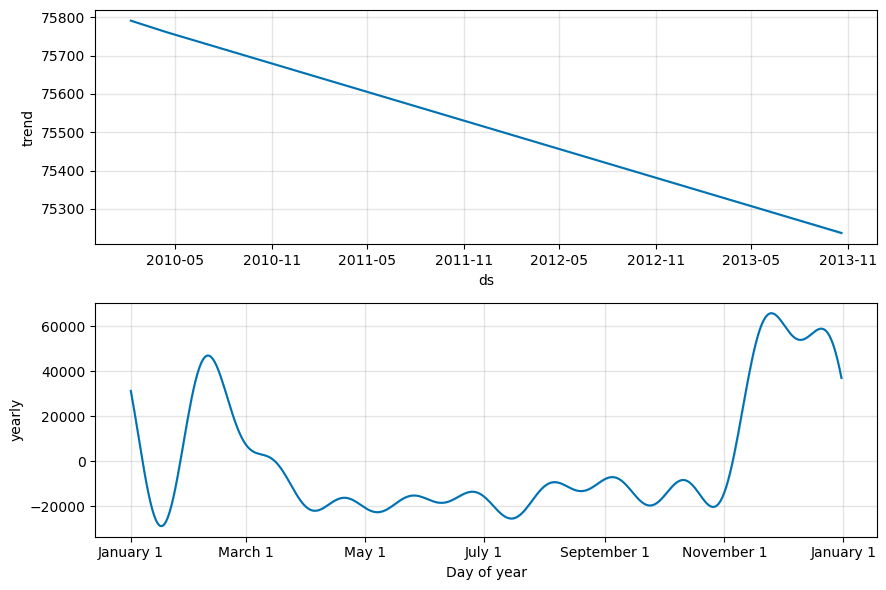


Forecasting for Store 2, Department 74


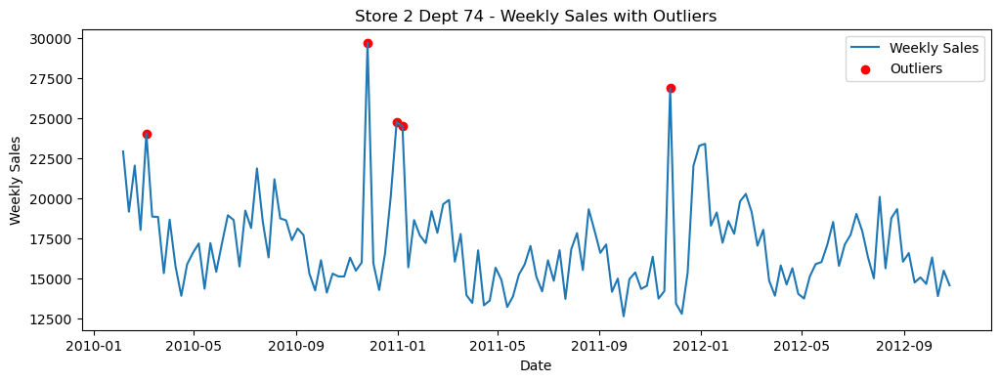

12:15:22 - cmdstanpy - INFO - Chain [1] start processing
12:15:22 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 74 - MAE: 1345.37, RMSE: 1879.58


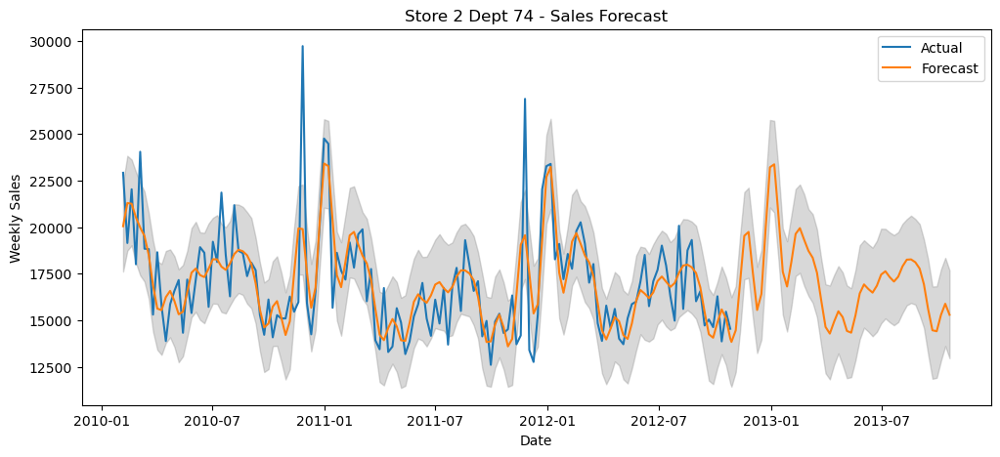

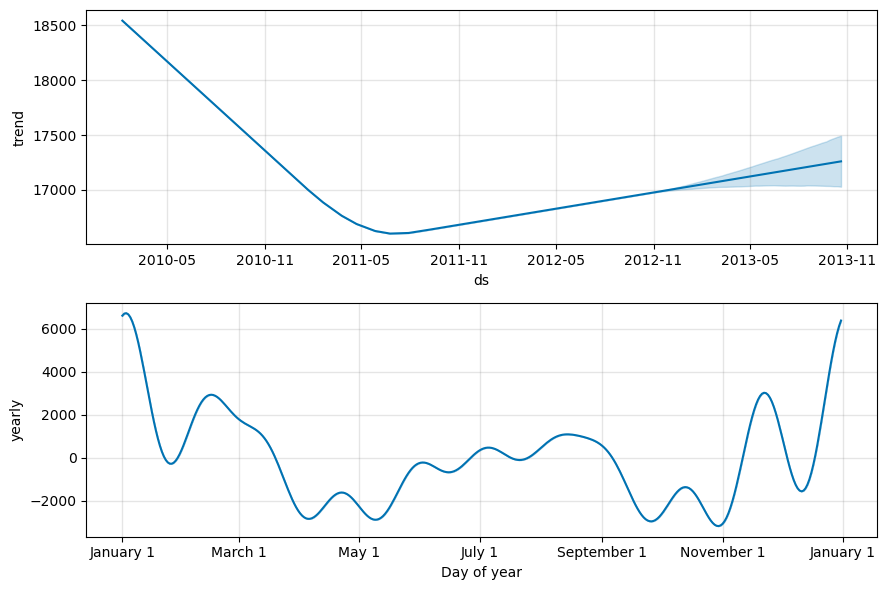


Forecasting for Store 2, Department 77


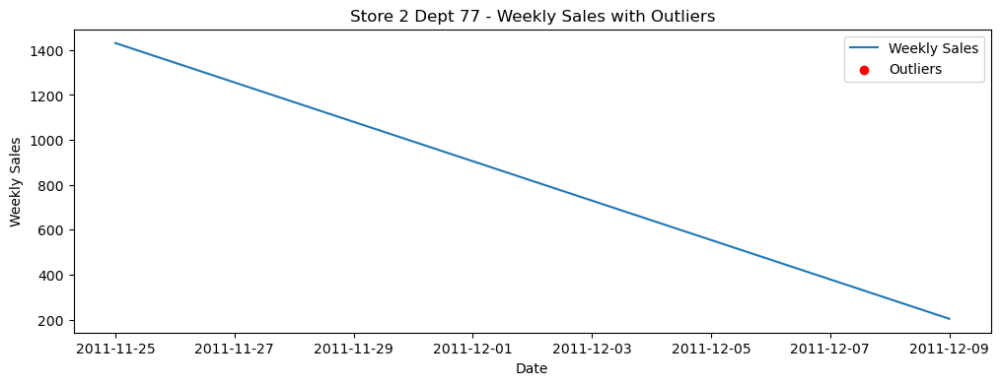

12:15:24 - cmdstanpy - INFO - Chain [1] start processing
12:15:24 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 77 - MAE: 0.01, RMSE: 0.01


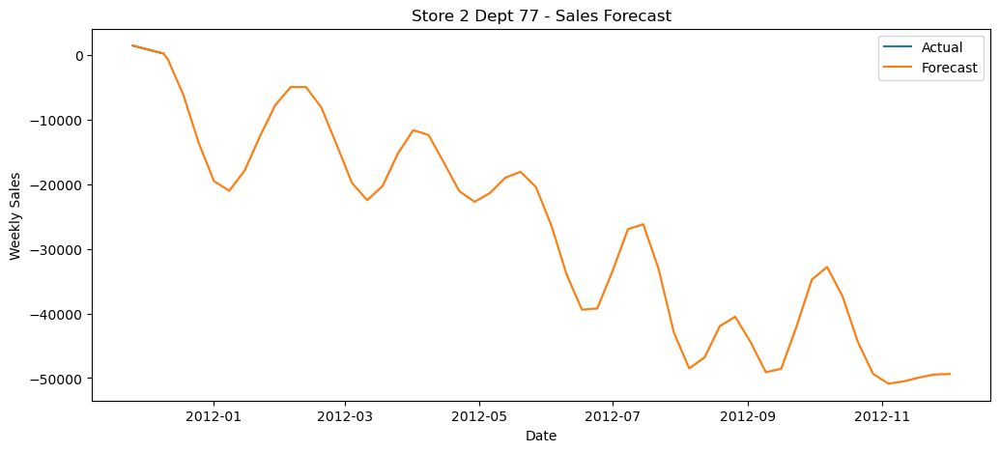

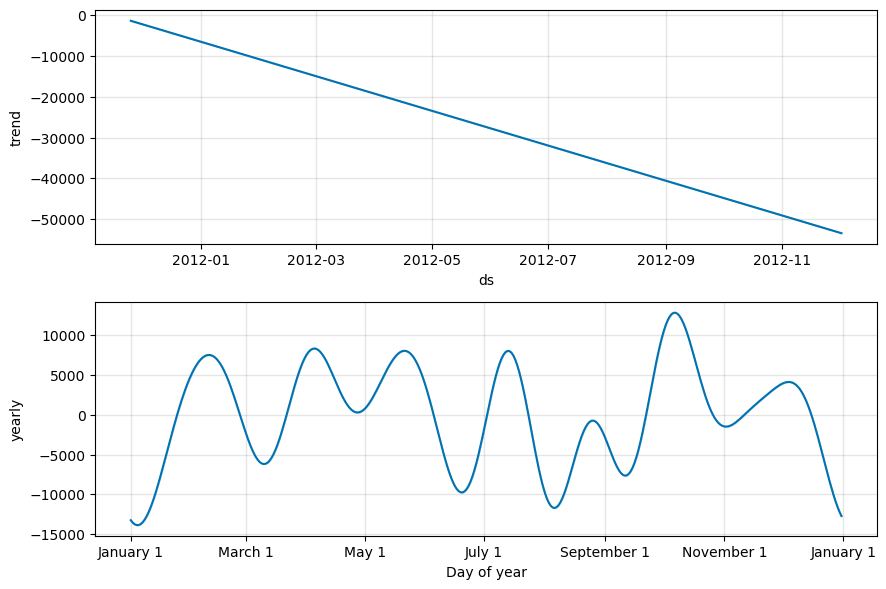


Forecasting for Store 2, Department 78


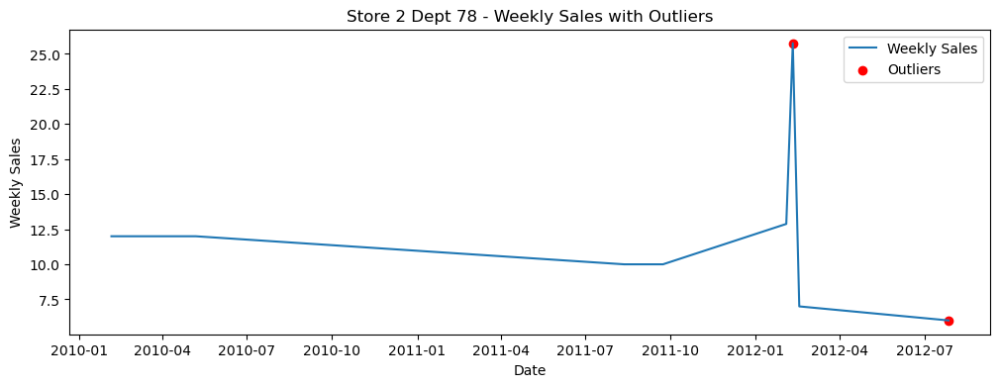

12:15:25 - cmdstanpy - INFO - Chain [1] start processing
12:15:37 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 78 - MAE: 0.00, RMSE: 0.00


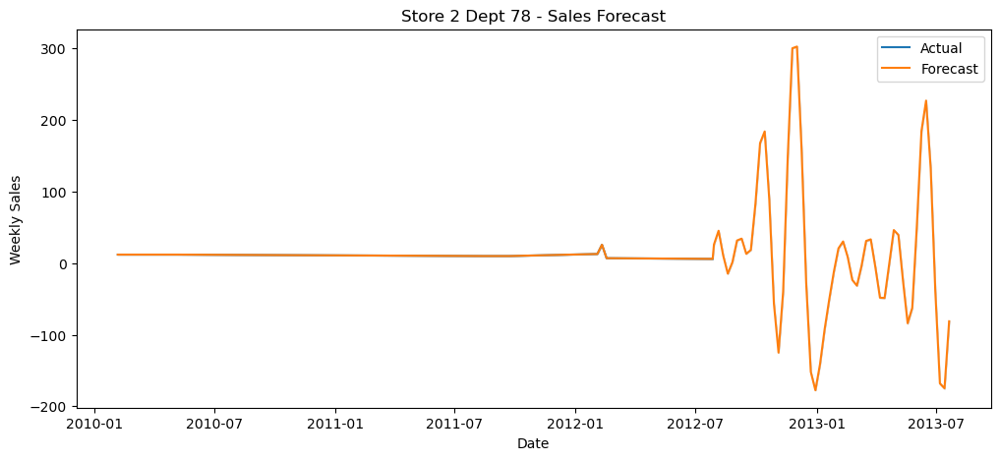

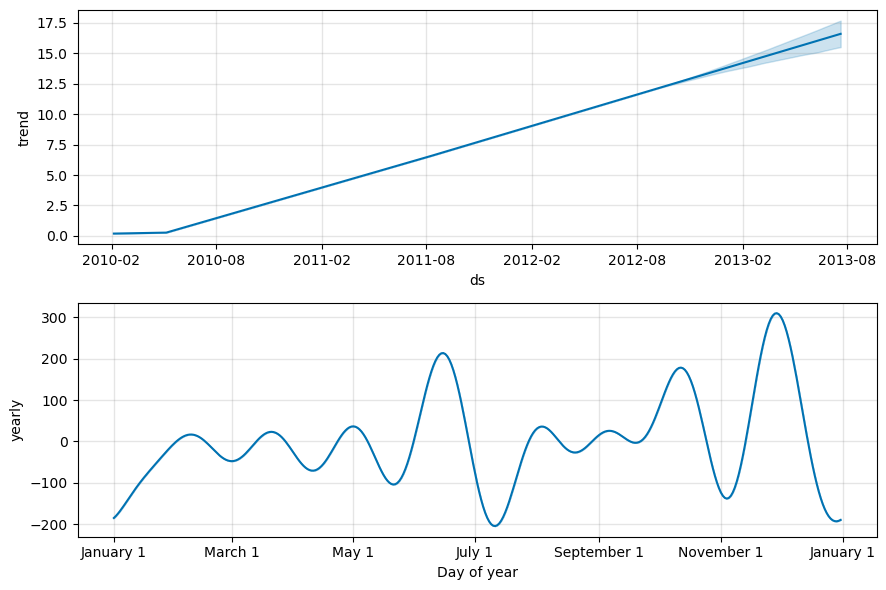


Forecasting for Store 2, Department 79


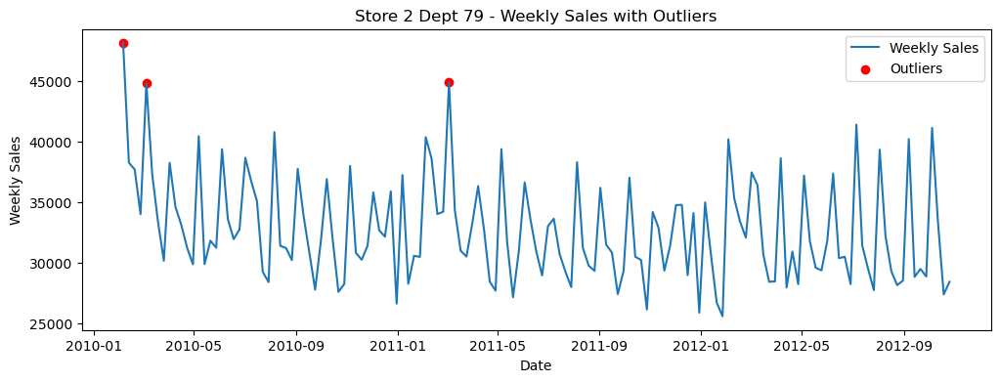

12:15:39 - cmdstanpy - INFO - Chain [1] start processing
12:15:39 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 79 - MAE: 3046.92, RMSE: 3774.53


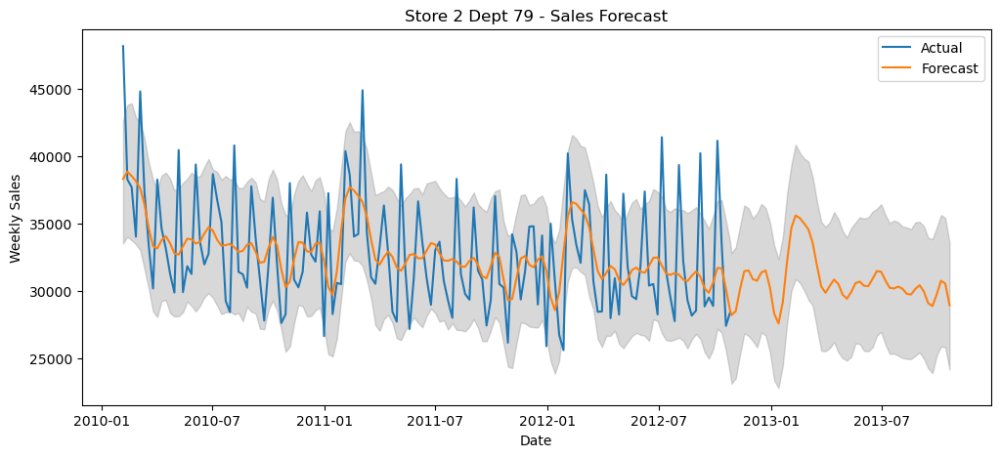

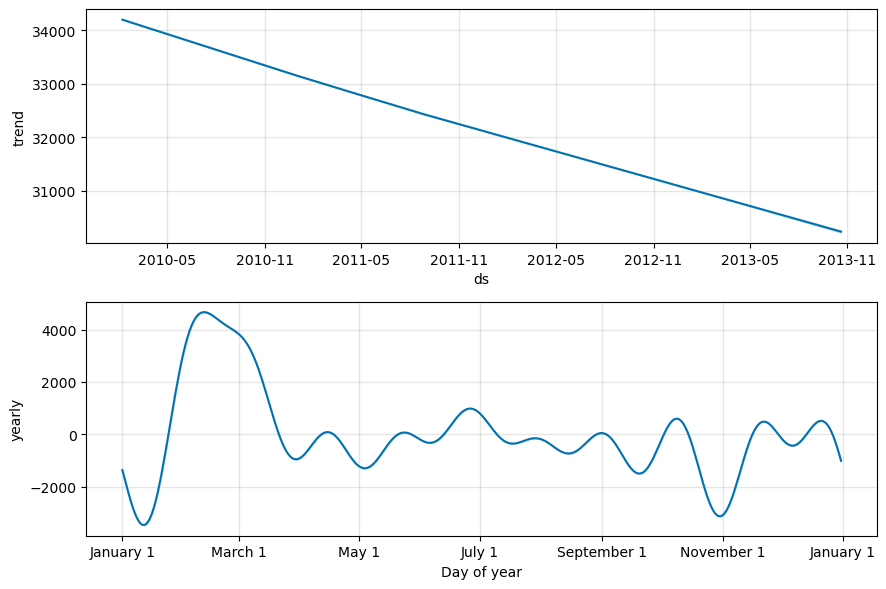


Forecasting for Store 2, Department 80


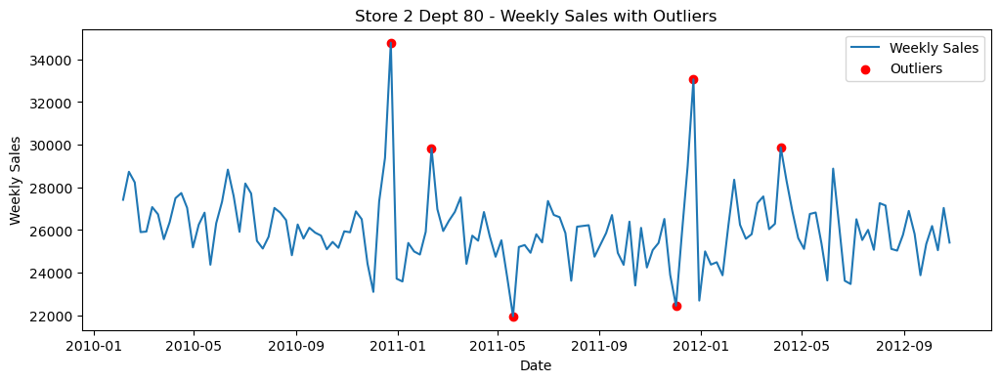

12:15:41 - cmdstanpy - INFO - Chain [1] start processing
12:15:41 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 80 - MAE: 960.44, RMSE: 1319.25


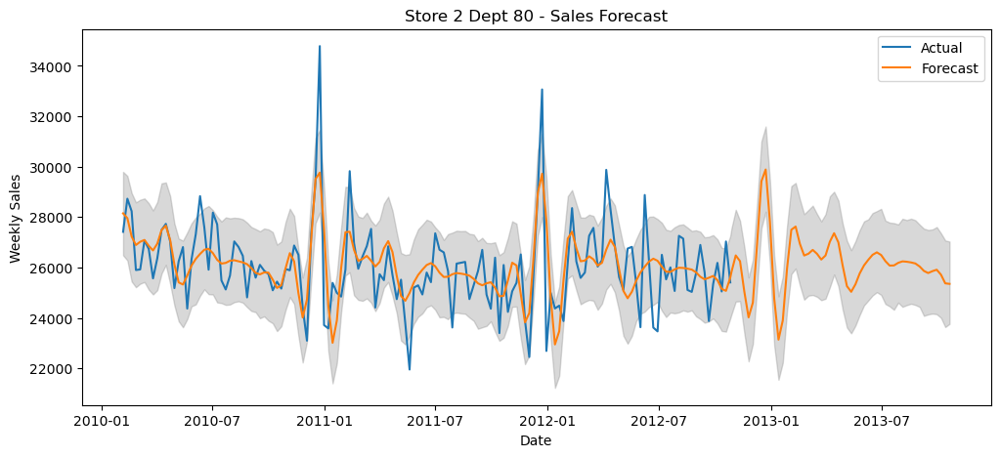

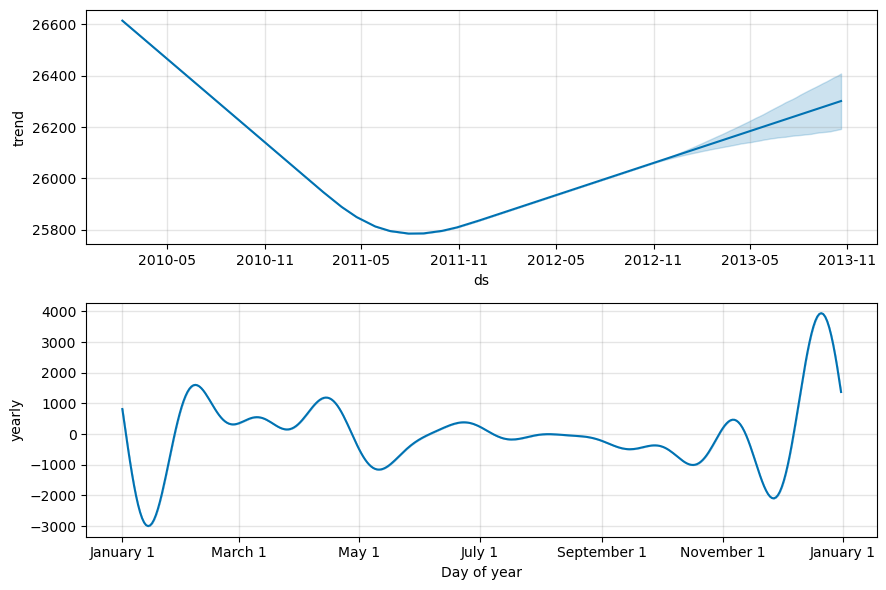


Forecasting for Store 2, Department 81


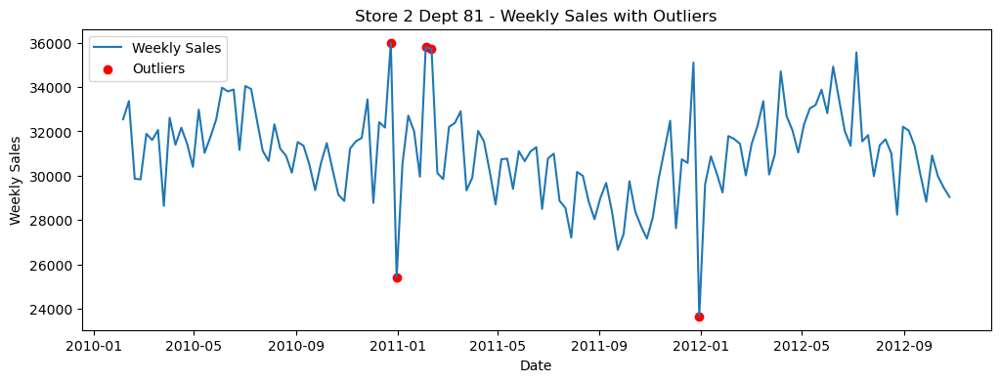

12:15:43 - cmdstanpy - INFO - Chain [1] start processing
12:15:43 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 81 - MAE: 1156.72, RMSE: 1562.78


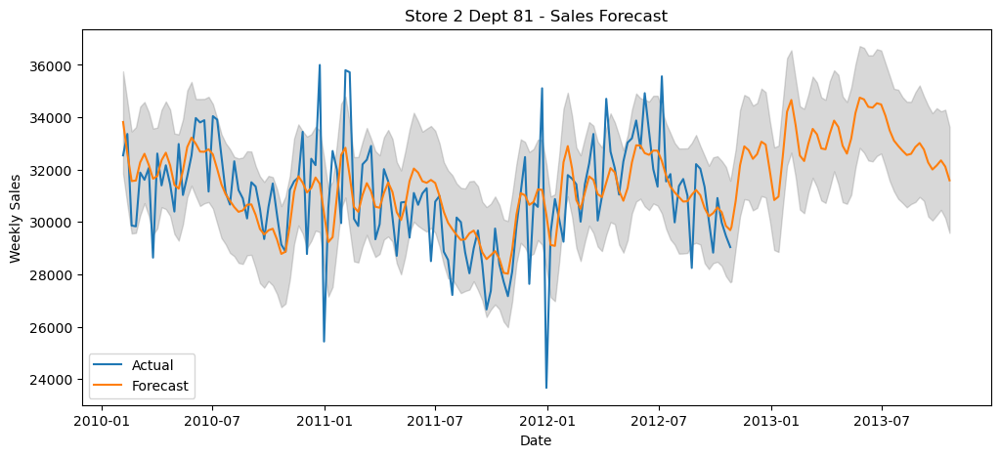

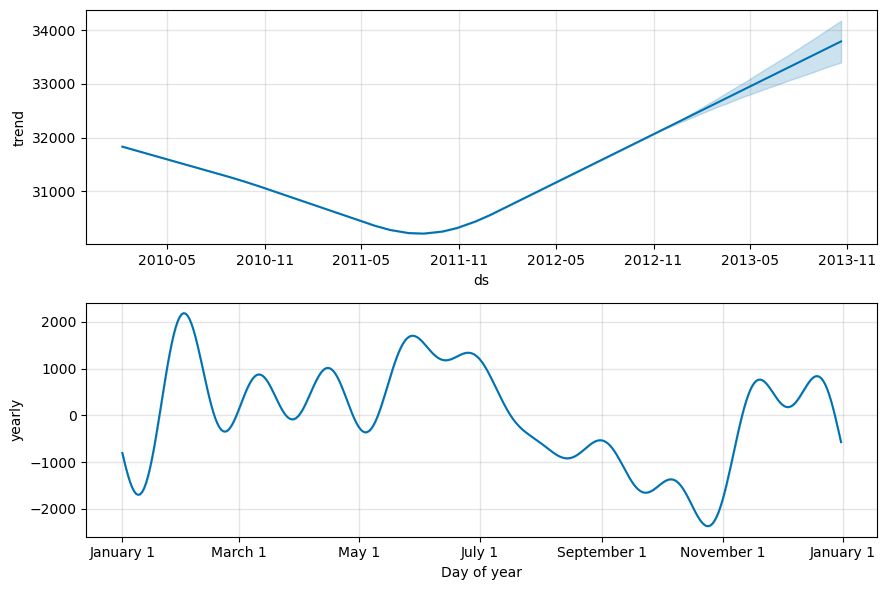


Forecasting for Store 2, Department 82


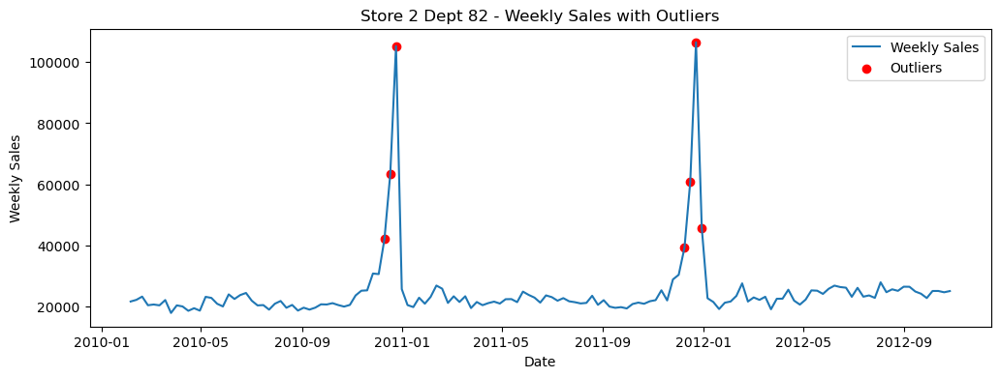

12:15:45 - cmdstanpy - INFO - Chain [1] start processing
12:15:45 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 82 - MAE: 2836.90, RMSE: 5567.56


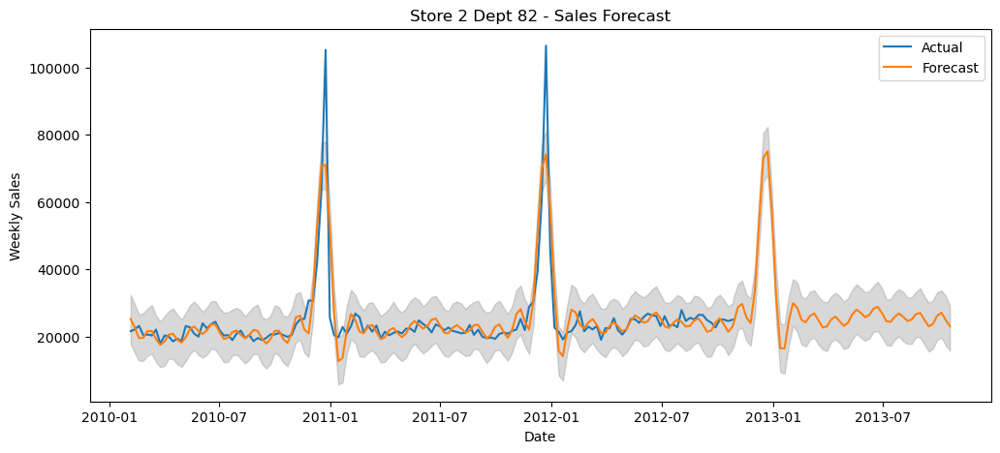

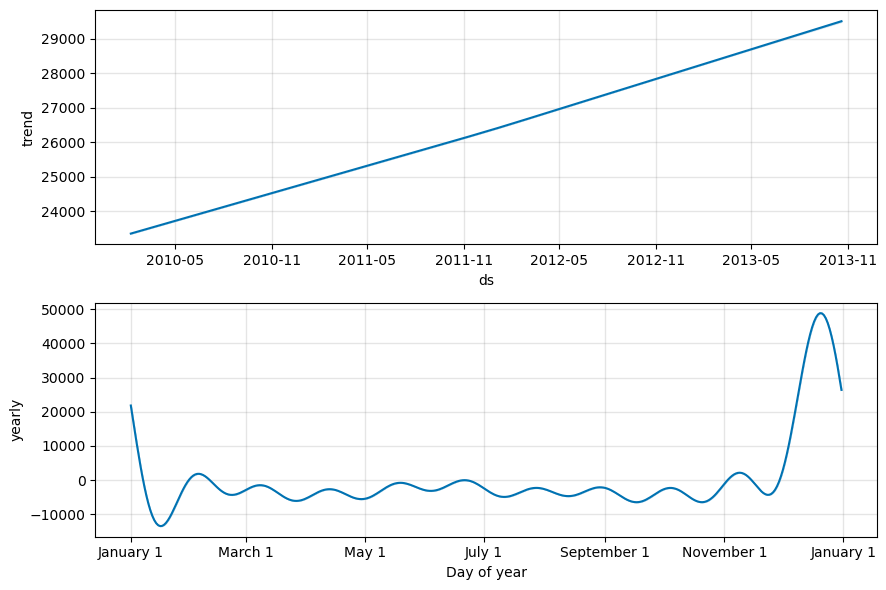


Forecasting for Store 2, Department 83


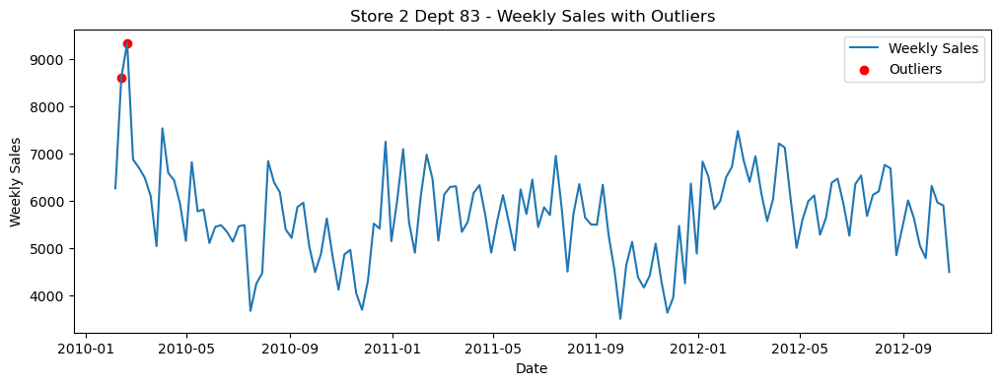

12:15:47 - cmdstanpy - INFO - Chain [1] start processing
12:15:47 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 83 - MAE: 501.07, RMSE: 648.83


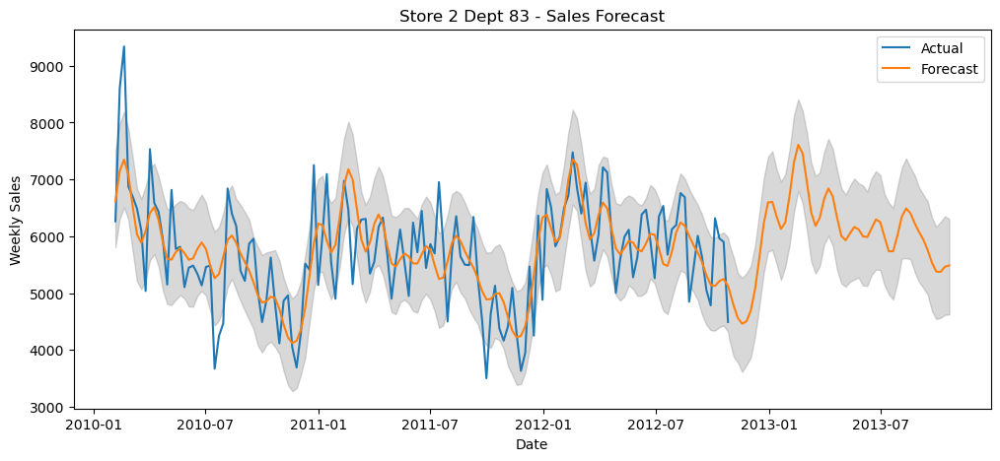

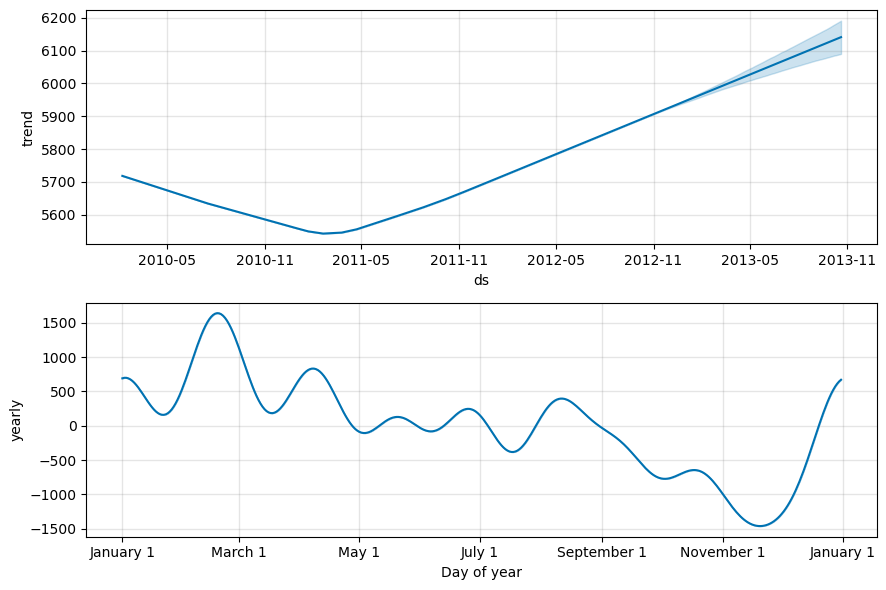


Forecasting for Store 2, Department 85


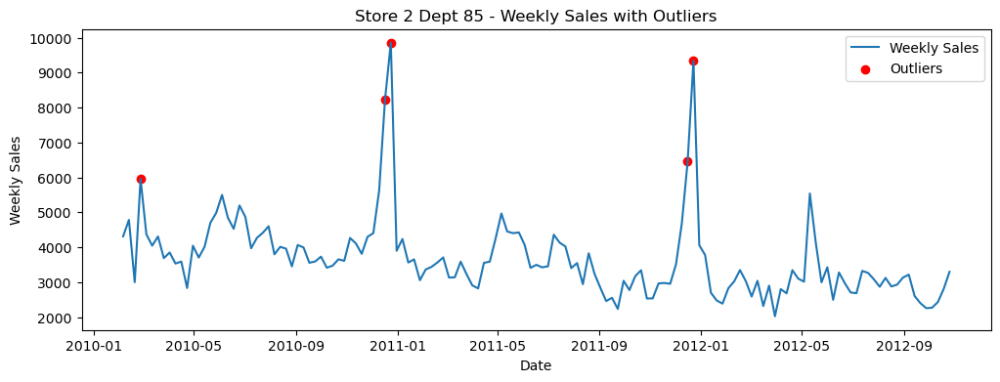

12:15:48 - cmdstanpy - INFO - Chain [1] start processing
12:15:48 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 85 - MAE: 401.37, RMSE: 576.80


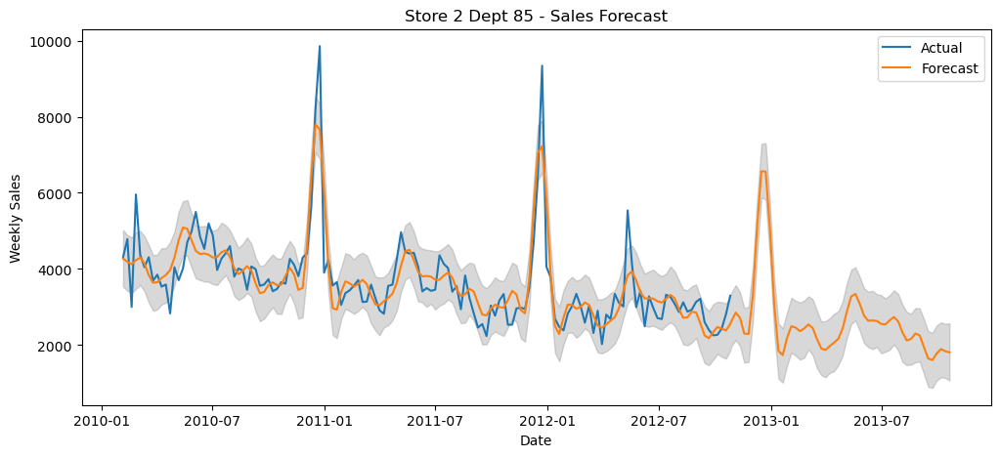

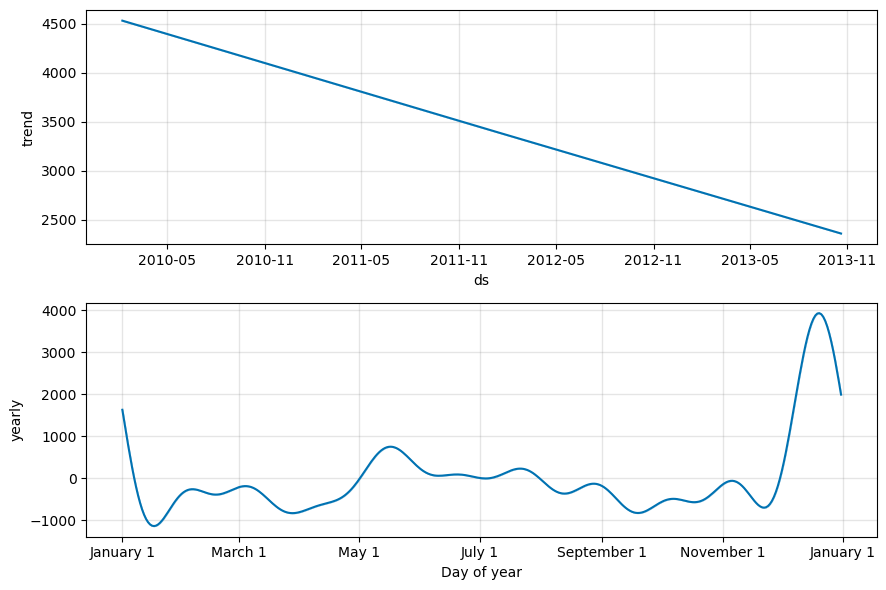


Forecasting for Store 2, Department 87


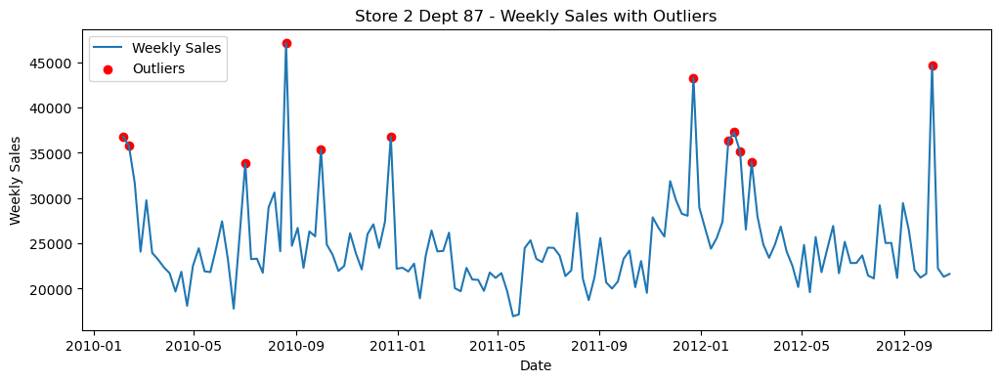

12:15:50 - cmdstanpy - INFO - Chain [1] start processing
12:15:50 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 87 - MAE: 2870.44, RMSE: 3971.18


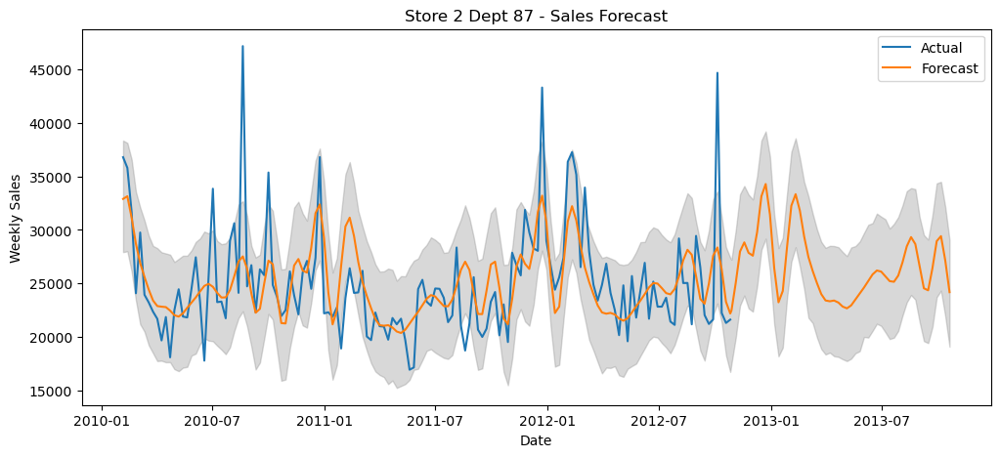

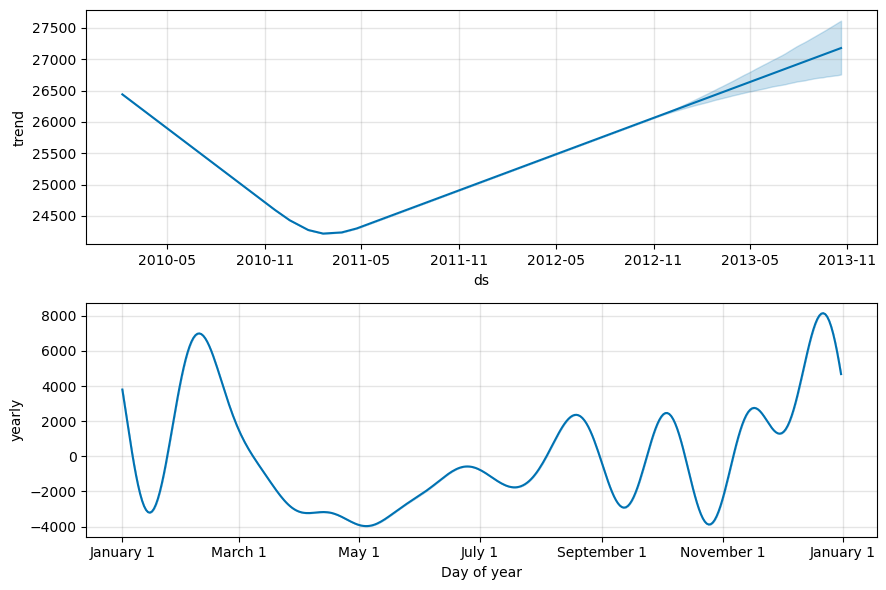


Forecasting for Store 2, Department 90


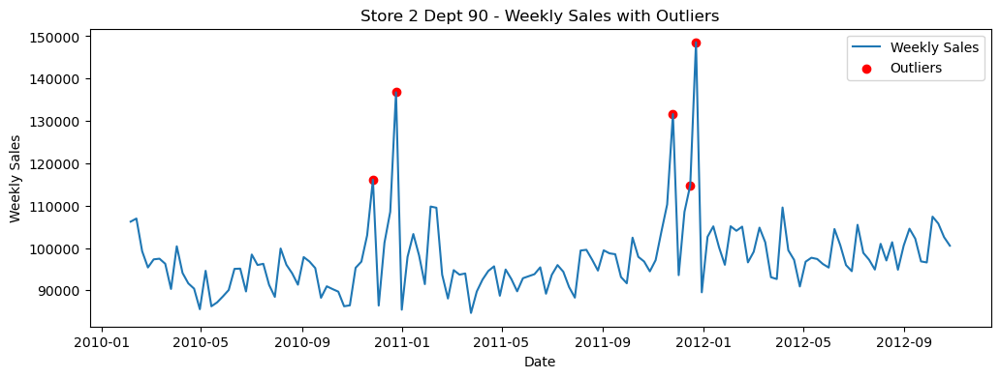

12:15:52 - cmdstanpy - INFO - Chain [1] start processing
12:15:52 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 90 - MAE: 4159.46, RMSE: 6320.21


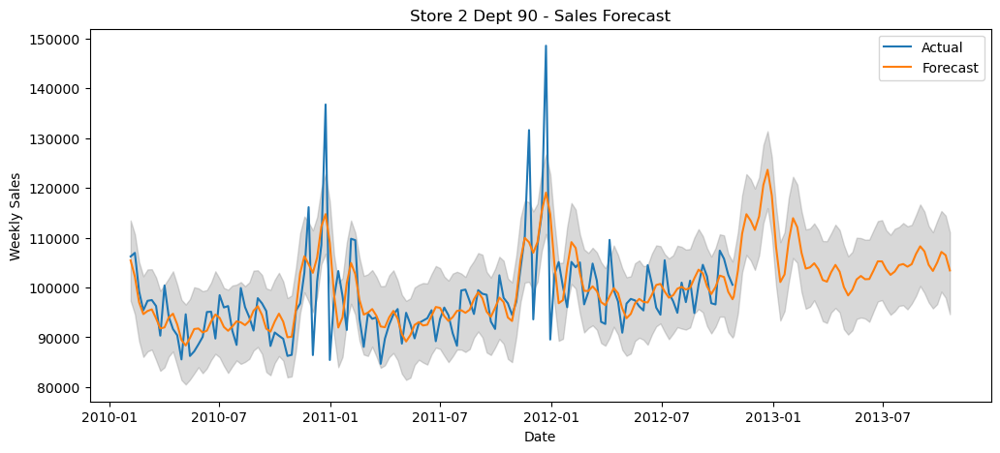

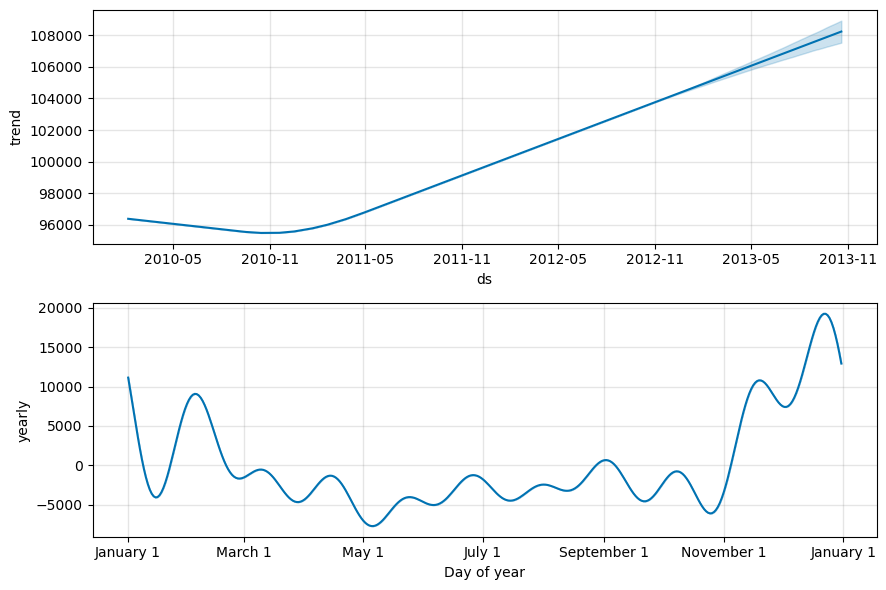


Forecasting for Store 2, Department 91


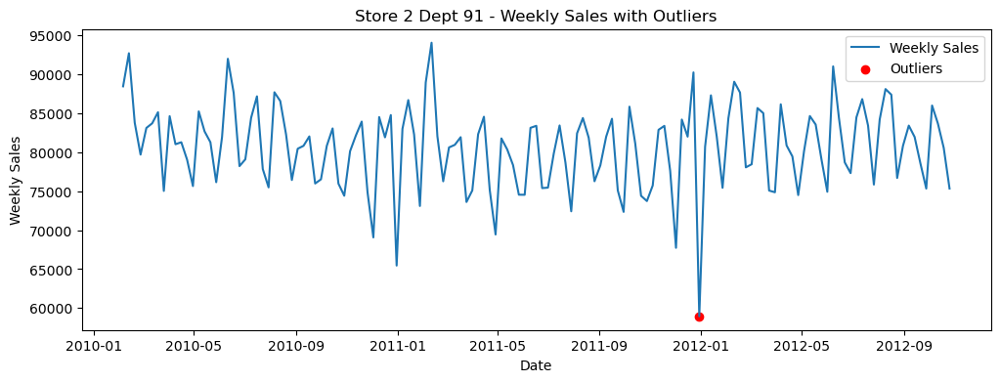

12:15:54 - cmdstanpy - INFO - Chain [1] start processing
12:15:54 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 91 - MAE: 3939.67, RMSE: 4876.79


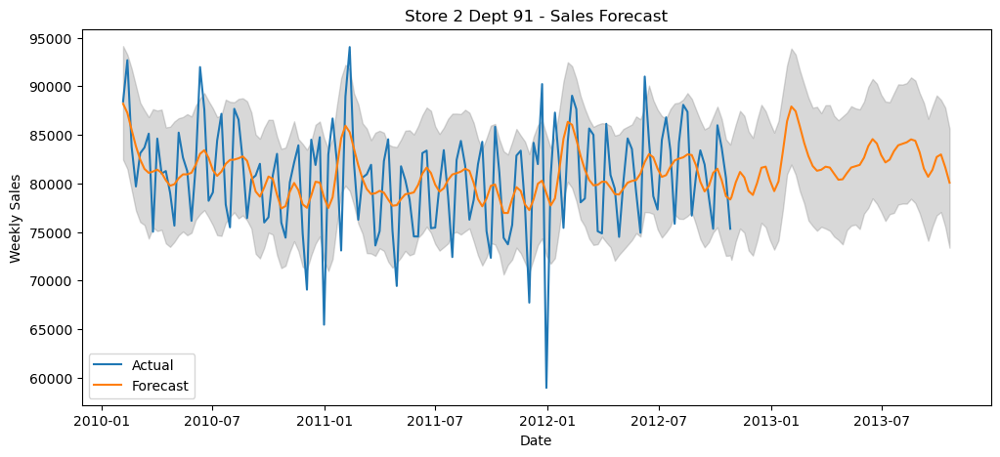

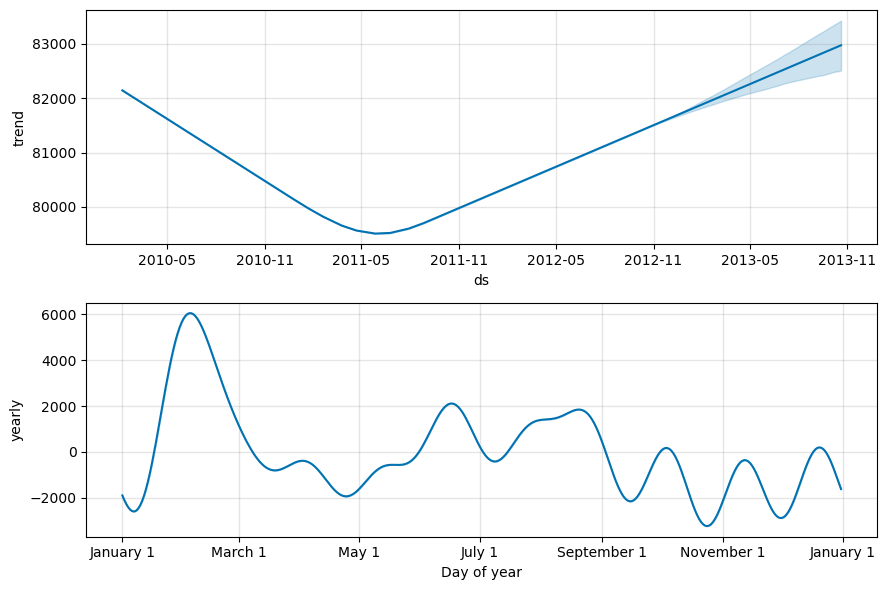


Forecasting for Store 2, Department 92


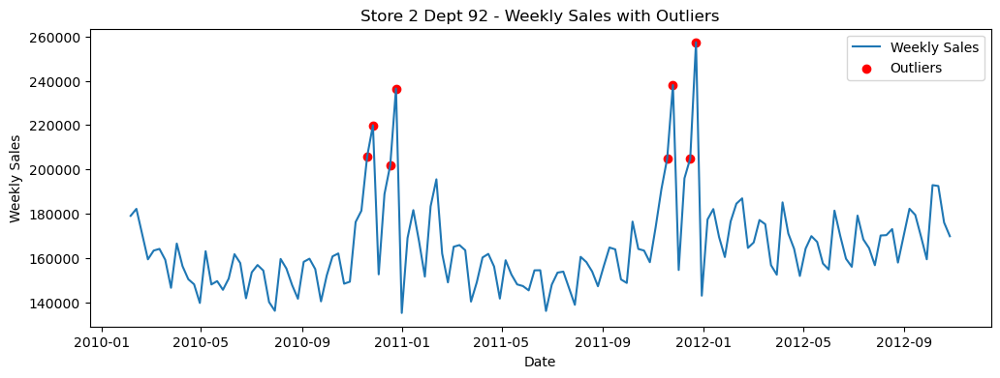

12:15:56 - cmdstanpy - INFO - Chain [1] start processing
12:15:56 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 92 - MAE: 8887.75, RMSE: 13042.48


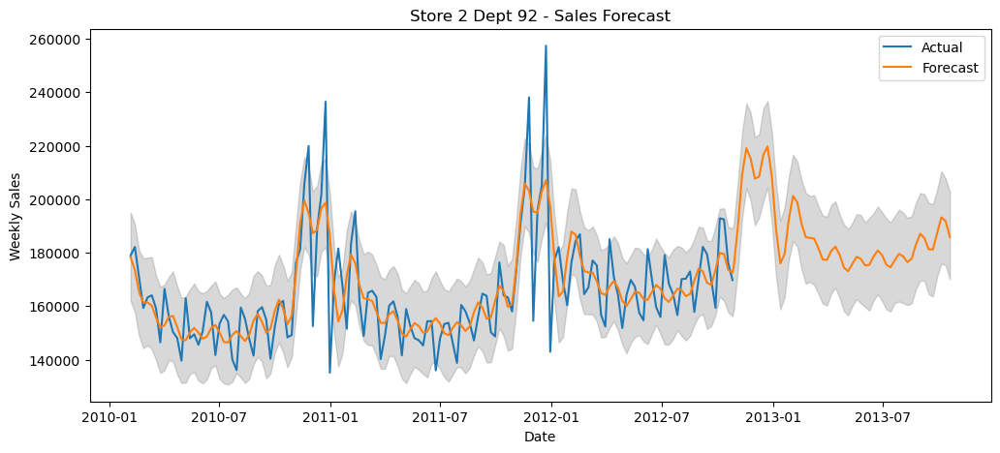

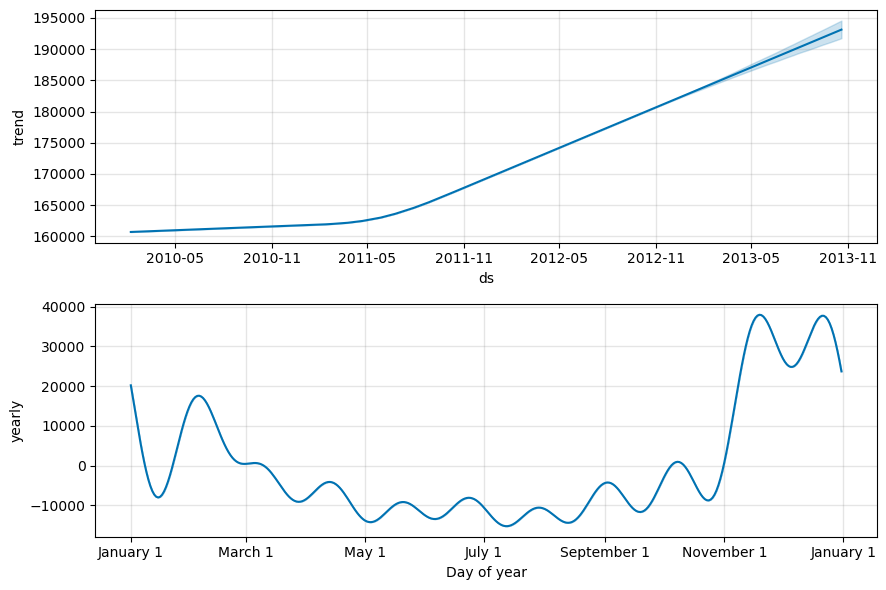


Forecasting for Store 2, Department 93


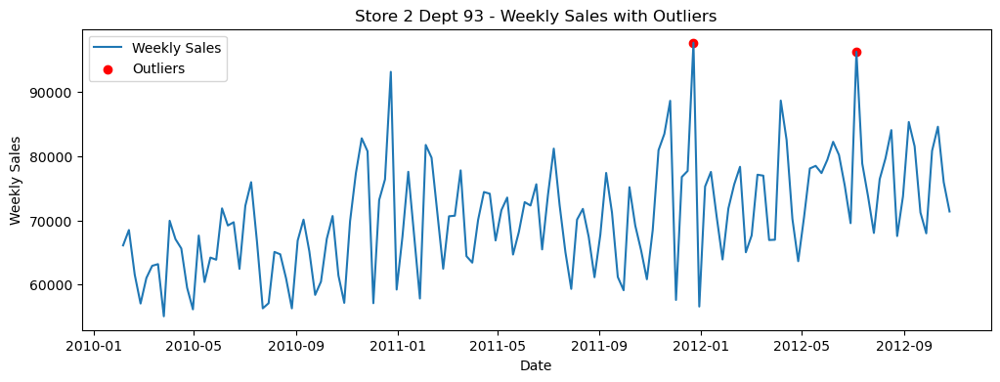

12:15:58 - cmdstanpy - INFO - Chain [1] start processing
12:15:58 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 93 - MAE: 4987.12, RMSE: 6434.29


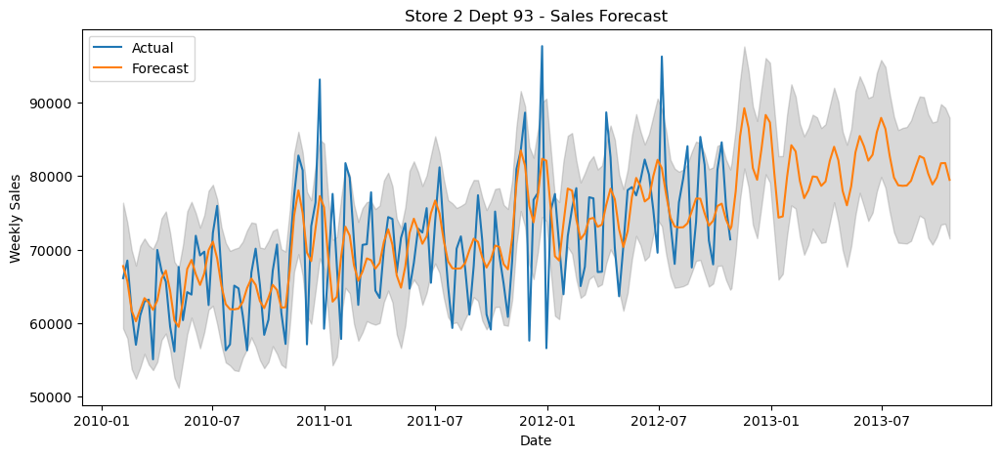

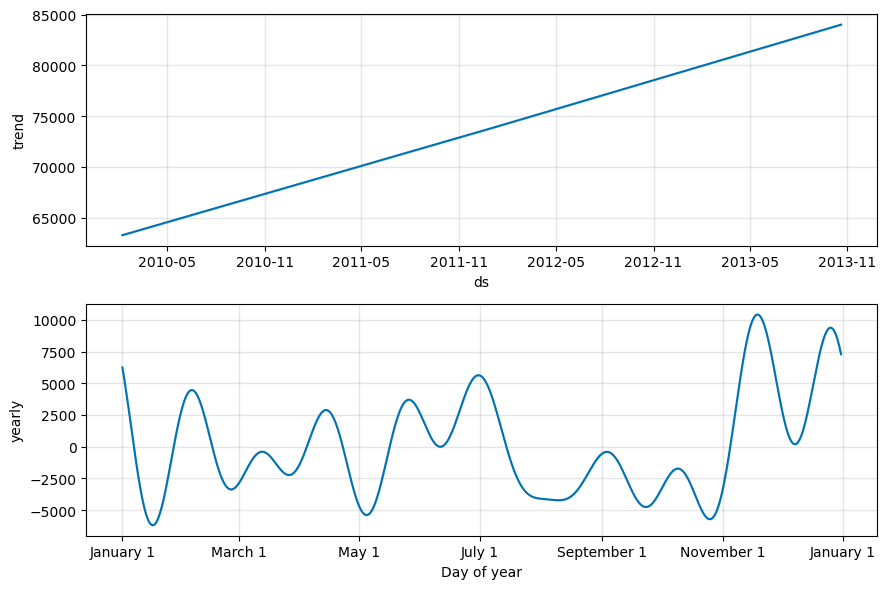


Forecasting for Store 2, Department 94


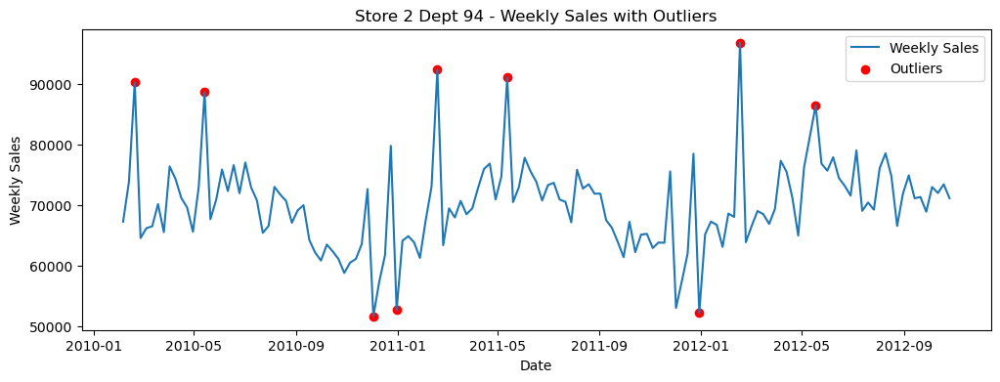

12:16:00 - cmdstanpy - INFO - Chain [1] start processing
12:16:00 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 94 - MAE: 3728.03, RMSE: 5206.86


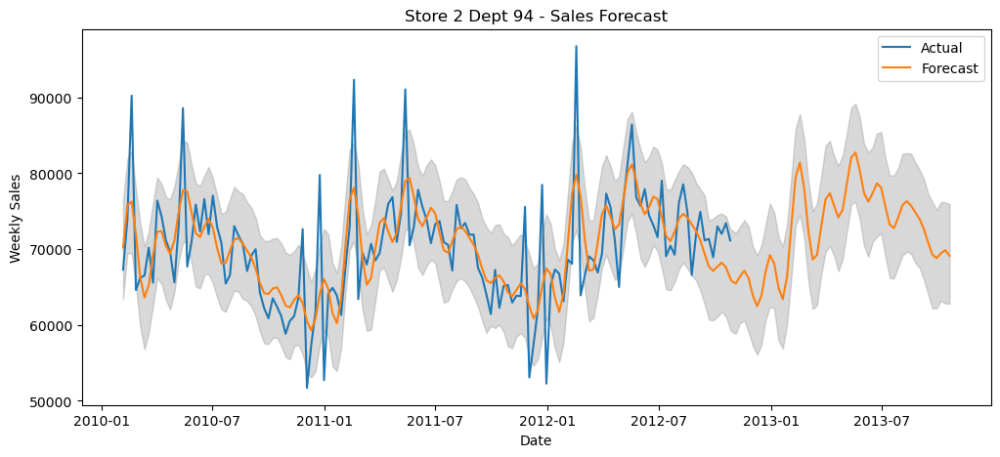

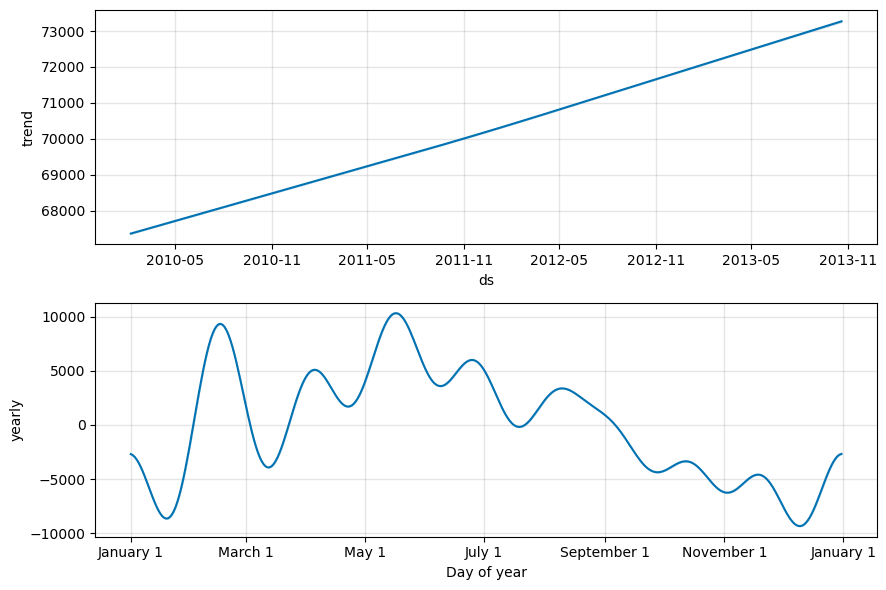


Forecasting for Store 2, Department 95


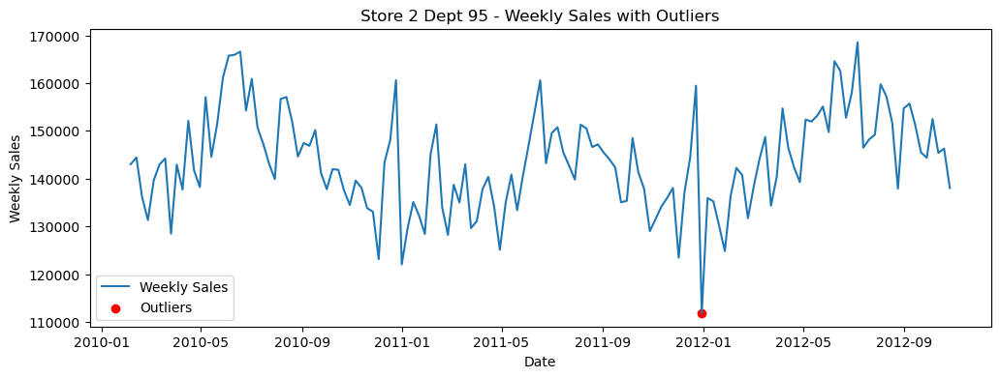

12:16:02 - cmdstanpy - INFO - Chain [1] start processing
12:16:02 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 95 - MAE: 4609.01, RMSE: 6314.64


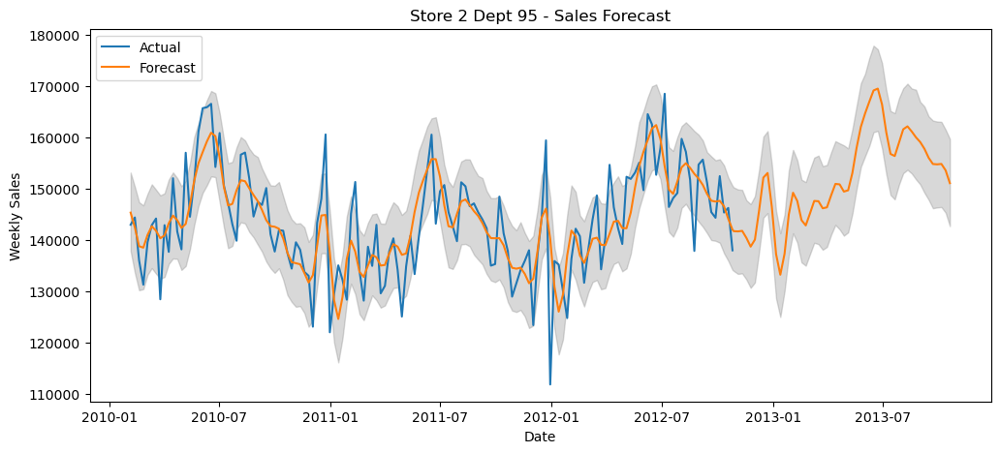

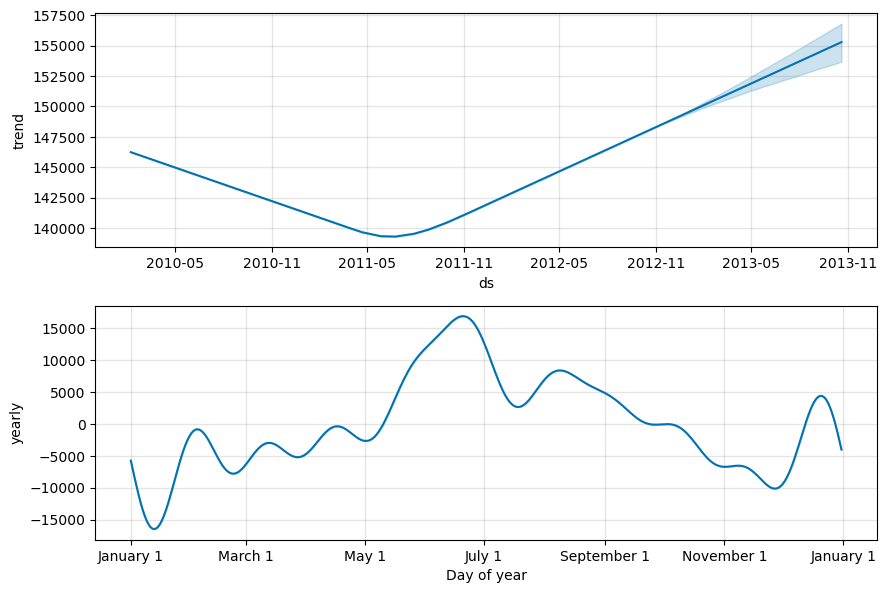


Forecasting for Store 2, Department 96


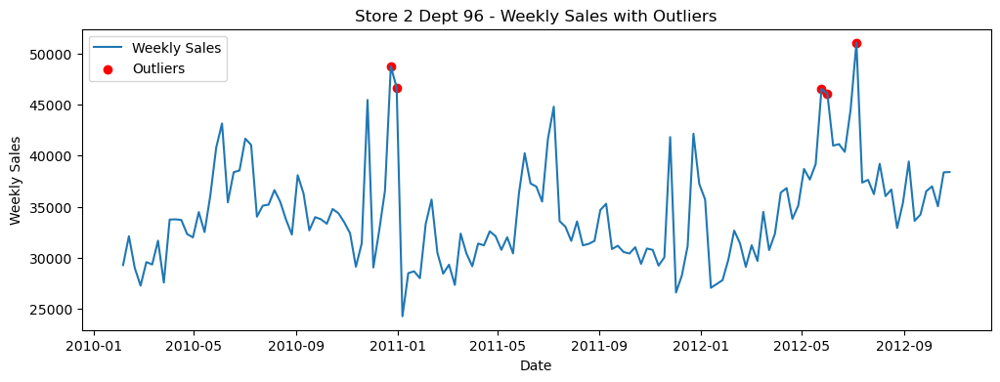

12:16:04 - cmdstanpy - INFO - Chain [1] start processing
12:16:04 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 96 - MAE: 2038.25, RMSE: 2809.63


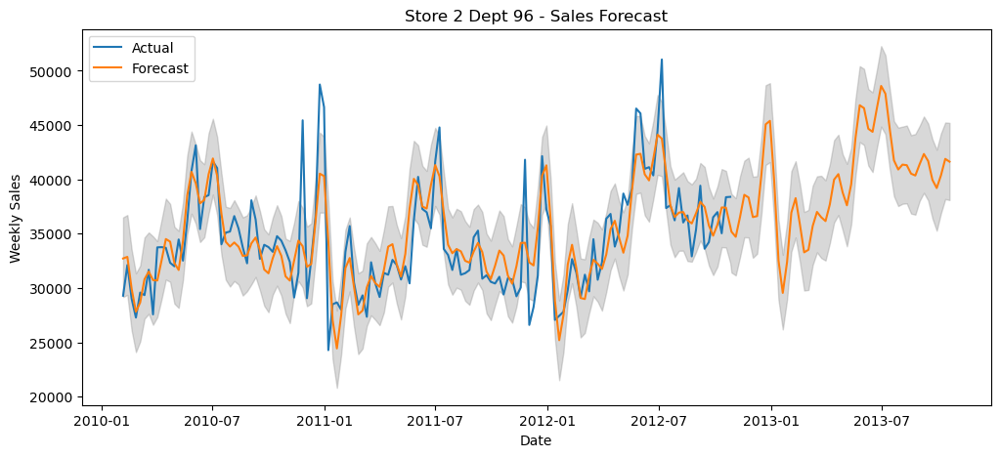

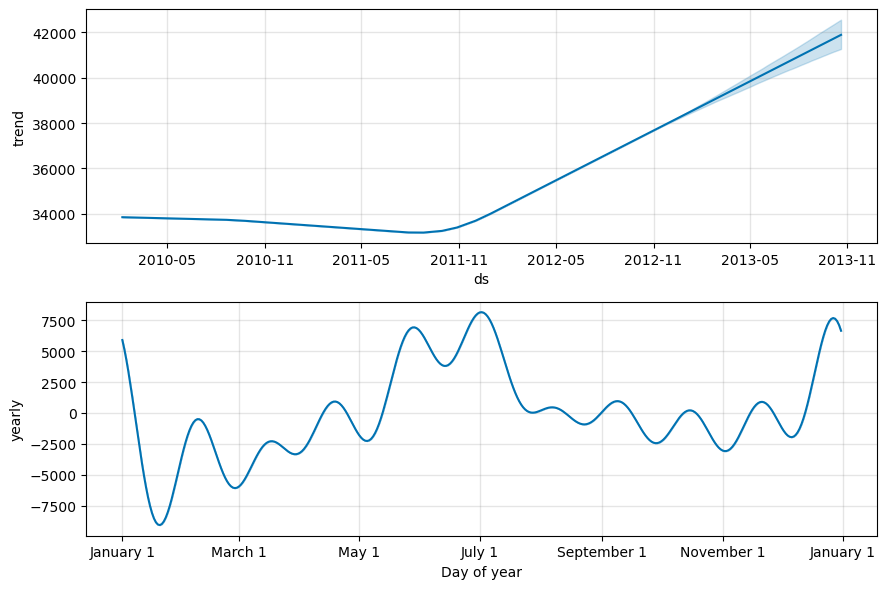


Forecasting for Store 2, Department 97


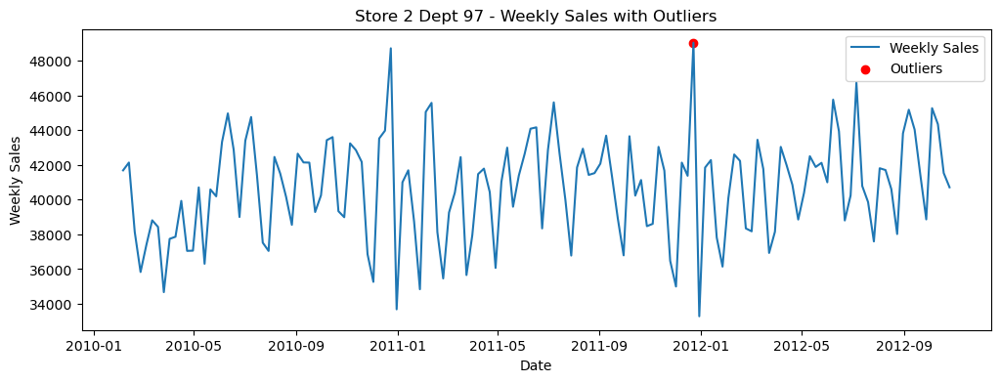

12:16:06 - cmdstanpy - INFO - Chain [1] start processing
12:16:06 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 97 - MAE: 2006.27, RMSE: 2509.51


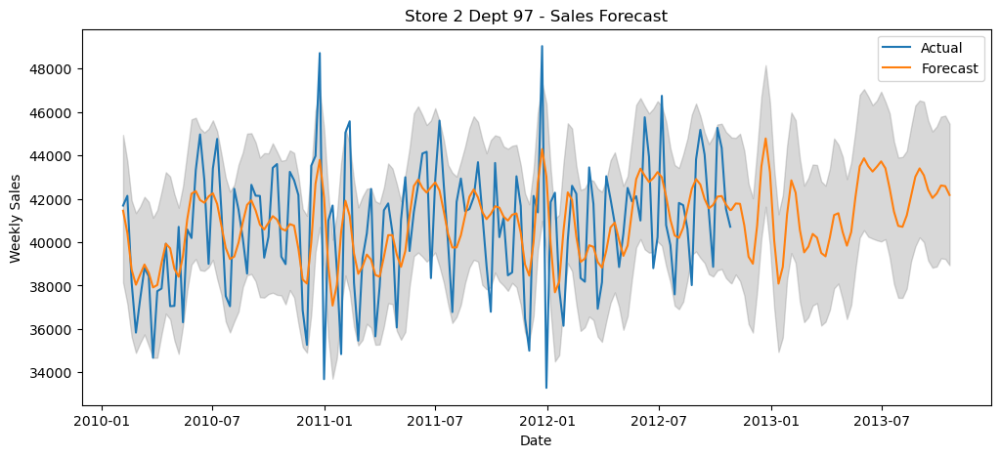

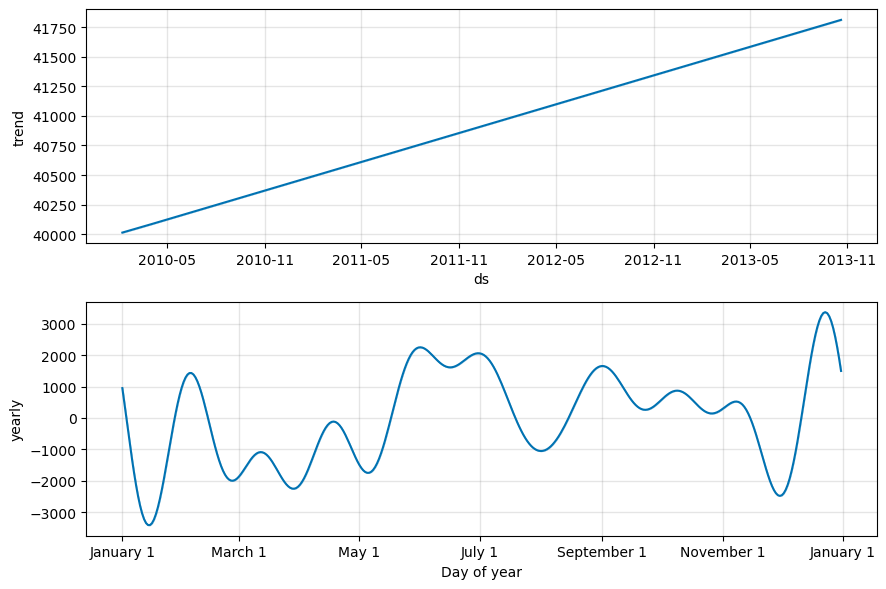


Forecasting for Store 2, Department 98


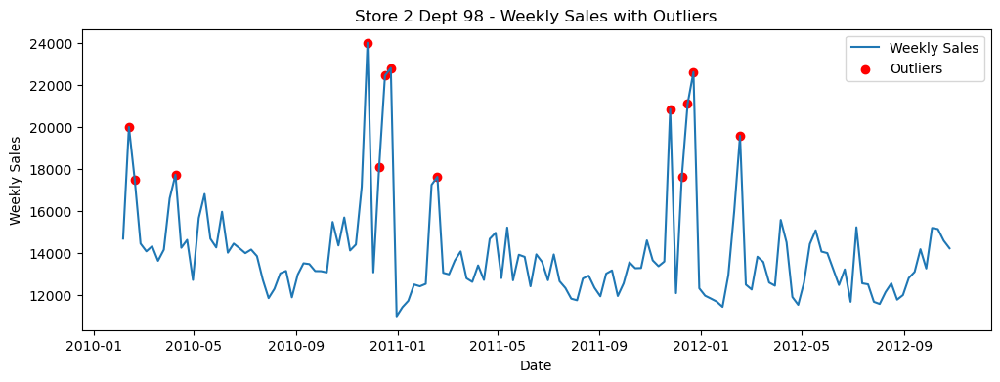

12:16:08 - cmdstanpy - INFO - Chain [1] start processing
12:16:08 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 98 - MAE: 1100.02, RMSE: 1579.25


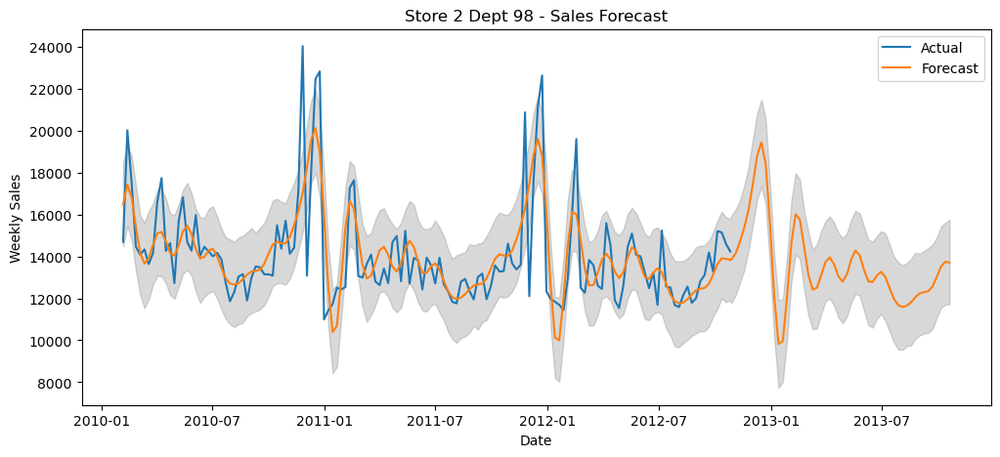

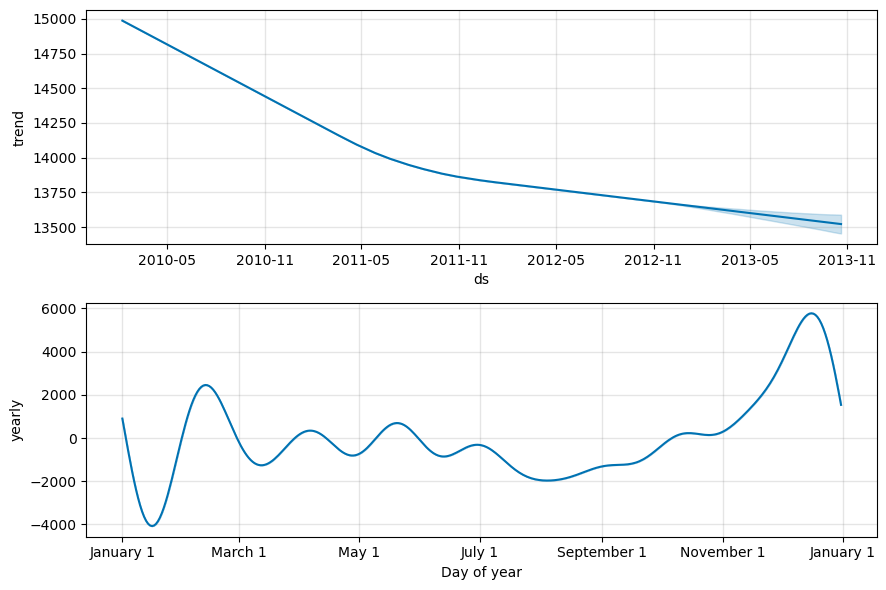


Forecasting for Store 2, Department 99


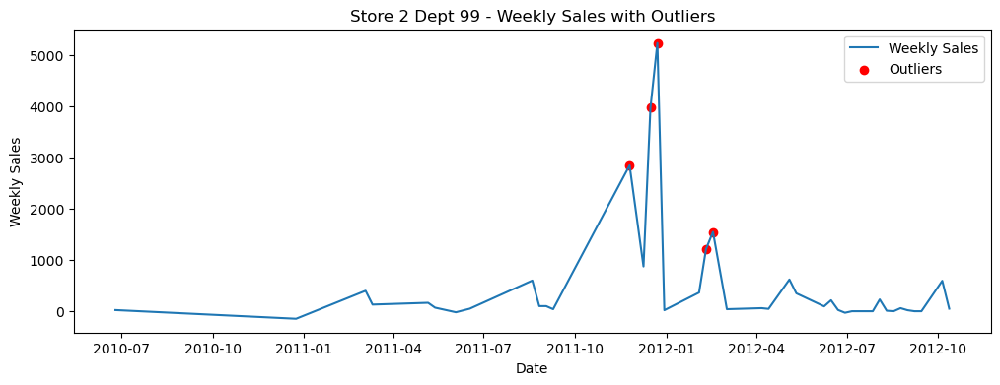

12:16:09 - cmdstanpy - INFO - Chain [1] start processing
12:16:10 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 99 - MAE: 305.35, RMSE: 567.05


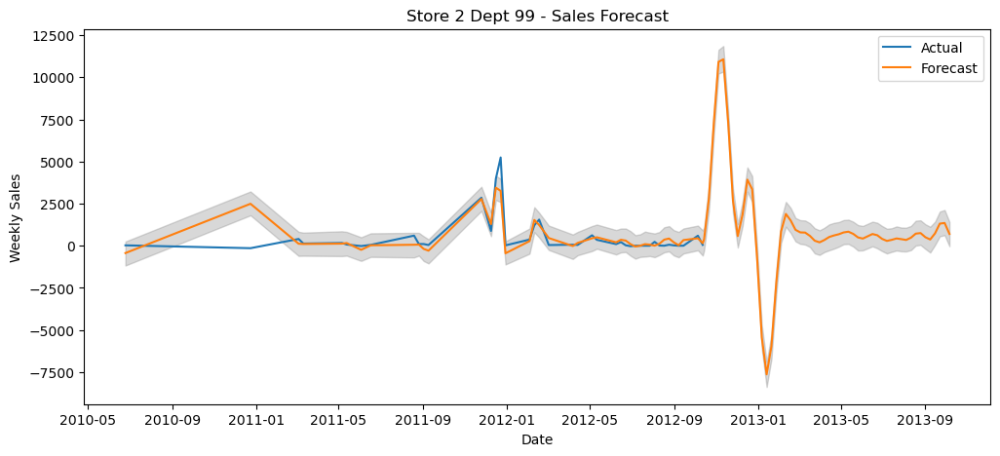

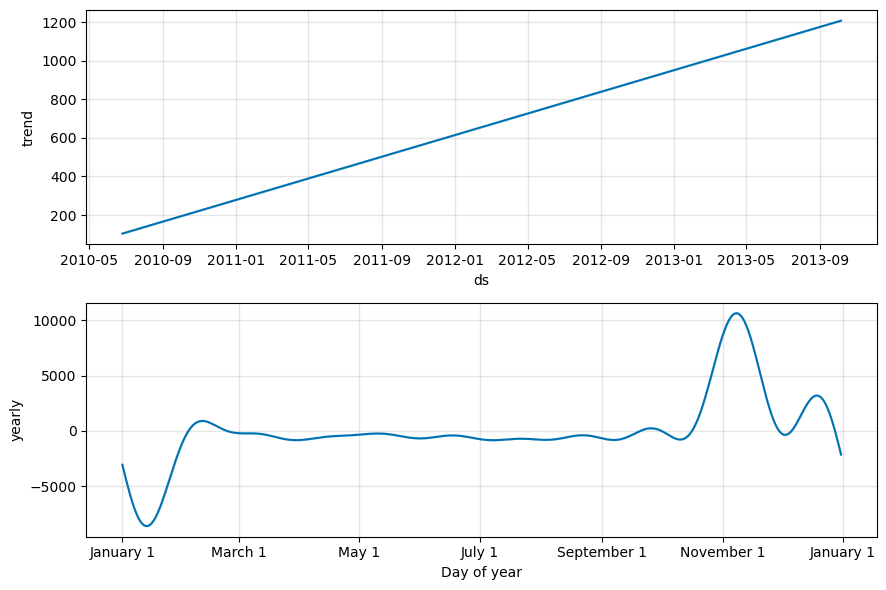


Forecasting for Store 2, Department 39


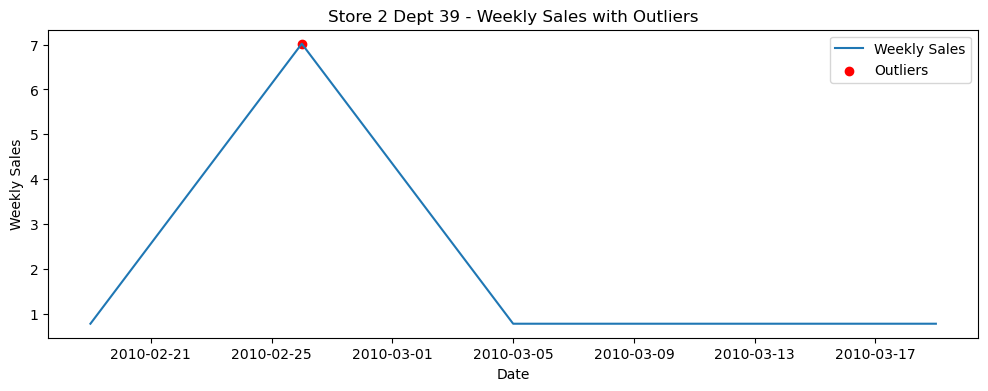

12:35:30 - cmdstanpy - INFO - Chain [1] start processing
12:35:31 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\ashis\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Store 2 Dept 39 - MAE: 0.00, RMSE: 0.00


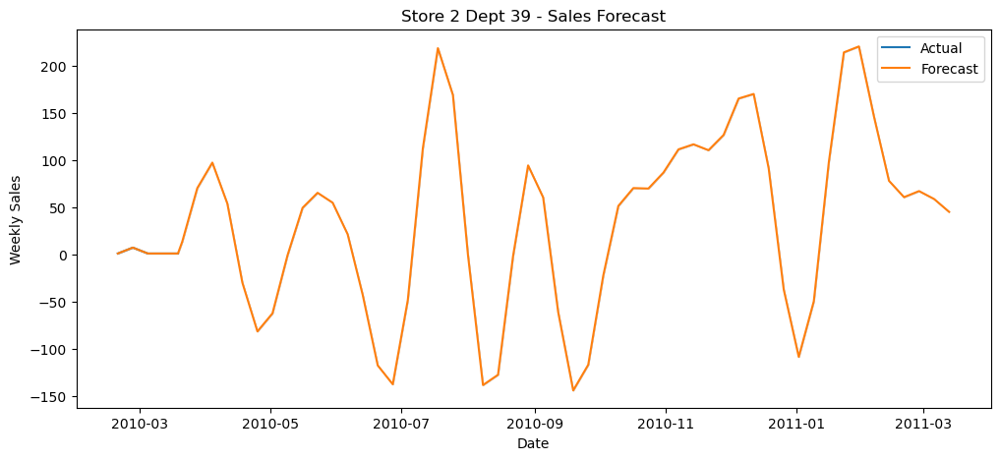

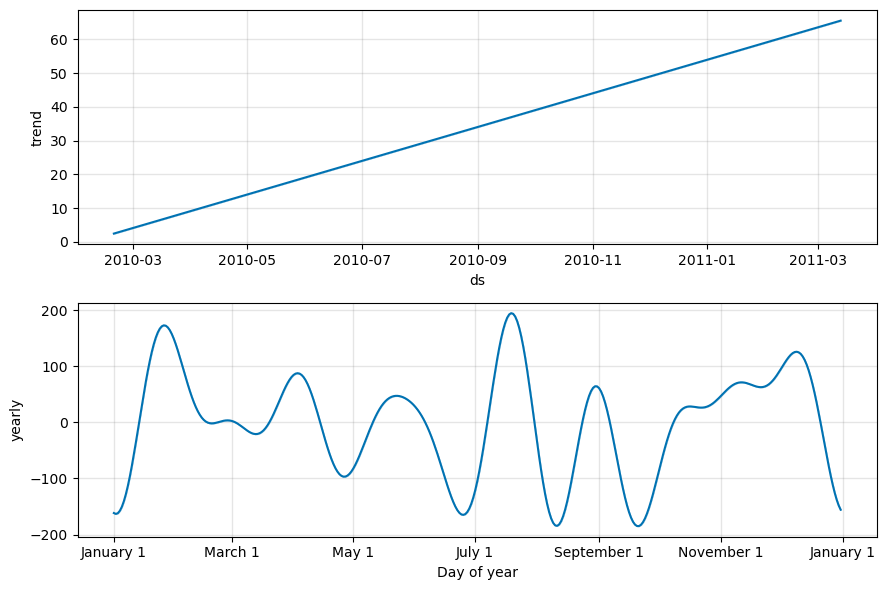


Forecasting for Store 2, Department 50


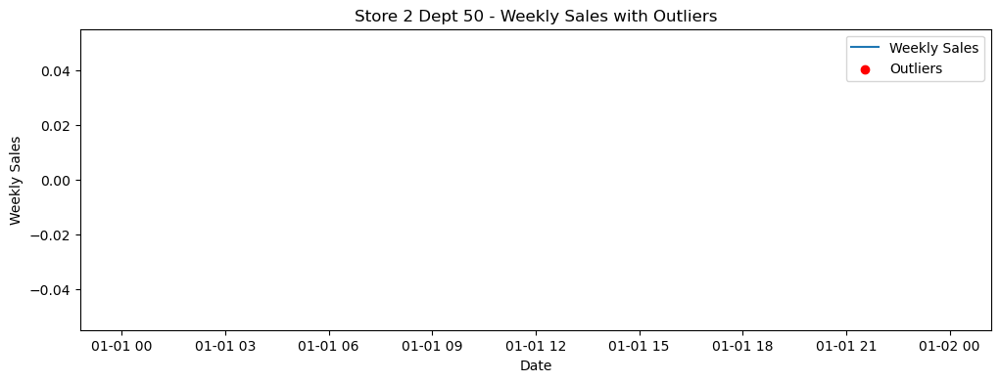

Failed for Store 2, Dept 50 due to: Dataframe has less than 2 non-NaN rows.

Forecasting for Store 2, Department 43


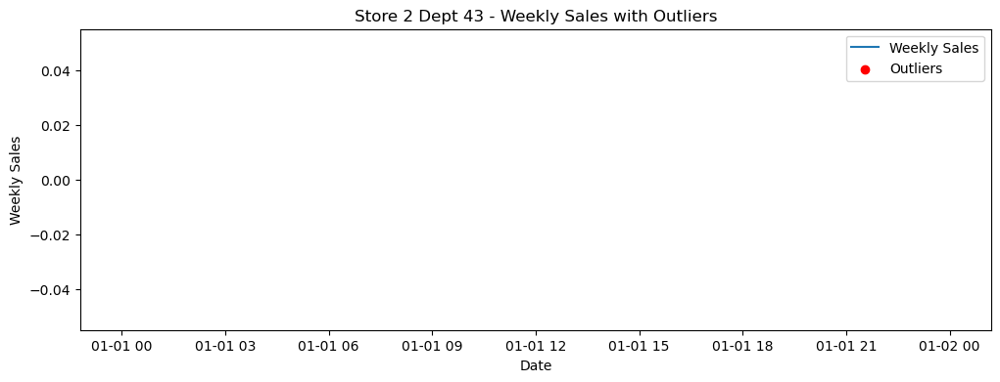

Failed for Store 2, Dept 43 due to: Dataframe has less than 2 non-NaN rows.

Forecasting for Store 2, Department 65


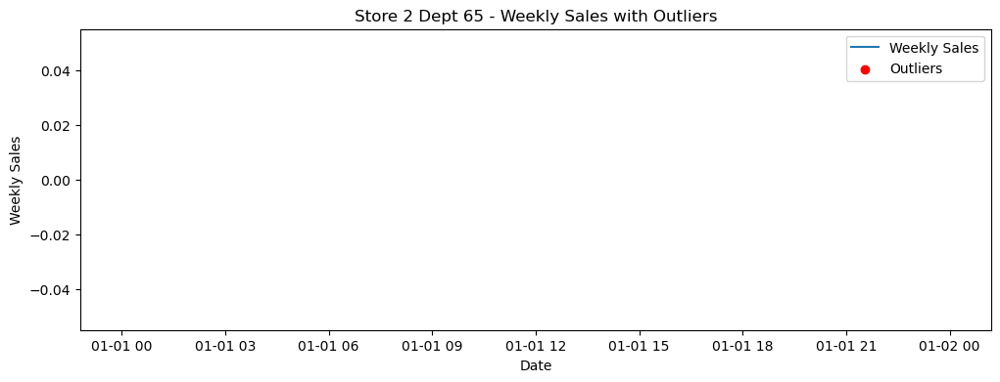

Failed for Store 2, Dept 65 due to: Dataframe has less than 2 non-NaN rows.

Forecasting for Store 3, Department 1


In [ ]:
results = {}
for store in df['Store'].unique():
    for dept in df['Dept'].unique():
        print(f"\nForecasting for Store {store}, Department {dept}")
        try:
            forecast, metrics = forecast_store_dept(df, store, dept)
            results[(store, dept)] = {'forecast': forecast, 'metrics': metrics}
        except Exception as e:
            print(f"Failed for Store {store}, Dept {dept} due to: {e}")

# Now `results` dict holds forecast and accuracy info for each store-department pair.


In [ ]:
def forecast_store_dept(df, store_id, dept_id, periods=52):
    """
    Forecast sales for a store-department pair using Prophet.
    Detects outliers, fits model, evaluates accuracy, and visualizes results.

    Args:
        df (DataFrame): Merged dataset
        store_id (int): Store number
        dept_id (int): Department number
        periods (int): Weeks ahead to forecast

    Returns:
        forecast (DataFrame): Forecast output from Prophet
        metrics (dict): Model accuracy (MAE and RMSE)
    """
    # Filter for specific store and department
    df_sub = df[(df['Store'] == store_id) & (df['Dept'] == dept_id)].copy()
    df_sub = df_sub.sort_values('Date')

    if df_sub.shape[0] < 52:
        raise ValueError("Not enough data to train model")

    # Detect outliers
    df_sub['Outlier'] = detect_outliers_iqr(df_sub['Weekly_Sales'])

    # Plot outliers
    plt.figure(figsize=(10, 4))
    plt.plot(df_sub['Date'], df_sub['Weekly_Sales'], label='Weekly Sales')
    plt.scatter(df_sub.loc[df_sub['Outlier'], 'Date'], 
                df_sub.loc[df_sub['Outlier'], 'Weekly_Sales'], 
                color='red', label='Outliers')
    plt.title(f"Outlier Detection - Store {store_id} Dept {dept_id}")
    plt.xlabel("Date")
    plt.ylabel("Sales")
    plt.legend()
    plt.show()

    # Prepare for Prophet
    df_prophet = df_sub[['Date', 'Weekly_Sales']].rename(columns={'Date': 'ds', 'Weekly_Sales': 'y'})
    model = Prophet(yearly_seasonality=True)
    model.fit(df_prophet)

    # Forecast future
    future = model.make_future_dataframe(periods=periods, freq='W')
    forecast = model.predict(future)

    # Compare actual vs predicted
    actual = df_prophet.merge(forecast[['ds', 'yhat']], on='ds', how='left')
    mae = mean_absolute_error(actual['y'], actual['yhat'])
    rmse = mean_squared_error(actual['y'], actual['yhat'], squared=False)

    print(f"Store {store_id}, Dept {dept_id} - MAE: {mae:.2f}, RMSE: {rmse:.2f}")

    # Plot forecast vs actual
    plt.figure(figsize=(12, 5))
    plt.plot(actual['ds'], actual['y'], label='Actual')
    plt.plot(forecast['ds'], forecast['yhat'], label='Forecast')
    plt.fill_between(forecast['ds'], forecast['yhat_lower'], forecast['yhat_upper'], alpha=0.3)
    plt.title(f"Forecast vs Actual - Store {store_id} Dept {dept_id}")
    plt.xlabel("Date")
    plt.ylabel("Weekly Sales")
    plt.legend()
    plt.show()

    # Forecast components (trend/seasonality)
    model.plot_components(forecast)
    plt.show()

    return forecast, {'MAE': mae, 'RMSE': rmse}

# Store results
results = {}

# Loop over all unique store-department combinations
for store in df['Store'].unique():
    for dept in df['Dept'].unique():
        print(f"\nForecasting for Store {store}, Department {dept}")
        try:
            forecast, metrics = forecast_store_dept(df, store, dept)
            results[(store, dept)] = {'forecast': forecast, 'metrics': metrics}
        except Exception as e:
            print(f"Skipped Store {store}, Dept {dept} due to: {e}")
